# Project, Data Science 2021

## Overview

The goal of this project is to take your first dive into **interpretable ML**.
As would be the case for most industrial projects with companies, your expertise at this point is not quite sufficient and part of your job is to get up to speed with new concepts and code.
So, as a first step I recommend the following 

* Understand the basic idea of L1/L2 regression, boosting and random forests: read chapters 6.2 and 8.2.1-8.2.3 in our ISLR text book.
* Imbibe the basic tools of model interpretation such as partial dependence plots, permutation importance and SHAP values: read 8.1, 8.5, 9.6 in the [Interpretable ML Book](https://christophm.github.io/interpretable-ml-book/).

The data set I want you to tackle comes from this [ProPublica repository](https://github.com/propublica/compas-analysis), so please read the accompanying [article](https://www.propublica.org/article/how-we-analyzed-the-compas-recidivism-algorithm) and explore the notebook (even though parts of it are in R). 

I want you to focus only on the following models 

* (regularized or not) linear models 
* boosting
* random forests

Note that the focus is not just prediction. 
You will be graded on 4 aspects of the "modeling journey", all of which are typically equally valuable when you deliver a data science task to a company:

1. **Modeling Diligence**: this includes data preprocessing, dealing with mising values and categorial variables, feature engineering, choosing appropriate tools (e.g. cross validation), general creativity, ...
2. **Performance**: using an appropriate loss function on a test set defined below. Note that -given similar performance- "less complex" models (either in number of features or tree depth or ...) are judged to be more interpretable.
3. **Explaining predictions**, both globally (e.g. permutation importance) and case-by-case via SHAP values.
4. **Story Telling** via compelling graphs (e.g. PDPs or interaction SHAP plots) and "cherry picked" examples of e.g. local explanations which either make perfect sense or might violate intuition.

You can choose from one or more of four (2 times 2) prediction tasks:  direct and indirect modelling of recidivism, distinguishing between recidivism and violent recidivism.

* classification task
    * predict recidivism
    * predict violent recidivism
* regression task
    * predict COMPAS scores for recidivism
    * predict COMPAS scores for violent recidivism


As I do not want to stifle your creativity and leave you lots of room for your own ideas, I am not going to specify the deliverables much more than the following:

- You will have to present your findings as a group sometime early February.
- In addition you need to prepare a report which could be just a Jupyter notebook with a sufficient amount of text.

At the very least, I would like you to (i) reproduce some of the original claims from the ProPublica article as well the Washington Post 1 article below, (ii) find a tree based model with equal or better performance to the linear regression and (iii) explore the connections between the local and global "explanations" from the machine learning model with the multiple linear regression. 

For inspiration and guidance,you might want to read the following stories/analysis:

* [Washington Post 1](https://www.washingtonpost.com/news/monkey-cage/wp/2016/10/17/can-an-algorithm-be-racist-our-analysis-is-more-cautious-than-propublicas/)
* [Washington Post 2](https://www.washingtonpost.com/politics/2020/03/02/us-criminal-justice-system-algorithms-do-help-officials-make-better-decisions-our-research-finds/)
* [XAI Stories](https://pbiecek.github.io/xai_stories/story-compas.html)
* [fivethirtyeight](https://fivethirtyeight.com/features/prison-reform-risk-assessment/)

Note: The last article is VERY long and less directly relevant, but interesting nevertheless.


Also: if you have *computational resources issues*, i.e. if kaggle notebooks or google colab or MS azure turn out to be too slow or too buggy, we will attempt to give you access to our university server zeno.



## Overfitting

Make sure that you explicitly avoid overfitting your models by adapting strategies from class (e.g. cross validation).

## Team Work guidelines

* Make sure each team member is contributing, both in terms of quality and quantity of contribution
* You are to complete the assignment as a team. All team members are expected to contribute equally to the completion of this assignment and team evaluations will be given at its completion - anyone judged to not have sufficient contributed to the final product will have their grade penalized. While different teams members may have different backgrounds and abilities, it is the responsibility of every team member to understand how and why all code and approaches in the assignment works.

* Team peer evaluation: You will be asked to fill out a survey where you rate the contribution and teamwork of each team member out of 10 points. You will additionally report a contribution percentage for each team member. Filling out the survey is a prerequisite for getting credit on the team member evaluation.If you are suggesting that an individual did less than $1/K$ (K= group size) of the work, please provide some explanation. If any individual gets an average peer score indicating that they did less than 10% of the work, this person will receive half the grade of the rest of the group.


## Grading

There is a document on moodle (Assessment-Scheme-for-Group-Presentations_Projects.pdf) which explains the evaluation metric in detail. (Note that some of the finer presentation points might not be applicable to online presentations.)

# Preprocessing

In [1]:
import pandas as pd
import sqlite3
import matplotlib
import matplotlib.pyplot as plt
import numpy as np
import seaborn as sns
%matplotlib inline
import warnings
warnings.filterwarnings("ignore") #but helps with keeping overview on the output

In [33]:
pd.set_option('display.max_columns', None)
sns.set_style("whitegrid")

## Loading in the data 

In [34]:
# creating file path
dbfile = "../data/compas.db"
# Create a SQL connection to our SQLite database
con = sqlite3.connect(dbfile)

# reading all table names
cursor = con.cursor()
cursor.execute("SELECT name FROM sqlite_master WHERE type='table';")
print(f"Table Name : {cursor.fetchall()}")

#create DataFrames
casearrest = pd.read_sql_query('SELECT * FROM casearrest', con)
prisonhistory = pd.read_sql_query('SELECT * FROM prisonhistory', con)
jailhistory = pd.read_sql_query('SELECT * FROM jailhistory', con)
compas = pd.read_sql_query('SELECT * FROM compas', con)
summary = pd.read_sql_query('SELECT * FROM summary', con)
charge = pd.read_sql_query('SELECT * FROM charge', con)
people  = pd.read_sql_query('SELECT * FROM people', con)

con.close()

Table Name : [('casearrest',), ('prisonhistory',), ('jailhistory',), ('compas',), ('summary',), ('charge',), ('people',)]


In [35]:
#files for pro publica analysis
compas_score = pd.read_csv("https://raw.githubusercontent.com/propublica/compas-analysis/master/compas-scores.csv")
compas_score_raw = pd.read_csv("https://raw.githubusercontent.com/propublica/compas-analysis/master/compas-scores-raw.csv")
compas_2y = pd.read_csv("https://raw.githubusercontent.com/propublica/compas-analysis/master/compas-scores-two-years.csv")
compas_2y_v = pd.read_csv("https://raw.githubusercontent.com/propublica/compas-analysis/master/compas-scores-two-years-violent.csv")
cox_p = pd.read_csv("https://raw.githubusercontent.com/propublica/compas-analysis/master/cox-parsed.csv")
cox_v_p = pd.read_csv("https://raw.githubusercontent.com/propublica/compas-analysis/master/cox-violent-parsed.csv")

## Analysing database table structure 

### DataFrame similarities

In [36]:
#dataframes for the pro publica analysis (probably not needed)
compas_score.shape, compas_score_raw.shape, compas_2y.shape, compas_2y_v.shape, cox_p.shape, cox_v_p.shape

((11757, 47), (60843, 28), (7214, 53), (4743, 54), (13419, 52), (18316, 52))

In [37]:
#original dataframes 
casearrest.shape, prisonhistory.shape, jailhistory.shape, compas.shape, summary.shape, charge.shape, people.shape

((128183, 8),
 (4945, 9),
 (22111, 7),
 (37578, 21),
 (0, 26),
 (148086, 15),
 (11757, 41))

- Summary seems to be an unnecessary table 
- Interesting: there is a lot more entries in casearrest, than in prisonhistory and jailhistory together
    - this is because the prisonhistory is only collected within the state (county?), while casearrest is collected nationwide (some cases from California)

In [38]:
people.head()

,id,name,first,last,sex,race,dob,age,age_cat,juv_fel_count,juv_misd_count,juv_other_count,compas_screening_date,decile_score,score_text,violent_recid,priors_count,days_b_screening_arrest,c_jail_in,c_jail_out,c_case_number,c_days_from_compas,c_arrest_date,c_offense_date,c_charge_degree,c_charge_desc,is_recid,num_r_cases,r_case_number,r_charge_degree,r_days_from_arrest,r_offense_date,r_charge_desc,r_jail_in,r_jail_out,is_violent_recid,num_vr_cases,vr_case_number,vr_charge_degree,vr_offense_date,vr_charge_desc
0,1,miguel hernandez,miguel,hernandez,Male,Other,1947-04-18 00:00:00.000000,69,Greater than 45,0,0,0,2013-08-14 00:00:00.000000,1,None,None,0,-1,2013-08-13 06:03:42,2013-08-14 05:41:20,13011352CF10A,1.0,None,2013-08-13 00:00:00.000000,(F3),Aggravated Assault w/Firearm,0,NaN,None,None,NaN,None,None,None,None,0,None,None,None,None,None
1,2,michael ryan,michael,ryan,Male,Caucasian,1985-02-06 00:00:00.000000,31,25 - 45,0,0,0,2014-12-31 00:00:00.000000,5,None,None,0,None,None,None,None,NaN,None,None,None,None,-1,NaN,None,None,NaN,None,None,None,None,0,None,None,None,None,None
2,3,kevon dixon,kevon,dixon,Male,African-American,1982-01-22 00:00:00.000000,34,25 - 45,0,0,0,2013-01-27 00:00:00.000000,3,None,None,0,-1,2013-01-26 03:45:27,2013-02-05 05:36:53,13001275CF10A,1.0,None,2013-01-26 00:00:00.000000,(F3),Felony Battery w/Prior Convict,1,3.0,13009779CF10A,(F3),NaN,2013-07-05 00:00:00.000000,Felony Battery (Dom Strang),None,None,1,None,13009779CF10A,(F3),2013-07-05 00:00:00.000000,Felony Battery (Dom Strang)
3,4,ed philo,ed,philo,Male,African-American,1991-05-14 00:00:00.000000,24,Less than 25,0,0,1,2013-04-14 00:00:00.000000,4,None,None,4,-1,2013-04-13 04:58:34,2013-04-14 07:02:04,13005330CF10A,1.0,None,2013-04-13 00:00:00.000000,(F3),Possession of Cocaine,1,1.0,13011511MM10A,(M1),0.0,2013-06-16 00:00:00.000000,Driving Under The Influence,2013-06-16 09:05:47.000000,2013-06-16 07:18:55.000000,0,None,None,None,None,None
4,5,marcu brown,marcu,brown,Male,African-American,1993-01-21 00:00:00.000000,23,Less than 25,0,1,0,2013-01-13 00:00:00.000000,8,None,None,1,,,,13000570CF10A,1.0,None,2013-01-12 00:00:00.000000,(F3),Possession of Cannabis,0,NaN,None,None,NaN,None,None,None,None,0,None,None,None,None,None


- given that people has the most colums, it is likely that this is the main data set, including every person once 
    - this also helps with the analysis, since we do not want duplicates.

In [39]:
#propublica used the compay_2y dataframe as basis, as such this will be the main focus when looking into similarities
#which columns are in compas_2y but not in people
extra = []
for i in list(compas_2y.columns):
    if list(people.columns).count(i) == 0: extra.append(i)
extra

['type_of_assessment',
 'decile_score.1',
 'screening_date',
 'v_type_of_assessment',
 'v_decile_score',
 'v_score_text',
 'v_screening_date',
 'in_custody',
 'out_custody',
 'priors_count.1',
 'start',
 'end',
 'event',
 'two_year_recid']

In [40]:
#which columns are in people but not in compas_2y
extra2 = []
for i in list(people.columns):
    if list(compas_2y.columns).count(i) == 0: extra2.append(i)
extra2

['num_r_cases', 'num_vr_cases']

### Does the column "ID" match among all tables?

In [41]:
compas[compas["id"] == 1] 

,id,first,last,compas_person_id,compas_case_id,compas_assessment_id,agency_text,scale_set,assessment_reason,legal_status,custody_status,marital_status,screening_date,rec_supervision_level,rec_supervision_level_text,score_text,scale_id,type_of_assessment,raw_score,decile_score,person_id
0,1,miguel,hernandez,56418,58393,64352,PRETRIAL,Risk and Prescreen,Intake,Pretrial,Jail Inmate,Single,2013-08-14 00:00:00.000000,1,Low,Low,7,Risk of Violence,-4.31,1,1


In [42]:
people[people["id"] == 1]

,id,name,first,last,sex,race,dob,age,age_cat,juv_fel_count,juv_misd_count,juv_other_count,compas_screening_date,decile_score,score_text,violent_recid,priors_count,days_b_screening_arrest,c_jail_in,c_jail_out,c_case_number,c_days_from_compas,c_arrest_date,c_offense_date,c_charge_degree,c_charge_desc,is_recid,num_r_cases,r_case_number,r_charge_degree,r_days_from_arrest,r_offense_date,r_charge_desc,r_jail_in,r_jail_out,is_violent_recid,num_vr_cases,vr_case_number,vr_charge_degree,vr_offense_date,vr_charge_desc
0,1,miguel hernandez,miguel,hernandez,Male,Other,1947-04-18 00:00:00.000000,69,Greater than 45,0,0,0,2013-08-14 00:00:00.000000,1,None,None,0,-1,2013-08-13 06:03:42,2013-08-14 05:41:20,13011352CF10A,1.0,None,2013-08-13 00:00:00.000000,(F3),Aggravated Assault w/Firearm,0,NaN,None,None,NaN,None,None,None,None,0,None,None,None,None,None


In [43]:
charge[charge["id"] == 1]

,id,case_type,case_number,filing_date,offense_date,charge_number,charge_degree,charge,date_charge_filed,filing_type,filing_agency,name,days_since_compas,statute,person_id
0,1,,13005832CF10A,1800-01-01 00:00:00.000000,2013-04-23 00:00:00.000000,1,(F3),Driving While License Revoked,2013-04-23 00:00:00,No Information/ Transfer to Misdemeanor,Fort Lauderdale PD,aajah herrington,1,322.34(5),533


In [44]:
casearrest[casearrest["id"] == 1]

,id,name,case_number,arrest_id,arrest_date,charge_degree,days_since_compas_arrest,person_id
0,1,aajah herrington,13005832CF10A,3026755,2013-04-23 00:00:00.000000,(F3),1,533


In [45]:
jailhistory[jailhistory["id"] == 1]

,id,first,last,dob,in_custody,out_custody,person_id
0,1,victor,lozada,1951-05-12 00:00:00.000000,2013-08-05 12:41:27.000000,2013-08-13 02:27:19.000000,880


In [46]:
prisonhistory[prisonhistory["id"] == 1]

,id,name,first,middle,last,dob,in_custody,out_custody,person_id
0,1,None,bilal,None,williams,1955-05-12 00:00:00.000000,1986-03-13 00:00:00.000000,1987-02-19 00:00:00.000000,4813


- Id only matches for "people" "compas" and "casearrest"!

### Does the column "person_id" match among all tables?

In [47]:
compas[compas["person_id"] == 3]

,id,first,last,compas_person_id,compas_case_id,compas_assessment_id,agency_text,scale_set,assessment_reason,legal_status,custody_status,marital_status,screening_date,rec_supervision_level,rec_supervision_level_text,score_text,scale_id,type_of_assessment,raw_score,decile_score,person_id
6,7,kevon,dixon,51601,52796,58102,PRETRIAL,Risk and Prescreen,Intake,Pretrial,Jail Inmate,Single,2013-01-27 00:00:00.000000,1,Low,Low,7,Risk of Violence,-3.07,1,3
7,8,kevon,dixon,51601,52796,58102,PRETRIAL,Risk and Prescreen,Intake,Pretrial,Jail Inmate,Single,2013-01-27 00:00:00.000000,1,Low,Low,8,Risk of Recidivism,-0.76,3,3
8,9,kevon,dixon,51601,52796,58102,PRETRIAL,Risk and Prescreen,Intake,Pretrial,Jail Inmate,Single,2013-01-27 00:00:00.000000,1,Low,Medium,18,Risk of Failure to Appear,25.00,6,3


In [48]:
charge[charge["person_id"] == 3]

,id,case_type,case_number,filing_date,offense_date,charge_number,charge_degree,charge,date_charge_filed,filing_type,filing_agency,name,days_since_compas,statute,person_id
84226,84227,,13009779CF10A,1800-01-01 00:00:00.000000,2013-07-05 00:00:00.000000,1,(F2),Sexual Battery / Vict 12 Yrs +,2013-07-05 00:00:00,SAO Information,Broward Sheriff Office/Pompano Beach,kevon dixon,-159,794.011(5),3
84227,84228,,13009779CF10A,1800-01-01 00:00:00.000000,2013-07-05 00:00:00.000000,2,(F3),Felony Battery (Dom Strang),2013-07-05 00:00:00,SAO Information,Broward Sheriff Office/Pompano Beach,kevon dixon,-159,784.041(2)(a),3
84228,84229,,13009779CF10A,1800-01-01 00:00:00.000000,2013-07-05 00:00:00.000000,3,(F3),False Imprisonment,2013-07-05 00:00:00,SAO Information,Broward Sheriff Office/Pompano Beach,kevon dixon,-159,787.02(1)(a),3
84229,84230,,13001275CF10A,1800-01-01 00:00:00.000000,2013-01-26 00:00:00.000000,1,(F3),Felony Battery w/Prior Convict,2013-01-26 00:00:00,SAO Information,Broward Sheriff Office/Pompano Beach,kevon dixon,1,784.03(2),3


In [49]:
casearrest[casearrest["person_id"] == 3]

,id,name,case_number,arrest_id,arrest_date,charge_degree,days_since_compas_arrest,person_id
72618,72619,kevon dixon,13009779CF10A,3050956,2013-07-09 00:00:00.000000,(F2),-163,3
72619,72620,kevon dixon,13009779CF10A,3050956,2013-07-09 00:00:00.000000,(F3),-163,3
72620,72621,kevon dixon,13009779CF10A,3050956,2013-07-09 00:00:00.000000,(F3),-163,3
72621,72622,kevon dixon,13001275CF10A,2646382,2013-01-26 00:00:00.000000,(F3),1,3
72622,72623,kevon dixon,13001275CF10A,3050641,2013-07-10 00:00:00.000000,(F3),-164,3


In [50]:
jailhistory[jailhistory["person_id"] == 3]

,id,first,last,dob,in_custody,out_custody,person_id
20848,20849,kevon,dixon,1982-01-22 00:00:00.000000,2013-01-26 03:45:27.000000,2013-02-05 05:36:53.000000,3


In [51]:
prisonhistory[prisonhistory["person_id"] == 3]

,id,name,first,middle,last,dob,in_custody,out_custody,person_id
1241,1242,None,kevon,None,dixon,1982-01-22 00:00:00.000000,2015-10-15 00:00:00.000000,2015-12-07 00:00:00.000000,3


- Person_id is the same among all tables
- Note: people does not include person_id

In [52]:
people[people["id"] == 3]

,id,name,first,last,sex,race,dob,age,age_cat,juv_fel_count,juv_misd_count,juv_other_count,compas_screening_date,decile_score,score_text,violent_recid,priors_count,days_b_screening_arrest,c_jail_in,c_jail_out,c_case_number,c_days_from_compas,c_arrest_date,c_offense_date,c_charge_degree,c_charge_desc,is_recid,num_r_cases,r_case_number,r_charge_degree,r_days_from_arrest,r_offense_date,r_charge_desc,r_jail_in,r_jail_out,is_violent_recid,num_vr_cases,vr_case_number,vr_charge_degree,vr_offense_date,vr_charge_desc
2,3,kevon dixon,kevon,dixon,Male,African-American,1982-01-22 00:00:00.000000,34,25 - 45,0,0,0,2013-01-27 00:00:00.000000,3,None,None,0,-1,2013-01-26 03:45:27,2013-02-05 05:36:53,13001275CF10A,1.0,None,2013-01-26 00:00:00.000000,(F3),Felony Battery w/Prior Convict,1,3.0,13009779CF10A,(F3),NaN,2013-07-05 00:00:00.000000,Felony Battery (Dom Strang),None,None,1,None,13009779CF10A,(F3),2013-07-05 00:00:00.000000,Felony Battery (Dom Strang)


In [53]:
compas_2y[compas_2y["id"] == 3]

,id,name,first,last,compas_screening_date,sex,dob,age,age_cat,race,juv_fel_count,decile_score,juv_misd_count,juv_other_count,priors_count,days_b_screening_arrest,c_jail_in,c_jail_out,c_case_number,c_offense_date,c_arrest_date,c_days_from_compas,c_charge_degree,c_charge_desc,is_recid,r_case_number,r_charge_degree,r_days_from_arrest,r_offense_date,r_charge_desc,r_jail_in,r_jail_out,violent_recid,is_violent_recid,vr_case_number,vr_charge_degree,vr_offense_date,vr_charge_desc,type_of_assessment,decile_score.1,score_text,screening_date,v_type_of_assessment,v_decile_score,v_score_text,v_screening_date,in_custody,out_custody,priors_count.1,start,end,event,two_year_recid
1,3,kevon dixon,kevon,dixon,2013-01-27,Male,1982-01-22,34,25 - 45,African-American,0,3,0,0,0,-1.0,2013-01-26 03:45:27,2013-02-05 05:36:53,13001275CF10A,2013-01-26,NaN,1.0,F,Felony Battery w/Prior Convict,1,13009779CF10A,(F3),NaN,2013-07-05,Felony Battery (Dom Strang),NaN,NaN,NaN,1,13009779CF10A,(F3),2013-07-05,Felony Battery (Dom Strang),Risk of Recidivism,3,Low,2013-01-27,Risk of Violence,1,Low,2013-01-27,2013-01-26,2013-02-05,0,9,159,1,1


- id of people & compas_2y = person_id of the other dataframes

### Exploring specific columns

Sadly there is little to no documentation on the variables. 
Therefore, we try to explain the columns by exploring values 

Columns needed to be explored:
- compas.agency_text
- compas.scale_set
- compas.legal_status
- compas.custody_status
- compas.marital_status
- compas.rec_supervision_level
- compas.rec_supervision_level_text
- compas.score_text
- compas.scale_id
- compas.type_of_assessment
- compas.decile_score
- charge.charge_number
- charge.charge_degree
- charge.charge
- charge.filing_type
- charge.filing_agency
- charge.days_since_compas
- charge.statute
- people.age_cat
- people.juv_fel_count
- people.juv_misd_count
- people.juv_other_count
- people.violent_recid
- people.priors_count
- people.days_b_screening_arrest
- people.c_jail_in
- people.c_jail_out
- people.c_days_from_compas
- people.c_charge_degree
- people.c_charge_desc
- people.is_recid
- people.num_r_cases

In [54]:
compas.groupby(by = "agency_text").count()["id"]
#sadly it is not obvious what DRRD is (cant even google it) and it seems unclear how Broward County fits this category
#overall, this variable likely doesnt matter, given that the compas score should not care whether its done pretrial or for probation causes 

agency_text
Broward County      117
DRRD                153
PRETRIAL          36033
Probation          1275
Name: id, dtype: int64

In [55]:
compas.groupby(by = "scale_set").count()["id"]
#Sadly, the test that the arrested people have to take is not findable online, therefore we just have to guess, that this wont affect the scores
#compas[compas["scale_set"] == "All Scales"]
#it seems that these only have informational influence on the dataframe 

scale_set
All Scales              486
Risk and Prescreen    37092
Name: id, dtype: int64

In [56]:
compas.groupby(by = "legal_status").count()["id"]
#only has one value -> definitely uninteresting.

legal_status
Pretrial    37578
Name: id, dtype: int64

In [57]:
compas.groupby(by = "custody_status").count()["id"]
#it seems like this status contradicts the legal_status
#this could be interesting, maybe candidates on probation and residential programs are less likely to reoffend.

custody_status
Jail Inmate            29862
Parole                     3
Pretrial Defendant      7524
Prison Inmate             15
Probation                123
Residential Program       51
Name: id, dtype: int64

In [58]:
compas.groupby(by = "marital_status").count()["id"]
#this could be interesting for the analysis, but probably needs to be recoded: married & s/o vs. rest
#maybe also not significant with the "if they do crimes while being married, they will do crimes when not being married" approach or something.

marital_status
Divorced              1617
Married               4491
Separated              921
Significant Other     1227
Single               28932
Unknown                213
Widowed                177
Name: id, dtype: int64

In [59]:
compas.groupby(by = "rec_supervision_level").count()["id"], compas.groupby(by = "rec_supervision_level_text").count()["id"]
#this is very intransparent, no clue what the name could mean.

(rec_supervision_level
 1    22200
 2     7002
 3     5136
 4     3240
 Name: id, dtype: int64,
 rec_supervision_level_text
 High                                   3240
 Low                                   22200
 Medium                                 7002
 Medium with Override Consideration     5136
 Name: id, dtype: int64)

In [60]:
compas.groupby(by = "score_text").count()["id"], compas.groupby(by = "decile_score").count()["id"]
#why is there some with N/A? This needs to be analysed
#would only be important if we also try to predict compas scores - if we just predict recidivism, we dont care about compas scores

(score_text
 High       4826
 Low       24577
 Medium     8154
 N/A          21
 Name: id, dtype: int64,
 decile_score
 -1        21
  1     10871
  2      5371
  3      5068
  4      3267
  5      3121
  6      2777
  7      2256
  8      1914
  9      1725
  10     1187
 Name: id, dtype: int64)

In [61]:
compas.groupby(by = "scale_id").count()["id"], compas.groupby(by = "type_of_assessment").count()["id"]
#every person filled out all 3 scales, this is not relevant as predictor but maybe interesting for some filter?
#7 = risk of failure to appear, 8 = risk of recidivism, 18 = risk of violent recidivism
#obv directly connected to the compas score - maybe not interesting because of that 

(scale_id
 7     12526
 8     12526
 18    12526
 Name: id, dtype: int64,
 type_of_assessment
 Risk of Failure to Appear    12526
 Risk of Recidivism           12526
 Risk of Violence             12526
 Name: id, dtype: int64)

In [62]:
charge.groupby(by = "charge_number").count()["person_id"], charge[charge["person_id"] == 1]
#this refers to the number of different charges per trial
#if we include this somehow we should probably look at the mean charges of that person

(charge_number
 1      79932
 2      35564
 3      15427
 4       7098
 5       3358
        ...  
 527        1
 528        1
 529        1
 530        1
 531        1
 Name: person_id, Length: 531, dtype: int64,
             id case_type    case_number                 filing_date  \
 102106  102107            13011352CF10A  1800-01-01 00:00:00.000000   
 102107  102108            13011352CF10A  1800-01-01 00:00:00.000000   
 102108  102109            13009443TI30A  1800-01-01 00:00:00.000000   
 102109  102110            13009443TI30A  1800-01-01 00:00:00.000000   
 102110  102111            13068564TI20A  1800-01-01 00:00:00.000000   
 102111  102112            09098832TI20A  1800-01-01 00:00:00.000000   
 102112  102113            09083797TI30A  1800-01-01 00:00:00.000000   
 102113  102114            14014411TI20A  1800-01-01 00:00:00.000000   
 
                       offense_date  charge_number charge_degree  \
 102106  2013-08-13 00:00:00.000000              1          (F3)   


In [63]:
charge.groupby(by = "charge_degree").count()["person_id"]
#this once again is VERY INTRANSPARENT but potentially important
#if we include this, they should either be ranked + mean OR just the highest charge_degree the person commited 
##because mean maybe includes too many "little fellonies" (crossing traffic lights on red etc)

#maybe scale it -> exponential
#how is this coded? obviously this order is just alphabetic -> we need to find out the correct order 
#http://www.wittel.org/misdemeanor.html may help a little
#0 = ordinary traffic offenses (probably not really recidivism)

charge_degree
(0)           50656
(CO3)           128
(CT)             13
(F1)           1992
(F2)           8943
(F3)          30533
(F5)             32
(F6)             22
(F7)            430
(M1)          28003
(M2)          22295
(M3)              3
(MO3)          3537
(NI0)           496
(TC4)            90
(TCX)           895
(X)              14
XXXXXXXXXX        4
Name: person_id, dtype: int64

In [64]:
charge.groupby(by = "charge").count()["person_id"]
#maybe interesting for looking at specific cases, however, not relevant for general analysis  

charge
50 Or More MPH Over Speed Limit       5
50/More Over Limit 1st Offense        5
>6 Lobster Per Person/Day/Boat        1
ATV- Violation                       18
ATV-Fail Give Notice Of Accd          1
                                     ..
Writing A Threat To Kill/injur        1
Writing a Threat to Kill              5
Wrong Lane Rotary One Way             1
YROW To State Rds At Intersection     6
viol 2nd Metal Recycle Reg            1
Name: person_id, Length: 2348, dtype: int64

In [65]:
charge.groupby(by = "filing_type").count()["person_id"]
#not interesting, probably highly correlating with other variables (i.e., charge degree, charge number)

filing_type
Change of Venue                                4
Citation                                    3398
City Pros Add Charge                          17
City Pros Change of Charge                    15
City Prosecutor                             2796
Contempt of Court                             19
Filed at Magistrate                         1787
Filed in Juvenile Court                        3
Fugitive                                      68
Grand Jury Indictment                         15
Grand Jury- Add Charge                         2
Grand Jury- Change of Charge                   4
Grand Jury- Not In Custody                     9
No Action Taken/ SAO/ Agency Pending         952
No Information                             20196
No Information/ Transfer to Felony             3
No Information/ Transfer to Misdemeanor     2276
No True Bill                                   3
Notice to Appear                             690
SAO Information                            33563
SAO Info

In [66]:
charge.groupby(by = "filing_agency").count()["person_id"]
#probably not necessary

filing_agency
Airport Police                                70
Broward County Jail                            2
Broward Sheriff Office                     31049
Broward Sheriff Office/Cooper City           618
Broward Sheriff Office/Dania                2315
Broward Sheriff Office/Deerfield Beach      4043
Broward Sheriff Office/Lauderdale Lakes        3
Broward Sheriff Office/Oakland Park         2820
Broward Sheriff Office/Pembroke Park         206
Broward Sheriff Office/Pompano Beach        8195
Broward Sheriff Office/Tamarac              1521
Broward Sheriff Office/Weston                331
Clerk of Courts                                4
Coconut Creek PD                            1928
Coral Springs PD                            5848
Courthouse                                    84
Davie PD                                    4368
Department of Insurance                       27
Department of Transportation                  21
Dept Environmental Protection                 16
Dept o

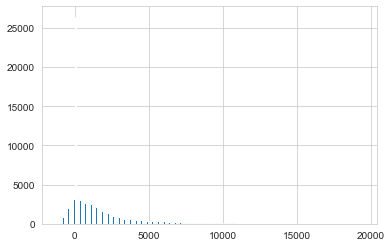

In [67]:
#charge.groupby(by = "days_since_compas").count()["person_id"]
plt.hist(charge.days_since_compas, bins = 250)
plt.show()
#intersting spike around 0: that is because the first time the compas has been taken its always combined with an arrest -> says nothing regarding recidivism.
#also interesting: negative values are reoffending, while positive values are offenses from the past.

In [68]:
charge.groupby(by = "statute").count()["person_id"]
#not relevant, probably more or less identical to charge

statute
00.2700      1
1003.24     12
1003277A     2
113         12
122.54       9
            ..
OSND7268     1
OSND918      1
OTMD 31      1
OXXU         1
TXXU         4
Name: person_id, Length: 1912, dtype: int64

In [69]:
people.groupby(by = "age_cat").count()["id"]
#this is probably an interesting alternative to age (either or)
#however, the categorizing needs to be analysed -> why have these cut-offs been chosen?

age_cat
25 - 45            6649
Greater than 45    2668
Less than 25       2440
Name: id, dtype: int64

In [70]:
people.groupby(by = "juv_misd_count").count()["id"]
#probably refering to misdemeanors: https://www.shouselaw.com/ca/blog/misdemeanor-examples/ (penalty(california): 1k in fines or 1year in jail)

juv_misd_count
0     11199
1       387
2       100
3        37
4        14
5         7
6         5
7         2
8         3
12        2
13        1
Name: id, dtype: int64

In [71]:
people.groupby(by = "juv_other_count").count()["id"]
#everything that is not either a felony: https://www.legalmatch.com/law-library/article/what-is-a-felony.html or a misdemeanor (see above)

#juv_fel_count, juv_misd_count, juv_other_count are all interesting for the analysis
##RETHINK: maybe just ignore the degree of charge and instead just focus on the number of childhood charges (sum or weighted sum) -> childhood charges as "gateway drug"

juv_other_count
0     11030
1       520
2       127
3        45
4        19
5         7
6         2
7         3
9         1
10        1
11        1
17        1
Name: id, dtype: int64

In [72]:
people.groupby(by = "violent_recid").count()["id"]
#only missing values, maybe needs to be filled?

Series([], Name: id, dtype: int64)

In [73]:
#people.groupby(by = "priors_count").count()["id"]
#people[people["priors_count"] == 36]
charge[(charge["name"] == "larry ferguson") & (charge["charge_number"] == 1)]
#this seems intransparent and needs to be further looked at.
#the concept of priors charges seem very relevant, however, it does not match the charge number given in the charge table.

,id,case_type,case_number,filing_date,offense_date,charge_number,charge_degree,charge,date_charge_filed,filing_type,filing_agency,name,days_since_compas,statute,person_id
86580,86581,,98022023CF10A,1800-01-01 00:00:00.000000,1998-09-30 00:00:00.000000,1,(F3),Grand Theft in the 3rd Degree,1998-09-30 00:00:00,No Information,Hallandale PD,larry ferguson,5691,812.014(2)(c ),1650
86581,86582,,87012392CF10A,1800-01-01 00:00:00.000000,1987-07-25 00:00:00.000000,1,(F3),Possession of Cocaine,1987-07-25 00:00:00,SAO Information,Hallandale PD,larry ferguson,9776,893.03(2)(a)4,1650
86582,86583,,06022984CF10A,1800-01-01 00:00:00.000000,2006-12-13 00:00:00.000000,1,(F3),Driving While License Revoked,2006-12-13 00:00:00,SAO Information- Add Charge,Fort Lauderdale PD,larry ferguson,2695,322.34(5),1650
86588,86589,,96013981TC10A,1800-01-01 00:00:00.000000,1996-04-19 00:00:00.000000,1,(TCX),License Suspended Revoked,1996-04-19 00:00:00,None,Hollywood PD,larry ferguson,6585,322.34,1650
86590,86591,,96006726TC10A,1800-01-01 00:00:00.000000,1996-02-22 00:00:00.000000,1,(TCX),License Suspended Revoked,1996-02-22 00:00:00,None,Broward Sheriff Office,larry ferguson,6642,322.34(1),1650
86591,86592,,09021406CF10A,1800-01-01 00:00:00.000000,2009-11-21 00:00:00.000000,1,(F3),Felony Driving While Lic Suspd,2009-11-21 00:00:00,SAO Information- Change of Charge,Broward Sheriff Office/Tamarac,larry ferguson,1621,322.34(1)(c ),1650
86599,86600,,99009317MM10A,1800-01-01 00:00:00.000000,1999-04-12 00:00:00.000000,1,(M1),Resist/Obstruct W/O Violence,1999-04-12 00:00:00,SAO Information,Sunrise PD,larry ferguson,5497,843.02,1650
86602,86603,,88017148TC10A,1800-01-01 00:00:00.000000,1988-04-13 00:00:00.000000,1,(TCX),License Suspended Revoked,1988-04-13 00:00:00,None,Fort Lauderdale PD,larry ferguson,9513,322.34,1650
86604,86605,,80012027CF10A,1800-01-01 00:00:00.000000,1980-12-18 00:00:00.000000,1,(F3),Theft,1980-12-18 00:00:00,SAO Information,Hallandale PD,larry ferguson,12186,812.014(1)b,1650
86605,86606,,88019338MM10A,1800-01-01 00:00:00.000000,1988-07-31 00:00:00.000000,1,(TC4),Driving Under The Influence,1988-07-31 00:00:00,SAO Information,Florida Highway Patrol-Ft Lauderdale,larry ferguson,9404,316.193(1),1650


In [74]:
#people.groupby(by = "days_b_screening_arrest").count()["id"]
people.days_b_screening_arrest.describe()
#is this congruent to days_since_compast?
#further evaluation needed

count     11015
unique      553
top          -1
freq       6162
Name: days_b_screening_arrest, dtype: int64

In [75]:
#people.groupby(by = "c_jail_in").count()["id"]
people.loc[:,("name","c_jail_in")]
#not sure, if this only is the last time they have been jailed? what does the c refer to (charge? custody?)? does this include only recidivism?

,name,c_jail_in
0,miguel hernandez,2013-08-13 06:03:42
1,michael ryan,None
2,kevon dixon,2013-01-26 03:45:27
3,ed philo,2013-04-13 04:58:34
4,marcu brown,
...,...,...
11752,patrick hamilton,2013-09-21 04:06:00
11753,raymond hernandez,2013-05-16 08:58:35
11754,dieuseul pierre-gilles,
11755,scott lomagistro,2013-05-21 03:12:58


In [76]:
#people.groupby(by = "c_jail_out").count()["id"]
people.loc[:,("name","c_jail_out")]
#same as c_jail_in ... while the variable it self may not be very relevant, the implications of the variables may be interesting for the analysis

,name,c_jail_out
0,miguel hernandez,2013-08-14 05:41:20
1,michael ryan,None
2,kevon dixon,2013-02-05 05:36:53
3,ed philo,2013-04-14 07:02:04
4,marcu brown,
...,...,...
11752,patrick hamilton,2013-09-22 08:16:13
11753,raymond hernandez,2013-05-18 07:59:30
11754,dieuseul pierre-gilles,
11755,scott lomagistro,2013-05-22 09:04:20


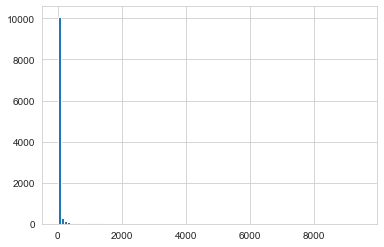

In [77]:
#people.groupby(by = "c_days_from_compas").count()["id"]
plt.hist(people.c_days_from_compas, bins = 100)
plt.show()
#not sure what this means, given the very very high amount of zeros

In [78]:
people.groupby(by = "c_charge_degree").count()["id"]#, charge.groupby(by = "charge_degree").count()["id"]
#identical to charge_degree, however this does not include "0" and probably only refers to the highest charge? -> check!

c_charge_degree
(CO3)       1
(CT)        1
(F1)      221
(F2)      953
(F3)     5913
(F5)        7
(F6)       10
(F7)      128
(M1)     2831
(M2)      857
(MO3)      83
(NI0)       8
(TCX)       1
(X)         1
Name: id, dtype: int64

In [79]:
people.groupby(by = "c_charge_desc").count()["id"]
#see above

c_charge_desc
Abuse Without Great Harm                                   2
Accessory After the Fact                                   1
Agg Abuse Elderlly/Disabled Adult                          1
Agg Assault Law Enforc Officer                             1
Agg Assault W/int Com Fel Dome                             9
                                                        ... 
Violation of Injunction Order/Stalking/Cyberstalking       2
Voyeurism                                                  1
Wear Mask w/Commit Offense                                 1
Workers Compensation Fraud                                 1
arrest case no charge                                   1858
Name: id, Length: 531, dtype: int64

In [80]:
people.groupby(by = "is_recid").count()["id"]
#what does -1  mean? -> "we coded it -1 if we could not find a compas case at all"
#make an actual comparison, if they are actually the same -> set -1 to 0

is_recid
-1     719
 0    7335
 1    3703
Name: id, dtype: int64

In [81]:
people.groupby(by = "num_r_cases").count()["id"], sum(people.groupby(by = "num_r_cases").count()["id"])
#number of recidivisms? in that case its unnecessary for the analysis (because its the target variable)
#also note: this number is equivalent to "1" at the is_recid

(num_r_cases
 1.0     2236
 2.0      874
 3.0      311
 4.0      152
 5.0       60
 6.0       40
 7.0       10
 8.0        5
 9.0        5
 10.0       1
 12.0       4
 15.0       2
 18.0       1
 29.0       1
 55.0       1
 Name: id, dtype: int64,
 3703)

### Figuring out the age categories (result = just use metric)

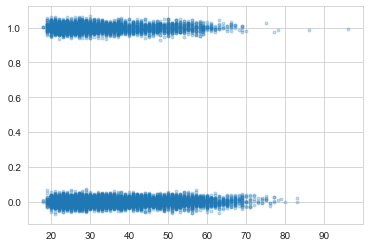

In [82]:
#Add some jitter to is_recid to see, how age is connected with recidivism
df = people[people["is_recid"] >= 0]
df["is_recid_noise"] = df["is_recid"] + 0.02 * np.random.randn(df.shape[0])
recid = df[df["is_recid"] == 1]
no_recid = df[df["is_recid"] == 0]

plt.scatter(df.age, df.is_recid_noise, marker = ".", alpha = 0.25)

<AxesSubplot:xlabel='is_recid', ylabel='age'>

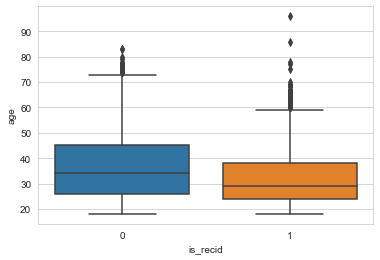

In [83]:
#maybe a boxplot can explain how the cut-offs were set?
sns.boxplot(x = "is_recid", y = "age", data = df)

In [84]:
np.mean(recid.age), np.mean(no_recid.age)

(32.43100189035917, 36.39427402862986)

In [85]:
#Why is the age cat chosen like that?!
df[df["is_recid"] == 1]["age"].quantile(0.75), df[df["is_recid"] == 1]["age"].quantile(0.25), df[df["is_recid"] == 1]["age"].quantile(0.5)

(38.0, 24.0, 29.0)

In [86]:
#also calculate whiskers
df[df["is_recid"] == 1]["age"].quantile(0.75) + (1.5 * (df[df["is_recid"] == 1]["age"].quantile(0.75) - df[df["is_recid"] == 1]["age"].quantile(0.25)))

59.0

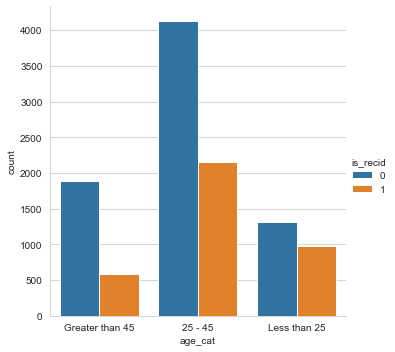

In [87]:
sns.catplot(hue = "is_recid", x = "age_cat", data = df, kind = "count")

In [88]:
#idea: look into the recidivism per age-category -> maybe it can be optimised
np.mean(df[df["age_cat"] == "Less than 25"].is_recid), np.mean(df[df["age_cat"] == "25 - 45"].is_recid), np.mean(df[df["age_cat"] == "Greater than 45"].is_recid), 

(0.4255133245958934, 0.34247011952191236, 0.23443815683104285)

In [89]:
#calculate a new age_category based on the the quartiles of recidive persons (see boxplot)
agecat2 = pd.cut(df.age, bins = [0, 23, 38, 100], labels =["Under 24", "24 - 38", "Over 38"])

In [90]:
df["agecat2"] = agecat2

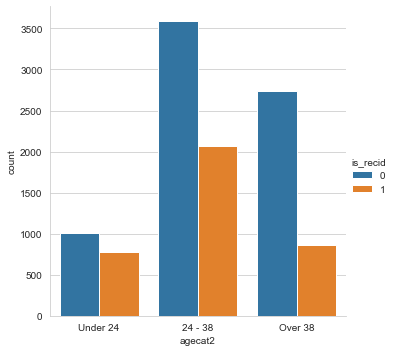

In [91]:
sns.catplot(hue = "is_recid", x = "agecat2", data = df, kind = "count")

In [92]:
#this new categorizing raises the recidivism quota on every category, however its increased most in the 24-38 area, which could help classifying.
#the problem that is remaining is that the people that are 39 and 85 are classified the same, the categories are not fine enough.
np.mean(df[df["agecat2"] == "Under 24"].is_recid), np.mean(df[df["agecat2"] == "24 - 38"].is_recid), np.mean(df[df["agecat2"] == "Over 38"].is_recid), 

(0.43385650224215244, 0.36534040671971707, 0.23978883023061962)

In [93]:
#maybe create more categories instead? (based on the is_recid = 1 boxplot)
agecat3 = pd.cut(df.age, bins = [0, 23, 29, 38, 59, 100], labels =["Under 24", "24 - 29", "30 - 38", "38 - 59", "Over 59"])
df["agecat3"] = agecat3

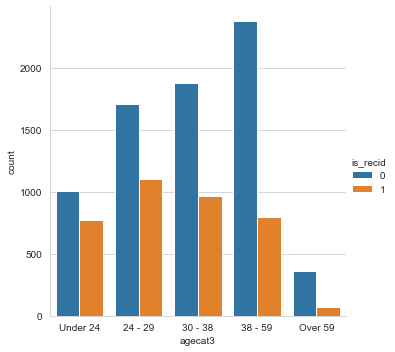

In [94]:
sns.catplot(hue = "is_recid", x = "agecat3", data = df, kind = "count")

In [95]:
#this seems better overall. however, i still dont see this being better than using age directly
np.mean(df[df["agecat3"] == "Under 24"].is_recid), np.mean(df[df["agecat3"] == "24 - 29"].is_recid), np.mean(df[df["agecat3"] == "30 - 38"].is_recid), np.mean(df[df["agecat3"] == "38 - 59"].is_recid), np.mean(df[df["agecat3"] == "Over 59"].is_recid), 

(0.43385650224215244,
 0.3925266903914591,
 0.33848857644991215,
 0.25055152852190354,
 0.1596244131455399)

In [96]:
#lets see how a decision tree would split age
from sklearn.tree import DecisionTreeClassifier
from sklearn.tree import plot_tree
X = np.array(df.age).reshape(-1,1)
y = df.is_recid

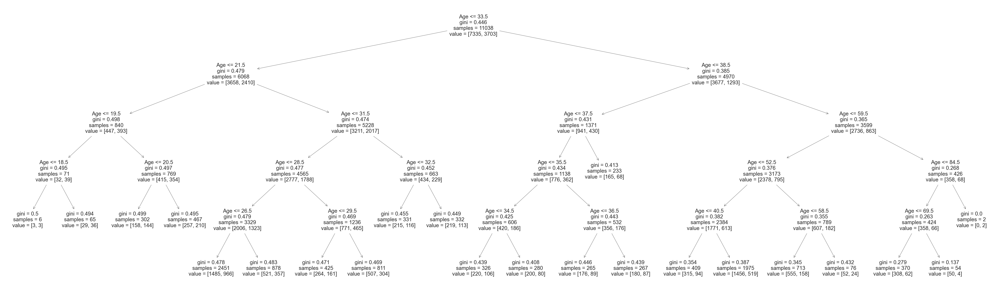

In [97]:
plt.figure(figsize=(100,30))
clf4 = DecisionTreeClassifier(max_depth=5)
clf4.fit(X, y)
ax4 = plot_tree(clf4, feature_names = ["Age"]);

In [98]:
#I think that it overall makes no sense to use any categorizing for age, given that the probability just steadily decreases by higher age.
#We can see the splits improving with age <= 40.5; so that may be a good cut-off until 69.5 
#However, the splits are still very inpure, as such it probably would only make the models less precise

### Figuring out charge degrees

In [99]:
#There are many charge degrees in the dataset, which will often mean the same / similar degree of crime in law - as such it makes sense to reduce 
#the number of categories by figuring out, how they can be grouped / mapped
charge.groupby(by = "charge_degree").count().id

charge_degree
(0)           50656
(CO3)           128
(CT)             13
(F1)           1992
(F2)           8943
(F3)          30533
(F5)             32
(F6)             22
(F7)            430
(M1)          28003
(M2)          22295
(M3)              3
(MO3)          3537
(NI0)           496
(TC4)            90
(TCX)           895
(X)              14
XXXXXXXXXX        4
Name: id, dtype: int64

In [100]:
charge[charge["charge_degree"] == "(CO3)"].head(50)
#only clue I found: https://www.criminaldefenselawyer.com/resources/florida-public-intoxication-laws.htm 
#this suggests that these are misdemeanors, given the extent of punishment

,id,case_type,case_number,filing_date,offense_date,charge_number,charge_degree,charge,date_charge_filed,filing_type,filing_agency,name,days_since_compas,statute,person_id
5946,5947,,11020226MM10A,1800-01-01 00:00:00.000000,2011-08-20 00:00:00.000000,1,(CO3),Drink/Licensed/Establisment,2011-08-20 00:00:00,No Information,Broward Sheriff Office,andrew calderaro,539,32,590
8720,8721,,12010926CO10A,1800-01-01 00:00:00.000000,2012-05-06 00:00:00.000000,1,(CO3),DOC/Sleep In Prohibited Area,2012-05-06 00:00:00,Notice to Appear,Broward Sheriff Office,anthony peat,476,21143B,2181
9119,9120,,12018415CO10A,1800-01-01 00:00:00.000000,2012-08-13 00:00:00.000000,1,(CO3),DOC/Open Container/Bus Facility,2012-08-13 00:00:00,No Information,Broward Sheriff Office,anthony strickland,147,21143F,8881
9370,9371,,09017765MM10A,1800-01-01 00:00:00.000000,2009-08-02 00:00:00.000000,2,(CO3),Violation Broward Co Ordinance,2009-08-02 00:00:00,SAO Information,Broward Sheriff Office/Deerfield Beach,antoine ilus,1264,12569,7689
9705,9706,,09021193MM10A,1800-01-01 00:00:00.000000,2009-08-09 00:00:00.000000,1,(CO3),Drink Near Licensed Establishm,2009-08-09 00:00:00,SAO Information,Broward Sheriff Office,antonio davis,1912,32B1,11626
12390,12391,,98026691MM10A,1800-01-01 00:00:00.000000,1998-09-11 00:00:00.000000,1,(CO3),Drink Near Licensed Establishm,1998-09-11 00:00:00,SAO Information- Not In Custody,State Attorney,barry downs,5296,32B1,9512
13046,13047,,13004420MM10A,1800-01-01 00:00:00.000000,2013-03-04 00:00:00.000000,2,(CO3),Drink Near Licensed Establishm,2013-03-04 00:00:00,Filed at Magistrate,Fort Lauderdale PD,bernard crenshaw,9,32B1,1651
13600,13601,,10019484CO10A,1800-01-01 00:00:00.000000,2010-09-10 00:00:00.000000,1,(CO3),Drink Near Licensed Establishm,2010-09-10 00:00:00,Filed at Magistrate,Broward Sheriff Office,bilal williams,1528,32B1,4813
16785,16786,,01015123MM10A,1800-01-01 00:00:00.000000,2001-05-20 00:00:00.000000,1,(CO3),Drink Near Licensed Establishm,2001-05-20 00:00:00,SAO Information- Not In Custody,State Attorney,brian williams,4276,32B1,2444
24801,24802,,13000850MM10A,1800-01-01 00:00:00.000000,2012-10-04 00:00:00.000000,1,(CO3),Drink/Licensed/Establisment,2012-10-04 00:00:00,Notice to Appear,Broward Sheriff Office,christopher mozie,100,32,8344


In [101]:
charge[charge["charge_degree"] == "(MO3)"].head(50)
#all of the below listed charges are considered misdemeanours, and will for us be labeled as M

,id,case_type,case_number,filing_date,offense_date,charge_number,charge_degree,charge,date_charge_filed,filing_type,filing_agency,name,days_since_compas,statute,person_id
54,55,,13021824MO10A,1800-01-01 00:00:00.000000,2013-11-20 00:00:00.000000,1,(MO3),Public Consumption Of Alcohol,2013-11-20 00:00:00,No Information,Davie PD,aaron aprile,128,ODVD166,4474
58,59,,14008866MO10A,1800-01-01 00:00:00.000000,2014-05-07 00:00:00.000000,1,(MO3),Sleeping On Municipal Beaches,2014-05-07 00:00:00,City Prosecutor,Fort Lauderdale PD,aaron davis,202,OFLD858B,7502
59,60,,13016427MO10A,1800-01-01 00:00:00.000000,2013-08-11 00:00:00.000000,1,(MO3),Open Container-FL,2013-08-11 00:00:00,City Prosecutor,Fort Lauderdale PD,aaron davis,471,OFLD53A,7502
64,65,,13008480MO10A,1800-01-01 00:00:00.000000,2013-04-17 00:00:00.000000,1,(MO3),Petit Theft,2013-04-17 00:00:00,City Prosecutor,Fort Lauderdale PD,aaron davis,587,OFLD16110,7502
65,66,,10014492MO10A,1800-01-01 00:00:00.000000,2010-06-30 00:00:00.000000,1,(MO3),Petit Theft,2010-06-30 00:00:00,City Prosecutor,Fort Lauderdale PD,aaron davis,1609,OFLD16110,7502
66,67,,10006034MO10A,1800-01-01 00:00:00.000000,2010-03-12 00:00:00.000000,1,(MO3),Petit Theft,2010-03-12 00:00:00,City Prosecutor,Fort Lauderdale PD,aaron davis,1719,OFLD16110,7502
70,71,,09028204MO10A,1800-01-01 00:00:00.000000,2009-12-06 00:00:00.000000,1,(MO3),Trespass,2009-12-06 00:00:00,Filed at Magistrate,Fort Lauderdale PD,aaron davis,1815,OFLD16157,7502
71,72,,13022732MO10A,1800-01-01 00:00:00.000000,2013-11-25 00:00:00.000000,1,(MO3),Petit Theft,2013-11-25 00:00:00,City Prosecutor,Fort Lauderdale PD,aaron davis,365,OFLD16110,7502
77,78,,16001287MO10A,1800-01-01 00:00:00.000000,2016-01-30 00:00:00.000000,1,(MO3),Petit Theft,2016-01-30 00:00:00,City Prosecutor,Fort Lauderdale PD,aaron davis,-431,OFLD16110,7502
80,81,,14012865MO10A,1800-01-01 00:00:00.000000,2014-08-17 00:00:00.000000,1,(MO3),Battery,2014-08-17 00:00:00,City Prosecutor,Fort Lauderdale PD,aaron davis,100,OFLD1614,7502


In [102]:
charge[charge["charge_degree"] == "(CT)"].head(50)
#civil contempt is neither categorized as M nor as F (https://www.galanterlaw.com/blog/2013/march/contempt-of-court-charges-in-florida/)
#therefore this should probably be classified as "0"

,id,case_type,case_number,filing_date,offense_date,charge_number,charge_degree,charge,date_charge_filed,filing_type,filing_agency,name,days_since_compas,statute,person_id
17602,17603,,14012310CT10A,1800-01-01 00:00:00.000000,2014-08-08 00:00:00.000000,1,(CT),Contempt/Fail To Appear/Summons,2014-08-08 00:00:00,Contempt of Court,State Attorney,bruce gadson,-289,901.11,3701
23508,23509,,14009354CT10A,1800-01-01 00:00:00.000000,2014-06-12 00:00:00.000000,1,(CT),Contempt Of Court,2014-06-12 00:00:00,Contempt of Court,Broward Sheriff Office/Pompano Beach,christopher colon,-20,90004,3031
28059,28060,,13007288CT10A,1800-01-01 00:00:00.000000,2013-04-15 00:00:00.000000,1,(CT),Contempt/Fail To Appear/Summons,2013-04-15 00:00:00,Contempt of Court,State Attorney,crystal rushton,156,901.11,9526
28722,28723,,13017290CT10A,1800-01-01 00:00:00.000000,2013-09-10 00:00:00.000000,1,(CT),Contempt/Fail To Appear/Summons,2013-09-10 00:00:00,Contempt of Court,State Attorney,dale griffin,201,901.11,9791
45638,45639,,11008806MM10A,1800-01-01 00:00:00.000000,2011-11-01 00:00:00.000000,2,(CT),Contempt Of Court,2011-11-01 00:00:00,None,Courthouse,eric toledo,950,90004,1994
45969,45970,,12005108MM40A,1800-01-01 00:00:00.000000,2013-02-20 00:00:00.000000,2,(CT),Contempt Of Court,2013-02-20 00:00:00,Contempt of Court,State Attorney,erika isaac,26,90004,7125
53206,53207,,15010990CT10A,1800-01-01 00:00:00.000000,2015-10-19 00:00:00.000000,1,(CT),Contempt/Fail To Appear/Summons,2015-10-19 00:00:00,Contempt of Court,State Attorney,giovanni potesta,-715,901.11,356
69829,69830,,14014020CT10A,1800-01-01 00:00:00.000000,2014-09-15 00:00:00.000000,1,(CT),Contempt/Fail To Appear/Summons,2014-09-15 00:00:00,Contempt of Court,State Attorney,joey stroud,-409,901.11,8164
87898,87899,,13014613CT10A,1800-01-01 00:00:00.000000,2013-07-18 00:00:00.000000,1,(CT),Contempt/Fail To Appear/Summons,2013-07-18 00:00:00,Contempt of Court,State Attorney,lawrence seigel,341,901.11,620
92573,92574,,14008497CT10A,1800-01-01 00:00:00.000000,2014-05-28 00:00:00.000000,1,(CT),Contempt/Fail To Appear/Summons,2014-05-28 00:00:00,Contempt of Court,State Attorney,malcolm turner,-397,901.11,5646


In [103]:
charge[charge["charge_degree"] == "(NI0)"].head(50)
#riding tri rail w/o ticket = misdemeanor https://www.tri-rail.com/pages/view/fare-information-calculating-your-fare

,id,case_type,case_number,filing_date,offense_date,charge_number,charge_degree,charge,date_charge_filed,filing_type,filing_agency,name,days_since_compas,statute,person_id
380,381,,06077040TI20A,1800-01-01 00:00:00.000000,2006-08-14 00:00:00.000000,1,(NI0),Possess Tobacco Product Under 18,2006-08-14 00:00:00,None,Coral Springs PD,adalberto crespo,2618,569.11(1),2794
383,384,,06040874TI20A,1800-01-01 00:00:00.000000,2006-04-17 00:00:00.000000,1,(NI0),Possess Tobacco Product Under 18,2006-04-17 00:00:00,None,Coral Springs PD,adalberto crespo,2737,569.11(1),2794
392,393,,04076599TI20A,1800-01-01 00:00:00.000000,2004-07-10 00:00:00.000000,1,(NI0),Possess Tobacco Product Under 18,2004-07-10 00:00:00,Notice to Appear,Coral Springs PD,adalberto crespo,3383,569.11(1),2794
628,629,,15022936NI10A,1800-01-01 00:00:00.000000,2015-08-04 00:00:00.000000,1,(NI0),Violation Of Boater Safety Id,2015-08-04 00:00:00,None,Fort Lauderdale PD,adam schult,-841,327.395(1),10897
767,768,,02114685TI20A,1800-01-01 00:00:00.000000,2002-11-06 00:00:00.000000,1,(NI0),Ride Tri-Rail Without Paying,2002-11-06 00:00:00,None,South FL Regional Trans Authority,adena black,4327,341.3025(2),5310
934,935,,09030942TI20A,1800-01-01 00:00:00.000000,2009-03-27 00:00:00.000000,1,(NI0),Ride Tri-Rail Without Paying,2009-03-27 00:00:00,None,South FL Regional Trans Authority,adrian tascillo,1866,341.3025(2),5422
1427,1428,,12032801NI40A,1800-01-01 00:00:00.000000,2012-04-22 00:00:00.000000,1,(NI0),Operate W/O Valid Registration,2012-04-22 00:00:00,None,FL Fish and Wildlife Conserv Commis,ailton campos,608,328.72(1)3,8798
1713,1714,,14062285NI20A,1800-01-01 00:00:00.000000,2014-07-27 00:00:00.000000,1,(NI0),Ride Tri-Rail Without Paying,2014-07-27 00:00:00,None,South FL Regional Trans Authority,alan hughes,-254,341.3025(2),9410
2247,2248,,14062256NI20A,1800-01-01 00:00:00.000000,2014-07-27 00:00:00.000000,1,(NI0),Ride Tri-Rail Without Paying,2014-07-27 00:00:00,None,South FL Regional Trans Authority,alex esteves,-351,341.3025(2),7180
2291,2292,,11085993NI40A,1800-01-01 00:00:00.000000,2011-12-13 00:00:00.000000,1,(NI0),Careless Operation Of Vessel,2011-12-13 00:00:00,None,FL Fish and Wildlife Conserv Commis,alex materiale,819,327.33(2),8807


In [104]:
charge[charge["charge_degree"] == "(TC4)"].head(50)
#this is weird, because the first 2 are classified as M and the 3rd within 10y as F
#https://www.lawserver.com/law/state/florida/statutes/florida_statutes_316-193

,id,case_type,case_number,filing_date,offense_date,charge_number,charge_degree,charge,date_charge_filed,filing_type,filing_agency,name,days_since_compas,statute,person_id
1076,1077,,10015955MM10A,1800-01-01 00:00:00.000000,2010-07-29 00:00:00.000000,1,(TC4),Driving Under The Influence,2010-07-29 00:00:00,SAO Information,Coral Springs PD,adriana cardona,1148,316.193(1),10786
5854,5855,,07020154MM10A,1800-01-01 00:00:00.000000,2007-09-05 00:00:00.000000,1,(TC4),Driving Under The Influence,2007-09-05 00:00:00,SAO Information,Broward Sheriff Office/Deerfield Beach,andrew abbott,2314,316.193(1),7667
7875,7876,,93016415MM10A,1800-01-01 00:00:00.000000,1993-09-01 00:00:00.000000,1,(TC4),Driving Under The Influence,1993-09-01 00:00:00,SAO Information,Broward Sheriff Office/Dania,anthony ferguson,7703,316.193(1),5299
11038,11039,,90015528MM10A,1800-01-01 00:00:00.000000,1990-05-20 00:00:00.000000,2,(TC4),Driving Under The Influence,1990-05-20 00:00:00,SAO Information,Florida Highway Patrol-Ft Lauderdale,arturo torres,8570,316.193(1),2697
11042,11043,,88010873MM10A,1800-01-01 00:00:00.000000,1988-03-27 00:00:00.000000,1,(TC4),Driving Under The Influence,1988-03-27 00:00:00,SAO Information,Hollywood PD,arturo torres,9354,316.193(1),2697
16424,16425,,05011608MM10A,1800-01-01 00:00:00.000000,2005-06-01 00:00:00.000000,3,(TC4),Driving Under The Influence,2005-06-01 00:00:00,SAO Information,Broward Sheriff Office,brian kelly,3154,316.193(1),11575
17631,17632,,00012207CF10A,1800-01-01 00:00:00.000000,2000-07-10 00:00:00.000000,4,(TC4),DWI Injury Persons Property,2000-07-10 00:00:00,No Information,Fort Lauderdale PD,bruce glueck,5258,316.193(1)(2)(A),7911
17703,17704,,11004675MM10A,1800-01-01 00:00:00.000000,2011-02-25 00:00:00.000000,1,(TC4),Driving Under The Influence,2011-02-25 00:00:00,SAO Information,Broward Sheriff Office,bruce schneider,796,316.193(1),11327
20046,20047,,04009630MM10A,1800-01-01 00:00:00.000000,2004-05-04 00:00:00.000000,1,(TC4),Driving Under The Influence,2004-05-04 00:00:00,SAO Information,Broward Sheriff Office/Oakland Park,carmen white,3236,316.193(1),1921
22850,22851,,09006459CF10A,1800-01-01 00:00:00.000000,2008-12-02 00:00:00.000000,4,(TC4),Driving Under The Influence,2008-12-02 00:00:00,SAO Information,Broward Sheriff Office,christian mcdaniel,1503,316.193(1),4574


In [105]:
charge4 = charge[charge["charge_degree"] == "(TC4)"]
for i, a in enumerate(charge4.groupby(by = "person_id").count().id):
    if a > 2: print(i)
charge4.groupby(by = "person_id").count().id.head(24)
#person_id 63 and 2695 have commited three crimes

1
23


person_id
49      1
63      3
161     1
204     1
510     1
546     1
583     1
799     1
869     2
1317    1
1341    1
1650    1
1759    1
1886    1
1921    1
1954    1
1985    1
2022    2
2221    1
2274    1
2425    1
2471    1
2541    1
2695    3
Name: id, dtype: int64

In [106]:
charge[(charge["charge_degree"] == "(TC4)") & (charge["person_id"] == 63)]
#63 is not eligible to be classified as F

,id,case_type,case_number,filing_date,offense_date,charge_number,charge_degree,charge,date_charge_filed,filing_type,filing_agency,name,days_since_compas,statute,person_id
29064,29065,,08021204CF10A,1800-01-01 00:00:00.000000,2008-11-04 00:00:00.000000,2,(TC4),Refuse To Submit To Breathalyzer,2008-11-04 00:00:00,SAO Information- Add Charge,Florida Highway Patrol-Ft Lauderdale,damieth richardson,2108,316.1932(2)(C ),63
29076,29077,,07001492MM10A,1800-01-01 00:00:00.000000,2007-01-19 00:00:00.000000,4,(TC4),Driving Under The Influence,2007-01-19 00:00:00,SAO Information,State Attorney,damieth richardson,2763,316.193(1),63
29084,29085,,06023905MM10A,1800-01-01 00:00:00.000000,2006-11-24 00:00:00.000000,1,(TC4),Driving Under The Influence,2006-11-24 00:00:00,SAO Information,State Attorney,damieth richardson,2819,316.193(1),63


In [107]:
charge[(charge["charge_degree"] == "(TC4)") & (charge["person_id"] == 2695)]
#2695 is not eligible to be classified as F (commited 3 but not within 10 years)

,id,case_type,case_number,filing_date,offense_date,charge_number,charge_degree,charge,date_charge_filed,filing_type,filing_agency,name,days_since_compas,statute,person_id
117623,117624,,99019566CF10A,1800-01-01 00:00:00.000000,1999-10-31 00:00:00.000000,2,(TC4),Driving Under The Influence,1999-10-31 00:00:00,Transfer to County Court,Coral Springs PD,robert smith,5492,316.193(1),2695
117625,117626,,94006282MM10A,1800-01-01 00:00:00.000000,1994-04-03 00:00:00.000000,1,(TC4),Driving Under The Influence,1994-04-03 00:00:00,SAO Information,Broward Sheriff Office,robert smith,7529,316.193(1),2695
117629,117630,,04016672MM10A,1800-01-01 00:00:00.000000,2004-07-31 00:00:00.000000,1,(TC4),Driving Under The Influence,2004-07-31 00:00:00,SAO Information,State Attorney,robert smith,3757,316.193(1),2695


In [108]:
charge[charge["charge_degree"] == "(TCX)"].head(50)
#these fall under misdemeanors: https://www.myfloridalaw.com/criminal-defense/reckless-driving-charges-in-florida/

,id,case_type,case_number,filing_date,offense_date,charge_number,charge_degree,charge,date_charge_filed,filing_type,filing_agency,name,days_since_compas,statute,person_id
185,186,,92038897TC40A,1800-01-01 00:00:00.000000,1992-04-05 00:00:00.000000,1,(TCX),Expired DL/More than 4 Months,1992-04-05 00:00:00,None,Broward Sheriff Office,abe navarro,7654,322.034,4698
186,187,,92038897TC40A,1800-01-01 00:00:00.000000,1992-04-05 00:00:00.000000,2,(TCX),License Suspended Revoked,1992-04-05 00:00:00,None,Broward Sheriff Office,abe navarro,7654,322.34,4698
488,489,,02006243CF10A,1800-01-01 00:00:00.000000,2002-01-20 00:00:00.000000,3,(TCX),Reckless Driving,2002-01-20 00:00:00,SAO Information,Broward Sheriff Office,adam braziel,4609,316.192(1),11245
493,494,,02010590CF10A,1800-01-01 00:00:00.000000,2002-04-03 00:00:00.000000,3,(TCX),Reckless Driving,2002-04-03 00:00:00,SAO Information- Not In Custody,Broward Sheriff Office/Pompano Beach,adam braziel,4536,316.192,11245
1307,1308,,09032973TC10A,1800-01-01 00:00:00.000000,2009-09-21 00:00:00.000000,1,(TCX),Driving License Suspended,2009-09-21 00:00:00,None,Broward Sheriff Office,ahmad robinson,1240,322.34(2),11300
1648,1649,,95020226TC10A,1800-01-01 00:00:00.000000,1995-09-02 00:00:00.000000,1,(TCX),License Suspended Revoked,1995-09-02 00:00:00,None,Fort Lauderdale PD,alan cross,6418,322.34,1680
1658,1659,,97031070TC10A,1800-01-01 00:00:00.000000,1997-07-28 00:00:00.000000,1,(TCX),License Suspended Revoked,1997-07-28 00:00:00,None,Davie PD,alan cross,5723,322.34,1680
1659,1660,,97031070TC10A,1800-01-01 00:00:00.000000,1997-07-28 00:00:00.000000,2,(TCX),Expired Tag,1997-07-28 00:00:00,None,Davie PD,alan cross,5723,320.073(B),1680
1664,1665,,97033467TC10A,1800-01-01 00:00:00.000000,1997-08-08 00:00:00.000000,1,(TCX),License Suspended Revoked,1997-08-08 00:00:00,None,Broward Sheriff Office/Pompano Beach,alan cross,5712,322.34,1680
1665,1666,,97033467TC10A,1800-01-01 00:00:00.000000,1997-08-08 00:00:00.000000,2,(TCX),Expired Tag,1997-08-08 00:00:00,None,Broward Sheriff Office/Pompano Beach,alan cross,5712,320.073(B),1680


In [109]:
charge[charge["charge_degree"] == "(F5)"].head(50)
#this is a capital crime (F0): https://www.criminaldefenselawyer.com/resources/criminal-defense/sex-crimes/florida-sexual-battery-laws.htm

,id,case_type,case_number,filing_date,offense_date,charge_number,charge_degree,charge,date_charge_filed,filing_type,filing_agency,name,days_since_compas,statute,person_id
7938,7939,,89004583CF10A,1800-01-01 00:00:00.000000,1988-09-23 00:00:00.000000,1,(F5),Sex Battery Deft 18+/Vict 11-,1988-09-23 00:00:00,SAO Information,Broward Sheriff Office,anthony fields,8937,794.011(2)(a),10965
7962,7963,,89016333CF10A,1800-01-01 00:00:00.000000,1988-09-23 00:00:00.000000,1,(F5),Sex Battery Deft 18+/Vict 11-,1988-09-23 00:00:00,SAO Information- Not In Custody,Broward Sheriff Office,anthony fields,8937,794.011(2)(a),10965
7963,7964,,89016333CF10A,1800-01-01 00:00:00.000000,1988-09-23 00:00:00.000000,2,(F5),Sex Battery Deft 18+/Vict 11-,1988-09-23 00:00:00,SAO Information- Not In Custody,Broward Sheriff Office,anthony fields,8937,794.011(2)(a),10965
23759,23760,,10010431CF10A,1800-01-01 00:00:00.000000,2009-12-01 00:00:00.000000,1,(F5),Sex Battery Deft 18+/Vict 11-,2009-12-01 00:00:00,SAO Information- Not In Custody,Broward Sheriff Office/Pompano Beach,christopher durham,1623,794.011(2)(a),1849
39630,39631,,10006762CF10A,1800-01-01 00:00:00.000000,2010-04-16 00:00:00.000000,1,(F5),Sex Battery Deft 18+/Vict 11-,2010-04-16 00:00:00,SAO Information,Broward Sheriff Office/Dania,donte dixon,1224,794.011(2)(a),1705
41607,41608,,11000274CF10A,1800-01-01 00:00:00.000000,2010-06-12 00:00:00.000000,1,(F5),Sex Battery Deft 18+/Vict 11-,2010-06-12 00:00:00,SAO Information,Lauderhill PD,eddie johnson,1026,794.011(2)(a),3814
41608,41609,,11000274CF10A,1800-01-01 00:00:00.000000,2010-06-12 00:00:00.000000,2,(F5),Sex Battery Deft 18+/Vict 11-,2010-06-12 00:00:00,SAO Information- Add Charge,Lauderhill PD,eddie johnson,1026,794.011(2)(a),3814
50369,50370,,04018586CF10A,1800-01-01 00:00:00.000000,2004-03-01 00:00:00.000000,3,(F5),Sex Battery Deft 18+/Vict 11-,2004-03-01 00:00:00,No Information,Broward Sheriff Office,gael oriorden,3447,794.011(2)(a),6405
56117,56118,,86010746CF10A,1800-01-01 00:00:00.000000,1986-07-26 00:00:00.000000,1,(F5),Armed Sexual Battery,1986-07-26 00:00:00,No Information,Fort Lauderdale PD,henry rumph,9952,794.011(3),5768
56118,56119,,86010746CF10A,1800-01-01 00:00:00.000000,1986-07-26 00:00:00.000000,2,(F5),Armed Sexual Battery,1986-07-26 00:00:00,No Information,Fort Lauderdale PD,henry rumph,9952,794.011(3),5768


In [110]:
charge[charge["charge_degree"] == "(F6)"].head(50)
#murder first degree, also capital crime (F0)

,id,case_type,case_number,filing_date,offense_date,charge_number,charge_degree,charge,date_charge_filed,filing_type,filing_agency,name,days_since_compas,statute,person_id
26057,26058,,07014482CF10A,1800-01-01 00:00:00.000000,2007-08-05 00:00:00.000000,1,(F6),Murder in the First Degree,2007-08-05 00:00:00,No Information,Plantation PD,cleophas hall,2565,782.04(1)(a),4974
26888,26889,,13005468CF10A,1800-01-01 00:00:00.000000,2012-09-22 00:00:00.000000,1,(F6),Murder in the First Degree,2012-09-22 00:00:00,Grand Jury- Not In Custody,Davie PD,corey golden,804,782.04(1)(a),6750
34072,34073,,14012657CF10A,1800-01-01 00:00:00.000000,2014-09-08 00:00:00.000000,1,(F6),Murder in the First Degree,2014-09-08 00:00:00,Grand Jury Indictment,Davie PD,davonte resiles,-251,782.04(1)(a),7391
52616,52617,,14015659CF10A,1800-01-01 00:00:00.000000,2014-08-02 00:00:00.000000,1,(F6),Murder in the First Degree,2014-08-02 00:00:00,Grand Jury Indictment,Broward Sheriff Office,gerardo lemus,37,782.04(1)(a),11508
58786,58787,,13005469CF10A,1800-01-01 00:00:00.000000,2012-09-22 00:00:00.000000,1,(F6),Murder in the First Degree,2012-09-22 00:00:00,Grand Jury- Not In Custody,Davie PD,jaime flora,732,782.04(1)(a),10023
64496,64497,,14004311CF10A,1800-01-01 00:00:00.000000,2013-11-14 00:00:00.000000,1,(F6),Murder in the First Degree,2013-11-14 00:00:00,Grand Jury Indictment,Broward Sheriff Office,jean edmond,-301,782.04(1)(a),5445
66221,66222,,13013139CF10A,1800-01-01 00:00:00.000000,2013-09-16 00:00:00.000000,1,(F6),Murder in the First Degree,2013-09-16 00:00:00,Transferred to Other Case,Broward Sheriff Office/Pompano Beach,jerald peterson,-160,782.04(1)(a),934
71243,71244,,08003720CF10C,1800-01-01 00:00:00.000000,2005-07-13 00:00:00.000000,1,(F6),Murder in the First Degree,2005-07-13 00:00:00,Grand Jury- Not In Custody,Broward Sheriff Office,john pacchiana,3129,782.04(1)(a),6720
72626,72627,,15001926CF10A,1800-01-01 00:00:00.000000,2015-02-05 00:00:00.000000,1,(F6),Murder in the First Degree,2015-02-05 00:00:00,Grand Jury Indictment,Broward Sheriff Office/Tamarac,jonathan gordon,-218,782.04(1)(a),2676
73108,73109,,06008201CF10A,1800-01-01 00:00:00.000000,2006-05-05 00:00:00.000000,4,(F6),Murder in the First Degree,2006-05-05 00:00:00,No Information,Fort Lauderdale PD,jonathan walker,2784,782.04(1)(a),6480


In [111]:
charge[charge["charge_degree"] == "(F1)"].head(50)
#armed robbery (!= strong arm robbery), also capital crime (F0)

,id,case_type,case_number,filing_date,offense_date,charge_number,charge_degree,charge,date_charge_filed,filing_type,filing_agency,name,days_since_compas,statute,person_id
90,91,,14013595CF10A,1800-01-01 00:00:00.000000,2014-10-08 00:00:00.000000,1,(F1),Burglary With Assault/battery,2014-10-08 00:00:00,No Information/ Transfer to Misdemeanor,Margate PD,aaron eddins,-288,810.02(2)(a),287
187,188,,89010257CF10A,1800-01-01 00:00:00.000000,1989-04-30 00:00:00.000000,1,(F1),Solicit to Commit Armed Robbery,1989-04-30 00:00:00,Transferred to Other Case,Hollywood PD,abe navarro,8725,812.13(2)(a),4698
208,209,,11008191CF10A,1800-01-01 00:00:00.000000,2011-05-12 00:00:00.000000,1,(F1),Traff In Cocaine <400g>150 Kil,2011-05-12 00:00:00,SAO Information,Sunrise PD,abel fernandez,992,893.135(1)(b)1c,9387
209,210,,11008191CF10A,1800-01-01 00:00:00.000000,2011-05-12 00:00:00.000000,2,(F1),Cnsp Traf Cocain <400g>150 Kil,2011-05-12 00:00:00,SAO Information,Sunrise PD,abel fernandez,992,893.135(1)(b)1c,9387
268,269,,09001227CF10A,1800-01-01 00:00:00.000000,2009-01-21 00:00:00.000000,1,(F1),Traffick Oxycodone 4g><14g,2009-01-21 00:00:00,SAO Information,Hollywood PD,abraham assadi,1892,893.135(1)(c )1a,8156
279,280,,08017525CF10A,1800-01-01 00:00:00.000000,2008-09-11 00:00:00.000000,1,(F1),Burglary With Assault/battery,2008-09-11 00:00:00,No Information/ Transfer to Misdemeanor,Broward Sheriff Office/Dania,abraham assadi,2024,810.02(2)(a),8156
462,463,,14011897CF10A,1800-01-01 00:00:00.000000,2014-09-01 00:00:00.000000,1,(F1),Burglary With Assault/battery,2014-09-01 00:00:00,No Information,Broward Sheriff Office/Deerfield Beach,adam braziel,2,810.02(2)(a),11245
466,467,,08015514CF10A,1800-01-01 00:00:00.000000,2008-08-15 00:00:00.000000,1,(F1),Robbery W/firearm,2008-08-15 00:00:00,No Information,Broward Sheriff Office,adam braziel,2210,812.13(2)(a),11245
467,468,,08015514CF10A,1800-01-01 00:00:00.000000,2008-08-15 00:00:00.000000,2,(F1),Wear Mask w/Commit Offense,2008-08-15 00:00:00,No Information,Broward Sheriff Office,adam braziel,2210,775.0845(2)(b),11245
470,471,,00007731CF10A,1800-01-01 00:00:00.000000,2000-01-21 00:00:00.000000,1,(F1),Poss/Sel/Del Cocaine 1000' Chur,2000-01-21 00:00:00,SAO Information- Not In Custody,Broward Sheriff Office,adam braziel,5339,893.13(1)(e)1,11245


In [112]:
charge[charge["charge_degree"] == "(X)"].head(50)
#most of these are missing data 
#decide whether dropped

,id,case_type,case_number,filing_date,offense_date,charge_number,charge_degree,charge,date_charge_filed,filing_type,filing_agency,name,days_since_compas,statute,person_id
3427,3428,,02011707CF10A,1800-01-01 00:00:00.000000,2002-07-13 00:00:00.000000,1,(X),None,2002-07-13 00:00:00,None,Davie PD,alfredo sierra,4421,None,2674
5974,5975,,01002943CF10A,1800-01-01 00:00:00.000000,2001-02-20 00:00:00.000000,2,(X),None,2001-02-20 00:00:00,None,Wilton Manors PD,andrew calderaro,4372,None,590
17981,17982,,09018753TC10A,1800-01-01 00:00:00.000000,2009-07-15 00:00:00.000000,1,(X),None,2009-07-15 00:00:00,None,Fort Lauderdale PD,bryan sandrin,1672,None,243
47641,47642,,10019383CF10A,1800-01-01 00:00:00.000000,2010-11-01 00:00:00.000000,2,(X),None,2010-11-01 00:00:00,None,Broward Sheriff Office,federico watkins,1292,None,8207
57362,57363,,11041304TC10A,1800-01-01 00:00:00.000000,2011-08-26 00:00:00.000000,1,(X),None,2011-08-26 00:00:00,None,Broward Sheriff Office,irvans brutus,759,None,10429
66771,66772,,05015647CF10A,1800-01-01 00:00:00.000000,2005-09-19 00:00:00.000000,2,(X),None,2005-09-19 00:00:00,None,Broward Sheriff Office/Pompano Beach,jeremy wiggins,3028,None,11734
70184,70185,,06020454CF10A,1800-01-01 00:00:00.000000,2006-11-14 00:00:00.000000,1,(X),None,2006-11-14 00:00:00,None,Parole and Probation,john clark,2372,None,8665
83832,83833,,09035021TC10A,1800-01-01 00:00:00.000000,2009-12-07 00:00:00.000000,1,(X),Reckless Driving,2009-12-07 00:00:00,No Information,Broward Sheriff Office,kevin mouzon,1414,TXXU,2542
86385,86386,,11002035CF10A,1800-01-01 00:00:00.000000,2011-02-03 00:00:00.000000,2,(X),None,2011-02-03 00:00:00,None,Fort Lauderdale PD,laricka forbes,708,None,7288
123162,123163,,01031035TC10A,1800-01-01 00:00:00.000000,2001-08-30 00:00:00.000000,1,(X),None,2001-08-30 00:00:00,None,Miramar PD,sarrah pierre,4248,None,3856


In [113]:
charge[charge["charge_degree"] == "XXXXXXXXXX"].head(50)
#drop it

,id,case_type,case_number,filing_date,offense_date,charge_number,charge_degree,charge,date_charge_filed,filing_type,filing_agency,name,days_since_compas,statute,person_id
14445,14446,,94011047MO10A,1800-01-01 00:00:00.000000,1991-08-10 00:00:00.000000,1,XXXXXXXXXX,None,1991-08-10 00:00:00,None,Fort Lauderdale PD,bradley schild,8466,None,10260
60073,60074,,04008573MO10A,1800-01-01 00:00:00.000000,2004-04-21 00:00:00.000000,1,XXXXXXXXXX,None,2004-04-21 00:00:00,None,Broward Sheriff Office/Dania,james frederick,3320,None,6618
120122,120123,,85001273CF10A,1800-01-01 00:00:00.000000,1985-01-31 00:00:00.000000,1,XXXXXXXXXX,None,1985-01-31 00:00:00,None,Broward Sheriff Office,ronnie brown,10345,None,2327
137392,137393,,87002416CF10A,1800-01-01 00:00:00.000000,1987-02-03 00:00:00.000000,1,XXXXXXXXXX,None,1987-02-03 00:00:00,None,Broward Sheriff Office/Oakland Park,tommy allen,9953,None,5480


We will not include the different degrees for misdemeanors because the recodings cant fit these degrees - therefore, to make it uniformly fitting (=M=1), however, since the types of felonies are actually heavily increasing with the degree, we will recode these as F3 = 2, F2 = 3, F1 = 4 and F0 (Capital crimes) = 5

Concluding: 
0 : "(CT)", "(0)"

1 : "(CO3)", "(MO3)", "(NI0)", "(TC4)", "(TCX)", "(M1)", "(M2)", "(M3)"

2: "(F3)", 

3: "(F2)",

4: "(F1)",

5: "(F5)", "(F6)", "(F7)"

drop: "(X)", "XXXXXXXXXX"

## Identifying missing data

In [114]:
#casearrest[casearrest.columns[casearrest.isna().sum() > 0]].isna().sum().sort_values().plot.bar();
#no missing values

(4945, 4945)

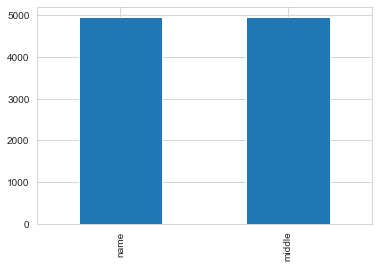

In [115]:
prisonhistory[prisonhistory.columns[prisonhistory.isna().sum() > 0]].isna().sum().sort_values().plot.bar();
prisonhistory.name.isna().sum(), prisonhistory.middle.isna().sum()
#both name and middle miss in all cases

In [116]:
#jailhistory[jailhistory.columns[jailhistory.isna().sum() > 0]].isna().sum().sort_values().plot.bar();
#no missing values

In [117]:
#compas[compas.columns[compas.isna().sum() > 0]].isna().sum().sort_values().plot.bar();
#no missing values

(6, 573, 573, 56837)

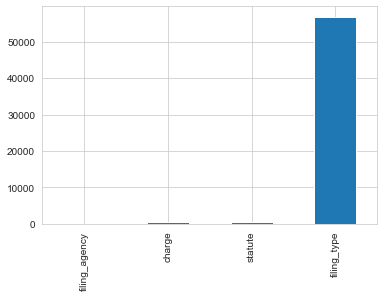

In [118]:
charge[charge.columns[charge.isna().sum() > 0]].isna().sum().sort_values().plot.bar();
charge.filing_agency.isna().sum(), charge.charge.isna().sum(), charge.statute.isna().sum(), charge.filing_type.isna().sum()
#keeping in mind that this dataframe has 150000 rows, the missing data is relatively small.
#since none of the columns are interesting for our modelling, we will not preprocess missing values here.

11757

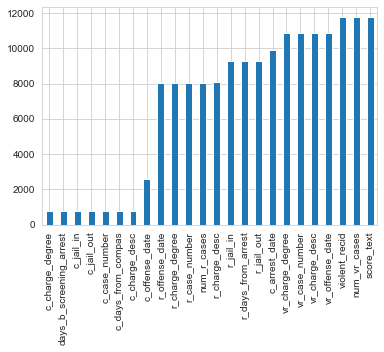

In [119]:
people[people.columns[people.isna().sum() > 0]].isna().sum().sort_values().plot.bar();
people.violent_recid.isna().sum()
#all the c_ data (except offense_date and c_arrest data) seem linked
#all the r_ data seem linked, however seperated in offense_date - num_r_cases and jain_in - jail_out
#all the vr_ data seem linked
#the variables violent_recid, num_vr_cases, score_text are all fully empty

## Dealing with missing data
- For prisonhistory no action is needed, we do not need the specific names, but instead should focus on person_id instead 
- The missing data from charge is not relevant for further evaluation, thus, will not be dealt with / analysed
- the missing data from people needs to be further looked at.

-> Missing data will be handled on the final DataFrame


## Exploring recoding

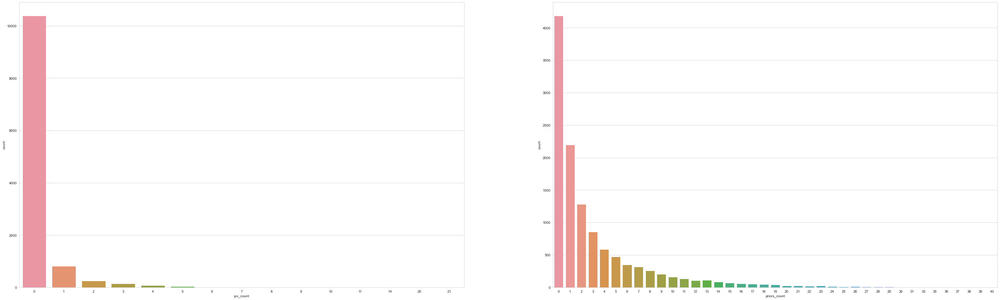

In [120]:
#is juv_count part of priors_count?
people["juv_count"] = people["juv_fel_count"] + people["juv_misd_count"] + people["juv_other_count"]
#plot juvenile crime count vs. overall crime count
fig, ax =plt.subplots(1,2, figsize = (50,15))
ax1 = sns.countplot(x = "juv_count", data = people, ax = ax[0])
ax2 = sns.countplot(x = "priors_count", data = people, ax = ax[1])

In [121]:
list(people.priors_count < people.juv_count).count(True)
#This means juvenile count is not counting towards priors count

212

In [122]:
#spearmanr(people.priors_count, people.juv_count)
#this correlation is significant, however not considered colinear

In [123]:
#How does c_charge_degree work? Is it the highest charge? Is it the latest charge?
people[["name","c_charge_degree"]]

,name,c_charge_degree
0,miguel hernandez,(F3)
1,michael ryan,None
2,kevon dixon,(F3)
3,ed philo,(F3)
4,marcu brown,(F3)
...,...,...
11752,patrick hamilton,(F3)
11753,raymond hernandez,(M1)
11754,dieuseul pierre-gilles,(M1)
11755,scott lomagistro,(M1)


In [124]:
#charge[charge["name"] == "miguel hernandez"] #highest: F3, latest: 0  ; F3/M1
#charge[charge["name"] == "kevon dixon"] #highest: F2, latest: F2/F3
#charge[charge["name"] == "michael ryan"] #highest: M1, latest: 0 ;  M1
#charge[charge["name"] == "patrick hamilton"] #highest: F3, latest: F3
#charge[charge["name"] == "marcu brown"] #highest: F3, latest: 0; F3

#this check makes it unclear, how c_charge_degree is coded and what it means - we will probably need to rebuild the variable.

## Feature selection

- from people (unchanged):
    - id, name, race, sex, age, priors_count, (juv_fel_count, juv_misd_count, juv_other_count), decile_score, is_recid, is_violent_recid
    - compas.screening_date is only used as a filter
    - days_b_screening_arrest is only used as a filter
    
- others (recoded):
    - compas.marital_status (recode into "in relationship (=1)", "not in relationship (=0)")
    
- others (aggregated):
    - charge.charge_degree (highest charge received)
    - charge.offense_date and charge.days_since_compas and people.c_jail_out (used to calculate the non-jail time since the last crime that has been commited)
    - charge.charge_degree (Sum of heavy crimes (charge degree 1-5) commited)
    - charge.charge_degree (Sum of little crimes ("0") commited)
    - charge.charge_number (average number of chargers which are trialed at once)

    
* Note: There should be at least two differnt models -> one of them to include race, sex and age; one of them does not includes them
* with this approach, we first of all want to show whether "discrimination" may sometimes be justified and to what extend it influences the specific cases (biggest changes for specific cases as addition to overall change)
* 2nd Note: Using the compas score is also discussable - because we dont know which information it includes.

### Grabbing existing variables

In [125]:
#we take compas_2y as basis, assuming that they correctly identified relevant cases, which recommited within 2 years 
#Quote:"We plotted the distribution of these scores for 6,172 defendants who had not been arrested for a new offense or who had recidivated within two years."
basis = compas_2y[["id", "name", "race", "sex", "age", "priors_count", "juv_fel_count", "juv_misd_count", "juv_other_count", "decile_score", "two_year_recid", "is_violent_recid", "days_b_screening_arrest"]]
basis.rename(columns = {"id" : "person_id"}, inplace = True)
basis.head()

,person_id,name,race,sex,age,priors_count,juv_fel_count,juv_misd_count,juv_other_count,decile_score,two_year_recid,is_violent_recid,days_b_screening_arrest
0,1,miguel hernandez,Other,Male,69,0,0,0,0,1,0,0,-1.0
1,3,kevon dixon,African-American,Male,34,0,0,0,0,3,1,1,-1.0
2,4,ed philo,African-American,Male,24,4,0,0,1,4,1,0,-1.0
3,5,marcu brown,African-American,Male,23,1,0,1,0,8,0,0,NaN
4,6,bouthy pierrelouis,Other,Male,43,2,0,0,0,1,0,0,NaN


In [126]:
#Grab the screening_date, as this will be relevant for a later filter
compas_rel = compas[compas["type_of_assessment"] == "Risk of Recidivism"][["person_id","screening_date"]]
compas_rel.drop_duplicates(subset = "person_id", inplace = True)
compas_rel.head()

,person_id,screening_date
1,1,2013-08-14 00:00:00.000000
4,2,2014-12-31 00:00:00.000000
7,3,2013-01-27 00:00:00.000000
10,4,2013-04-14 00:00:00.000000
13,5,2013-01-13 00:00:00.000000


### Recoding Relationship status

In [127]:
#map relationship status
In_Relationship = {"Divorced" : 0, "Separated" : 0, "Single" : 0, "Unknown" : 0, "Widowed" : 0,
                  "Significant Other" : 1, "Married" : 1}

map_rs_status = compas.copy()
map_rs_status["relationship"] = map_rs_status["marital_status"].map(In_Relationship)
map_rs_status = map_rs_status[["person_id", "relationship"]].groupby(by = "person_id").relationship.min().reset_index()
map_rs_status.head()

,person_id,relationship
0,1,0
1,2,0
2,3,0
3,4,0
4,5,0


### maximum charge degree

In [128]:
#map new df
Degrees = {"(CT)" : 0, "(0)" : 0,
          "(CO3)" : 1, "(MO3)" : 1, "(NI0)" : 1, "(TC4)" : 1, "(TCX)" : 1, "(M1)" : 1, "(M2)" : 1, "(M3)" : 1,
          "(F1)" : 4, "(F2)" : 3, "(F3)" : 2, "(F5)" : 5, "(F6)" : 5, "(F7)" : 5}

map_charge_degree = charge.copy()
map_charge_degree["max_charge_degree"] = map_charge_degree["charge_degree"].map(Degrees)

In [129]:
#for every person_id get the closest charge to the compas_date, later this will be filtered to make sure all persons were tested within legitimate time
#if persons were not tested within legitimate time, we assume the data row as invalid (filter happens later)
min_days_compas_list = []
for i in list(set(list(map_charge_degree.person_id))):
    if map_charge_degree[(map_charge_degree["person_id"] == i) & (map_charge_degree["days_since_compas"] >= -30)].shape[0] > 0:
        min_days_compas_list.append([i, min(map_charge_degree[(map_charge_degree["person_id"] == i) & (map_charge_degree["days_since_compas"] >= -30)].days_since_compas, key = abs)])
    else: min_days_compas_list.append([i, np.nan])

In [130]:
#Merge the list with the mapped charge dataframe
min_days_compas = pd.DataFrame(min_days_compas_list, columns = ["person_id","min_days_since_compas"])
charge_history = map_charge_degree.merge(min_days_compas, on = "person_id")
#as propublica said, everyone higher than +-30 days is likely a mistake and will thus be dropped
#(everything within 30 days will be counted as present crime if there is no crime closer to 0)
#although this approach is likely inaccurate (taking compas before crime commited?!) we dont have a better approach
charge_history = charge_history[charge_history["min_days_since_compas"] >= -30] 

In [131]:
#initialize a list to contain all indexes of charges that were commited after the compas screening
droplist = []
#fill list with charges with lower days number (=newer) than the expected compas test date
for i in list(charge_history.index):
    if charge_history.days_since_compas[i] < charge_history.min_days_since_compas[i]: droplist.append(i)
droplist.sort(reverse = True)

In [132]:
#drop the future cases
charge_history.drop(index = droplist, inplace = True)

In [133]:
#create df out of it - containing maximum charge_degree for every person
max_charge_degree = charge_history.groupby(by = "person_id").max_charge_degree.max().reset_index()
max_charge_degree.head()

,person_id,max_charge_degree
0,1,2.0
1,3,2.0
2,4,2.0
3,5,2.0
4,6,5.0


### none-jail time since last crime (dropped later)

NOTE: this is an excellent example of why you should always comment on your code - looking back at it after 3 weeks I am not sure
of what my plan and logic was - since this will be dropped later, you may skip this part

However, it have been left in, in case it could be interesting later on

In [134]:
#get a date dataframes, which will be merged on person_id
compas_date = people[["id","compas_screening_date"]].copy()
compas_date.rename(columns = {"id" : "person_id"}, inplace = True)

jail_out_date = jailhistory[["person_id", "out_custody"]]
prison_out_date = prisonhistory[["person_id", "out_custody"]]

In [135]:
#merge the dataframes to get one dataframe containing the date each person went out of custody and the screening date (difference is none-jail time since last crime)
#merging the jail df
jail_comp = jail_out_date.merge(compas_date, how = "left", on = "person_id")
jail_comp = jail_comp.astype({"out_custody":"datetime64[ns]","compas_screening_date":"datetime64[ns]"})
jail_comp["diff_time"] = jail_comp.compas_screening_date - jail_comp.out_custody 
jail_comp = jail_comp[jail_comp["diff_time"] > "0 days"]
jail_comp =  jail_comp.groupby("person_id").diff_time.min().reset_index()

In [136]:
#merging the prison df
prison_comp = prison_out_date.merge(compas_date, how = "left", on ="person_id")
prison_comp = prison_comp.astype({"out_custody":"datetime64[ns]","compas_screening_date":"datetime64[ns]"})
prison_comp["diff_time2"] = prison_comp.compas_screening_date - prison_comp.out_custody
prison_comp = prison_comp[prison_comp["diff_time2"] > "0  days"]
prison_comp = prison_comp.groupby("person_id").diff_time2.min().reset_index()

In [137]:
#merge prison df with jail df
prison_jail_min = jail_comp.merge(prison_comp, how = "inner", on = "person_id")

#select only the time out of jail / prison that was the latest 
conditions = [prison_jail_min['diff_time'] < prison_jail_min['diff_time2'], prison_jail_min['diff_time'] > prison_jail_min['diff_time2']]
choices = ['diff_time', 'diff_time2']
prison_jail_min['time_out_of_jail'] = np.select(conditions, choices, default='Tie')

for i in prison_jail_min.index: 
    if prison_jail_min.time_out_of_jail[i] == "diff_time2": prison_jail_min.time_out_of_jail[i] = prison_jail_min.diff_time2[i]
    elif prison_jail_min.time_out_of_jail[i] == "diff_time": prison_jail_min.time_out_of_jail[i] = prison_jail_min.diff_time[i]

prison_jail_min.drop(["diff_time2", "diff_time"], inplace = True, axis = 1)
consol_list = list(prison_jail_min.person_id)

In [138]:
jail_comp["in_jail"] = jail_comp.person_id.isin(consol_list)
jail_comp = jail_comp[jail_comp["in_jail"] == False]
jail_comp.drop("in_jail", inplace = True, axis = 1)
jail_comp.rename(columns = {"diff_time" : "time_out_of_jail"}, inplace = True)

In [139]:
prison_comp["in_jail"] = prison_comp.person_id.isin(consol_list)
prison_comp = prison_comp[prison_comp["in_jail"] == False]
prison_comp.drop("in_jail", inplace = True, axis = 1)
prison_comp.rename(columns = {"diff_time2" : "time_out_of_jail"}, inplace = True)

In [140]:
prison_jail_min_2 = prison_jail_min.append(prison_comp)
prison_jail_min_2 = prison_jail_min_2.append(jail_comp)
prison_jail_min_2.sort_values(by = "person_id", inplace = True)
for i in list(prison_jail_min_2.person_id):
    if list(prison_jail_min_2.person_id).count(i) > 1: print(i)
p_j_min = prison_jail_min_2.copy()

In [141]:
p_j_min["time_out_jail_days"] = p_j_min.time_out_of_jail.astype("timedelta64[D]")
p_j_min["time_out_jail_days"] = p_j_min.time_out_jail_days / pd.Timedelta(days = 1)

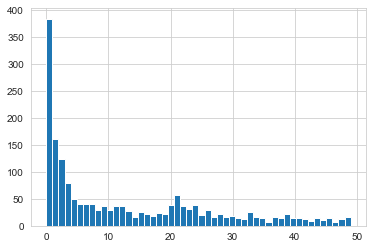

In [142]:
hist_p_j = p_j_min[p_j_min["time_out_jail_days"] < 50]
plt.hist(hist_p_j.time_out_jail_days, bins = 50)
plt.show()

In [143]:
#Since we cant really comprehend whether some of these before 30days were actually reoffendings or the compas-test, we drop everything younger than 30days.
ooj_time = p_j_min[p_j_min["time_out_jail_days"] > 30][["person_id","time_out_jail_days"]]

### number of charges per charge degree (as defined above)

In [144]:
#max_charge_degree here is not a logical name, since its not aggregated yet in charge_history 
#it refers to the degree of the respective charge - as such it will be grouped by id and then counted
#this is done for all of our predefined charge degrees

#this may help understanding:
charge_history.head(5)

,id,case_type,case_number,filing_date,offense_date,charge_number,charge_degree,charge,date_charge_filed,filing_type,filing_agency,name,days_since_compas,statute,person_id,max_charge_degree,min_days_since_compas
0,1,,13005832CF10A,1800-01-01 00:00:00.000000,2013-04-23 00:00:00.000000,1,(F3),Driving While License Revoked,2013-04-23 00:00:00,No Information/ Transfer to Misdemeanor,Fort Lauderdale PD,aajah herrington,1,322.34(5),533,2.0,1.0
1,2,,13005832CF10A,1800-01-01 00:00:00.000000,2013-04-23 00:00:00.000000,2,(M2),Petit Theft,2013-04-23 00:00:00,Transfer to County Court,Fort Lauderdale PD,aajah herrington,1,812.014(3)(a),533,1.0,1.0
4,5,,11065568TI30A,1800-01-01 00:00:00.000000,2011-07-03 00:00:00.000000,1,(0),Violation Of Move Over Law,2011-07-03 00:00:00,None,Broward Sheriff Office,aajah herrington,661,316.126(1)(B)1,533,0.0,1.0
5,6,,11065568TI30A,1800-01-01 00:00:00.000000,2011-07-03 00:00:00.000000,2,(0),Pers/Inj/Prot/Ins Require,2011-07-03 00:00:00,None,Broward Sheriff Office,aajah herrington,661,316.646(1),533,0.0,1.0
6,7,,12039549TI30A,1800-01-01 00:00:00.000000,2012-03-03 00:00:00.000000,1,(0),Pers/Inj/Prot/Ins Require,2012-03-03 00:00:00,None,Broward Sheriff Office,aajah herrington,417,316.646(1),533,0.0,1.0


In [145]:
charges_0 = charge_history[charge_history["max_charge_degree"] == 0]
sum_crimes_0 = charges_0.groupby("person_id").max_charge_degree.count().reset_index()
sum_crimes_0.rename(columns = {"max_charge_degree" : "sum_charges_0"}, inplace = True)

In [146]:
charges_1 = charge_history[charge_history["max_charge_degree"] == 1]
sum_crimes_1 = charges_1.groupby("person_id").max_charge_degree.count().reset_index()
sum_crimes_1.rename(columns = {"max_charge_degree" : "sum_charges_1"}, inplace = True)

In [147]:
charges_2 = charge_history[charge_history["max_charge_degree"] == 2]
sum_crimes_2 = charges_2.groupby("person_id").max_charge_degree.count().reset_index()
sum_crimes_2.rename(columns = {"max_charge_degree" : "sum_charges_2"}, inplace = True)

In [148]:
charges_3 = charge_history[charge_history["max_charge_degree"] == 3]
sum_crimes_3 = charges_3.groupby("person_id").max_charge_degree.count().reset_index()
sum_crimes_3.rename(columns = {"max_charge_degree" : "sum_charges_3"}, inplace = True)

In [149]:
charges_4= charge_history[charge_history["max_charge_degree"] == 4]
sum_crimes_4= charges_4.groupby("person_id").max_charge_degree.count().reset_index()
sum_crimes_4.rename(columns = {"max_charge_degree" : "sum_charges_4"}, inplace = True)

In [150]:
charges_5 = charge_history[charge_history["max_charge_degree"] == 5]
sum_crimes_5 = charges_5.groupby("person_id").max_charge_degree.count().reset_index()
sum_crimes_5.rename(columns = {"max_charge_degree" : "sum_charges_5"}, inplace = True)

### average crime number commited per trial

In [151]:
#average crime number commited per trial
avg_crime_per_trial = charge_history.copy()
avg_crime_per_trial = avg_crime_per_trial[["charge_number", "case_number", "person_id"]]
#group by person id, taking the mean on charge_number
charges_count = avg_crime_per_trial.groupby("person_id").charge_number.count().reset_index()
#charges_count["number_trials"] = 
trials_count = avg_crime_per_trial.groupby("person_id").case_number.nunique().reset_index()
trials_count.columns = ["person_id", "trials_count"]
avg_crime_per_trial = charges_count.merge(trials_count, how = "left", on = "person_id")
avg_crime_per_trial["mean_charges_per_case"] = avg_crime_per_trial.charge_number / avg_crime_per_trial.trials_count
avg_crime_per_trial.drop(columns = ["charge_number", "trials_count"], inplace = True)
avg_crime_per_trial.head()

,person_id,mean_charges_per_case
0,1,1.500000
1,3,1.000000
2,4,2.111111
3,5,1.250000
4,6,1.333333


### Merging the dataframe

In [152]:
j1 = basis.merge(map_rs_status, how = "left", on = "person_id")

In [153]:
j2 = j1.merge(max_charge_degree, how = "left", on = "person_id")

In [154]:
j3 = j2.merge(ooj_time, how = "left", on = "person_id")

In [155]:
j4 = j3.merge(sum_crimes_0, how = "left", on = "person_id")
j5 = j4.merge(sum_crimes_1, how = "left", on = "person_id")
j6 = j5.merge(sum_crimes_2, how = "left", on = "person_id")
j7 = j6.merge(sum_crimes_3, how = "left", on = "person_id")
j8 = j7.merge(sum_crimes_4, how = "left", on = "person_id")
j9 = j8.merge(sum_crimes_5, how = "left", on = "person_id")

In [645]:
j10 = j9.merge(avg_crime_per_trial, how = "left", on = "person_id")
df = j10.merge(compas_rel, how = "left", on = "person_id")
df.shape

(7214, 24)

In [647]:
#lets rename charge_number to something more obvious
df.rename(columns = {"charge_number":"mean_charges_per_case"}, inplace = True)

## Data selection

- by ProPublica: (quoted from their notebook)
    * If the charge date of a defendants Compas scored crime was not within 30 days from when the person was arrested, we assume that because of data quality reasons, that we do not have the right offense.
    * We coded the recidivist flag -- `is_recid` -- to be -1 if we could not find a compas case at all.
    * In a similar vein, ordinary traffic offenses -- those with a `c_charge_degree` of 'O' -- will not result in Jail time are removed (only two of them).
    * We filtered the underlying data from Broward county to include only those rows representing people who had either recidivated in two years, or had at least two years outside of a correctional facility.
    
- by WashingtonPost: (did the same but furthermore)
    * cases involving defendants who are either white or black
    * for which a full two years of recidivism information is available. 
    * looks at all recividivsm (not just violent recidivism)

### Dropping data (and shaping the df to our scientific needs)

#### Why should we drop data with screening date after April 1st 2014?

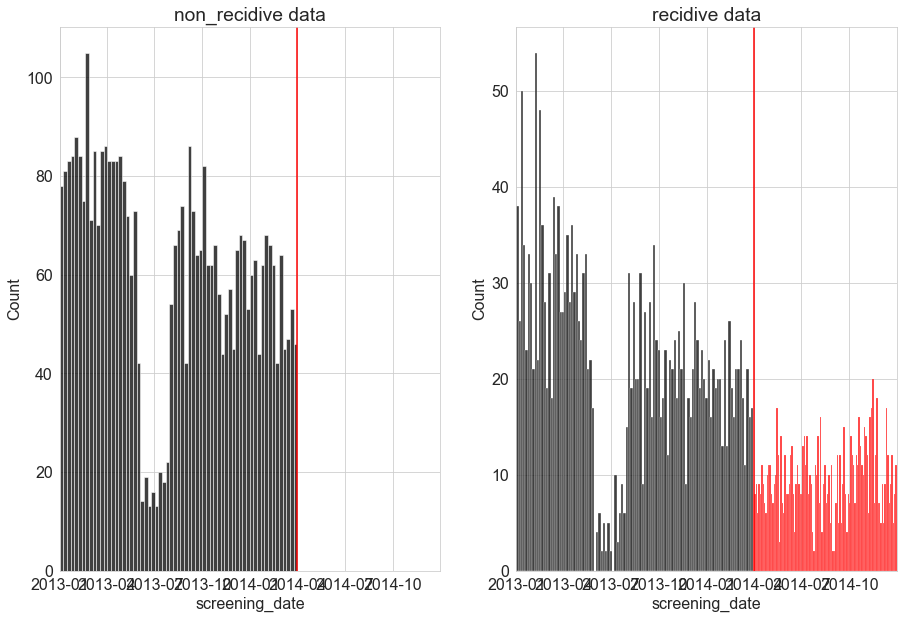

In [648]:
#Barenstein, M. 2019, ProPublica’s COMPAS Data Revisited
#why should we drop screening dates after 01-04-2014? -> data collection stopped 01-04-2016;
#as such everybody after 01-04-2014 didnt have full two years to recommit crimes!
import datetime
df.screening_date= pd.to_datetime(df['screening_date'])
df_r_pre_april = df[(df.two_year_recid == 1) & (df.screening_date < "2014-04-01")]
df_r_post_april = df[(df.two_year_recid == 1) & (df.screening_date > "2014-04-01")]
df_nr = df[df.two_year_recid == 0]


sns.set_style("whitegrid")
fig, ax = plt.subplots(1, 2, figsize = (15,10))

sns.histplot(df_nr.screening_date, bins = 65, ax = ax[0], color = "black")
plt.setp(ax[0], xlim=[datetime.date(2013, 1, 1), datetime.date(2014, 12, 31)])
ax[0].set_title("non_recidive data")
ax[0].axvline(datetime.date(2014, 4, 1), color = "r")

sns.histplot(df_r_pre_april.screening_date, bins = 104, ax = ax[1], color = "black")
sns.histplot(df_r_post_april.screening_date, bins = 104, ax = ax[1], color = "red")
plt.setp(ax[1], xlim=[datetime.date(2013, 1, 1), datetime.date(2014, 12, 31)])
ax[1].set_title("recidive data")
ax[1].axvline(datetime.date(2014, 4, 1), color = "r")

In [649]:
#Why do we not just fill those persons in from the people dataframe?
#How many of the 2-year recommiters recommit after 500 days (1.25 years (because up to 0.75 years were not screened)
charge_future = map_charge_degree.merge(min_days_compas, on = "person_id")
droplist_future = []
#fill list with charges with lower days number (=newer) than the expected compas test date
for i in list(charge_future.index):
    if charge_future.days_since_compas[i] > (charge_future.min_days_since_compas[i] - 1): droplist_future.append(i) #the "-1" helps to get the int / float diff in order
droplist_future.sort(reverse = True)
#drop the future cases
charge_future.drop(index = droplist_future, inplace = True)
#get a dataframe that has the earliest reoffending and was screened before 2014-04-01
earliest_reoffend = charge_future.groupby("person_id").days_since_compas.max().reset_index()
earliest_reoffend = earliest_reoffend.merge(compas[compas.scale_id == 8][["person_id","screening_date"]], on = "person_id")
earliest_reoffend.screening_date= pd.to_datetime(earliest_reoffend['screening_date'])
earliest_reoffend = earliest_reoffend[earliest_reoffend.screening_date < "2014-04-01"]
#Calculate the quota
earliest_reoffend[(earliest_reoffend.days_since_compas < -500) & (earliest_reoffend.days_since_compas > -730)].count()/earliest_reoffend[earliest_reoffend.days_since_compas > -730].person_id.nunique()
#13.19% of 2-year-recommiters recommit after 500 days!
#Maybe filling the data for the non_recidive people until 2014-12-01 could be a decent approach, however, the number of errors being made increases every day (up to 13.19%)

person_id            0.131855
days_since_compas    0.131855
screening_date       0.131855
dtype: float64

In [662]:
#The article that suggests that we need to cut off at 2014-04-01, also said that a better cutoff is at 2014-01-15
#How much would we drop extra?
df[df.screening_date <= "2014-04-01"].shape, df[df.screening_date <= "2014-01-15"].shape
#this would mean dropping 908 (not including other filters, which may drop the same row anyways) extra rows

((6216, 24), (5308, 24))

In [663]:
df[df.screening_date <= "2014-04-01"].groupby("two_year_recid").person_id.count()

two_year_recid
0    3963
1    2253
Name: person_id, dtype: int64

In [664]:
2253/(3963+2253) #this way we have a recidivism rate of 36,25%

0.3624517374517375

In [665]:
df[df.screening_date <= "2014-01-15"].groupby("two_year_recid").person_id.count()

two_year_recid
0    3380
1    1928
Name: person_id, dtype: int64

In [667]:
1928 / (3380 + 1928) #the recidivism rate stays basically the same
#Dropping the additional 908 rows would further decrease the sample size, thus, we decided to balance accuracy of data (which goes down a little more)
#versus data quantity 

0.3632253202712886

#### Actually dropping the data

In [642]:
#dropping data
df = df[df["days_b_screening_arrest"] != ""]
#As explained before, we set the cut-off on screening date on April 1st, another option would be earlier (January 15th), to have the most accurate data
#for more info see Barenstein, M. 2019, ProPublica’s COMPAS Data Revisited
#However, we wanted to balance the criticism given by the article with sample size and decided to use April 1st instead.
df = df[df["screening_date"] <= "2014-04-01"] #drops 1010 rows
df = df[(df["days_b_screening_arrest"] <= 30) & (df["days_b_screening_arrest"] >= -30)] #drops 907 rows

### Handling missing data

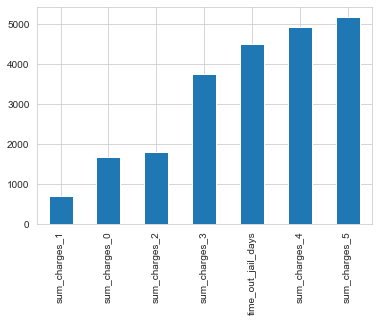

In [163]:
#finding missing data (which we created a bunch)
df[df.columns[df.isna().sum() > 0]].isna().sum().sort_values().plot.bar();

In [164]:
#filling missing data in sum_charges with 0 (because the dataframe put NaN if it couldnt count any earlier)
df.sum_charges_5.fillna(0, inplace = True)
df.sum_charges_4.fillna(0, inplace = True)
df.sum_charges_3.fillna(0, inplace = True)
df.sum_charges_2.fillna(0, inplace = True)
df.sum_charges_1.fillna(0, inplace = True)
df.sum_charges_0.fillna(0, inplace = True)

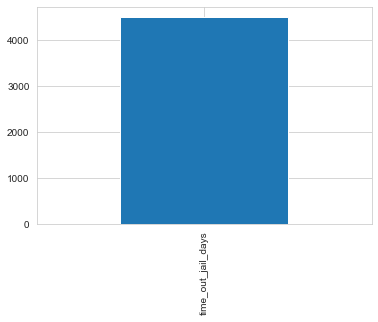

In [165]:
df[df.columns[df.isna().sum() > 0]].isna().sum().sort_values().plot.bar();

In [166]:
print(f" given that {df.time_out_jail_days.isna().sum() / df.shape[0] * 100}% of the data is missing for the time out of jail, it and the knowledge, that a higher number than these commited crimes, which are likely ending in jail (max_charge: 3+), we can assume that the data is too inconsitent, and drop it instead.")

 given that 84.91704374057315% of the data is missing for the time out of jail, it and the knowledge, that a higher number than these commited crimes, which are likely ending in jail (max_charge: 3+), we can assume that the data is too inconsitent, and drop it instead.


In [167]:
df.drop(columns = "time_out_jail_days", inplace = True)

In [168]:
#drop filter columns
df.drop(columns = ["screening_date", "days_b_screening_arrest"], inplace = True)

In [169]:
df.shape

(5304, 21)

In [170]:
df.groupby("two_year_recid").person_id.count()
#this df will in future be reimported from a file (dataframe is identical, but it makes data management easiert)

two_year_recid
0    3363
1    1941
Name: person_id, dtype: int64

# Linear Models 

## Prep Linear Models

In [5]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

from sklearn.model_selection import train_test_split, cross_val_score, GridSearchCV, RandomizedSearchCV, RepeatedKFold
from sklearn.metrics import accuracy_score, classification_report, precision_score, recall_score, confusion_matrix, precision_recall_curve, roc_curve, auc, log_loss, roc_auc_score, f1_score 
from sklearn.linear_model import LogisticRegression, Lasso, Ridge, ElasticNet
from sklearn.preprocessing import StandardScaler, MinMaxScaler, OneHotEncoder, RobustScaler, QuantileTransformer
from sklearn.pipeline import Pipeline
from sklearn.compose import ColumnTransformer
from sklearn.ensemble import RandomForestClassifier
from sklearn.feature_selection import SelectFromModel
from sklearn.inspection import plot_partial_dependence, permutation_importance

def model_metrics(objective, prediction):
    score = accuracy_score(objective, prediction)
    class_report = classification_report(objective, prediction)
    model_metrics = [score, class_report]
    return(model_metrics)

def plot_feature_importance(importances,var_hidden,cumsum_hidden):
    ## Put in a pandas dtf
    dtf_importances = pd.DataFrame({"IMPORTANCE":importances, 
                "VARIABLE":feature_list}).sort_values("IMPORTANCE", 
                ascending=False)
    dtf_importances['cumsum'] =  dtf_importances['IMPORTANCE'].cumsum(axis=0)
    dtf_importances = dtf_importances.set_index("VARIABLE")    
    
    ## Plot
    fig, ax = plt.subplots(nrows=1, ncols=2, sharex=False, sharey=False,figsize=(20,7),gridspec_kw={'width_ratios': [2, 4]})
    #fig.suptitle("Features Importance", fontsize=12)
    ax[0].title.set_text('variables')
    dtf_importances[["IMPORTANCE"]].sort_values(by="IMPORTANCE").plot(kind="barh", legend=False, ax=ax[0]).grid(axis="x")
    ax[0].set(ylabel="")
    if var_hidden == 0:
        ax[0].set_visible(True)
    elif var_hidden == 0:
        ax[0].set_visible(False)
    ax[1].title.set_text('cumulative')
    dtf_importances[["cumsum"]].plot(kind="line", linewidth=4, 
                                     legend=False, ax=ax[1])
    ax[1].set(xlabel="", xticks=np.arange(len(dtf_importances)), 
              xticklabels=dtf_importances.index)
    if cumsum_hidden == 0:
        ax[1].set_visible(True)
    elif cumsum_hidden == 1:
        ax[1].set_visible(False)
    plt.xticks(rotation=70)
    plt.grid(axis='both')
    plt.show()

def calculateRates (X_test, y_test, y_pred): #no dummy coding in X_test set
    from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
    test = X_test
    test['red_pred'] = y_pred.tolist()
    test['two_year_red'] = y_test.tolist()
    
    races = test.groupby(['race_group','red_pred','two_year_red']).size().reset_index(name='counts')
    
    afr_tp = (races[(races.race_group==0) & (races.two_year_red == 1) & (races.red_pred ==1)]['counts'].values[0])
    afr_fp = (races[(races.race_group==0) & (races.two_year_red == 0) & (races.red_pred ==1)]['counts'].values[0])
    afr_fn = (races[(races.race_group==0) & (races.two_year_red == 1) & (races.red_pred ==0)]['counts'].values[0])
    afr_tn = (races[(races.race_group==0) & (races.two_year_red == 0) & (races.red_pred ==0)]['counts'].values[0])
    
    cau_tp = (races[(races.race_group==1) & (races.two_year_red == 1) & (races.red_pred ==1)]['counts'].values[0])
    cau_fp = (races[(races.race_group==1) & (races.two_year_red == 0) & (races.red_pred ==1)]['counts'].values[0])
    cau_fn = (races[(races.race_group==1) & (races.two_year_red == 1) & (races.red_pred ==0)]['counts'].values[0])
    cau_tn = (races[(races.race_group==1) & (races.two_year_red == 0) & (races.red_pred ==0)]['counts'].values[0])

    other_tp = (races[(races.race_group==10) & (races.two_year_red == 1) & (races.red_pred ==1)]['counts'].values[0])
    other_fp = (races[(races.race_group==10) & (races.two_year_red == 0) & (races.red_pred ==1)]['counts'].values[0])
    other_fn = (races[(races.race_group==10) & (races.two_year_red == 1) & (races.red_pred ==0)]['counts'].values[0])
    other_tn = (races[(races.race_group==10) & (races.two_year_red == 0) & (races.red_pred ==0)]['counts'].values[0])

    tn, fp, fn, tp = confusion_matrix(y_test, y_pred, labels=[0, 1]).ravel()

    #how many % of african american, caucasian, others in TP, FP, FN cases
    afr_in_tp = afr_tp/(tp+fn)
    afr_in_fp = afr_fp/(fp+tn)
    afr_in_fn = afr_fn/(fn+tp)

    cau_in_tp = cau_tp/(tp+fn)
    cau_in_fp = cau_fp/(fp+tn)
    cau_in_fn = cau_fn/(fn+tp)

    oth_in_tp = other_tp/(tp+fn)
    oth_in_fp = other_fp/(fp+tn)
    oth_in_fn = other_fn/(fn+tp)
    
    #calculate TPR, FPR, FNR for each race group
    african_american_tpr = afr_tp/(afr_tp+afr_fn)
    african_american_fpr = afr_fp/(afr_fp+afr_tn)
    african_american_fnr = afr_fn/(afr_fn+afr_tp)

    caucasian_american_tpr = cau_tp/(cau_tp+cau_fn)
    caucasian_american_fpr = cau_fp/(cau_fp+cau_tn)
    caucasian_american_fnr = cau_fn/(cau_fn+cau_tp)

    other_american_tpr = other_tp/(other_tp+other_fn)
    other_american_fpr = other_fp/(other_fp+other_tn)
    other_american_fnr = other_fn/(other_fn+other_tp)
    
    plt.subplots(nrows=1, ncols=2, sharex=False, sharey=False,figsize=(20,7),gridspec_kw={'width_ratios': [2, 2]})

    plt.subplot(1, 2, 1) # row 1, col 2 index 1

    N = 3
    ind = np.arange(N) 
    width = 0.25

    tpr = [afr_in_tp ,cau_in_tp,oth_in_tp]
    bar1 = plt.bar(ind, tpr, width, color = 'g')

    fpr = [afr_in_fp ,cau_in_fp ,oth_in_fp]
    bar2 = plt.bar(ind+width, fpr, width, color='r')

    fnr = [afr_in_fn,cau_in_fn ,oth_in_fn]
    bar3 = plt.bar(ind+width*2, fnr, width, color = 'b')
    plt.xlabel("Races")
    plt.ylabel('%')
    #plt.title("Rate")
    plt.xticks(ind+width,['African American', 'Caucasian', 'Others'])
    plt.legend( (bar1, bar2, bar3), ('% Afr. American in TP', '% Caucasian in FP', '% Others in FN') )


    plt.subplot(1, 2, 2) # index 2
    N = 3
    ind = np.arange(N) 
    width = 0.25

    tpr = [african_american_tpr,caucasian_american_tpr,other_american_tpr]
    bar1 = plt.bar(ind, tpr, width, color = 'g')

    fpr = [african_american_fpr ,caucasian_american_fpr ,other_american_fpr]
    bar2 = plt.bar(ind+width, fpr, width, color='r')

    fnr = [african_american_fnr ,caucasian_american_fnr ,other_american_fnr ]
    bar3 = plt.bar(ind+width*2, fnr, width, color = 'b')
    plt.xlabel("Races")
    plt.ylabel('%')
    #plt.title("Rate")
    plt.xticks(ind+width,['African American', 'Caucasian', 'Others'])
    plt.legend( (bar1, bar2, bar3), ('TPR', 'FPR', 'FNR') )

    plt.show()
    
import warnings
warnings.filterwarnings("ignore") #but helps with keeping overview on the output

In [6]:
#Settings
pd.set_option('display.max_columns', None)

%matplotlib inline

In [7]:
#This dataset will be used for all linear models
#Reload data set and get Train / Test Split
df = pd.read_csv("../data/processed_race_groups_corrected.csv")
df.sex.replace(['Male', 'Female'], [0,1], inplace=True)
df.race.replace(['African-American', 'Caucasian', 'Hispanic', 'Other', 'Asian', 'Native American'], [0,1,2,3,4,5], inplace=True)
df_lin = pd.get_dummies(df, columns=['race_group'], dtype=int)

#Variable Split
X = df_lin.drop(['is_violent_recid','two_year_recid', 'decile_score', 'Unnamed: 0', 'person_id','name', "race"], axis = 1)
y = df_lin['two_year_recid']

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=1)

In [8]:
#This preprocessor will be used for all linear models 
#Transforming (Race) + Scaling (Age) and others --> worked around it lots of times. We tried StandardScaler, RobustScaler, Normalization and others but in the end we went for the quantile --> More information see on sklearn documentation

enc = OneHotEncoder(drop='first')
standard = QuantileTransformer()

crump = ['age', 'priors_count', 'sum_charges_0', 'sum_charges_1', 'sum_charges_2', 'sum_charges_3', 'sum_charges_4', 'sum_charges_5', 'mean_charges_per_case']
cat_cols = []

preprocessor = ColumnTransformer(transformers=[("cat", enc, cat_cols), ("crump", standard, crump)], remainder='passthrough')

## Logistic Regression

### Logistic regression Implementation

In [175]:
#Model Implemenation with Pipeline
log = LogisticRegression()

clf = Pipeline(steps=[("preprocessor", preprocessor), ("classifier", log)])
clf.fit(X_train, y_train)

Pipeline(steps=[('preprocessor',
                 ColumnTransformer(remainder='passthrough',
                                   transformers=[('cat',
                                                  OneHotEncoder(drop='first'),
                                                  []),
                                                 ('crump',
                                                  QuantileTransformer(),
                                                  ['age', 'priors_count',
                                                   'sum_charges_0',
                                                   'sum_charges_1',
                                                   'sum_charges_2',
                                                   'sum_charges_3',
                                                   'sum_charges_4',
                                                   'sum_charges_5',
                                                   'mean_charges_per_case'])])),
                ('cla

In [176]:
log_fit = clf.named_steps['classifier']

In [177]:
log_fit.intercept_

array([-0.6400421])

In [178]:
#List columns with coefficients
list(zip(list(X_train.columns), list(log_fit.coef_[0])))

[('sex', -1.7919498332721508),
 ('age', 0.744863279610111),
 ('priors_count', -0.21664476528404186),
 ('juv_fel_count', 1.500821422403234),
 ('juv_misd_count', 0.7616244321241644),
 ('juv_other_count', 0.644463359297549),
 ('relationship', -0.14353169039252542),
 ('max_charge_degree', 0.8058906084567286),
 ('sum_charges_0', -0.5125160999851157),
 ('sum_charges_1', -0.3815400297171906),
 ('sum_charges_2', 0.07721657476258023),
 ('sum_charges_3', 0.02195444026871337),
 ('sum_charges_4', 0.21036309294513877),
 ('sum_charges_5', -0.07633865105561395),
 ('mean_charges_per_case', -0.14642687571961036),
 ('race_group_0', 0.1104450469308978),
 ('race_group_1', 0.039317342172185785),
 ('race_group_10', -0.15072800132440817)]

### Results and Feature Importance in Model

In [179]:
#Calculate R^2 for logit
clf.score(X_test, y_test)

0.7056603773584905

In [180]:
#Predict
y_pred = clf.predict(X_test)

y_pred_proba = clf.predict_log_proba(X_test)[:,1]

In [181]:
print(model_metrics(y_test, y_pred)[0], "\n", model_metrics(y_test,y_pred)[1])

0.7056603773584905 
               precision    recall  f1-score   support

           0       0.74      0.84      0.79      1029
           1       0.61      0.47      0.53       561

    accuracy                           0.71      1590
   macro avg       0.67      0.65      0.66      1590
weighted avg       0.69      0.71      0.69      1590



In [182]:
#Get additional metrics for model comparison
tn, fp, fn, tp = confusion_matrix(y_test, y_pred, labels=[0, 1]).ravel()
fnr_logit = fn / (fn + tp)
fpr_logit = fp / (fp + tn)
fnr_logit, fpr_logit, f1_score(y_test, y_pred), recall_score(y_test, y_pred), precision_score(y_test, y_pred)

(0.5347593582887701,
 0.16326530612244897,
 0.5272727272727273,
 0.46524064171123,
 0.6083916083916084)

In [183]:
#Check for Roc_Auc Score
roc_auc_score(y_test, y_pred_proba)

0.7356232536304564

In [188]:
#The model seems to predict being Not Recidive more accurate + often
cnf_matrix = confusion_matrix(y_test, y_pred)
cnf_matrix

group_names = ['True N.','False P.','False N.','True P.']

group_counts = ["{0:0.0f}".format(value) for value in
                cnf_matrix.flatten()]

group_percentages = ["{0:.2%}".format(value) for value in
                     cnf_matrix.flatten()/np.sum(cnf_matrix)]

labels = [f"{v1}\n{v2}\n{v3}" for v1, v2, v3 in
          zip(group_names,group_counts,group_percentages)]

labels = np.asarray(labels).reshape(2,2)

Text(0.5, 257.44, 'Predicted label')

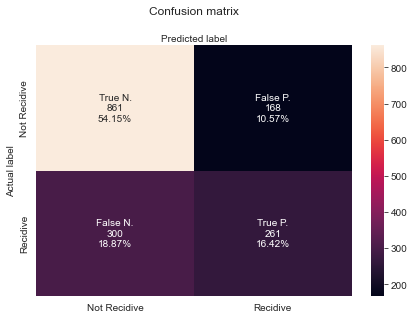

In [189]:
class_names=['Not Recidive', 'Recidive'] # name  of classes
fig, ax = plt.subplots()
tick_marks = np.arange(len(class_names))
plt.xticks(tick_marks, class_names)
plt.yticks(tick_marks, class_names)

sns.heatmap(cnf_matrix, annot=labels, fmt='', xticklabels=class_names, yticklabels=class_names)
ax.xaxis.set_label_position("top")
plt.tight_layout()
plt.title('Confusion matrix', y=1.1) #y=position
plt.ylabel('Actual label')
plt.xlabel('Predicted label')
#The model seems to predict being Not Recidive more accurate + often

### Team Structure Confusion Matrix

<AxesSubplot:>

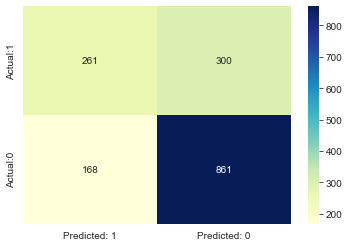

In [190]:
#This is the structure that all of the group has as confusion matrix --> Therefore more comparable
#The model seems to predict being Not Recidive more accurate + often
cm = confusion_matrix(y_test, y_pred, labels=[1,0])

cm_matrix = pd.DataFrame(data=cm, columns=['Predicted: 1','Predicted: 0'], 
                                 index=['Actual:1','Actual:0'])

sns.heatmap(cm_matrix, annot=True, fmt='d', cmap='YlGnBu')

In [191]:
#Acc check for train --> Check for possible overfitting
y_pred_train = clf.predict(X_train)
print("Accuracy:", accuracy_score(y_train, y_pred_train))
print("Precision:", precision_score(y_train, y_pred_train))
print("Recall:", recall_score(y_train, y_pred_train))
print("The log_loss of the " + log.__class__.__name__ + " is %2.2f" % log_loss(y_train, y_pred_train) + ".")

Accuracy: 0.7148637712435932
Precision: 0.6517602283539486
Recall: 0.49781976744186046
The log_loss of the LogisticRegression is 9.85.


In [192]:
#Accuracy check for test
print("Accuracy:", accuracy_score(y_test, y_pred))
print("Precision:", precision_score(y_test, y_pred))
print("Recall:", recall_score(y_test, y_pred))
print("The log_loss of the " + log.__class__.__name__ + " is %2.2f" % log_loss(y_test, y_pred) + ".")

Accuracy: 0.7056603773584905
Precision: 0.6083916083916084
Recall: 0.46524064171123
The log_loss of the LogisticRegression is 10.17.


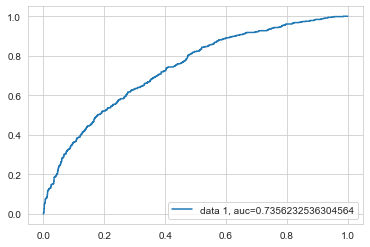

In [193]:
fpr, tpr, _ = roc_curve(y_test,  y_pred_proba)
auc = roc_auc_score(y_test, y_pred_proba)
plt.plot(fpr,tpr,label="data 1, auc="+str(auc))
plt.legend(loc=4)
plt.show()

### PDP & SHAPLY Feature Importance

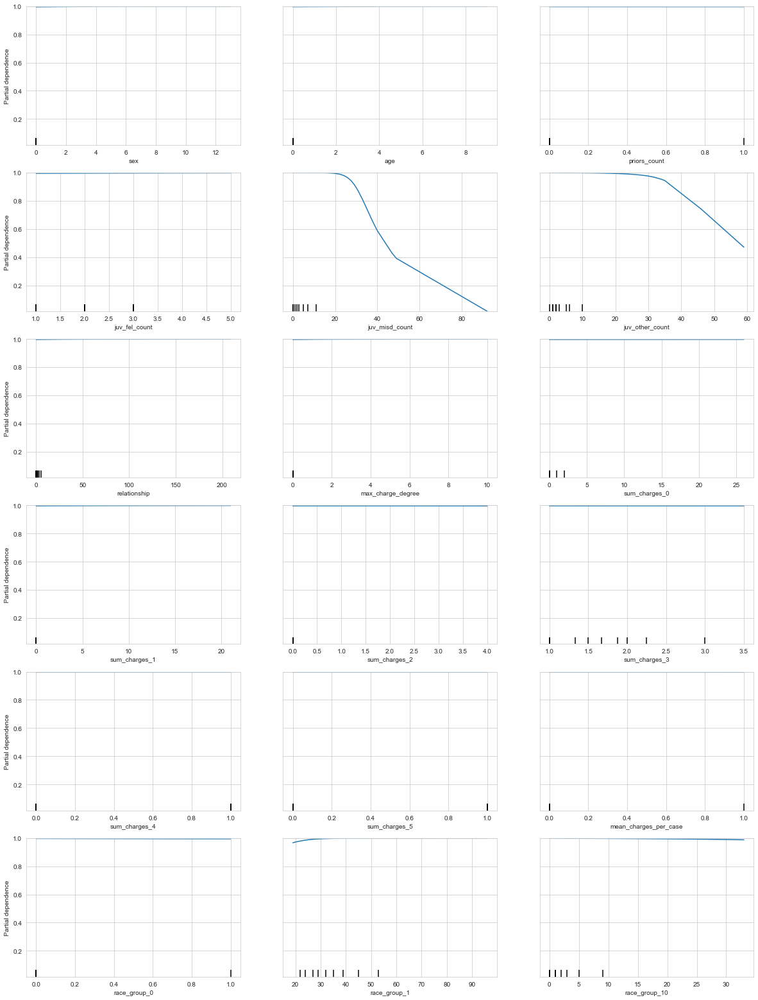

In [194]:
#PDP Plots look weird --> maybe because lots of features have no influence according to logit model
fig, ax = plt.subplots(figsize=(18, 24))
php = plot_partial_dependence(log_fit,
                                   features = X_train.columns, # column numbers of plots we want to show
                                   X=X_train,            # raw predictors data.
                                   feature_names= ['race_group_0', 'race_group_1', 'race_group_10', 'max_charge_degree', 'sex', 'age', 'priors_count', 'juv_fel_count', 'juv_misd_count', 'juv_other_count', 'relationship', 'sum_charges_0', 'sum_charges_1', 'sum_charges_2', 'sum_charges_3', 'sum_charges_4', 'sum_charges_5', 'mean_charges_per_case'], # labels on graphs
                                   grid_resolution=100,
                                     ax=ax) # number of values to plot on x axis

plt.subplots_adjust(top=1, right=1)

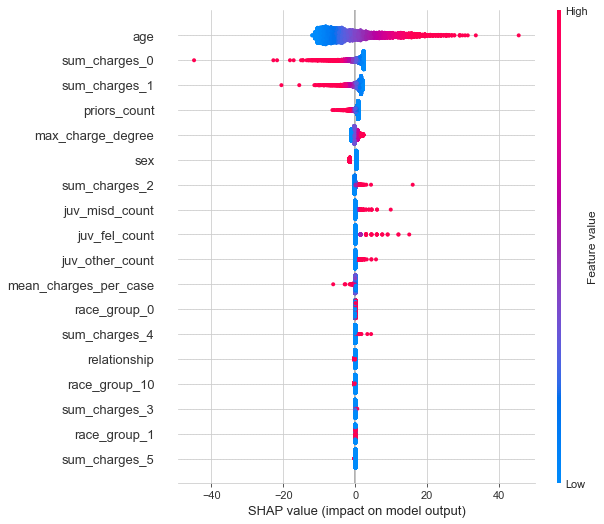

In [195]:
import shap
# explain the model's predictions on test set using SHAP values
# same syntax works for xgboost, LightGBM, CatBoost, and some scikit-learn models ~ Then choose a different Explainer for different models
explainer = shap.LinearExplainer(log_fit, X_train)

# shap_values consists of a list of two matrices of dimension samplesize x #features
# The first matrix uses average nr of "is_recid = 0" as base value
# The second matrix which is used below uses average nr of "is_recid = 1" as base value 
shap_values = explainer.shap_values(X_train)

#A summary plot with the shapley value (feature importance) 
shap.summary_plot(shap_values, X_train)

### Feature Selection (RF-Based)

In [196]:
#max_charge_degree, race --> dummy ohe!
#Work on the Threshold
#Will select those features which importance is greater than the mean importance of all the features by default (MeanGini).
sel = SelectFromModel(RandomForestClassifier(n_estimators = 100))
sel.fit(X_train, y_train)

SelectFromModel(estimator=RandomForestClassifier())

In [197]:
#I want to print the complete list again for all of the features to get a complete list
list(zip(X_train.columns, sel.get_support()))

[('sex', False),
 ('age', True),
 ('priors_count', True),
 ('juv_fel_count', False),
 ('juv_misd_count', False),
 ('juv_other_count', False),
 ('relationship', False),
 ('max_charge_degree', False),
 ('sum_charges_0', True),
 ('sum_charges_1', True),
 ('sum_charges_2', True),
 ('sum_charges_3', False),
 ('sum_charges_4', False),
 ('sum_charges_5', False),
 ('mean_charges_per_case', True),
 ('race_group_0', False),
 ('race_group_1', False),
 ('race_group_10', False)]

In [198]:
#Print the number of all features that are choosen by forest classifier
selected_feat = X_train.columns[(sel.get_support())]
print("Therefore only " + str(len(selected_feat)) + " Features are important for the model, considering the feature selection trough random forrest classifier.")
print("The Names of these features are: " + str(selected_feat))

Therefore only 6 Features are important for the model, considering the feature selection trough random forrest classifier.
The Names of these features are: Index(['age', 'priors_count', 'sum_charges_0', 'sum_charges_1',
       'sum_charges_2', 'mean_charges_per_case'],
      dtype='object')


### Logistic regression with selected features using RFC

In [199]:
X_feat = X[selected_feat]

In [200]:
#Train & Test Split
X_train_feat, X_test_feat, y_train_feat, y_test_feat = train_test_split(X_feat, y, test_size=0.3, random_state=1)

In [201]:
#Same as before withouth feature selection --> Scaling the Data to get a better model
crump = ['age', 'priors_count', 'sum_charges_0', 'sum_charges_1', 'sum_charges_2', 'mean_charges_per_case']

preprocessor_feat = ColumnTransformer(transformers=[("cat", enc, cat_cols), ("crump", standard, crump)], remainder='passthrough')

In [202]:
#Initiating the Pipeline
clf_feat = Pipeline(steps=[("preprocessor", preprocessor_feat), ("classifier", log)])

In [203]:
#Fitting with the Pipeline --> on new dataset with less features
clf_feat.fit(X_train_feat, y_train_feat)

Pipeline(steps=[('preprocessor',
                 ColumnTransformer(remainder='passthrough',
                                   transformers=[('cat',
                                                  OneHotEncoder(drop='first'),
                                                  []),
                                                 ('crump',
                                                  QuantileTransformer(),
                                                  ['age', 'priors_count',
                                                   'sum_charges_0',
                                                   'sum_charges_1',
                                                   'sum_charges_2',
                                                   'mean_charges_per_case'])])),
                ('classifier', LogisticRegression())])

In [204]:
#To get values out of classifier have to extract the classifier out of the pipeline
log_feat = clf_feat.named_steps['classifier']

In [205]:
#Intercept of new logit
log_feat.intercept_

array([-0.88185502])

In [213]:
#Coefficient of new logit as follows: age, priors, sum_0, sum_1, mean_charges
list(zip(X_train_feat.columns,log_feat.coef_[0]))

[('age', -1.944259012599004),
 ('priors_count', 1.0301673125677213),
 ('sum_charges_0', -0.2446084546012746),
 ('sum_charges_1', 1.5290178762346145),
 ('sum_charges_2', 0.7424403865076914),
 ('mean_charges_per_case', -0.43824588888695687)]

### Results and Feature Importance using RFC

In [214]:
#Plotting the most important coefficients from max positive left to max negative right
importances = pd.DataFrame(data={
    'Attribute': X_train_feat.columns,
    'Importance': log_feat.coef_[0]
})
importances = importances.sort_values(by='Importance', ascending=False)

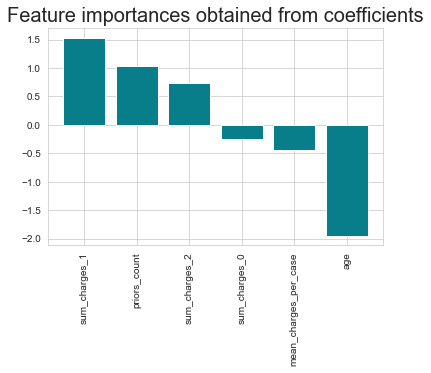

In [215]:
plt.bar(x=importances['Attribute'], height=importances['Importance'], color='#087E8B')
plt.title('Feature importances obtained from coefficients', size=20)
plt.xticks(rotation='vertical')
plt.show()

In [210]:
#R^2 Increase to former model
clf_feat.score(X_test_feat, y_test_feat)

0.7113207547169811

In [219]:
#Get predictions from new model
y_pred_feat = clf_feat.predict(X_test_feat)

y_pred_proba_feat = clf_feat.predict_log_proba(X_test_feat)[:,1]

Text(0.5, 16.0, 'Predicted label')

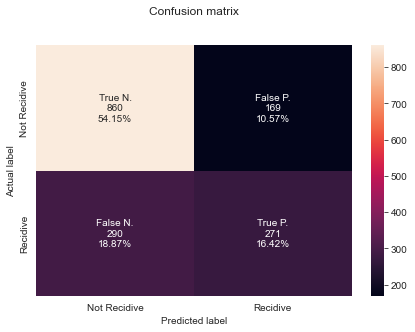

In [220]:
#Confusion Matrix
cnf_matrix_feat = confusion_matrix(y_test_feat, y_pred_feat)

group_counts_feat = ["{0:0.0f}".format(value) for value in
                cnf_matrix_feat.flatten()]

group_percentages_feat = ["{0:.2%}".format(value) for value in
                     cnf_matrix_feat.flatten()/np.sum(cnf_matrix_feat)]

labels_feat = [f"{v1}\n{v2}\n{v3}" for v1, v2, v3 in
          zip(group_names,group_counts_feat,group_percentages)]

labels_feat = np.asarray(labels_feat).reshape(2,2)

# Create Confusion Matrix in Heatmap style
sns.heatmap(cnf_matrix_feat, annot=labels_feat, fmt='', xticklabels=class_names, yticklabels=class_names)
ax.xaxis.set_label_position("top")
plt.tight_layout()
plt.title('Confusion matrix', y=1.1) #y=position
plt.ylabel('Actual label')
plt.xlabel('Predicted label')

### Team Structure Confusion Matrix

<AxesSubplot:>

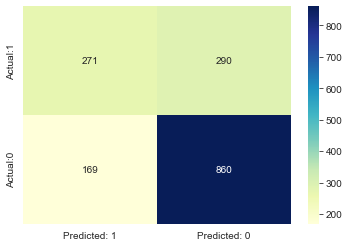

In [221]:
#This is the Team structure of the confusion matrix --> attetion to axes and FN/FP are different position
cm = confusion_matrix(y_test_feat, y_pred_feat, labels=[1,0])

cm_matrix = pd.DataFrame(data=cm, columns=['Predicted: 1','Predicted: 0'], 
                                 index=['Actual:1','Actual:0'])

sns.heatmap(cm_matrix, annot=True, fmt='d', cmap='YlGnBu')

In [222]:
#Accuracy check
y_pred_feat = clf_feat.predict(X_test_feat)
y_pred_proba_feat = clf_feat.predict_log_proba(X_test_feat)[:,1]
print("Accuracy:", accuracy_score(y_test_feat, y_pred_feat))
print("Precision:", precision_score(y_test_feat, y_pred_feat))
print("Recall:", recall_score(y_test_feat, y_pred_feat))
print("The log_loss of the " + log.__class__.__name__ + " is %2.2f" % log_loss(y_test_feat, y_pred_feat) + ".")
#The feature selection improved all metrics!

Accuracy: 0.7113207547169811
Precision: 0.615909090909091
Recall: 0.483065953654189
The log_loss of the LogisticRegression is 9.97.


### Check Confusion Matrix groupby Race (Model prediction for one race)

In [223]:
#This is the calculation to control for race --> Extract the confusion matrix for each race and show how good the model predicts for each race
test = X_test
X_test['red_pred'] = y_pred_feat.tolist()
test['two_year_recid'] = y_test_feat.tolist()

In [224]:
races = test.groupby(['race_group_0', 'race_group_1', 'race_group_10','two_year_recid','red_pred']).size().reset_index(name='counts')
races[(races.race_group_0==1)]

,race_group_0,race_group_1,race_group_10,two_year_recid,red_pred,counts
8,1,0,0,0,0,356
9,1,0,0,0,1,107
10,1,0,0,1,0,141
11,1,0,0,1,1,200


In [225]:
#Confusion MAtrix for african-american
clf_aa = races[(races.race_group_0==1)]['counts'].values
#Compute matrix
TN_b = clf_aa[0]
TP_b = clf_aa[3]
FN_b = clf_aa[2]
FP_b = clf_aa[1]

TPR_b = TP_b / (TP_b + FN_b) #True Positive Rate
FPR_b = FP_b / (TN_b + FP_b) #False Positive Rate
FNR_b = FN_b / (FN_b + TP_b) #False Negative Rate
print(TPR_b, FPR_b, FNR_b)

#Accuracy for african-american only
ACC = (TN_b + TP_b) / np.sum(clf_aa)
print("accuracy african-american: ", ACC)

0.5865102639296188 0.23110151187904968 0.41348973607038125
accuracy african-american:  0.6915422885572139


In [226]:
#Confusion Matrix for caucasian
clf_c = races[(races.race_group_1==1)]['counts'].values

#Compute matrix
TN_w = clf_c[0]
TP_w = clf_c[3]
FN_w = clf_c[2]
FP_w = clf_c[1]

TPR_w = TP_w / (TP_w + FN_w) #True Positive Rate
FPR_w = FP_w / (TN_w + FP_w) #False Positive Rate
FNR_w = FN_w / (FN_w + TP_w) #False Negative Rate
print(TPR_w, FPR_w, FNR_w)

#Accuracy for caucasian only
ACC = (TN_w + TP_w) / np.sum(clf_c)
print("accuracy caucasian: ", ACC)

0.3006993006993007 0.1116751269035533 0.6993006993006993
accuracy caucasian:  0.7318435754189944


In [227]:
#Confusion Matrix for Others
cf_others = races[(races.race_group_10==1)]['counts'].values

#Comput matrix
TN_o = cf_others[0]
TP_o = cf_others[3]
FN_o = cf_others[2]
FP_o = cf_others[1]

TPR_o = TP_o / (TP_o + FN_o) #True Positive Rate
FPR_o = FP_o / (TN_o + FP_o) #False Positive Rate
FNR_o = FN_o / (FN_o + TP_o) #False Negative Rate
print(TPR_o, FPR_o, FNR_o)

#Accuracy for others only
ACC = (TN_o + TP_o) / np.sum(cf_others)
print("accuracy others: ", ACC)

0.36363636363636365 0.10465116279069768 0.6363636363636364
accuracy others:  0.7309236947791165


### Propotion of each race out of the total TP cases, FP cases and FN cases

In [228]:
#Proportion of each race group in the total TP cases, FP cases and FN cases
tp, fp, fn, tn = confusion_matrix(y_test, y_pred_feat, labels=[0, 1]).ravel()
african_american_tpr = (races[(races.race_group_0==1) & (races.two_year_recid == 1) & (races.red_pred ==1)]['counts'].values[0])/(tp+fn)
african_american_fnr = (races[(races.race_group_0==1) & (races.two_year_recid == 0) & (races.red_pred ==1)]['counts'].values[0])/(fp+tn)
african_american_fpr = (races[(races.race_group_0==1) & (races.two_year_recid == 1) & (races.red_pred ==0)]['counts'].values[0])/(fn+tp)

caucasian_american_tpr = (races[(races.race_group_1==1) & (races.two_year_recid == 1) & (races.red_pred ==1)]['counts'].values[0])/(tp+fn)
caucasian_american_fnr = (races[(races.race_group_1==1) & (races.two_year_recid == 0) & (races.red_pred ==1)]['counts'].values[0])/(fp+tn)
caucasian_american_fpr = (races[(races.race_group_1==1) & (races.two_year_recid == 1) & (races.red_pred ==0)]['counts'].values[0])/(fn+tp)

hispanic_american_tpr = (races[(races.race_group_10==1) & (races.two_year_recid == 1) & (races.red_pred ==1)]['counts'].values[0])/(tp+fn)
hispanic_american_fnr = (races[(races.race_group_10==1) & (races.two_year_recid == 0) & (races.red_pred ==1)]['counts'].values[0])/(fp+tn)
hispanic_american_fpr = (races[(races.race_group_10==1) & (races.two_year_recid == 1) & (races.red_pred ==0)]['counts'].values[0])/(fn+tp)

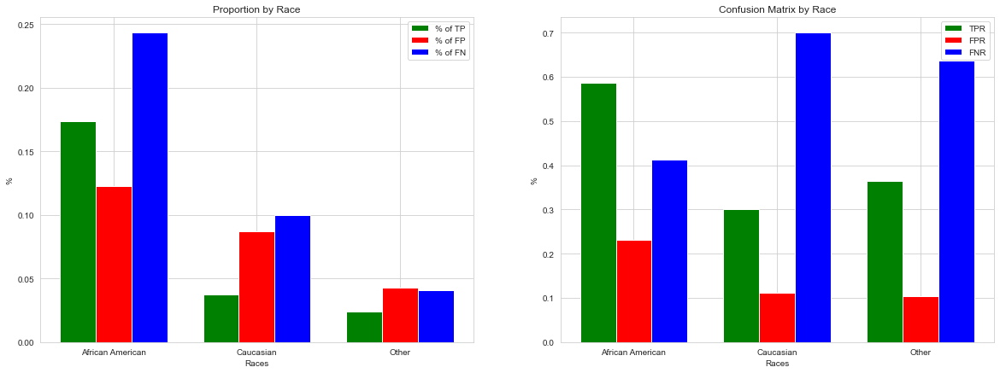

In [229]:
#Other aspect to calculate the Confusion Rates for the total amount + The confusion Matrix for each race on the right side of the plot
plt.subplots(nrows=1, ncols=2, sharex=False, sharey=False,figsize=(20,7),gridspec_kw={'width_ratios': [2, 2]})

plt.subplot(1, 2, 1) # row 1, col 2 index 1

N = 3
ind = np.arange(N) 
width = 0.25
  
tpr = [african_american_tpr,caucasian_american_tpr,hispanic_american_tpr]
bar1 = plt.bar(ind, tpr, width, color = 'g')
  
fpr = [african_american_fpr ,caucasian_american_fpr ,hispanic_american_fpr]
bar2 = plt.bar(ind+width, fpr, width, color='r')
  
fnr = [african_american_fnr ,caucasian_american_fnr ,hispanic_american_fnr ]
bar3 = plt.bar(ind+width*2, fnr, width, color = 'b')
  
plt.xlabel("Races")
plt.ylabel('%')
plt.title("Proportion by Race")
  
plt.xticks(ind+width,['African American', 'Caucasian', 'Other'])
plt.legend( (bar1, bar2, bar3), ('% of TP', '% of FP', '% of FN') )


plt.subplot(1, 2, 2) # index 2
N = 3
ind = np.arange(N) 
width = 0.25
  
tpr = [TPR_b, TPR_w, TPR_o]
bar1 = plt.bar(ind, tpr, width, color = 'g')
  
fpr = [FPR_b, FPR_w, FPR_o]
bar2 = plt.bar(ind+width, fpr, width, color='r')
  
fnr = [FNR_b, FNR_w, FNR_o]
bar3 = plt.bar(ind+width*2, fnr, width, color = 'b')
  
plt.xlabel("Races")
plt.ylabel('%')
plt.title("Confusion Matrix by Race")

plt.xticks(ind+width,['African American', 'Caucasian', 'Other'])
plt.legend( (bar1, bar2, bar3), ('TPR', 'FPR', 'FNR') )

plt.show()

Logistic Regression model has quite similar FPR, FNR, TPR for all race groups compared to random forest model. Non-recidive African Americans almost 2 times more than 2 other race groups. False Negative Rates of Caucasians and Others are around 1.75 times much higher than African American group, meaning a recidive Caucasian or Other Race person is more likely to get away with recidivism prediction

### Results PDP & Shaply Feature Importance using RFC

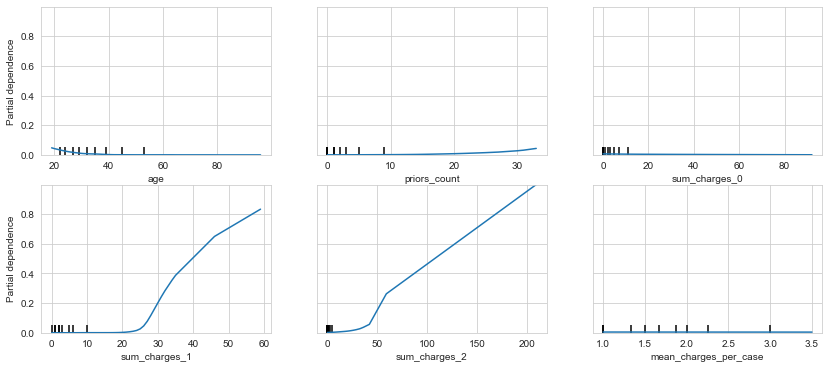

In [230]:
#PDP for feature selected logit
fig, ax = plt.subplots(figsize=(14, 6))
php = plot_partial_dependence(log_feat,
                                   features = X_train_feat.columns, # column numbers of plots we want to show
                                   X=X_train_feat,            # raw predictors data.
                                   feature_names= ['age', 'priors_count', 'sum_charges_0', 'sum_charges_1',
       'sum_charges_2', 'mean_charges_per_case'], # labels on graphs
                                   grid_resolution=100,
                                     ax=ax) # number of values to plot on x axis

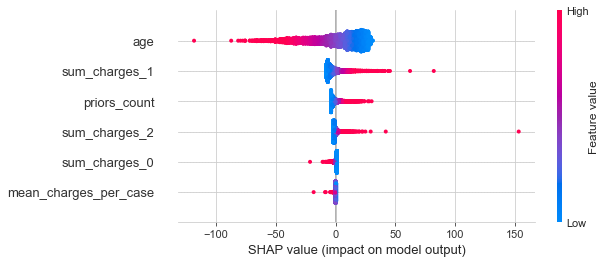

In [231]:
# explain the model's predictions on test set using SHAP values
# same syntax works for xgboost, LightGBM, CatBoost, and some scikit-learn models
explainer = shap.LinearExplainer(log_feat, X_train_feat)

# shap_values consists of a list of two matrices of dimension samplesize x #features
# The first matrix uses average nr of "is_recid = 0" as base value
# The second matrix which is used below uses average nr of "is_recid = 1" as base value 
shap_values = explainer.shap_values(X_train_feat)

#A summary plot with the shapley value (feature importance) 
shap.summary_plot(shap_values, X_train_feat)

### MDI

In [232]:
#MDI Feature Importance plot for feature optimized logit
feature_list = ['age', 'priors_count', 'sum_charges_0', 'sum_charges_1',
       'sum_charges_2', 'mean_charges_per_case']

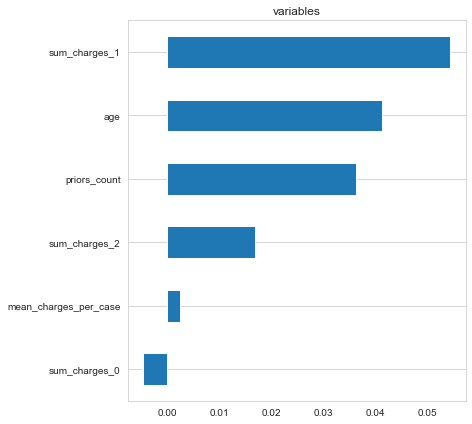

In [233]:
#plot permutation feature importance
perm_importance = permutation_importance(clf_feat, X_test_feat, y_test_feat).importances_mean
plot_feature_importance(perm_importance,0,1)

### Hyperparameter Tuning: Implementation of GridSearchCV

In [234]:
#C_steps = np.arange(0, 10.1, 0.1)

#param_grid = {'penalty': ['l1','l2']}

#grid_search = GridSearchCV(clf_feat, param_grid=param_grid, cv=5)

In [235]:
param_grid = {
    "classifier__C": np.logspace(-4, 4, 4),
}
grid_search = GridSearchCV(clf_feat, param_grid=param_grid, cv=5)

In [236]:
#grid_search.get_params().keys()

In [237]:
# Train the classifier
best_grid = grid_search.fit(X_train_feat, y_train_feat)

# Make predictions
#grid_preds = best_grid.predict(y_test_feat)

#print("The best hyperparameters found during the grid search are:")
print(best_grid.best_params_)
print("GridSearch Accuracy: ",best_grid.best_score_)

{'classifier__C': 21.54434690031882}
GridSearch Accuracy:  0.7119002149786658


### Threshold Decision

Best Threshold=0.390695, G-Mean=0.676


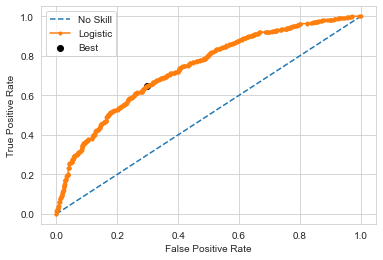

In [238]:
#Threshold discussion with team and basic interest on how to calculate an optimal threshold 
# --> Does it even exist or is this going to be a philosophical question we as Data Scientist can and should not answer?
# predict probabilities
yhat = clf_feat.predict_proba(X_test_feat)
# keep probabilities for the positive outcome only
yhat = yhat[:, 1]
# calculate roc curves
fpr, tpr, thresholds = roc_curve(y_test_feat, yhat)
# calculate the g-mean for each threshold
gmeans = np.sqrt(tpr * (1-fpr))
# locate the index of the largest g-mean
ix = np.argmax(gmeans)
print('Best Threshold=%f, G-Mean=%.3f' % (thresholds[ix], gmeans[ix]))
# plot the roc curve for the model
plt.scatter(fpr[ix], tpr[ix], marker='o', color='black', label='Best')
plt.plot([0,1], [0,1], linestyle='--', label='No Skill')
plt.plot(fpr, tpr, marker='.', label='Logistic')
# axis labels
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.legend()
# show the plot
plt.show()

## Lasso

In [3]:
from sklearn.linear_model import Lasso, LassoCV

In [9]:
#Variable Split
X = df_lin.drop(['is_violent_recid','two_year_recid', 'decile_score', 'Unnamed: 0', 'person_id','name', "race"], axis = 1)
y = df_lin['two_year_recid']

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=1)

In [10]:
##Gridsearch for Lasso
#alphas
alphas = np.linspace(0.001, 1, 1000)
#grid_l1 = {"classifier__alpha":alphas}
#lasso = Lasso(tol = 1e-4)
#cv = RepeatedKFold(n_splits = 10, n_repeats = 3)
#clf_lasso = Pipeline(steps=[("preprocessor", preprocessor), ("classifier", lasso)])
#lasso_cv = GridSearchCV(clf_lasso, grid_l1, cv = cv)
#lasso_cv.fit(X_train, y_train)
#lasso_cv.best_params_

In [11]:
lasso = Lasso(alpha = 0.001) 
clf_lasso = Pipeline(steps=[("preprocessor", preprocessor), ("classifier", lasso)])
clf_lasso.fit(X_train, y_train)
lasso_pred = clf_lasso.predict(X_test)
#Returns the coefficient of determination R² of the prediction.
clf_lasso.score(X_test, y_test)

0.16078109945076624

Best Threshold=0.403453, G-Mean=0.674


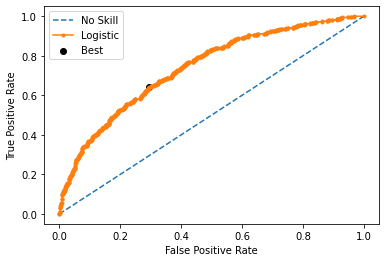

In [12]:
#Select Threshold based on ROC
#predict probabilities
yhat = lasso_pred
# calculate roc curves
fpr, tpr, thresholds = roc_curve(y_test, yhat)
# calculate the g-mean for each threshold
gmeans = np.sqrt(tpr * (1-fpr))
# locate the index of the largest g-mean
ix = np.argmax(gmeans)
print('Best Threshold=%f, G-Mean=%.3f' % (thresholds[ix], gmeans[ix]))
# plot the roc curve for the model
plt.scatter(fpr[ix], tpr[ix], marker='o', color='black', label='Best')
plt.plot([0,1], [0,1], linestyle='--', label='No Skill')
plt.plot(fpr, tpr, marker='.', label='Logistic')
# axis labels
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.legend()
# show the plot
plt.show()

In [13]:
#Select Thresholds based on Accuracy
thresholds = np.linspace(0,1,21)
best_metrics = np.empty((21,2))
for i, a in enumerate(thresholds):
    y_lasso_pred = list(map(lambda x: 0 if x <= a else 1, lasso_pred))
    metricsLasso = model_metrics(y_test, y_lasso_pred)
    best_metrics[i] = [a, metricsLasso[0]]
    opt_index = np.where(best_metrics[:,1] == max(best_metrics[:,1]))[0][0]
print("accuracy = ", best_metrics[:,1][opt_index], "on the threshold of", best_metrics[:,0][opt_index])
y_lasso_pred = list(map(lambda x: 0 if x <= best_metrics[:,0][opt_index] else 1, lasso_pred))

accuracy =  0.7113207547169811 on the threshold of 0.55


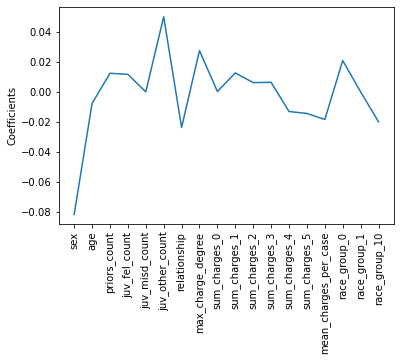

In [14]:
#Feature Selection Property of the LASSO
names = X_train.columns
lasso_coef = clf_lasso.named_steps['classifier'].fit(X, y).coef_
_ = plt.plot(range(len(names)), lasso_coef)
_ = plt.xticks(range(len(names)), names, rotation=90)
_ = plt.ylabel('Coefficients')
plt.show()

<AxesSubplot:>

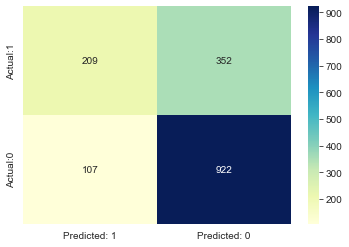

In [246]:
#Get a confusion matrix for Lasso
cm = confusion_matrix(y_test, y_lasso_pred, labels=[1,0])

cm_matrix = pd.DataFrame(data=cm, columns=['Predicted: 1','Predicted: 0'], 
                                 index=['Actual:1','Actual:0'])

sns.heatmap(cm_matrix, annot=True, fmt='d', cmap='YlGnBu')
#The model seems to have a comparibly high FNR

In [247]:
#Metrics for model comparison
tn, fp, fn, tp = confusion_matrix(y_test, y_lasso_pred, labels=[0, 1]).ravel()
fnr_lasso = fn / (fn + tp)
fpr_lasso = fp / (fp + tn)
fnr_lasso, fpr_lasso, f1_score(y_test, y_lasso_pred), recall_score(y_test, y_lasso_pred), precision_score(y_test, y_lasso_pred)

(0.6274509803921569,
 0.10398445092322643,
 0.4766248574686431,
 0.37254901960784315,
 0.6613924050632911)

In [248]:
#Accuracy and other model metrics
metricsLasso = model_metrics(y_test, y_lasso_pred)
[print(i) for i in metricsLasso]

0.7113207547169811
              precision    recall  f1-score   support

           0       0.72      0.90      0.80      1029
           1       0.66      0.37      0.48       561

    accuracy                           0.71      1590
   macro avg       0.69      0.63      0.64      1590
weighted avg       0.70      0.71      0.69      1590



[None, None]

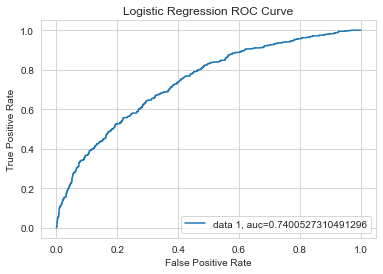

In [249]:
fpr, tpr, _ = roc_curve(y_test,  lasso_pred)
auc = roc_auc_score(y_test, lasso_pred)
plt.plot(fpr,tpr,label="data 1, auc="+str(auc))
plt.legend(loc=4)
plt.xlabel("False Positive Rate")
plt.ylabel("True Positive Rate")
plt.title("Logistic Regression ROC Curve")
plt.show()

### PartialDependence

In [250]:
from sklearn.inspection import PartialDependenceDisplay

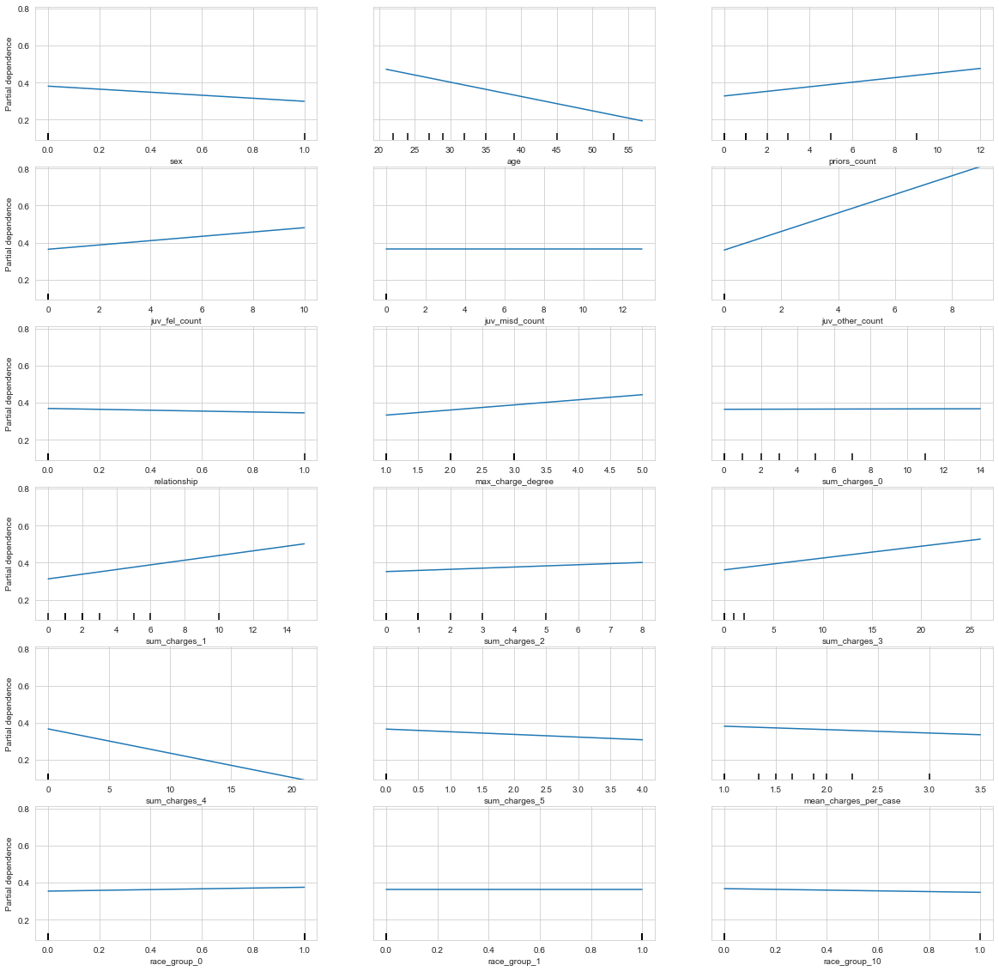

In [251]:
#if you get error "from_estimator" is not a function, you need to update sklearn to version 1.0.2 and reload the notebook. (also for other stuff later)
lasso_top_features = X_train.columns
fig, ax = plt.subplots(figsize=(20,20))
PartialDependenceDisplay.from_estimator(lasso, X_train, lasso_top_features, n_cols=3, grid_resolution=20, kind="average", ax=ax);

### Permutation

In [252]:
from sklearn.inspection import  permutation_importance,plot_partial_dependence

Text(0.5, 1.0, 'Barplot of mean permutation importance per variable')

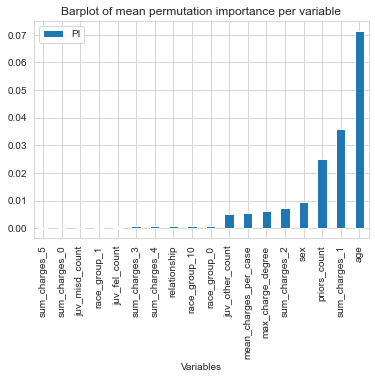

In [253]:
perm_importance = permutation_importance(lasso, X_train, y_train, n_repeats = 20, random_state = 0)
PI = pd.DataFrame(zip(X_train.columns,perm_importance.importances_mean), columns = ["Variables","PI"])
PI.set_index("Variables", inplace = True)
PI.sort_values("PI", inplace=True)
PI.plot(kind = "bar")
plt.title("Barplot of mean permutation importance per variable")

### SHAP for Lasso

In [254]:
import shap
shap.initjs()

In [255]:
explainer_lasso = shap.LinearExplainer(lasso, X_train)
shap_values_lasso = explainer_lasso.shap_values(X_train)

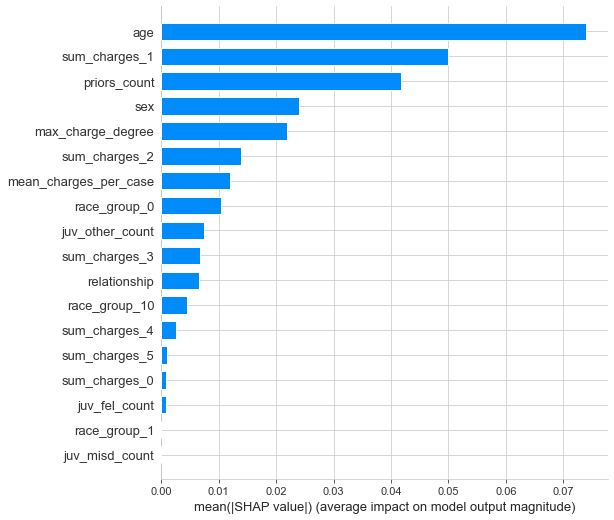

In [256]:
shap.summary_plot(shap_values_lasso, X_train, plot_type = "bar")

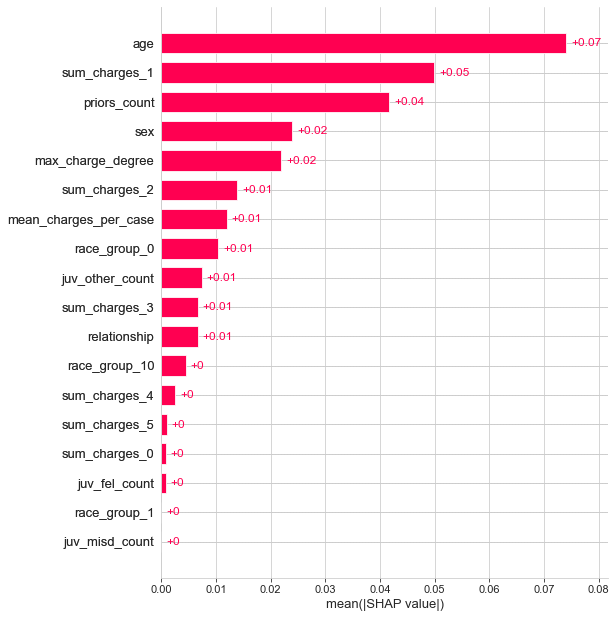

In [257]:
shap.plots.bar(explainer_lasso(X_train), max_display = 18)

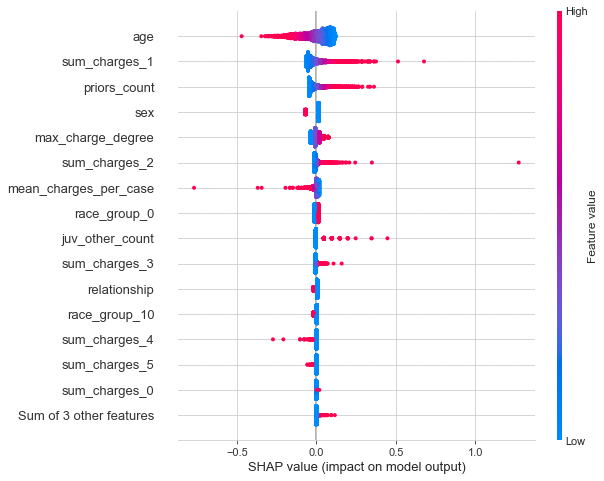

In [258]:
shap.plots.beeswarm(explainer_lasso(X_train), max_display = 16)

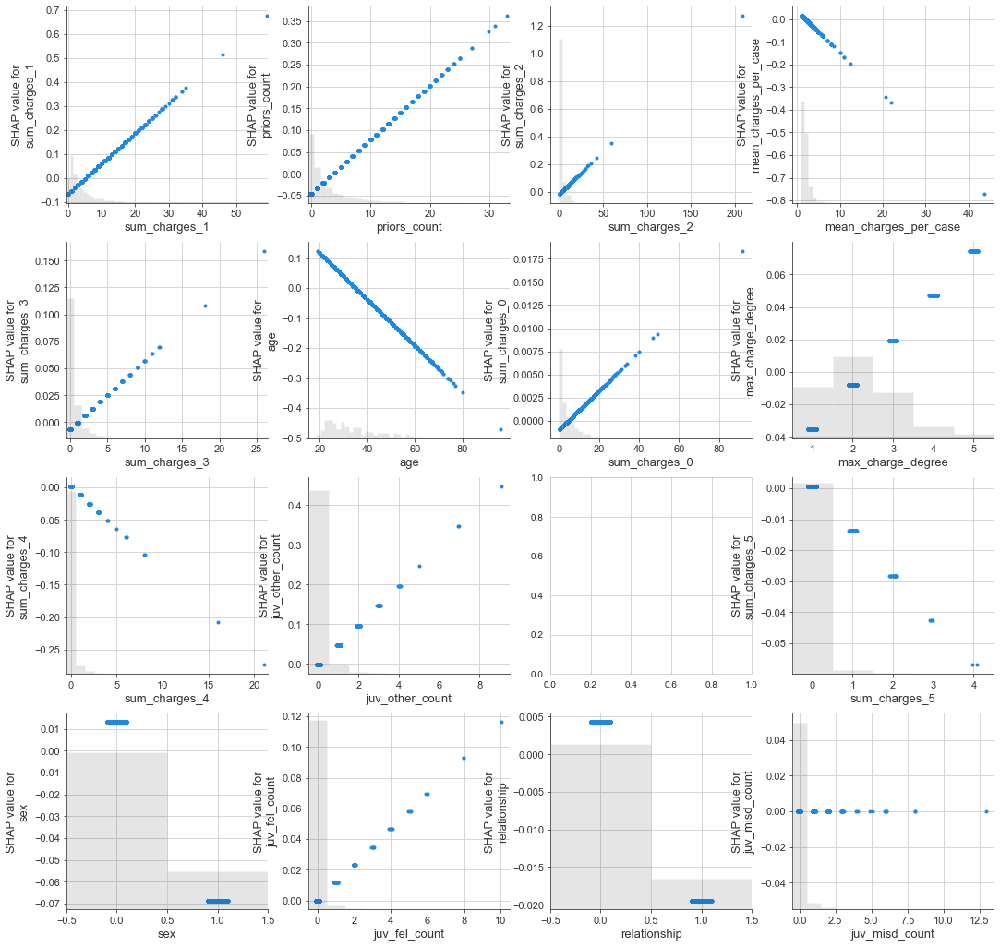

In [259]:
fig, axes = plt.subplots(nrows=4, ncols=4, figsize=(18,18))
shap.plots.scatter(explainer_lasso(X_train)[:,"sum_charges_1"], ax=axes[0,0], show=False)
shap.plots.scatter(explainer_lasso(X_train)[:,"priors_count"], ax=axes[0,1], show=False)
shap.plots.scatter(explainer_lasso(X_train)[:,"sum_charges_2"], ax=axes[0,2], show=False)
shap.plots.scatter(explainer_lasso(X_train)[:,"mean_charges_per_case"], ax=axes[0,3], show=False)
shap.plots.scatter(explainer_lasso(X_train)[:,"sum_charges_3"], ax=axes[1,0], show=False)
shap.plots.scatter(explainer_lasso(X_train)[:,"age"], ax=axes[1,1], show=False)
shap.plots.scatter(explainer_lasso(X_train)[:,"sum_charges_0"], ax=axes[1,2], show=False)
shap.plots.scatter(explainer_lasso(X_train)[:,"max_charge_degree"], ax=axes[1,3], show=False)
shap.plots.scatter(explainer_lasso(X_train)[:,"sum_charges_4"], ax=axes[2,0], show=False)
shap.plots.scatter(explainer_lasso(X_train)[:,"juv_other_count"], ax=axes[2,1], show=False)
shap.plots.scatter(explainer_lasso(X_train)[:,"sum_charges_5"], ax=axes[2,3], show=False)
shap.plots.scatter(explainer_lasso(X_train)[:,"sex"], ax=axes[3,0], show=False)
shap.plots.scatter(explainer_lasso(X_train)[:,"juv_fel_count"], ax=axes[3,1], show=False)
shap.plots.scatter(explainer_lasso(X_train)[:,"relationship"], ax=axes[3,2], show=False)
shap.plots.scatter(explainer_lasso(X_train)[:,"juv_misd_count"], ax=axes[3,3], show=False)

### Lasso fairness matrix

In [21]:
df = pd.read_csv("../data/processed_race_groups_corrected.csv")
df.sex.replace(['Male', 'Female'], [0,1], inplace=True)
df.race.replace(['African-American', 'Caucasian', 'Hispanic', 'Other', 'Asian', 'Native American'], [0,1,2,3,4,5], inplace=True)

#Variable Split
X = df.drop(['is_violent_recid','two_year_recid', 'decile_score', 'Unnamed: 0', 'person_id','name', "race"], axis = 1)
y = df['two_year_recid']

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=1)

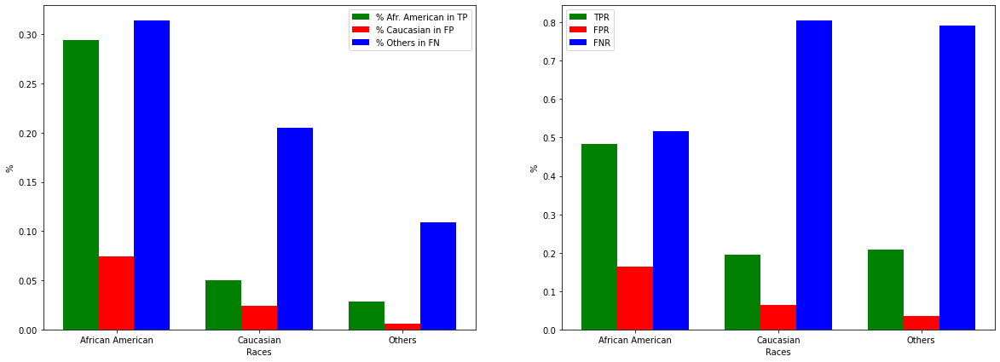

In [22]:
y_lasso_pred = np.asarray(y_lasso_pred)
calculateRates (X_test, y_test, y_lasso_pred)

## Ridge regression

In [260]:
from sklearn.linear_model import Ridge, RidgeCV, Lasso, LassoCV

In [23]:
df = pd.read_csv("../data/processed_race_groups_corrected.csv")
df.sex.replace(['Male', 'Female'], [0,1], inplace=True)
df.race.replace(['African-American', 'Caucasian', 'Hispanic', 'Other', 'Asian', 'Native American'], [0,1,2,3,4,5], inplace=True)
df_lin = pd.get_dummies(df, columns=['race_group'], dtype=int)

#Variable Split
X = df_lin.drop(['is_violent_recid','two_year_recid', 'decile_score', 'Unnamed: 0', 'person_id','name', "race"], axis = 1)
y = df_lin['two_year_recid']

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=1)

In [261]:
##Gridsearch for Ridge
#alphas = [0.01, 0.1, 0.2, 0.3, 0.5, 0.75, 1, 1.5, 2.5, 3.5, 5, 7.5, 10, 25, 40, 50, 55, 65, 75, 85, 100, 125, 135, 140, 145, 150, 155, 160, 165, 170, 175, 200, 250, 300, 350, 400, 1000, 1500, 15000]
#grid_l2 = {"classifier__alpha":alphas}
#ridge = Ridge(tol = 1e-4)
#cv = RepeatedKFold(n_splits = 10, n_repeats = 3)
#clf_ridge = Pipeline(steps=[("preprocessor", preprocessor), ("classifier", ridge)])
#ridge_cv = GridSearchCV(clf_ridge, grid_l2, cv = cv)
#ridge_cv.fit(X_train, y_train)
#ridge_cv.best_params_

In [262]:
ridge_opt = Ridge(alpha = 5) 
clf_ridge = Pipeline(steps=[("preprocessor", preprocessor), ("classifier", ridge_opt)])
clf_ridge.fit(X_train, y_train)
ridge_pred = clf_ridge.predict(X_test)
#Returns the coefficient of determination R^2 of the prediction.
clf_ridge.score(X_test, y_test), clf_ridge.named_steps['classifier'].fit(X, y).coef_

(0.1562059327631834,
 array([-0.08748872, -0.00759915,  0.01172918,  0.02175201, -0.00502574,
         0.05525662, -0.03084098,  0.03123287,  0.00024632,  0.01286822,
         0.00627988,  0.00616295, -0.01735261, -0.03937034, -0.01938639,
         0.02368361,  0.00091427, -0.02459788]))

In [263]:
#Threshold decision based on accuracy
thresholds = np.linspace(0,1,21)
best_metrics = np.empty((21,2))
for i, a in enumerate(thresholds):
    y_ridge_pred = list(map(lambda x: 0 if x <= a else 1, ridge_pred))
    metricsRidge = model_metrics(y_test, y_ridge_pred)
    best_metrics[i] = [a, metricsRidge[0]]
    opt_index = np.where(best_metrics[:,1] == max(best_metrics[:,1]))[0][0]
print("accuracy = ", best_metrics[:,1][opt_index], "on the threshold of", best_metrics[:,0][opt_index])
y_ridge_pred = list(map(lambda x: 0 if x <= best_metrics[:,0][opt_index] else 1, ridge_pred))

accuracy =  0.7094339622641509 on the threshold of 0.5


In [264]:
#Other model metrics for comparison
tn, fp, fn, tp = confusion_matrix(y_test, y_ridge_pred, labels=[0, 1]).ravel()
fnr_ridge = fn / (fn + tp)
fpr_ridge = fp / (fp + tn)
fnr_ridge, fpr_ridge, f1_score(y_test, y_ridge_pred), recall_score(y_test, y_ridge_pred), precision_score(y_test, y_ridge_pred)

(0.5329768270944741,
 0.15840621963070942,
 0.5314401622718053,
 0.46702317290552586,
 0.6164705882352941)

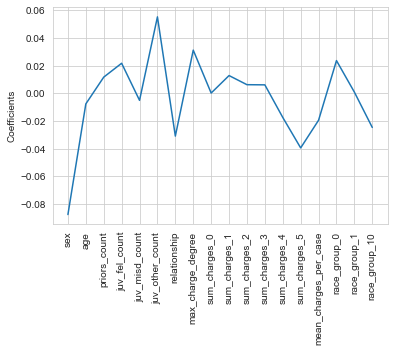

In [265]:
#Feature Selection Property of the RIDGE
names = X_train.columns
ridge_coef = ridge_opt.fit(X, y).coef_
_ = plt.plot(range(len(names)), clf_ridge.named_steps['classifier'].fit(X, y).coef_)
_ = plt.xticks(range(len(names)), names, rotation=90)
_ = plt.ylabel('Coefficients')
plt.show()

<AxesSubplot:>

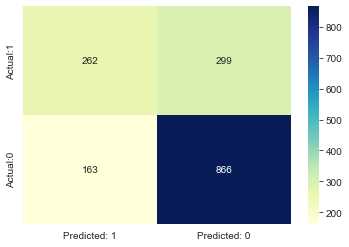

In [266]:
cm = confusion_matrix(y_test, y_ridge_pred, labels=[1,0])

cm_matrix = pd.DataFrame(data=cm, columns=['Predicted: 1','Predicted: 0'], 
                                 index=['Actual:1','Actual:0'])

sns.heatmap(cm_matrix, annot=True, fmt='d', cmap='YlGnBu')

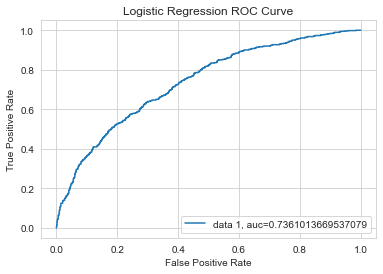

In [267]:
fpr, tpr, _ = roc_curve(y_test,  ridge_pred)
auc = roc_auc_score(y_test, ridge_pred)
plt.plot(fpr,tpr,label="data 1, auc="+str(auc))
plt.legend(loc=4)
plt.xlabel("False Positive Rate")
plt.ylabel("True Positive Rate")
plt.title("Logistic Regression ROC Curve")
plt.show()

### PartialDependence

In [268]:
from sklearn.inspection import PartialDependenceDisplay
import warnings
warnings.filterwarnings("ignore") #but helps with keeping overview on the output

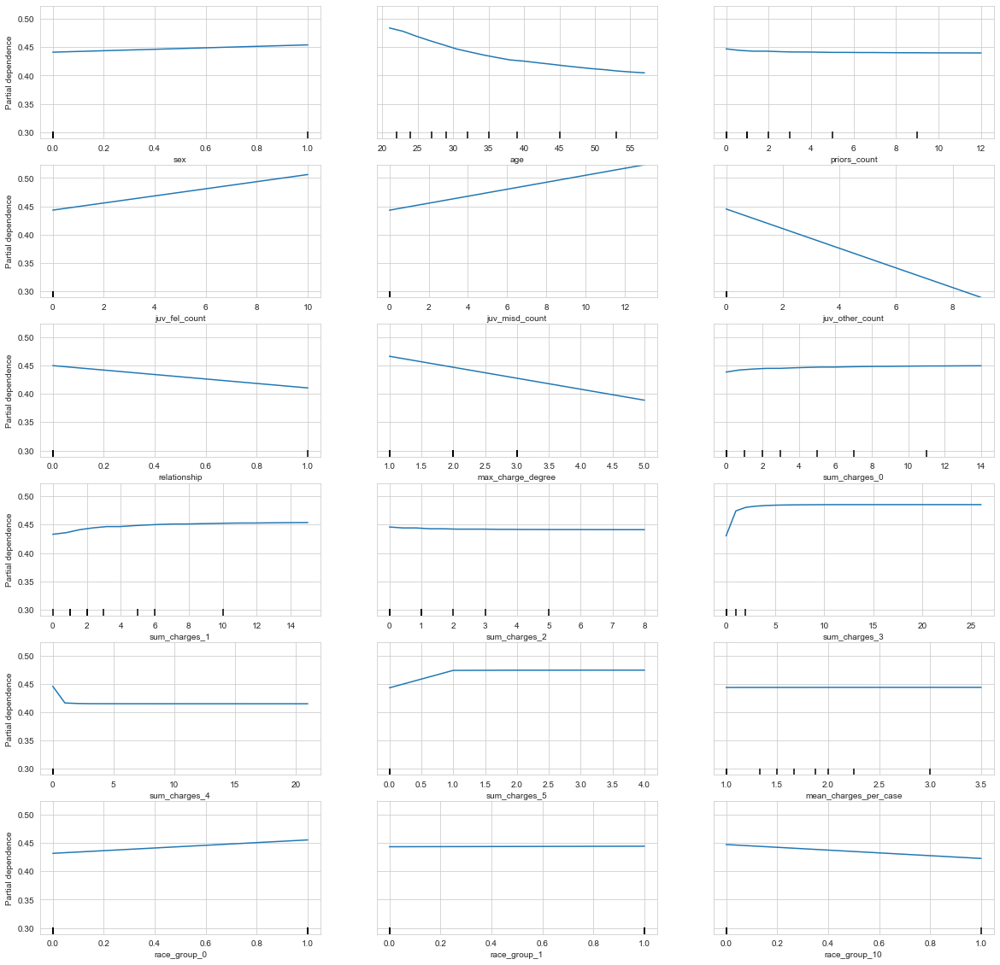

In [269]:
#if you get error "from_estimator" is not a function, you need to update sklearn to version 1.0.2 and reload the notebook. (also for other stuff later)
Ridge_top_features = X_train.columns
fig, ax = plt.subplots(figsize=(20,20))
PartialDependenceDisplay.from_estimator(clf_ridge, X_train, Ridge_top_features, n_cols=3, grid_resolution=20, kind="average", ax=ax);

### Permutation

In [270]:
from sklearn.inspection import  permutation_importance,plot_partial_dependence

Text(0.5, 1.0, 'Barplot of mean permutation importance per variable')

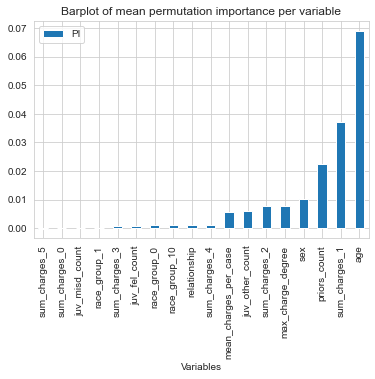

In [271]:
perm_importance = permutation_importance(ridge_opt, X_train, y_train, n_repeats = 20, random_state = 0)
PI = pd.DataFrame(zip(X_train.columns,perm_importance.importances_mean), columns = ["Variables","PI"])
PI.set_index("Variables", inplace = True)
PI.sort_values("PI", inplace=True)
PI.plot(kind = "bar")
plt.title("Barplot of mean permutation importance per variable")

### SHAP for Ridge

In [272]:
import shap
shap.initjs()

In [273]:
explainer_ridge = shap.LinearExplainer(ridge_opt, X_train)
shap_values_ridge = explainer_ridge.shap_values(X_train)

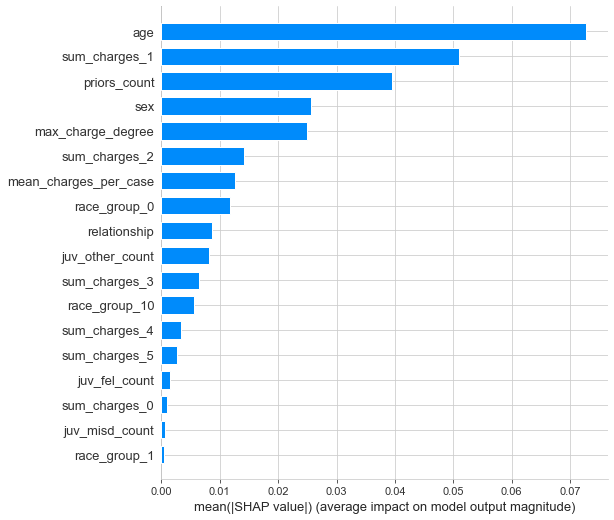

In [274]:
shap.summary_plot(shap_values_ridge, X_train, plot_type = "bar")

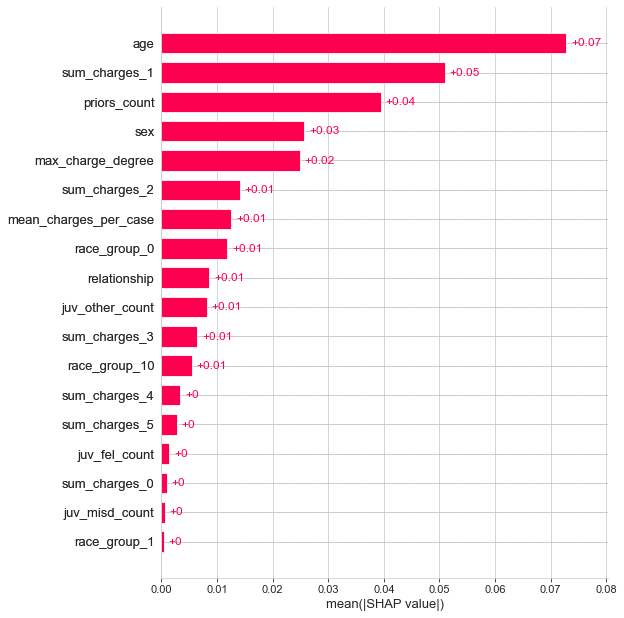

In [275]:
shap.plots.bar(explainer_ridge(X_train), max_display = 18)

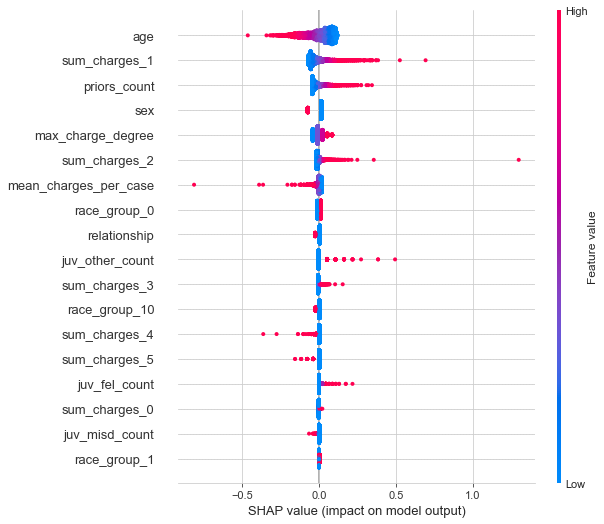

In [276]:
shap.plots.beeswarm(explainer_ridge(X_train), max_display = 18)

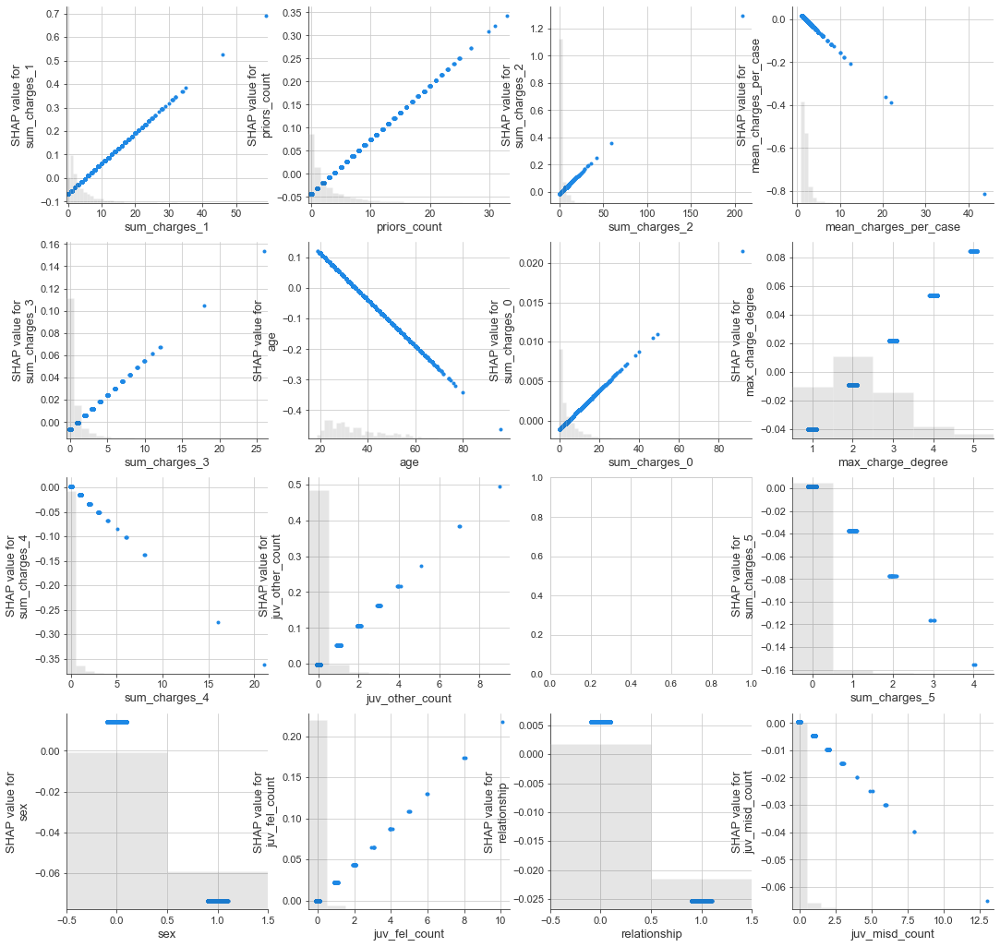

In [277]:
fig, axes = plt.subplots(nrows=4, ncols=4, figsize=(18,18))
shap.plots.scatter(explainer_ridge(X_train)[:,"sum_charges_1"], ax=axes[0,0], show=False)
shap.plots.scatter(explainer_ridge(X_train)[:,"priors_count"], ax=axes[0,1], show=False)
shap.plots.scatter(explainer_ridge(X_train)[:,"sum_charges_2"], ax=axes[0,2], show=False)
shap.plots.scatter(explainer_ridge(X_train)[:,"mean_charges_per_case"], ax=axes[0,3], show=False)
shap.plots.scatter(explainer_ridge(X_train)[:,"sum_charges_3"], ax=axes[1,0], show=False)
shap.plots.scatter(explainer_ridge(X_train)[:,"age"], ax=axes[1,1], show=False)
shap.plots.scatter(explainer_ridge(X_train)[:,"sum_charges_0"], ax=axes[1,2], show=False)
shap.plots.scatter(explainer_ridge(X_train)[:,"max_charge_degree"], ax=axes[1,3], show=False)
shap.plots.scatter(explainer_ridge(X_train)[:,"sum_charges_4"], ax=axes[2,0], show=False)
shap.plots.scatter(explainer_ridge(X_train)[:,"juv_other_count"], ax=axes[2,1], show=False)
shap.plots.scatter(explainer_ridge(X_train)[:,"sum_charges_5"], ax=axes[2,3], show=False)
shap.plots.scatter(explainer_ridge(X_train)[:,"sex"], ax=axes[3,0], show=False)
shap.plots.scatter(explainer_ridge(X_train)[:,"juv_fel_count"], ax=axes[3,1], show=False)
shap.plots.scatter(explainer_ridge(X_train)[:,"relationship"], ax=axes[3,2], show=False)
shap.plots.scatter(explainer_ridge(X_train)[:,"juv_misd_count"], ax=axes[3,3], show=False)

## ElasticNet

In [24]:
from sklearn.linear_model import ElasticNet, ElasticNetCV

In [25]:
##Gridsearch for Elastic Net
#grid_l1l2 = {"classifier__alpha":[0.01,0.02,0.03,0.04,0.05,0.1,0.25,0.5,0.75,1,1.5,2,3.5,5,7.5,10],
#            "classifier__l1_ratio":np.arange(0.001,1,0.01)}
#elastic = ElasticNet(tol = 1e-4)
#clf_enet = Pipeline(steps=[("preprocessor", preprocessor), ("classifier", elastic)])
#cv = RepeatedKFold(n_splits = 10, n_repeats = 3)
#elastic_cv = GridSearchCV(clf_enet, grid_l1l2, cv = cv)
#elastic_cv.fit(X_train, y_train)
#elastic_cv.best_params_

In [26]:
# Train the model
enet = ElasticNet(tol = 1e-4, alpha = 0.01, l1_ratio =0.001)
clf_enet = Pipeline(steps=[("preprocessor", preprocessor), ("classifier", enet)])
clf_enet.fit(X_train, y_train)
  
# calculate the prediction and mean square error
enet_preds = clf_enet.predict(X_test)
clf_enet.score(X_test, y_test)

0.1604761559694735

In [27]:
#Finding thresholds based on accuracy
thresholds = np.linspace(0,1,21)
best_metrics = np.empty((21,2))
for i, a in enumerate(thresholds):
    y_pred_enet = list(map(lambda x: 0 if x <= a else 1, enet_preds))
    metricsEnet = model_metrics(y_test, y_pred_enet)
    best_metrics[i] = [a, metricsEnet[0]]
    opt_index = np.where(best_metrics[:,1] == max(best_metrics[:,1]))[0][0]
print("accuracy = ", best_metrics[:,1][opt_index], "on the threshold of", best_metrics[:,0][opt_index])
y_pred_enet = list(map(lambda x: 0 if x <= best_metrics[:,0][opt_index] else 1, enet_preds))

accuracy =  0.7113207547169811 on the threshold of 0.55


In [28]:
#Calculating model metrics for comparison
tn, fp, fn, tp = confusion_matrix(y_test, y_pred_enet, labels=[0, 1]).ravel()
fnr_enet = fn / (fn + tp)
fpr_enet = fp / (fp + tn)
fnr_enet, fpr_enet, f1_score(y_test, y_pred_enet), recall_score(y_test, y_pred_enet), precision_score(y_test, y_pred_enet)

(0.6417112299465241,
 0.09620991253644315,
 0.46689895470383275,
 0.3582887700534759,
 0.67)

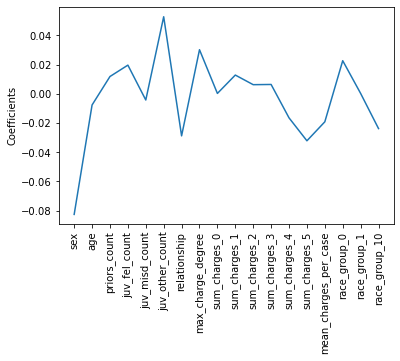

In [29]:
#Feature Selection Property of the RIDGE
names = X_train.columns
enet_coef = clf_enet.named_steps['classifier'].fit(X, y).coef_
_ = plt.plot(range(len(names)), enet_coef)
_ = plt.xticks(range(len(names)), names, rotation=90)
_ = plt.ylabel('Coefficients')
plt.show()

<AxesSubplot:>

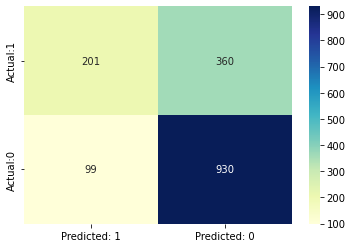

In [30]:
cm = confusion_matrix(y_test, y_pred_enet, labels=[1,0])

cm_matrix = pd.DataFrame(data=cm, columns=['Predicted: 1','Predicted: 0'], 
                                 index=['Actual:1','Actual:0'])

sns.heatmap(cm_matrix, annot=True, fmt='d', cmap='YlGnBu')

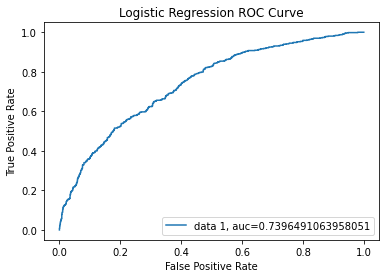

In [31]:
fpr, tpr, _ = roc_curve(y_test, enet_preds)
auc = roc_auc_score(y_test, enet_preds)
plt.plot(fpr,tpr,label="data 1, auc="+str(auc))
plt.legend(loc=4)
plt.xlabel("False Positive Rate")
plt.ylabel("True Positive Rate")
plt.title("Logistic Regression ROC Curve")
plt.show()

### PartialDependence

In [286]:
from sklearn.inspection import PartialDependenceDisplay

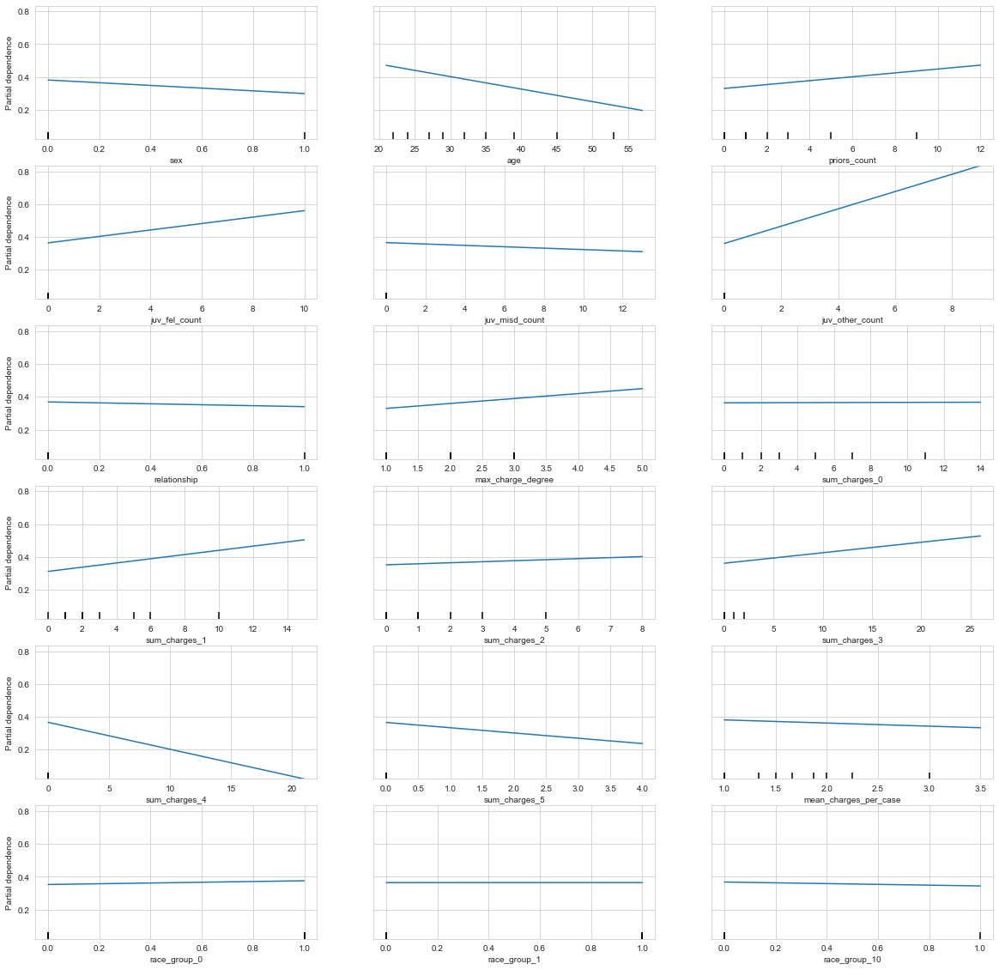

In [287]:
enet_top_features = X_test.columns
fig, ax = plt.subplots(figsize=(20,20))
PartialDependenceDisplay.from_estimator(enet, X_train, enet_top_features, n_cols=3, grid_resolution=20, kind="average", ax=ax);
#if you get error "from_estimator" is not a function, you need to update sklearn to version 1.0.2 and reload the notebook. (also for other stuff later)

### Permutation

In [288]:
from sklearn.inspection import  permutation_importance,plot_partial_dependence

Text(0.5, 1.0, 'Barplot of mean permutation importance per variable')

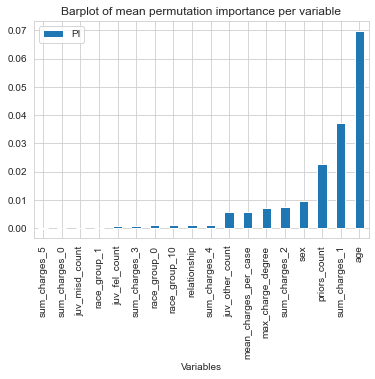

In [289]:
perm_importance = permutation_importance(enet, X_train, y_train, n_repeats = 20, random_state = 0)
PI = pd.DataFrame(zip(X_train.columns,perm_importance.importances_mean), columns = ["Variables","PI"])
PI.set_index("Variables", inplace = True)
PI.sort_values("PI", inplace=True)
PI.plot(kind = "bar")
plt.title("Barplot of mean permutation importance per variable")

### SHAP for Elastic Net

In [290]:
import shap
shap.initjs()

In [291]:
explainer_enet = shap.LinearExplainer(enet, X_train)
shap_values_enet = explainer_enet.shap_values(X_train)

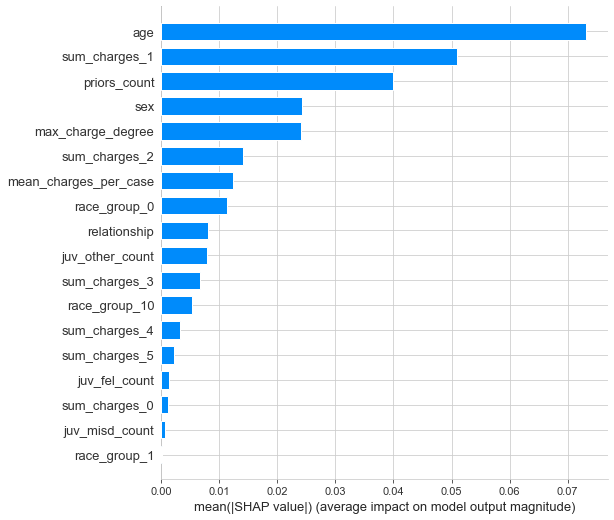

In [292]:
shap.summary_plot(shap_values_enet, X_train, plot_type = "bar")

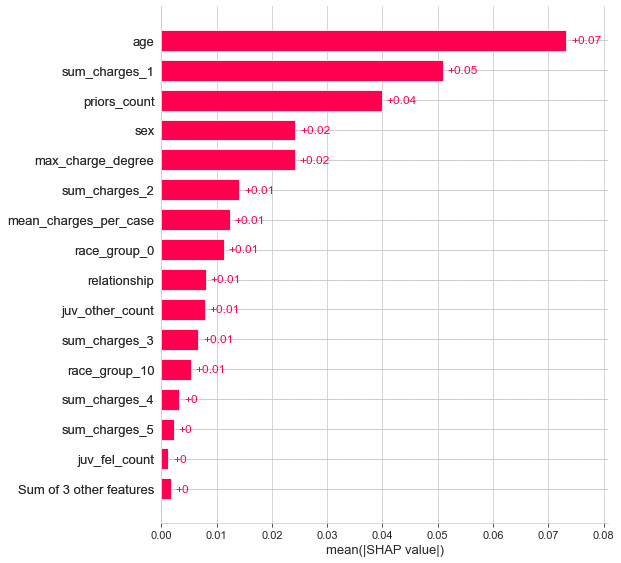

In [293]:
shap.plots.bar(explainer_enet(X_train), max_display = 16)

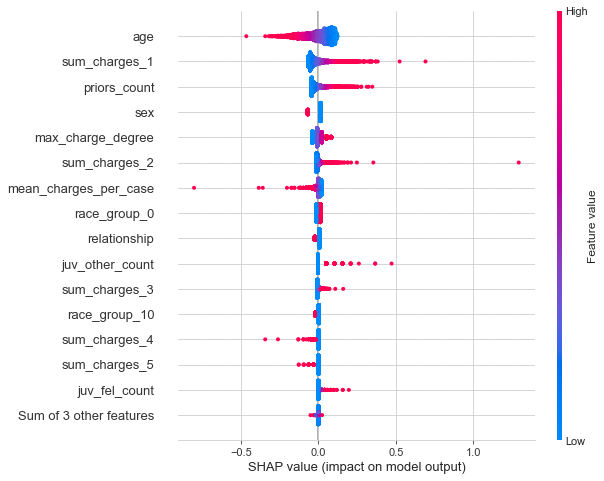

In [294]:
shap.plots.beeswarm(explainer_enet(X_train), max_display = 16)

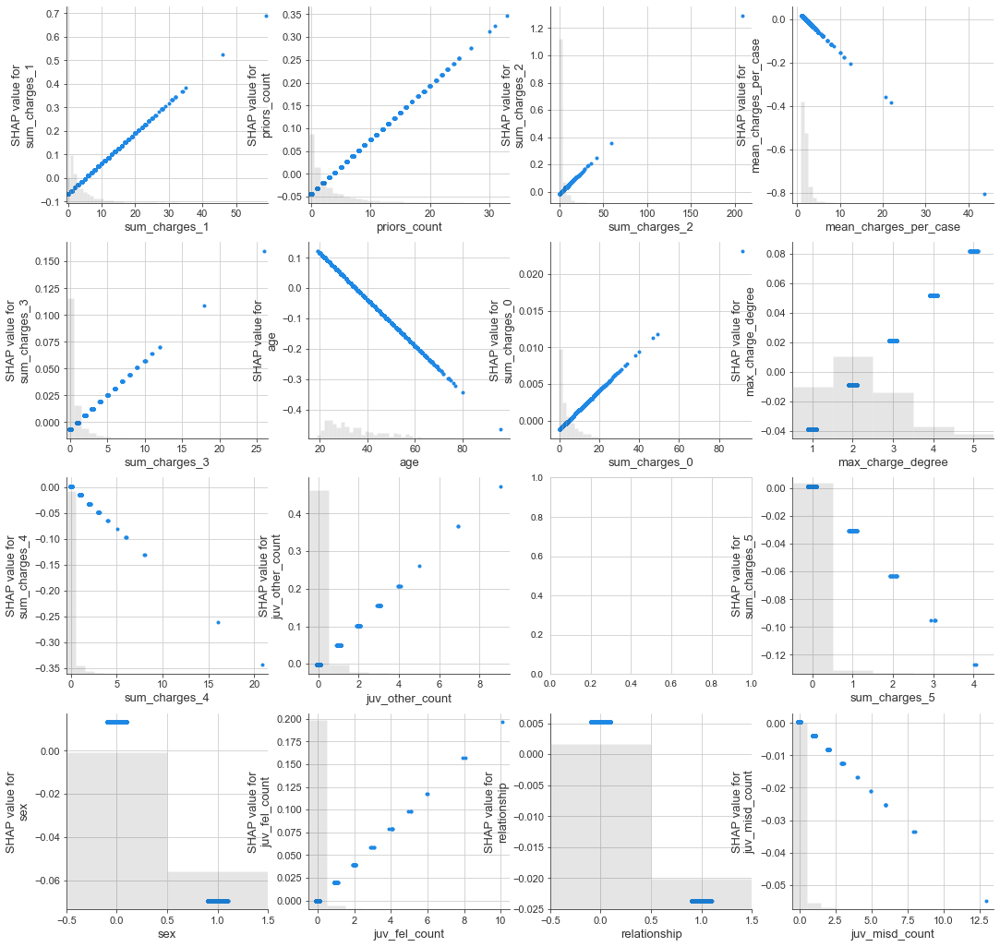

In [295]:
fig, axes = plt.subplots(nrows=4, ncols=4, figsize=(18,18))
shap.plots.scatter(explainer_enet(X_train)[:,"sum_charges_1"], ax=axes[0,0], show=False)
shap.plots.scatter(explainer_enet(X_train)[:,"priors_count"], ax=axes[0,1], show=False)
shap.plots.scatter(explainer_enet(X_train)[:,"sum_charges_2"], ax=axes[0,2], show=False)
shap.plots.scatter(explainer_enet(X_train)[:,"mean_charges_per_case"], ax=axes[0,3], show=False)
shap.plots.scatter(explainer_enet(X_train)[:,"sum_charges_3"], ax=axes[1,0], show=False)
shap.plots.scatter(explainer_enet(X_train)[:,"age"], ax=axes[1,1], show=False)
shap.plots.scatter(explainer_enet(X_train)[:,"sum_charges_0"], ax=axes[1,2], show=False)
shap.plots.scatter(explainer_enet(X_train)[:,"max_charge_degree"], ax=axes[1,3], show=False)
shap.plots.scatter(explainer_enet(X_train)[:,"sum_charges_4"], ax=axes[2,0], show=False)
shap.plots.scatter(explainer_enet(X_train)[:,"juv_other_count"], ax=axes[2,1], show=False)
shap.plots.scatter(explainer_enet(X_train)[:,"sum_charges_5"], ax=axes[2,3], show=False)
shap.plots.scatter(explainer_enet(X_train)[:,"sex"], ax=axes[3,0], show=False)
shap.plots.scatter(explainer_enet(X_train)[:,"juv_fel_count"], ax=axes[3,1], show=False)
shap.plots.scatter(explainer_enet(X_train)[:,"relationship"], ax=axes[3,2], show=False)
shap.plots.scatter(explainer_enet(X_train)[:,"juv_misd_count"], ax=axes[3,3], show=False)

### Elastic Net fairness matrix

In [32]:
df = pd.read_csv("../data/processed_race_groups_corrected.csv")
df.sex.replace(['Male', 'Female'], [0,1], inplace=True)
df.race.replace(['African-American', 'Caucasian', 'Hispanic', 'Other', 'Asian', 'Native American'], [0,1,2,3,4,5], inplace=True)

#Variable Split
X = df.drop(['is_violent_recid','two_year_recid', 'decile_score', 'Unnamed: 0', 'person_id','name', "race"], axis = 1)
y = df['two_year_recid']

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=1)

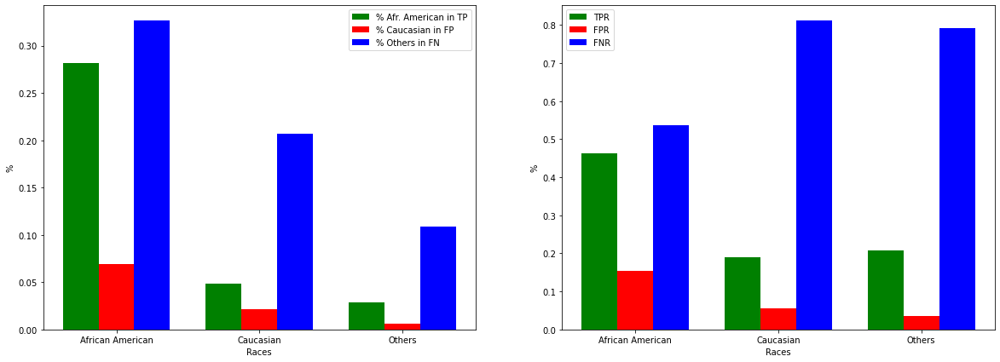

In [33]:
y_pred_enet = np.asarray(y_pred_enet)
calculateRates (X_test, y_test, y_pred_enet)

## Initialize df without protected values

In [34]:
#Preparing data for the analyses
df = pd.read_csv("../data/processed_race_groups_corrected.csv")
df.sex.replace(['Male', 'Female'], [0,1], inplace=True)
df.race.replace(['African-American', 'Caucasian', 'Hispanic', 'Other', 'Asian', 'Native American'], [0,1,2,3,4,5], inplace=True)
df.race.replace([2,3,4,5],value= 10,inplace = True)

#Variable Split
X = df.drop(['is_violent_recid','two_year_recid', 'decile_score', 'Unnamed: 0', 'person_id','name', "race","sex","age", "relationship"], axis = 1)
y = df['two_year_recid']

#Train & Test Split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=1)

## Lasso without Protected Variables 

In [35]:
#looking for the best alpha
alphas = np.linspace(0.001, 1, 1000)
#grid_l1 = {"alpha":[0.002]}
#lasso = Lasso(tol = 1e-4)
#cv = RepeatedKFold(n_splits = 10, n_repeats = 3)
#lasso_cv = GridSearchCV(lasso, grid_l1, cv = cv)
#lasso_cv.fit(X_train, y_train)
#lasso_cv.best_params_

In [36]:
#y_pred_lasso = lasso_cv.predict(X_test)
#lasso_cv.score(X_test, y_test)
#lasso_cv.best_score_

In [37]:
#Lasso implementation
lasso = Lasso(alpha = 0.002) 
lasso.fit(X_train, y_train)
lasso_pred = lasso.predict(X_test)
#Returns the coefficient of determination R^2 of the prediction.
lasso.score(X_test, y_test), lasso.coef_

(0.1087802732652654,
 array([ 0.00807566,  0.02221808,  0.00818403,  0.0838115 ,  0.03878364,
        -0.00116816,  0.01507721,  0.00489053,  0.00893771, -0.0176278 ,
        -0.        , -0.01767787, -0.00761424]))

In [38]:
#Select Thresholds based on Accuracy
thresholds = np.linspace(0,1,21)
best_metrics = np.empty((21,2))
for i, a in enumerate(thresholds):
    y_lasso_pred = list(map(lambda x: 0 if x <= a else 1, lasso_pred))
    metricsLasso = model_metrics(y_test, y_lasso_pred)
    best_metrics[i] = [a, metricsLasso[0]]
    opt_index = np.where(best_metrics[:,1] == max(best_metrics[:,1]))[0][0]
print("accuracy = ", best_metrics[:,1][opt_index], "on the threshold of", best_metrics[:,0][opt_index])
y_lasso_pred = list(map(lambda x: 0 if x <= best_metrics[:,0][opt_index] else 1, lasso_pred))

accuracy =  0.7031446540880503 on the threshold of 0.5


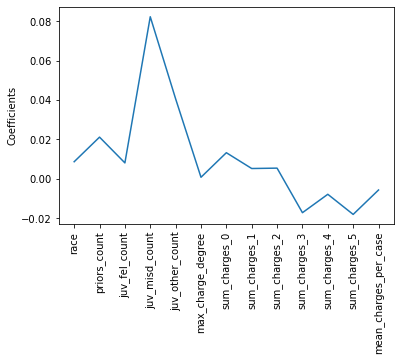

In [39]:
#Feature Selection Property of the LASSO
names = df.drop(['is_violent_recid','two_year_recid', 'decile_score', 'Unnamed: 0', 'person_id','name', "race_group","sex","age", "relationship"], axis = 1).columns
lasso_coef = lasso.fit(X, y).coef_
_ = plt.plot(range(len(names)), lasso_coef)
_ = plt.xticks(range(len(names)), names, rotation=90)
_ = plt.ylabel('Coefficients')
plt.show()

<AxesSubplot:>

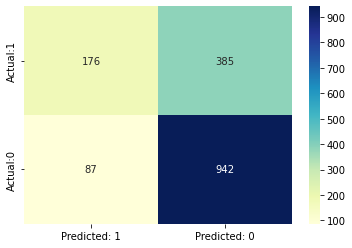

In [40]:
#confusion matrix for Lasso
cm = confusion_matrix(y_test, y_lasso_pred, labels=[1,0])

cm_matrix = pd.DataFrame(data=cm, columns=['Predicted: 1','Predicted: 0'], 
                                 index=['Actual:1','Actual:0'])

sns.heatmap(cm_matrix, annot=True, fmt='d', cmap='YlGnBu')

In [41]:
print("Accuracy:", accuracy_score(y_test, y_lasso_pred))
print("Precision:", precision_score(y_test, y_lasso_pred))
print("Recall:", recall_score(y_test, y_lasso_pred))

Accuracy: 0.7031446540880503
Precision: 0.6692015209125475
Recall: 0.3137254901960784


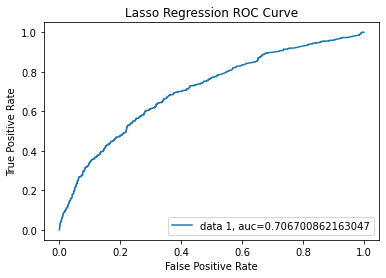

In [42]:
#ROC curve and AUC check
fpr, tpr, _ = roc_curve(y_test, lasso_pred)
auc = roc_auc_score(y_test, lasso_pred)
plt.plot(fpr,tpr,label="data 1, auc="+str(auc))
plt.legend(loc=4)
plt.xlabel("False Positive Rate")
plt.ylabel("True Positive Rate")
plt.title("Lasso Regression ROC Curve")
plt.show()

In [43]:
metricsLasso = model_metrics(y_test, y_lasso_pred)
[print(i) for i in metricsLasso]

0.7031446540880503
              precision    recall  f1-score   support

           0       0.71      0.92      0.80      1029
           1       0.67      0.31      0.43       561

    accuracy                           0.70      1590
   macro avg       0.69      0.61      0.61      1590
weighted avg       0.70      0.70      0.67      1590



[None, None]

### Partial Dependences Graph - Lasso

In [44]:
from sklearn.inspection import PartialDependenceDisplay

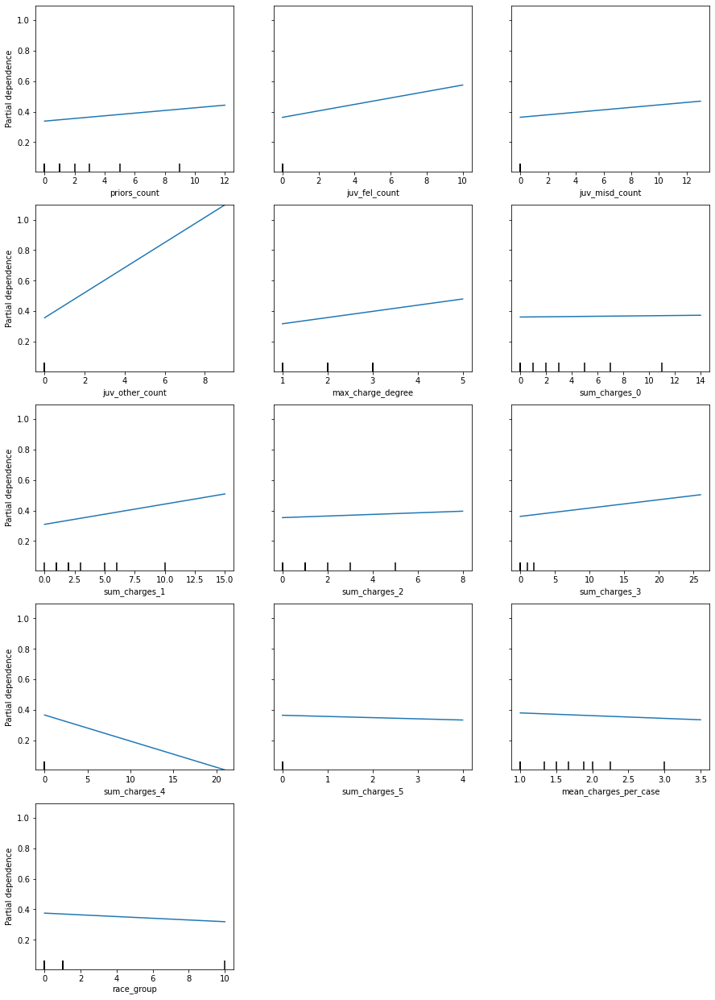

In [45]:
Lasso_top_features = X_test.columns
fig, ax = plt.subplots(figsize=(15,22))
PartialDependenceDisplay.from_estimator(lasso, X_train, Lasso_top_features, n_cols=3, grid_resolution=20, kind="average", ax=ax);

### Permutation

In [308]:
from sklearn.inspection import  permutation_importance,plot_partial_dependence

Text(0.5, 1.0, 'Barplot of mean permutation importance per variable')

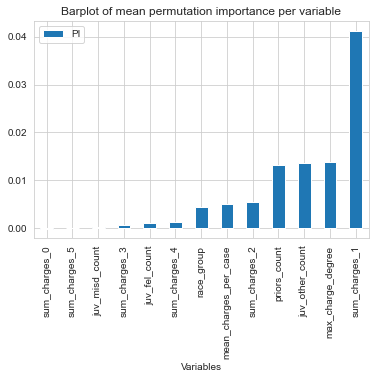

In [309]:
#checking the permutation importances of the model
perm_importance = permutation_importance(lasso, X_train, y_train, n_repeats = 20, random_state = 0)
PI = pd.DataFrame(zip(X_train.columns,perm_importance.importances_mean), columns = ["Variables","PI"])
PI.set_index("Variables", inplace = True)
PI.sort_values("PI", inplace=True)
PI.plot(kind = "bar")
plt.title("Barplot of mean permutation importance per variable")

### SHAP for Lasso

In [310]:
import shap
shap.initjs()

In [312]:
#checking SPAH values
explainer_lasso_prot = shap.Explainer(lasso, X_train)
shap_values_lasso_prot = explainer_lasso_prot.shap_values(X_train)

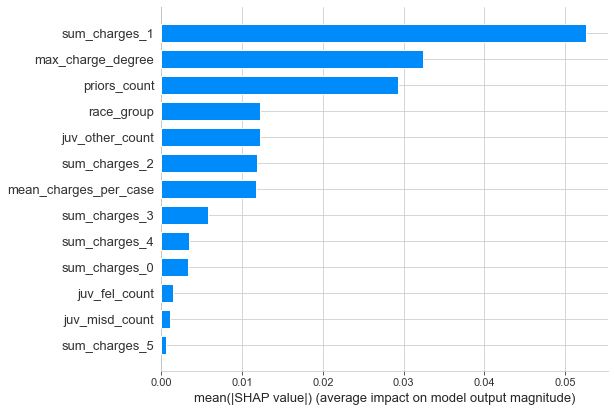

In [313]:
shap.summary_plot(shap_values_lasso_prot, X_train, plot_type = "bar",max_display = 22)

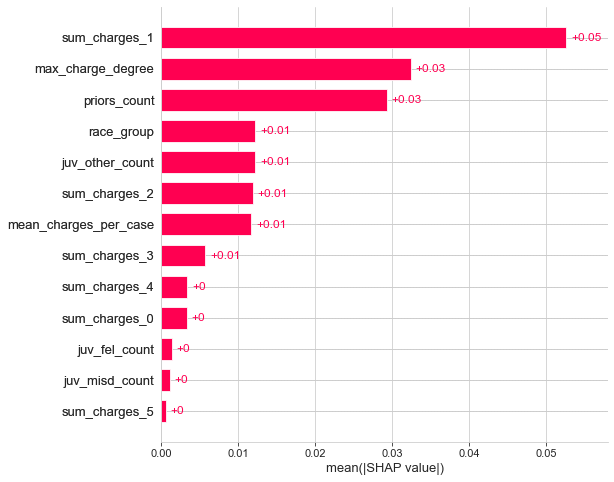

In [314]:
shap.plots.bar(explainer_lasso_prot(X_train), max_display = 22)

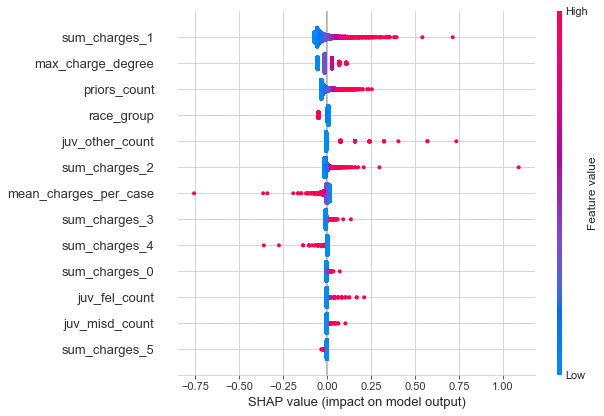

In [315]:
shap.plots.beeswarm(explainer_lasso_prot(X_train), max_display = 22)

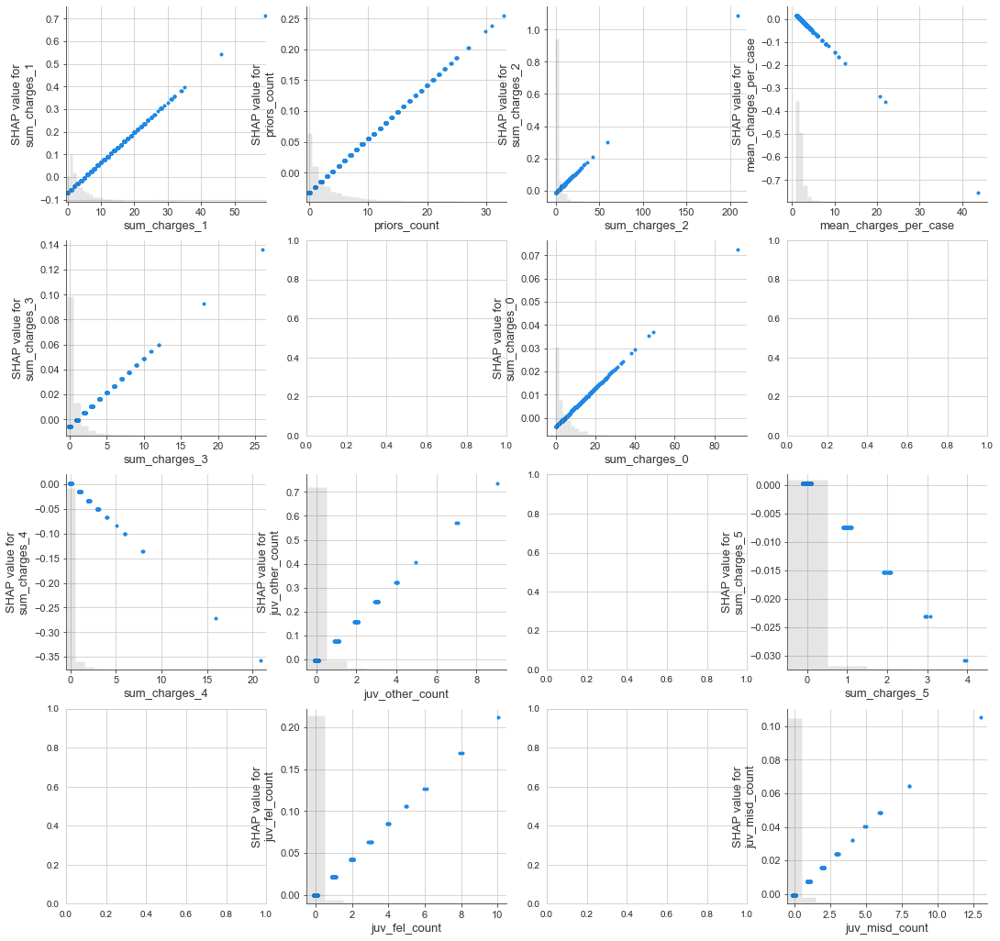

In [317]:
fig, axes = plt.subplots(nrows=4, ncols=4, figsize=(18,18))
shap.plots.scatter(explainer_lasso_prot(X_train)[:,"sum_charges_1"], ax=axes[0,0], show=False)
shap.plots.scatter(explainer_lasso_prot(X_train)[:,"priors_count"], ax=axes[0,1], show=False)
shap.plots.scatter(explainer_lasso_prot(X_train)[:,"sum_charges_2"], ax=axes[0,2], show=False)
shap.plots.scatter(explainer_lasso_prot(X_train)[:,"mean_charges_per_case"], ax=axes[0,3], show=False)
shap.plots.scatter(explainer_lasso_prot(X_train)[:,"sum_charges_3"], ax=axes[1,0], show=False)
shap.plots.scatter(explainer_lasso_prot(X_train)[:,"sum_charges_0"], ax=axes[1,2], show=False)
shap.plots.scatter(explainer_lasso_prot(X_train)[:,"sum_charges_4"], ax=axes[2,0], show=False)
shap.plots.scatter(explainer_lasso_prot(X_train)[:,"juv_other_count"], ax=axes[2,1], show=False)
shap.plots.scatter(explainer_lasso_prot(X_train)[:,"sum_charges_5"], ax=axes[2,3], show=False)
shap.plots.scatter(explainer_lasso_prot(X_train)[:,"juv_fel_count"], ax=axes[3,1], show=False)
shap.plots.scatter(explainer_lasso_prot(X_train)[:,"juv_misd_count"], ax=axes[3,3], show=False)

## Ridge regression without Protected Variables 

In [318]:
#running the grid search to look for the best alpha
#grid_l2 = {"alpha":[0,1,5,7,9,10,50,100,130,140,145,160]}
#ridge = Ridge(tol = 1e-4)
#cv = RepeatedKFold(n_splits = 10, n_repeats = 3)
#ridge_cv = GridSearchCV(ridge, grid_l2, cv = cv)
#ridge_cv.fit(X_train, y_train)
#ridge_cv.best_params_

In [319]:
#y_pred_ridge = ridge_cv.predict(X_test)
#ridge_cv.score(X_test, y_test)
#ridge_cv.best_score_

In [320]:
ridge_opt = Ridge(alpha = 160) 
ridge_opt.fit(X_train, y_train)
ridge_pred = ridge_opt.predict(X_test)
#Returns the coefficient of determination R^2 of the prediction.
ridge_opt.score(X_test, y_test), ridge_opt.coef_

(0.10853845859274103,
 array([ 0.00725144,  0.02690461,  0.01609702,  0.07503311,  0.03916906,
        -0.00119607,  0.01541862,  0.00529764,  0.01039823, -0.02088076,
        -0.00221638, -0.01963576, -0.007745  ]))

In [321]:
#Threshold decision based on accuracy
thresholds = np.linspace(0,1,21)
best_metrics = np.empty((21,2))
for i, a in enumerate(thresholds):
    y_ridge_pred = list(map(lambda x: 0 if x <= a else 1, ridge_pred))
    metricsRidge = model_metrics(y_test, y_ridge_pred)
    best_metrics[i] = [a, metricsRidge[0]]
    opt_index = np.where(best_metrics[:,1] == max(best_metrics[:,1]))[0][0]
print("accuracy = ", best_metrics[:,1][opt_index], "on the threshold of", best_metrics[:,0][opt_index])
y_ridge_pred = list(map(lambda x: 0 if x <= best_metrics[:,0][opt_index] else 1, ridge_pred))

accuracy =  0.7025157232704402 on the threshold of 0.5


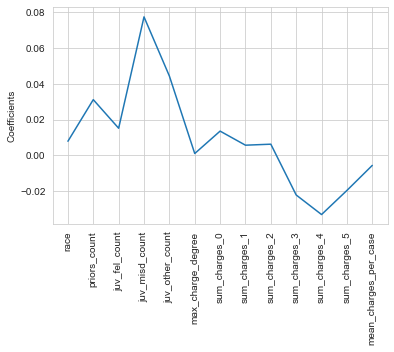

In [322]:
#Feature Selection Property of the RIDGE
names = df.drop(['is_violent_recid','two_year_recid', 'decile_score', 'Unnamed: 0', 'person_id','name', "race_group","sex","age", "relationship"], axis = 1).columns
ridge_coef = ridge_opt.fit(X, y).coef_
_ = plt.plot(range(len(names)), ridge_coef)
_ = plt.xticks(range(len(names)), names, rotation=90)
_ = plt.ylabel('Coefficients')
plt.show()

<AxesSubplot:>

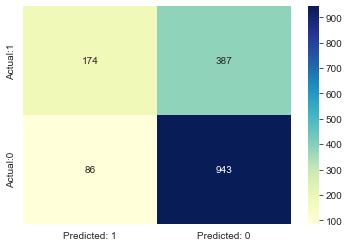

In [323]:
cm = confusion_matrix(y_test, y_ridge_pred, labels=[1,0])

cm_matrix = pd.DataFrame(data=cm, columns=['Predicted: 1','Predicted: 0'], 
                                 index=['Actual:1','Actual:0'])

sns.heatmap(cm_matrix, annot=True, fmt='d', cmap='YlGnBu')

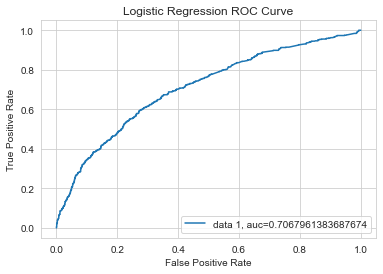

In [324]:
fpr, tpr, _ = roc_curve(y_test, ridge_pred)
auc = roc_auc_score(y_test, ridge_pred)
plt.plot(fpr,tpr,label="data 1, auc="+str(auc))
plt.legend(loc=4)
plt.xlabel("False Positive Rate")
plt.ylabel("True Positive Rate")
plt.title("Logistic Regression ROC Curve")
plt.show()

In [325]:
print(model_metrics(y_test, y_ridge_pred)[0], "\n", model_metrics(y_test,y_ridge_pred)[1])

0.7025157232704402 
               precision    recall  f1-score   support

           0       0.71      0.92      0.80      1029
           1       0.67      0.31      0.42       561

    accuracy                           0.70      1590
   macro avg       0.69      0.61      0.61      1590
weighted avg       0.69      0.70      0.67      1590



### Partial Dependences for Ridge

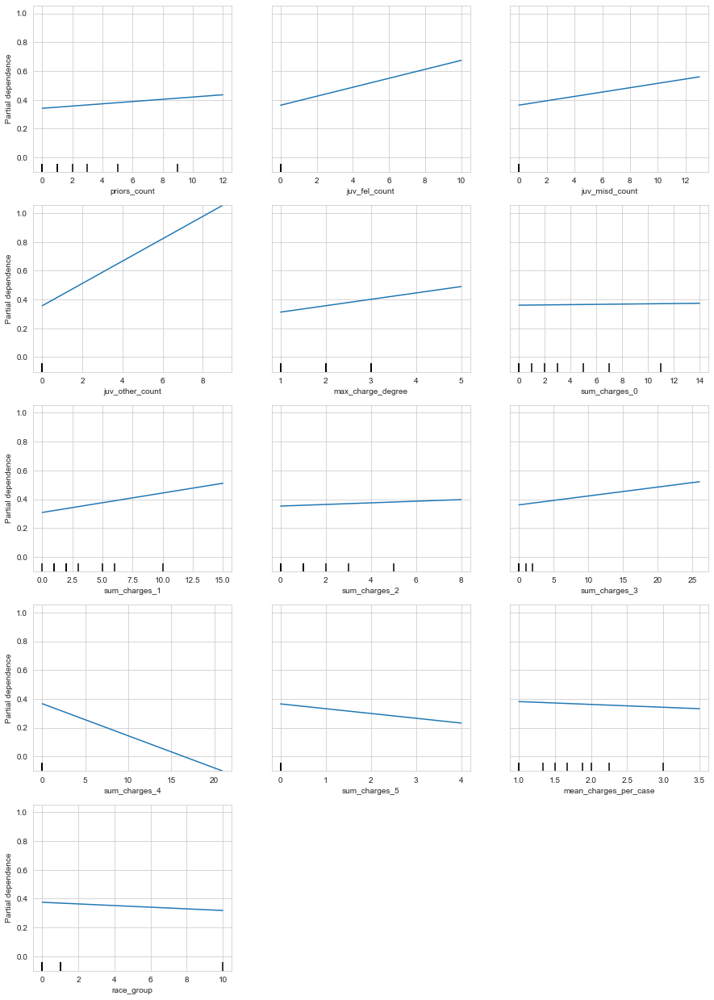

In [326]:
Ridge_top_features = X_train.columns
fig, ax = plt.subplots(figsize=(15,22))
PartialDependenceDisplay.from_estimator(ridge_opt, X_train, Ridge_top_features, n_cols=3, grid_resolution=20, kind="average", ax=ax);

### Permutation

Text(0.5, 1.0, 'Barplot of mean permutation importance per variable')

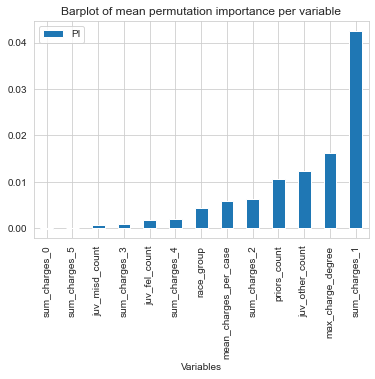

In [327]:
perm_importance = permutation_importance(ridge_opt, X_train, y_train, n_repeats = 20, random_state = 0)
PI = pd.DataFrame(zip(X_train.columns,perm_importance.importances_mean), columns = ["Variables","PI"])
PI.set_index("Variables", inplace = True)
PI.sort_values("PI", inplace=True)
PI.plot(kind = "bar")
plt.title("Barplot of mean permutation importance per variable")

### SHAP for Ridge

In [328]:
import shap
shap.initjs()

In [336]:
explainer_ridge_prot = shap.Explainer(ridge_opt, X_train)
shap_values_ridge_prot = explainer_ridge_prot.shap_values(X_train)

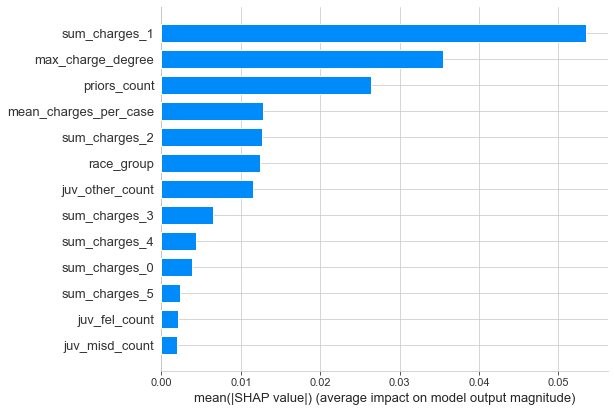

In [337]:
shap.summary_plot(shap_values_ridge_prot, X_train, plot_type = "bar", max_display = 22)

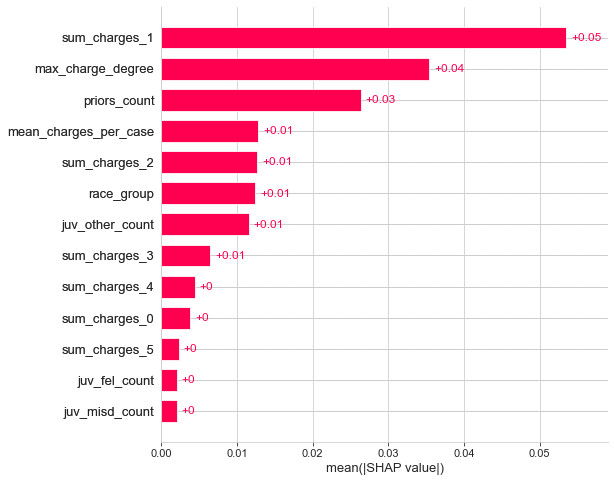

In [338]:
shap.plots.bar(explainer_ridge_prot(X_train), max_display = 22)

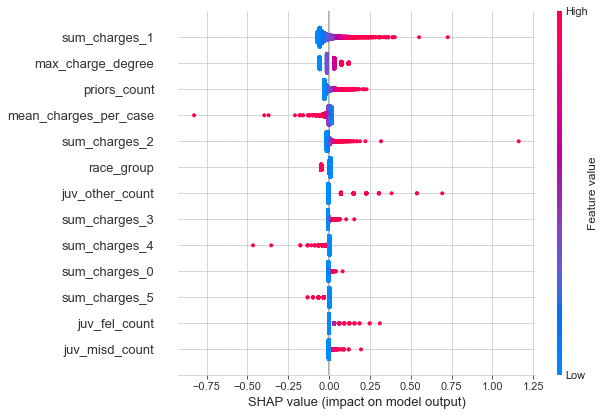

In [339]:
shap.plots.beeswarm(explainer_ridge_prot(X_train), max_display = 22)

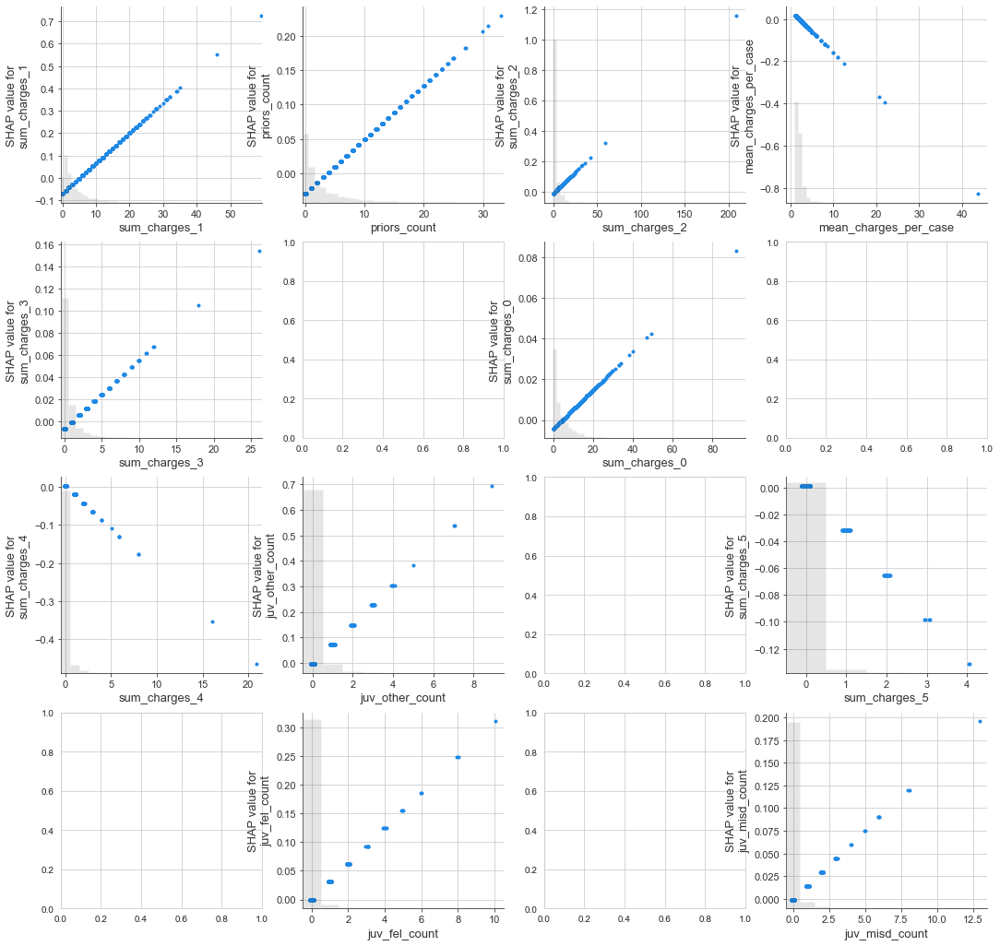

In [340]:
fig, axes = plt.subplots(nrows=4, ncols=4, figsize=(18,18))
shap.plots.scatter(explainer_ridge_prot(X_train)[:,"sum_charges_1"], ax=axes[0,0], show=False)
shap.plots.scatter(explainer_ridge_prot(X_train)[:,"priors_count"], ax=axes[0,1], show=False)
shap.plots.scatter(explainer_ridge_prot(X_train)[:,"sum_charges_2"], ax=axes[0,2], show=False)
shap.plots.scatter(explainer_ridge_prot(X_train)[:,"mean_charges_per_case"], ax=axes[0,3], show=False)
shap.plots.scatter(explainer_ridge_prot(X_train)[:,"sum_charges_3"], ax=axes[1,0], show=False)
shap.plots.scatter(explainer_ridge_prot(X_train)[:,"sum_charges_0"], ax=axes[1,2], show=False)
shap.plots.scatter(explainer_ridge_prot(X_train)[:,"sum_charges_4"], ax=axes[2,0], show=False)
shap.plots.scatter(explainer_ridge_prot(X_train)[:,"juv_other_count"], ax=axes[2,1], show=False)
shap.plots.scatter(explainer_ridge_prot(X_train)[:,"sum_charges_5"], ax=axes[2,3], show=False)
shap.plots.scatter(explainer_ridge_prot(X_train)[:,"juv_fel_count"], ax=axes[3,1], show=False)
shap.plots.scatter(explainer_ridge_prot(X_train)[:,"juv_misd_count"], ax=axes[3,3], show=False)

## ElasticNet without Protected Variables 

In [341]:
#Gridsearch for Elastic Net without protected variables
#grid_l1l2 = {"alpha":[0.01,0.02,0.03,0.04,0.05,0.1,0.25,0.5,0.75,1,1.5,2,3.5,5,7.5,10],
#            "l1_ratio":np.arange(0.001,1,0.01)}
#elastic = ElasticNet(tol = 1e-4)
#cv = RepeatedKFold(n_splits = 10, n_repeats = 3)
#elastic_cv = GridSearchCV(elastic, grid_l1l2, cv = cv)
#elastic_cv.fit(X_train, y_train)
#elastic_cv.best_params_

In [342]:
# Train the model
enet = ElasticNet(tol = 1e-4, alpha = 0.04, l1_ratio =0.001 )
enet.fit(X_train, y_train)
 
# calculate the prediction and mean square error
enet_preds = enet.predict(X_test)
enet.score(X_test, y_test)
 

0.10854787335621874

In [343]:
#checking the score of the model
enet.score(X_test, y_test)

0.10854787335621874

In [344]:
#Finding thresholds based on accuracy
thresholds = np.linspace(0,1,21)
best_metrics = np.empty((21,2))
for i, a in enumerate(thresholds):
    y_pred_enet = list(map(lambda x: 0 if x <= a else 1, enet_preds))
    metricsEnet = model_metrics(y_test, y_pred_enet)
    best_metrics[i] = [a, metricsEnet[0]]
    opt_index = np.where(best_metrics[:,1] == max(best_metrics[:,1]))[0][0]
print("accuracy = ", best_metrics[:,1][opt_index], "on the threshold of", best_metrics[:,0][opt_index])
y_pred_enet = list(map(lambda x: 0 if x <= best_metrics[:,0][opt_index] else 1, enet_preds))

accuracy =  0.7025157232704402 on the threshold of 0.5


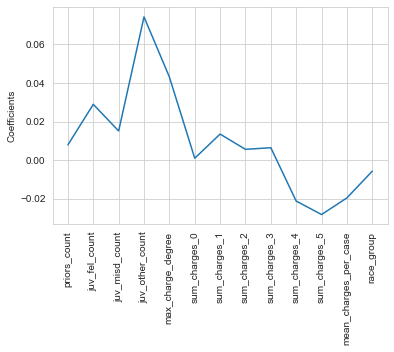

In [345]:
#Feature Selection Property of the RIDGE
names = df.drop(['is_violent_recid','two_year_recid', 'decile_score', 'Unnamed: 0', 'person_id','name',"sex","age", "relationship","race"], axis = 1).columns
enet_coef = enet.fit(X, y).coef_
_ = plt.plot(range(len(names)), enet_coef)
_ = plt.xticks(range(len(names)), names, rotation=90)
_ = plt.ylabel('Coefficients')
plt.show()

<AxesSubplot:>

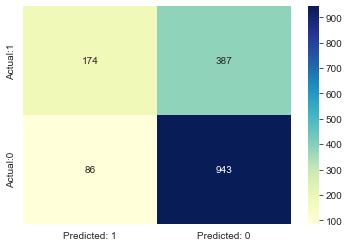

In [346]:
cm = confusion_matrix(y_test, y_pred_enet, labels=[1,0])

cm_matrix = pd.DataFrame(data=cm, columns=['Predicted: 1','Predicted: 0'], 
                                 index=['Actual:1','Actual:0'])

sns.heatmap(cm_matrix, annot=True, fmt='d', cmap='YlGnBu')

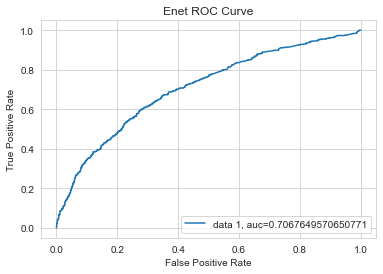

In [347]:
fpr, tpr, _ = roc_curve(y_test, enet_preds)
auc = roc_auc_score(y_test, enet_preds)
plt.plot(fpr,tpr,label="data 1, auc="+str(auc))
plt.legend(loc=4)
plt.xlabel("False Positive Rate")
plt.ylabel("True Positive Rate")
plt.title("Enet ROC Curve")
plt.show()

In [348]:
print(model_metrics(y_test, y_pred_enet)[0], "\n", model_metrics(y_test,y_pred_enet)[1])

0.7025157232704402 
               precision    recall  f1-score   support

           0       0.71      0.92      0.80      1029
           1       0.67      0.31      0.42       561

    accuracy                           0.70      1590
   macro avg       0.69      0.61      0.61      1590
weighted avg       0.69      0.70      0.67      1590



#### Partial Dependences for ElasticNet

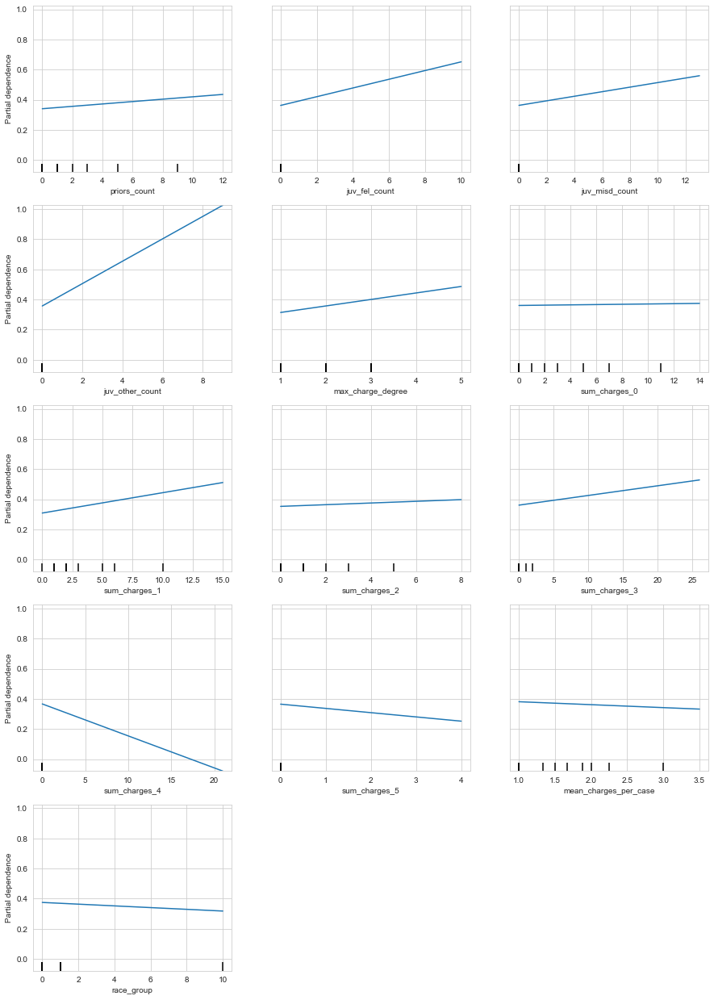

In [349]:
Enet_top_features = X_train.columns
fig, ax = plt.subplots(figsize=(15,22))
PartialDependenceDisplay.from_estimator(enet, X_train, Ridge_top_features, n_cols=3, grid_resolution=20, kind="average", ax=ax);

#### Permutation

In [350]:
from sklearn.inspection import  permutation_importance,plot_partial_dependence

Text(0.5, 1.0, 'Barplot of mean permutation importance per variable')

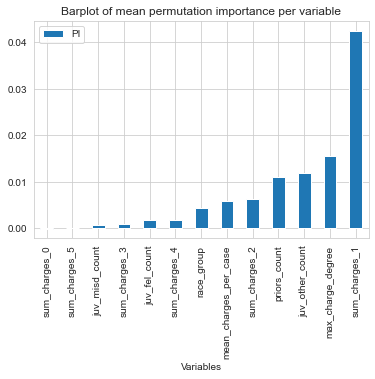

In [351]:
perm_importance = permutation_importance(enet, X_train, y_train, n_repeats = 20, random_state = 0)
PI = pd.DataFrame(zip(X_train.columns,perm_importance.importances_mean), columns = ["Variables","PI"])
PI.set_index("Variables", inplace = True)
PI.sort_values("PI", inplace=True)
PI.plot(kind = "bar")
plt.title("Barplot of mean permutation importance per variable")

#### SHAP for ElasticNet

In [352]:
import shap
shap.initjs()

In [355]:
explainer_enet_prot = shap.Explainer(enet, X_train)
shap_values_enet_prot = explainer_enet_prot.shap_values(X_train)

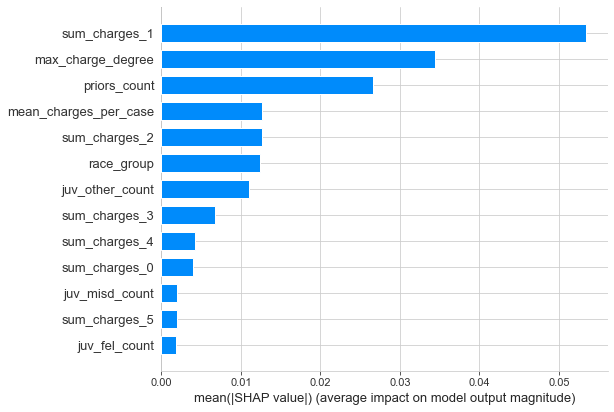

In [356]:
shap.summary_plot(shap_values, X_train, plot_type = "bar")

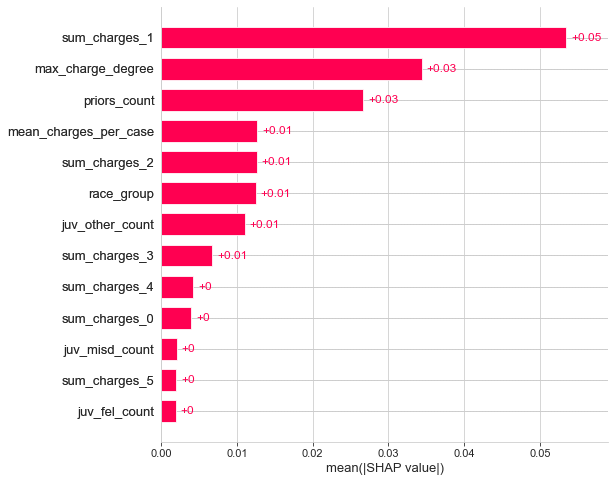

In [357]:
shap.plots.bar(explainer_enet_prot(X_train), max_display = 22)

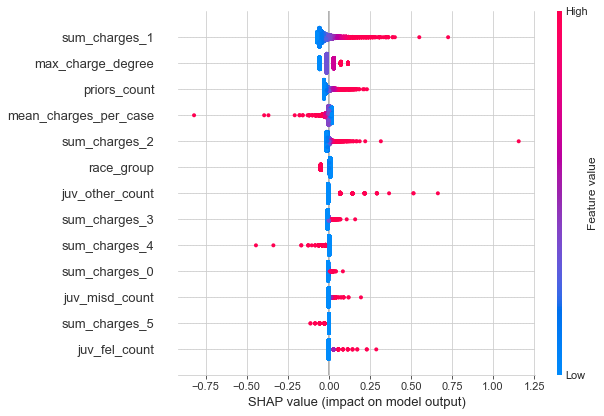

In [358]:
shap.plots.beeswarm(explainer_enet_prot(X_train), max_display = 22)

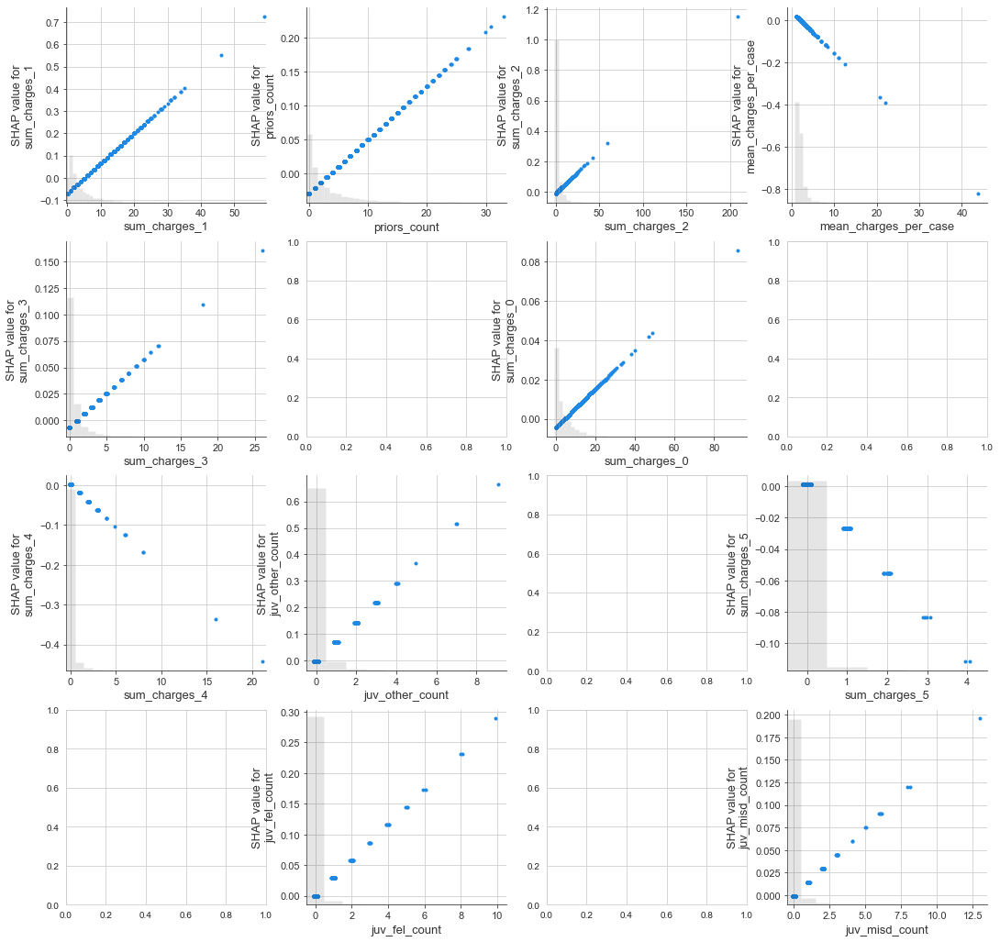

In [359]:
fig, axes = plt.subplots(nrows=4, ncols=4, figsize=(18,18))
shap.plots.scatter(explainer_enet_prot(X_train)[:,"sum_charges_1"], ax=axes[0,0], show=False)
shap.plots.scatter(explainer_enet_prot(X_train)[:,"priors_count"], ax=axes[0,1], show=False)
shap.plots.scatter(explainer_enet_prot(X_train)[:,"sum_charges_2"], ax=axes[0,2], show=False)
shap.plots.scatter(explainer_enet_prot(X_train)[:,"mean_charges_per_case"], ax=axes[0,3], show=False)
shap.plots.scatter(explainer_enet_prot(X_train)[:,"sum_charges_3"], ax=axes[1,0], show=False)
shap.plots.scatter(explainer_enet_prot(X_train)[:,"sum_charges_0"], ax=axes[1,2], show=False)
shap.plots.scatter(explainer_enet_prot(X_train)[:,"sum_charges_4"], ax=axes[2,0], show=False)
shap.plots.scatter(explainer_enet_prot(X_train)[:,"juv_other_count"], ax=axes[2,1], show=False)
shap.plots.scatter(explainer_enet_prot(X_train)[:,"sum_charges_5"], ax=axes[2,3], show=False)
shap.plots.scatter(explainer_enet_prot(X_train)[:,"juv_fel_count"], ax=axes[3,1], show=False)
shap.plots.scatter(explainer_enet_prot(X_train)[:,"juv_misd_count"], ax=axes[3,3], show=False)

After running the same models without the Protected Variables, the accuracy scores dropped dow, but it was expected, as the model has less information for prediction. 

Apart from that, the models perfomace did not change within the comparison to each other as in the models with the PV.

## Linear models comparison

All three models are valid for the prediction, but it is important to choose the best model for the further analyses.
The model will be compared mainly on four factors: Accuracy, Precision, Recall and Area under the curve. Models have shown the following results:

Lasso Accuracy: 71%
Lasso Precision: 68%
Lasso Recall: 35%
Lasso Area under the curve: 74%


Ridge Accuracy:70%
Ridge Precision: 68%
Ridge Recall: 46%
Ridge Area under the curve: 73%


Enet Accuracy: 71%
Enet Precision:67%
Enet Recall: 36%
Enet Area under the curve:73%


It can be seen, that looking at accuracy Enet and Lasso are performing better. But on the other hand, Ridge is better at Recall and Precision. Anyhow, Lasso regression is peforming the best and advised to be used out of those three models.

### Protected Elastic Net fairness matrix

In [47]:
#Variable Split
df = pd.read_csv("../data/processed_race_groups_corrected.csv")
df.sex.replace(['Male', 'Female'], [0,1], inplace=True)
df.race.replace(['African-American', 'Caucasian', 'Hispanic', 'Other', 'Asian', 'Native American'], [0,1,2,3,4,5], inplace=True)
X = df.drop(['is_violent_recid','two_year_recid', 'decile_score', 'Unnamed: 0', 'person_id','name', "sex", "age", "race"], axis = 1)
y = df['two_year_recid']

In [48]:
X_raw_train, X_raw_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=1)
X = X.drop("race_group", axis = 1)
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=1)

In [49]:
#Features transformation
enc = OneHotEncoder(drop='first')
standard = StandardScaler()

crump = ['priors_count','max_charge_degree', 'sum_charges_0', 'sum_charges_1', 'sum_charges_2', 'sum_charges_3', 'sum_charges_4', 'sum_charges_5', 'mean_charges_per_case']
cat_cols = ["race"]

preprocessor = ColumnTransformer(transformers=[("cat", enc, cat_cols), ("crump", standard, crump)], remainder='passthrough')

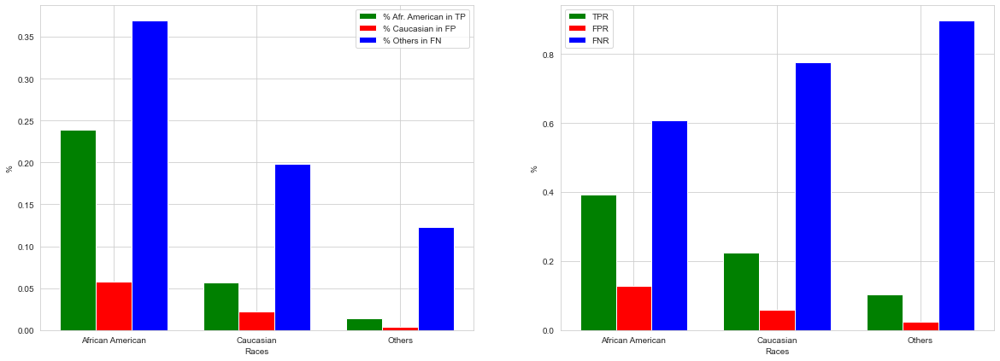

In [363]:
#Get the chart
y_pred_enet = np.asarray(y_pred_enet)
calculateRates(X_raw_test, y_test, y_pred_enet)

### Protected Lasso fairness matrix

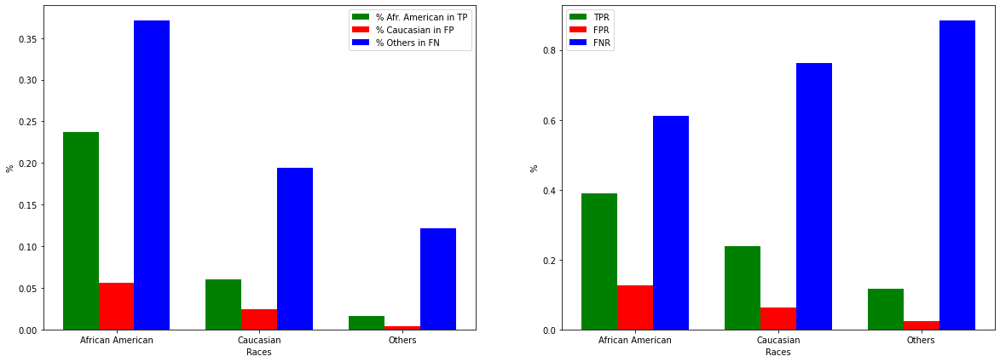

In [50]:
y_lasso_pred = np.asarray(y_lasso_pred)
calculateRates(X_raw_test, y_test, y_lasso_pred)

# Random Forests for Recidivism

## Random Forest for Recidivism including 'Race'

### Preparation

In [365]:
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier, RandomForestRegressor
from sklearn.metrics import accuracy_score
def calculateRates (X_test, y_test, y_pred): #no dummy coding in X_test set
    from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
    test = X_test
    test['red_pred'] = y_pred.tolist()
    test['two_year_red'] = y_test.tolist()
    
    races = test.groupby(['race_group','red_pred','two_year_red']).size().reset_index(name='counts')
    
    afr_tp = (races[(races.race_group==0) & (races.two_year_red == 1) & (races.red_pred ==1)]['counts'].values[0])
    afr_fp = (races[(races.race_group==0) & (races.two_year_red == 0) & (races.red_pred ==1)]['counts'].values[0])
    afr_fn = (races[(races.race_group==0) & (races.two_year_red == 1) & (races.red_pred ==0)]['counts'].values[0])
    afr_tn = (races[(races.race_group==0) & (races.two_year_red == 0) & (races.red_pred ==0)]['counts'].values[0])
    
    cau_tp = (races[(races.race_group==1) & (races.two_year_red == 1) & (races.red_pred ==1)]['counts'].values[0])
    cau_fp = (races[(races.race_group==1) & (races.two_year_red == 0) & (races.red_pred ==1)]['counts'].values[0])
    cau_fn = (races[(races.race_group==1) & (races.two_year_red == 1) & (races.red_pred ==0)]['counts'].values[0])
    cau_tn = (races[(races.race_group==1) & (races.two_year_red == 0) & (races.red_pred ==0)]['counts'].values[0])

    other_tp = (races[(races.race_group==10) & (races.two_year_red == 1) & (races.red_pred ==1)]['counts'].values[0])
    other_fp = (races[(races.race_group==10) & (races.two_year_red == 0) & (races.red_pred ==1)]['counts'].values[0])
    other_fn = (races[(races.race_group==10) & (races.two_year_red == 1) & (races.red_pred ==0)]['counts'].values[0])
    other_tn = (races[(races.race_group==10) & (races.two_year_red == 0) & (races.red_pred ==0)]['counts'].values[0])

    tn, fp, fn, tp = confusion_matrix(y_test, y_pred, labels=[0, 1]).ravel()

    #how many % of african american, caucasian, others in TP, FP, FN cases
    afr_in_tp = afr_tp/(tp+fn)
    afr_in_fp = afr_fp/(fp+tn)
    afr_in_fn = afr_fn/(fn+tp)

    cau_in_tp = cau_tp/(tp+fn)
    cau_in_fp = cau_fp/(fp+tn)
    cau_in_fn = cau_fn/(fn+tp)

    oth_in_tp = other_tp/(tp+fn)
    oth_in_fp = other_fp/(fp+tn)
    oth_in_fn = other_fn/(fn+tp)
    
    #calculate TPR, FPR, FNR for each race group
    african_american_tpr = afr_tp/(afr_tp+afr_fn)
    african_american_fpr = afr_fp/(afr_fp+afr_tn)
    african_american_fnr = afr_fn/(afr_fn+afr_tp)

    caucasian_american_tpr = cau_tp/(cau_tp+cau_fn)
    caucasian_american_fpr = cau_fp/(cau_fp+cau_tn)
    caucasian_american_fnr = cau_fn/(cau_fn+cau_tp)

    other_american_tpr = other_tp/(other_tp+other_fn)
    other_american_fpr = other_fp/(other_fp+other_tn)
    other_american_fnr = other_fn/(other_fn+other_tp)
    
    plt.subplots(nrows=1, ncols=2, sharex=False, sharey=False,figsize=(20,7),gridspec_kw={'width_ratios': [2, 2]})

    plt.subplot(1, 2, 1) # row 1, col 2 index 1

    N = 3
    ind = np.arange(N) 
    width = 0.25

    tpr = [afr_in_tp ,cau_in_tp,oth_in_tp]
    bar1 = plt.bar(ind, tpr, width, color = 'g')

    fpr = [afr_in_fp ,cau_in_fp ,oth_in_fp]
    bar2 = plt.bar(ind+width, fpr, width, color='r')

    fnr = [afr_in_fn,cau_in_fn ,oth_in_fn]
    bar3 = plt.bar(ind+width*2, fnr, width, color = 'b')
    plt.xlabel("Races")
    plt.ylabel('%')
    #plt.title("Rate")
    plt.xticks(ind+width,['African American', 'Caucasian', 'Others'])
    plt.legend( (bar1, bar2, bar3), ('% Afr. American in TP', '% Caucasian in FP', '% Others in FN') )


    plt.subplot(1, 2, 2) # index 2
    N = 3
    ind = np.arange(N) 
    width = 0.25

    tpr = [african_american_tpr,caucasian_american_tpr,other_american_tpr]
    bar1 = plt.bar(ind, tpr, width, color = 'g')

    fpr = [african_american_fpr ,caucasian_american_fpr ,other_american_fpr]
    bar2 = plt.bar(ind+width, fpr, width, color='r')

    fnr = [african_american_fnr ,caucasian_american_fnr ,other_american_fnr ]
    bar3 = plt.bar(ind+width*2, fnr, width, color = 'b')
    plt.xlabel("Races")
    plt.ylabel('%')
    #plt.title("Rate")
    plt.xticks(ind+width,['African American', 'Caucasian', 'Others'])
    plt.legend( (bar1, bar2, bar3), ('TPR', 'FPR', 'FNR') )

    plt.show()

In [366]:
#get split for tree-models
df = pd.read_csv("../data/processed_race_groups_corrected.csv")
df.sex.replace(['Male', 'Female'], [0,1], inplace=True)
df.race.replace(['African-American', 'Caucasian', 'Hispanic', 'Other', 'Asian', 'Native American'], [0,1,2,3,4,5], inplace=True)
labels = df['two_year_recid'].values
cols = df.drop(['is_violent_recid','two_year_recid', 'decile_score', 'Unnamed: 0', 'person_id','name', "race"], axis=1)
# Saving feature names for later use
col_names = list(cols.columns)

X_train, X_test, y_train, y_test = train_test_split(cols, labels, test_size = 0.3, random_state = 1)
feature_list = list(X_train.columns)

### Run Grid Search & Train Data

In [367]:
#60k fits -> took ~72minutes on the server (dont run it on your notebook)
#def runGridSearch(X_train, y_train):
#    from sklearn.model_selection import GridSearchCV
#    from sklearn.ensemble import RandomForestClassifier, RandomForestRegressor 
#    from sklearn.metrics import accuracy_score
#    # Number of trees in random forest
#    # Using num=2 will significantly reduce run time (~3 min vs ~65 min)
#    #n_estimators = [int(x) for x in np.linspace(start = 200, stop = 2000, num = 2)]
#    # Using num=10 will significantly increase run time
#    n_estimators = [100, 200, 300, 400, 500, 600, 700, 800, 900, 1000, 1100, 1200, 1300, 1400, 1500]
#    # Number of features 
#   max_features = ['auto', 'sqrt']
#    # Maximum number of levels in tree
#    # Using num=2 will significantly reduce run time (~3 min vs ~65 min)
#    #max_depth = [int(x) for x in np.linspace(10, 110, num = 2)]
#    # Using num=10 will significantly increase run time
#    max_depth = [int(x) for x in np.linspace(10, 110, num = 10)]
#    max_depth.append(None)
#    # Minimum number of samples required to split a node
#    min_samples_split = [2, 4, 6, 8, 10]
#    # Minimum number of samples required at each leaf node
#    min_samples_leaf = [2, 3, 4, 5, 10, 20]
#    # Method of selecting samples for training each tree
#    bootstrap = [True, False]
#    # Create the random grid
#    grid = {'n_estimators': n_estimators,
#                   'max_features': max_features,
#                   'max_depth': max_depth,
#                   'min_samples_split': min_samples_split,
#                   'min_samples_leaf': min_samples_leaf,
#                   'bootstrap': bootstrap}
#
#    rf_reg = RandomForestClassifier()
#    # Instantiate the grid search model
#   grid_search = GridSearchCV(estimator = rf_reg, param_grid = grid, cv = 3, n_jobs = -1, verbose = 1)
#
#    # Train the classifier
#    best_grid = grid_search.fit(X_train, y_train)
#    # Make predictions
#    grid_preds = best_grid.predict(X_test)
#    
#    return best_grid, grid_preds 
#
#    print("The best hyperparameters found during the grid search are:")
#    print(best_grid.best_params_)
#    
#best_grid, grid_preds = runGridSearch(X_train, y_train)

In [368]:
#best_grid.best_params_

In [369]:
rf_clf = RandomForestClassifier(bootstrap = True, 
                      max_depth = 76, max_features = "auto", min_samples_leaf = 20, 
                     min_samples_split = 8, n_estimators = 200, random_state = 0)
rf_clf.fit(X_train, y_train)
# Perform predictions
y_best_preds = rf_clf.predict(X_test)
y_best_preds
print(accuracy_score(y_test, y_best_preds))

0.7150943396226415


In [370]:
from sklearn.metrics import precision_score, recall_score, roc_auc_score, roc_curve, f1_score
train_probs = rf_clf.predict_proba(X_train)[:,1] 
probs = rf_clf.predict_proba(X_test)[:, 1]
train_predictions = rf_clf.predict(X_train)

print(f'Train ROC AUC Score: {roc_auc_score(y_train, train_probs)}')
print(f'Test ROC AUC  Score: {roc_auc_score(y_test, probs)}')

Train ROC AUC Score: 0.8040054173775104
Test ROC AUC  Score: 0.7436073996698247


In [371]:
#Model Metrics for model comparison
tn, fp, fn, tp = confusion_matrix(y_test, y_best_preds, labels=[0, 1]).ravel()
fnr_rf = fn / (fn + tp)
fpr_rf = fp / (fp + tn)
fnr_rf, fpr_rf, f1_score(y_test, y_best_preds), recall_score(y_test, y_best_preds), precision_score(y_test, y_best_preds)

(0.5401069518716578,
 0.1457725947521866,
 0.5325077399380805,
 0.45989304812834225,
 0.6323529411764706)

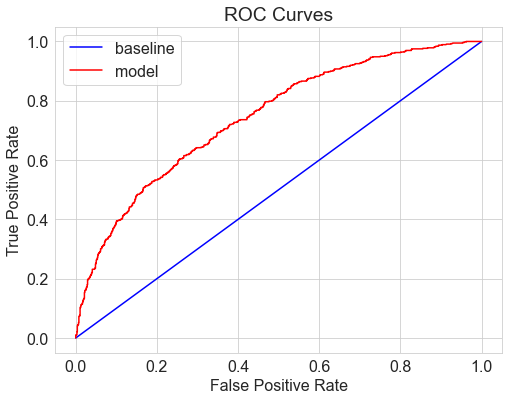

In [372]:
# Calculate false positive rates and true positive rates
base_fpr, base_tpr, _ = roc_curve(y_test, [1 for _ in range(len(y_test))])
model_fpr, model_tpr, thredsholds = roc_curve(y_test, probs)
plt.figure(figsize = (8, 6))
plt.rcParams['font.size'] = 16
# Plot both curves
plt.plot(base_fpr, base_tpr, 'b', label = 'baseline')
plt.plot(model_fpr, model_tpr, 'r', label = 'model')
plt.legend();
plt.xlabel('False Positive Rate');
plt.ylabel('True Positive Rate'); plt.title('ROC Curves');
plt.show();

### Feature Importance

In [373]:
def plot_feature_importance(importances,var_hidden,cumsum_hidden):
    ## Put in a pandas dtf
    dtf_importances = pd.DataFrame({"IMPORTANCE":importances, 
                "VARIABLE":feature_list}).sort_values("IMPORTANCE", 
                ascending=False)
    dtf_importances['cumsum'] =  dtf_importances['IMPORTANCE'].cumsum(axis=0)
    dtf_importances = dtf_importances.set_index("VARIABLE")    
    
    ## Plot
    fig, ax = plt.subplots(nrows=1, ncols=2, sharex=False, sharey=False,figsize=(20,7),gridspec_kw={'width_ratios': [2, 4]})
    #fig.suptitle("Features Importance", fontsize=12)
    ax[0].title.set_text('variables')
    dtf_importances[["IMPORTANCE"]].sort_values(by="IMPORTANCE").plot(kind="barh", legend=False, ax=ax[0]).grid(axis="x")
    ax[0].set(ylabel="")
    if var_hidden == 0:
        ax[0].set_visible(True)
    elif var_hidden == 0:
        ax[0].set_visible(False)
    ax[1].title.set_text('cumulative')
    dtf_importances[["cumsum"]].plot(kind="line", linewidth=4, 
                                     legend=False, ax=ax[1])
    ax[1].set(xlabel="", xticks=np.arange(len(dtf_importances)), 
              xticklabels=dtf_importances.index)
    if cumsum_hidden == 0:
        ax[1].set_visible(True)
    elif cumsum_hidden == 1:
        ax[1].set_visible(False)
    plt.xticks(rotation=70)
    plt.grid(axis='both')
    plt.show()

#### Gini Feature Importance

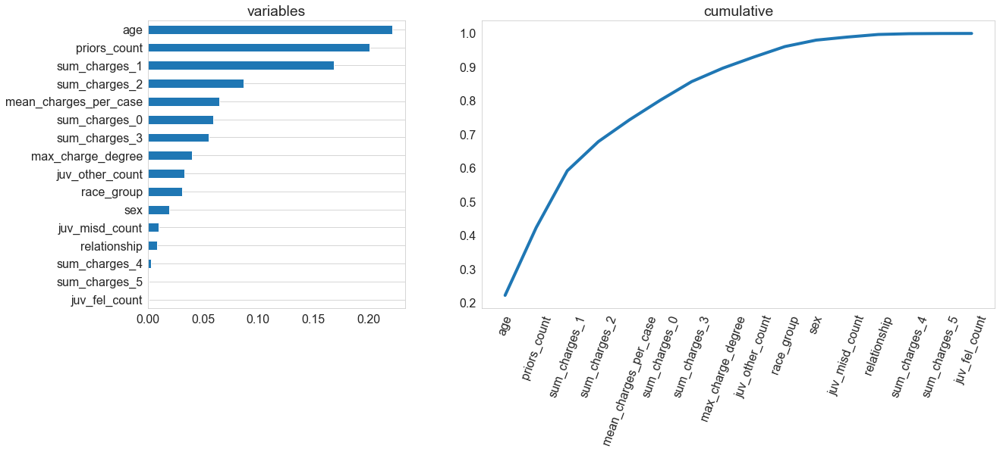

In [374]:
# gini importance plot
gini_importance = rf_clf.feature_importances_

plot_feature_importance(gini_importance,0,0)

It is very interesting to see that age is leading the gini feature importance list. Following are basically the criminal history attributes such as priors_count, mean_charges_per_case and the minor crimes. Race_group and Sex are not very influential. So are the juvenile and serious crimes. 

#### Permutation Feature Importance

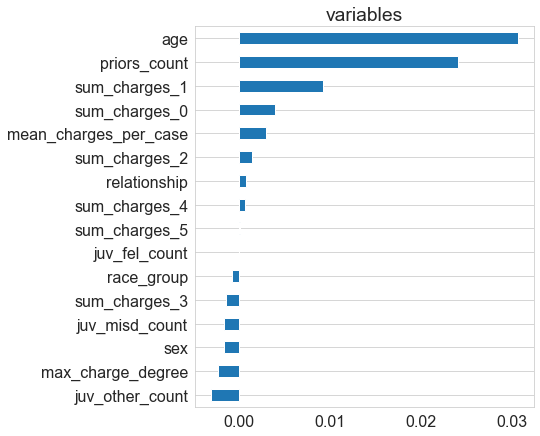

In [375]:
from sklearn.inspection import permutation_importance
#plot permutation feature importance
perm_importance = permutation_importance(rf_clf, X_test, y_test).importances_mean
plot_feature_importance(perm_importance,0,1)

For permutation importance list, while age, priors_count and some minor crime attributes are still on top, the noticeable difference is sex and max_charge_degree dropping into negative values.

#### PDP Plot

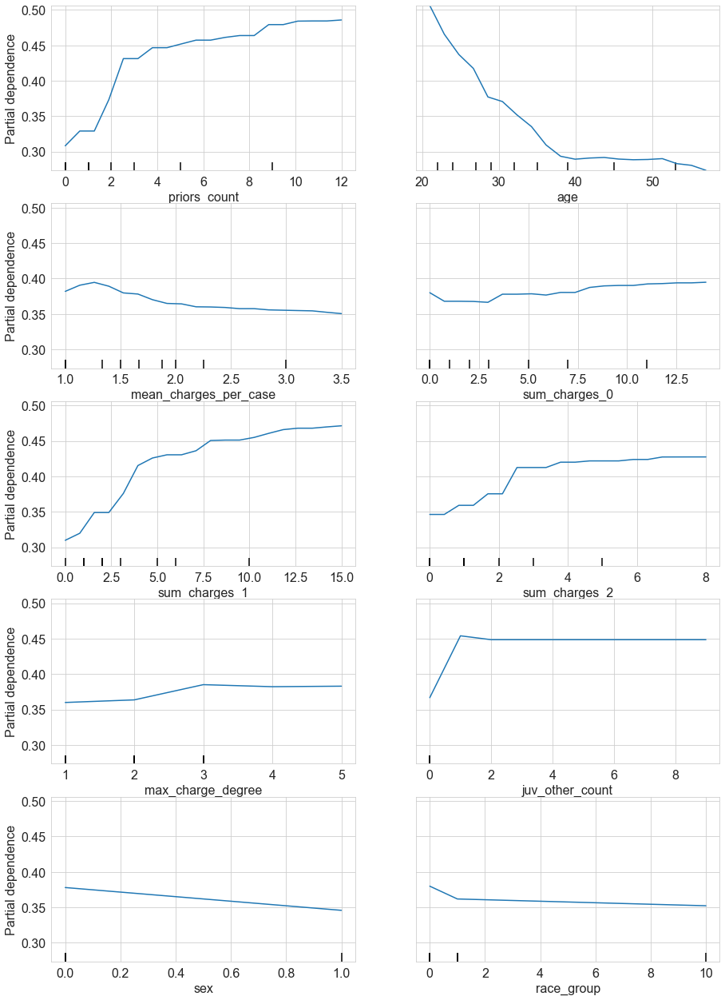

In [376]:
from sklearn.inspection import  plot_partial_dependence
from sklearn.inspection import PartialDependenceDisplay

rf_top_features = ["priors_count", "age","mean_charges_per_case", "sum_charges_0","sum_charges_1", "sum_charges_2","max_charge_degree","juv_other_count","sex","race_group"]
fig, ax = plt.subplots(figsize=(15,22))

PartialDependenceDisplay.from_estimator(rf_clf, X_train, rf_top_features, n_cols=2, grid_resolution=20, kind="average", ax=ax);

#### SHAP Values

In [377]:
import shap
shap.initjs()

# Generate the Tree SHAP estimator of Shapley values that corresponds to the Random Forest we built
rf_explainer = shap.TreeExplainer(rf_clf)
# Compute the estimated Shapley values for the test sample's observations
rf_shap_values = rf_explainer.shap_values(X_train)
rf_shap_values_test = rf_explainer.shap_values(X_test)

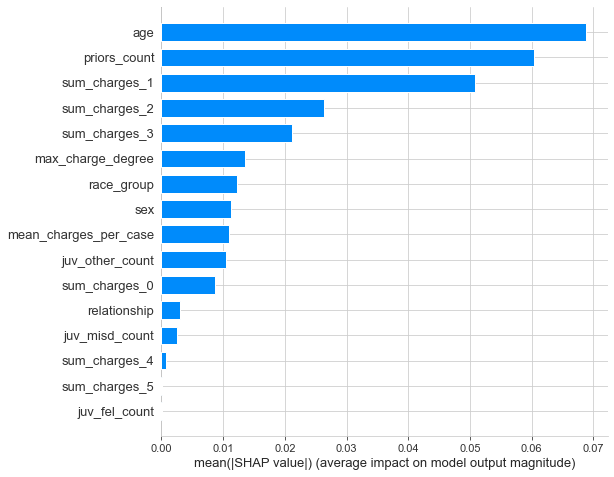

In [378]:
shap.summary_plot(rf_shap_values[1], X_train, plot_type = "bar")

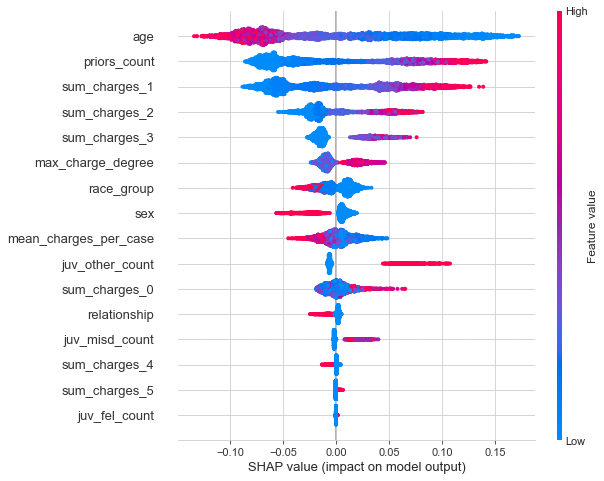

In [379]:
shap.summary_plot(rf_shap_values[1], X_train)

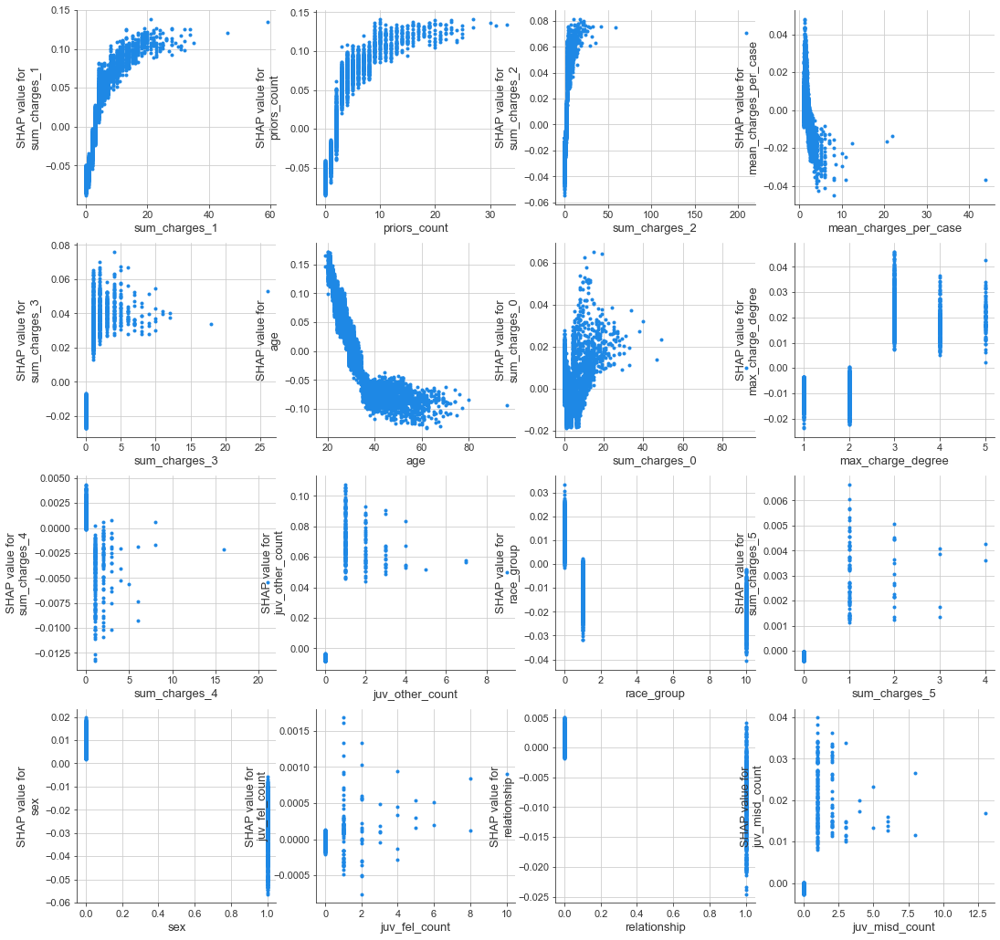

In [380]:
fig, axes = plt.subplots(nrows=4, ncols=4, figsize=(18,18))
shap.dependence_plot("sum_charges_1", rf_shap_values[1], X_train, interaction_index = None, ax = axes[0,0], show = False)
shap.dependence_plot("priors_count", rf_shap_values[1], X_train, interaction_index = None, ax = axes[0,1], show = False)
shap.dependence_plot("sum_charges_2", rf_shap_values[1], X_train, interaction_index = None, ax = axes[0,2], show = False)
shap.dependence_plot("mean_charges_per_case", rf_shap_values[1], X_train, interaction_index = None, ax = axes[0,3], show = False)
shap.dependence_plot("sum_charges_3", rf_shap_values[1], X_train, interaction_index = None, ax = axes[1,0], show = False)
shap.dependence_plot("age", rf_shap_values[1], X_train, interaction_index = None, ax = axes[1,1], show = False)
shap.dependence_plot("sum_charges_0", rf_shap_values[1], X_train, interaction_index = None, ax = axes[1,2], show = False)
shap.dependence_plot("max_charge_degree", rf_shap_values[1], X_train, interaction_index = None, ax = axes[1,3], show = False)
shap.dependence_plot("sum_charges_4", rf_shap_values[1], X_train, interaction_index = None, ax = axes[2,0], show = False)
shap.dependence_plot("juv_other_count", rf_shap_values[1], X_train, interaction_index = None, ax = axes[2,1], show = False)
shap.dependence_plot("race_group", rf_shap_values[1], X_train, interaction_index = None, ax = axes[2,2], show = False)
shap.dependence_plot("sum_charges_5", rf_shap_values[1], X_train, interaction_index = None, ax = axes[2,3], show = False)
shap.dependence_plot("sex", rf_shap_values[1], X_train, interaction_index = None, ax = axes[3,0], show = False)
shap.dependence_plot("juv_fel_count", rf_shap_values[1], X_train, interaction_index = None, ax = axes[3,1], show = False)
shap.dependence_plot("relationship", rf_shap_values[1], X_train, interaction_index = None, ax = axes[3,2], show = False)
shap.dependence_plot("juv_misd_count", rf_shap_values[1], X_train, interaction_index = None, ax = axes[3,3], show = False)

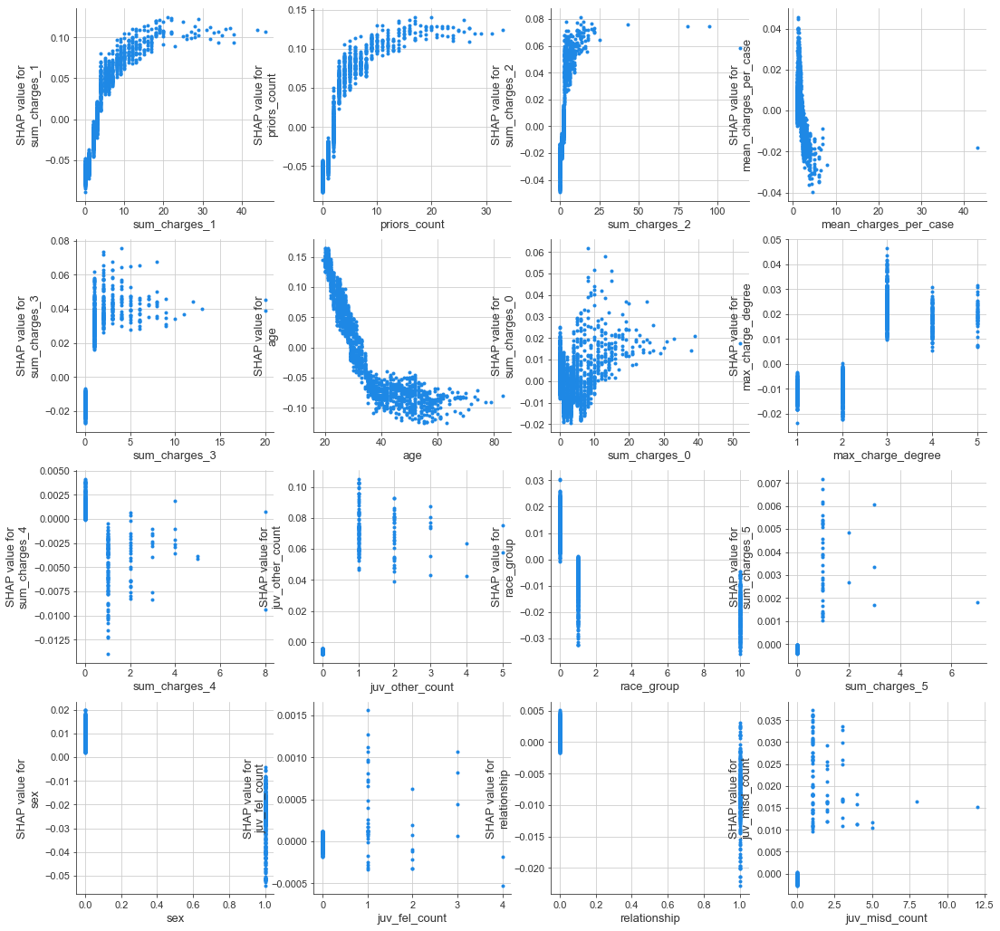

In [381]:
#Compute the same for the test data (to evaluate some of wrongly classified data)
fig, axes = plt.subplots(nrows=4, ncols=4, figsize=(18,18))
shap.dependence_plot("sum_charges_1", rf_shap_values_test[1], X_test, interaction_index = None, ax = axes[0,0], show = False)
shap.dependence_plot("priors_count", rf_shap_values_test[1], X_test, interaction_index = None, ax = axes[0,1], show = False)
shap.dependence_plot("sum_charges_2", rf_shap_values_test[1], X_test, interaction_index = None, ax = axes[0,2], show = False)
shap.dependence_plot("mean_charges_per_case", rf_shap_values_test[1], X_test, interaction_index = None, ax = axes[0,3], show = False)
shap.dependence_plot("sum_charges_3", rf_shap_values_test[1], X_test, interaction_index = None, ax = axes[1,0], show = False)
shap.dependence_plot("age", rf_shap_values_test[1], X_test, interaction_index = None, ax = axes[1,1], show = False)
shap.dependence_plot("sum_charges_0", rf_shap_values_test[1], X_test, interaction_index = None, ax = axes[1,2], show = False)
shap.dependence_plot("max_charge_degree", rf_shap_values_test[1], X_test, interaction_index = None, ax = axes[1,3], show = False)
shap.dependence_plot("sum_charges_4", rf_shap_values_test[1], X_test, interaction_index = None, ax = axes[2,0], show = False)
shap.dependence_plot("juv_other_count", rf_shap_values_test[1], X_test, interaction_index = None, ax = axes[2,1], show = False)
shap.dependence_plot("race_group", rf_shap_values_test[1], X_test, interaction_index = None, ax = axes[2,2], show = False)
shap.dependence_plot("sum_charges_5", rf_shap_values_test[1], X_test, interaction_index = None, ax = axes[2,3], show = False)
shap.dependence_plot("sex", rf_shap_values_test[1], X_test, interaction_index = None, ax = axes[3,0], show = False)
shap.dependence_plot("juv_fel_count", rf_shap_values_test[1], X_test, interaction_index = None, ax = axes[3,1], show = False)
shap.dependence_plot("relationship", rf_shap_values_test[1], X_test, interaction_index = None, ax = axes[3,2], show = False)
shap.dependence_plot("juv_misd_count", rf_shap_values_test[1], X_test, interaction_index = None, ax = axes[3,3], show = False)

### Confusion Matrix & TPR, FPR, FNR by races

<AxesSubplot:>

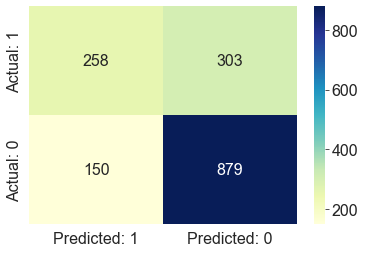

In [382]:
# Print the Confusion Matrix

from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay


cm = confusion_matrix(y_test, y_best_preds,labels=[1,0])
# visualize confusion matrix with seaborn heatmap

cm_matrix = pd.DataFrame(data=cm, columns=['Predicted: 1', 'Predicted: 0'], 
                                 index=['Actual: 1', 'Actual: 0'])

sns.heatmap(cm_matrix, annot=True, fmt='d', cmap='YlGnBu')


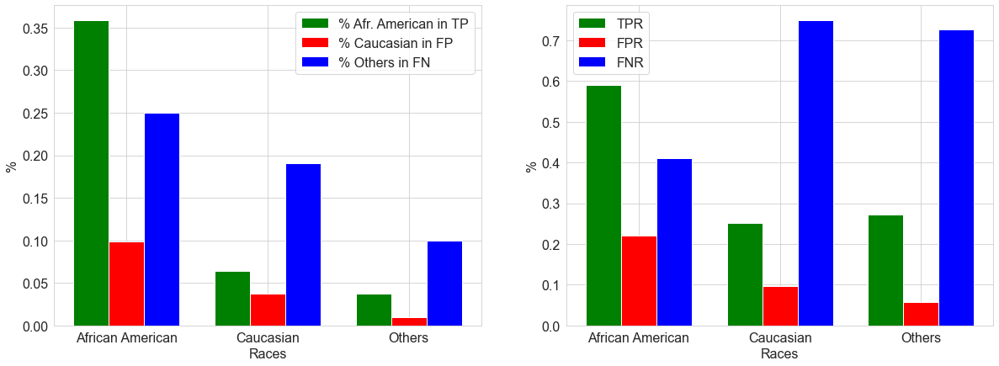

In [383]:
calculateRates(X_test, y_test, y_best_preds)

Chart number 1:

1. The True Positive Rate overall is about 47% which means 47% of all actual recidive cases in the test set are predicted correctly as recidive. Around 36% of these true positive cases are African Americans, approximately 6% are Caucasians and 5% are Others. 

2. The False Negative Rate overall is around 53%, which means more than half of all actual recidive cases in the test set are predicted incorrectly as not reoffended. 25% of these false negative cases are African American, 19% are Caucasians and 9% are Others. From these numbers, some might think that recidive African American people are morely likely to get away, but Chart Number 2 says different.  

3. The False Positive Rate overall is around 16%, which means out of all non-recidive case in the test set, 16% are misclassified as recidive. 11% of these false positive cases are African Americans, 4% are Caucasians and 1% are Others. This means a bigger propportion of non-recidive African Americans is wrongly labeled as recidive. 

Chart number 2:
1. Out of all recidive African Americans in the test set, around 58% of them are correctly classified as recidive, and hence 42% of them are misclassified as not re-offended. Meanwhile, out of all non-recidive African American in reality, 24% of them are incorrectly predicted to be recidive. 

2. Out all all recidive Caucasians in the test set, around 25% of them are correctly classified as recidive, and hence 75% of them are misclassified as not re-offended. Meanwhile, out of all non-recidive Caucasians in reality, 10% of them are incorrectly predicted to be recidive. 

3. Out all all recidive cases of Other Races in the test set, around 35% of them are correctly classified as recidive, and hence 65% of them are misclassified as not re-offended. Meanwhile, out of all non-recidive cases of Other Races in reality, 7.5% of them are incorrectly predicted to be recidive. 

We can conclude that a recidive Caucasian person is much more likely to be off the hook as a non-recidive case. Meanwhile, the chance of misclassifying a non-recidive African American as recidive is 2 times higher than Caucasians and Other Races. 


### Who are the FNs?

<AxesSubplot:>

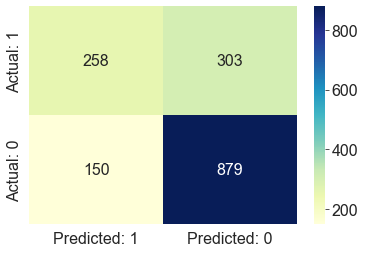

In [384]:
cm = confusion_matrix(y_test, y_best_preds,labels=[1,0])
# visualize confusion matrix with seaborn heatmap

cm_matrix = pd.DataFrame(data=cm, columns=['Predicted: 1', 'Predicted: 0'], 
                                 index=['Actual: 1', 'Actual: 0'])

sns.heatmap(cm_matrix, annot=True, fmt='d', cmap='YlGnBu')

In [385]:
test = X_test.reset_index()
test["red_pred"] = y_best_preds
test["two_year_red"] = y_test.tolist()
test["red_pred_proba"] = probs
races = test.groupby(["race_group","red_pred","two_year_red"]).size().reset_index(name="counts")
print(races[(races.race_group==0) & (races.two_year_red == 1) & (races.red_pred ==0)]["counts"].values[0],
races[(races.race_group==1) & (races.two_year_red == 1) & (races.red_pred ==0)]["counts"].values[0],
races[(races.race_group==10) & (races.two_year_red == 1) & (races.red_pred ==0)]["counts"].values[0])

140 107 56


In [386]:
pd.set_option("display.max_rows", None)
pd.set_option("display.max_columns", None)
rf_fn = test[(test.two_year_red == 1) & (test.red_pred == 0)]
#33% are first time offenders, 57% have commited max one crime before, 73% have commited max 2 crimes before, 81% committed max 3 crimes before
rf_fn.groupby("priors_count").sex.count()

priors_count
0     101
1      73
2      46
3      25
4      12
5      10
6       9
7       9
8      12
9       3
10      2
12      1
Name: sex, dtype: int64

In [387]:
#whats going on with the 58 persons that are FN although having commited >3 crimes before?
#31 of them are african american and 10 are from other races!
rf_fn[rf_fn.priors_count > 3].groupby("race_group").sex.count()

race_group
0     31
1     17
10    10
Name: sex, dtype: int64

#### Who was predicted badly?

0.3325017566467414

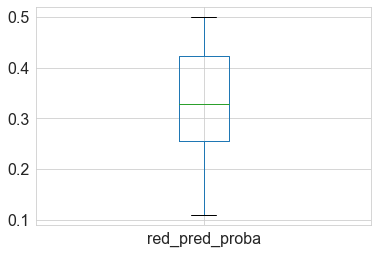

In [388]:
rf_fn.boxplot("red_pred_proba")
#nobody with a probability of lower than 0.11 was predicted as recidive!
#but there is a large body of people in the range of 0.26 to 0.42
rf_fn.red_pred_proba.mean()

In [389]:
bad_preds = rf_fn[rf_fn.red_pred_proba < 0.4]
bad_preds.groupby("priors_count").sex.count()
#the very most of these only commited 1-2 crimes before!

priors_count
0    84
1    57
2    32
3    18
4     6
5     3
6     2
7     2
Name: sex, dtype: int64

<AxesSubplot:>

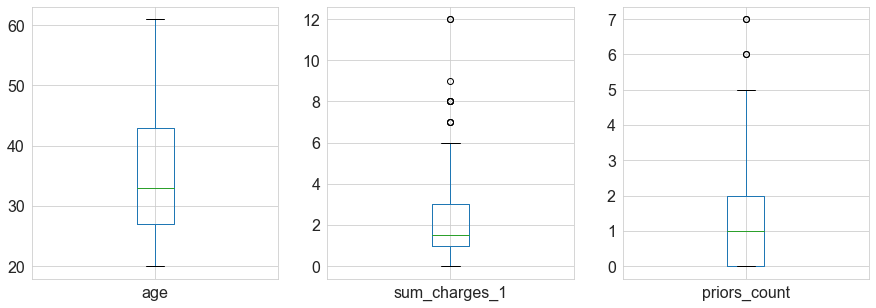

In [390]:
fig, ax = plt.subplots(1,3,figsize=(15,5))
bad_preds.boxplot("age", ax = ax[0])
bad_preds.boxplot("sum_charges_1", ax = ax[1])
bad_preds.boxplot("priors_count", ax = ax[2])
#overall these bad predictions are people that have not much of a criminal record

#### Who was FNR with strong predictors? 

<AxesSubplot:>

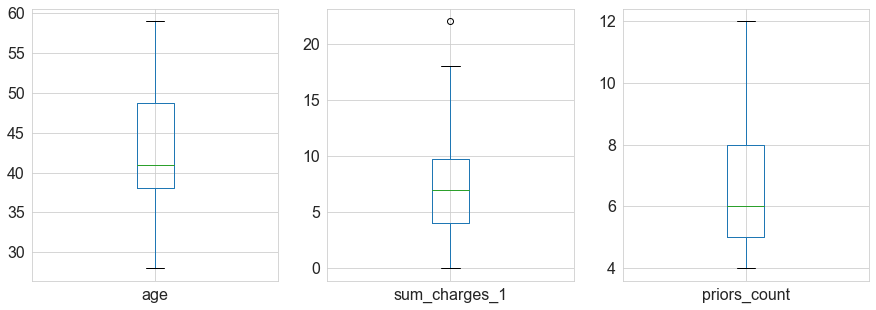

In [391]:
#how about the top3 predictors?
fig, ax = plt.subplots(1,3,figsize=(15,5))
rf_fn[rf_fn.priors_count > 3].boxplot("age", ax = ax[0])
rf_fn[rf_fn.priors_count > 3].boxplot("sum_charges_1", ax = ax[1])
rf_fn[rf_fn.priors_count > 3].boxplot("priors_count", ax = ax[2])

In [392]:
age_outliers = rf_fn[(rf_fn.age < 37) & (rf_fn.priors_count > 3)]
charge1_outlier = rf_fn[(rf_fn.sum_charges_1 > 17) & (rf_fn.priors_count > 3)]
priors_count_outlier = rf_fn[(rf_fn.priors_count > 8)]
priors_count_outlier_low = rf_fn[(rf_fn.priors_count == 4)]

##### Charge1 FNs

In [393]:
charge1_outlier

,index,sex,age,priors_count,juv_fel_count,juv_misd_count,juv_other_count,relationship,max_charge_degree,sum_charges_0,sum_charges_1,sum_charges_2,sum_charges_3,sum_charges_4,sum_charges_5,mean_charges_per_case,race_group,red_pred,two_year_red,red_pred_proba
83,2534,0,50,9,0,0,0,0,2.0,11.0,22.0,2.0,0.0,0.0,0.0,2.333333,10,0,1,0.494040
1010,136,0,45,8,0,0,0,0,2.0,7.0,18.0,2.0,0.0,0.0,0.0,2.076923,1,0,1,0.415009


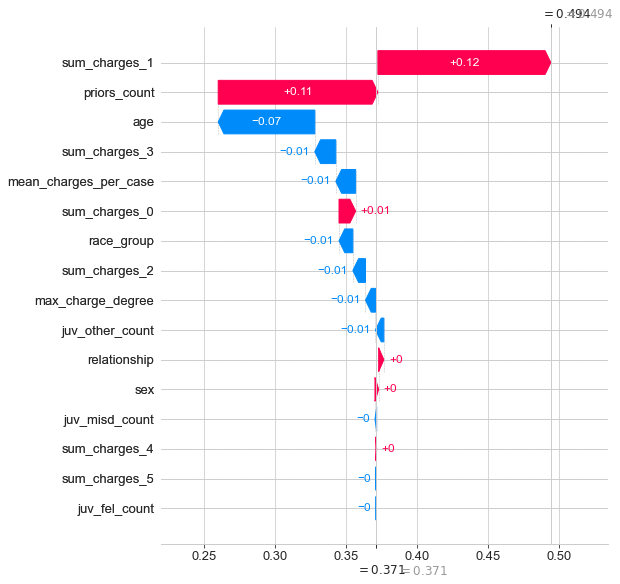

83 0.49404032536613657


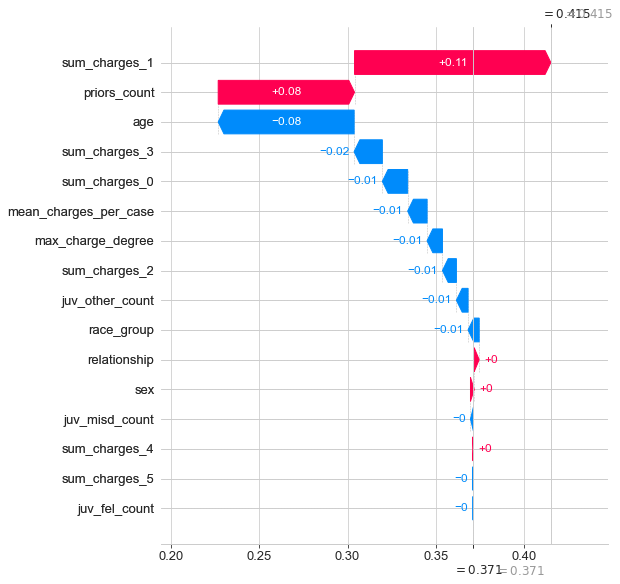

1010 0.4150090535213884


In [394]:
for i in charge1_outlier.index:
    shap.plots._waterfall.waterfall_legacy(rf_explainer.expected_value[1], rf_shap_values_test[1][i], max_display=18, feature_names=X_test.columns)
    print(i, probs[i])

In [395]:
#Both of these are just very close calls that were under-valued because of their age!

##### Priors_count FNs

In [396]:
priors_count_outlier 

,index,sex,age,priors_count,juv_fel_count,juv_misd_count,juv_other_count,relationship,max_charge_degree,sum_charges_0,sum_charges_1,sum_charges_2,sum_charges_3,sum_charges_4,sum_charges_5,mean_charges_per_case,race_group,red_pred,two_year_red,red_pred_proba
74,2406,0,58,10,0,0,0,0,3.0,24.0,10.0,5.0,1.0,0.0,0.0,1.818182,0,0,1,0.492147
83,2534,0,50,9,0,0,0,0,2.0,11.0,22.0,2.0,0.0,0.0,0.0,2.333333,10,0,1,0.494040
268,2708,0,39,9,0,0,0,1,3.0,17.0,12.0,1.0,1.0,0.0,0.0,1.937500,1,0,1,0.485786
668,2407,0,42,9,0,0,0,0,2.0,6.0,11.0,5.0,0.0,0.0,0.0,2.200000,0,0,1,0.443136
848,4526,0,49,10,0,0,0,0,3.0,9.0,14.0,9.0,1.0,0.0,0.0,2.538462,0,0,1,0.496888
1565,4286,0,49,12,0,0,0,0,3.0,6.0,3.0,81.0,7.0,0.0,0.0,6.062500,1,0,1,0.447049


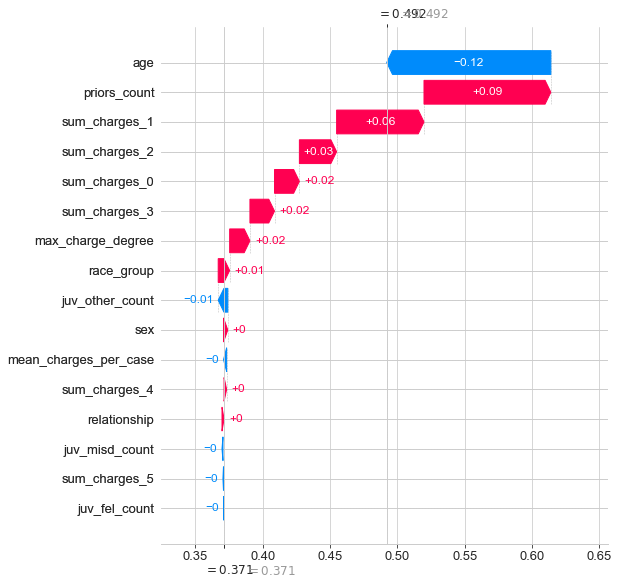

74 0.49214741689595426


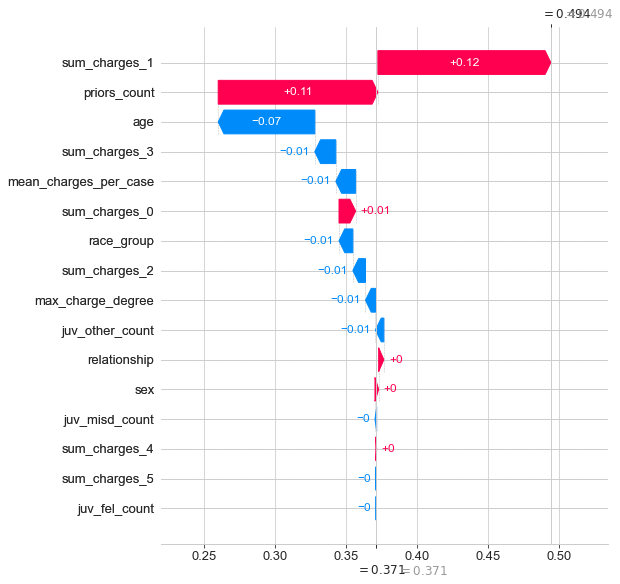

83 0.49404032536613657


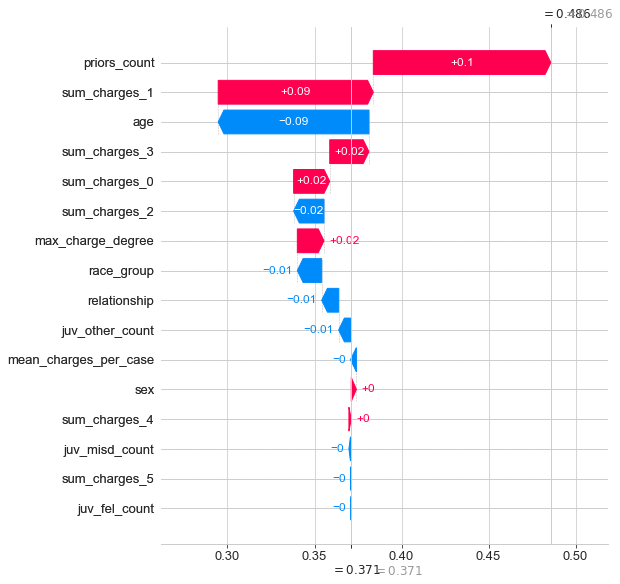

268 0.48578577191492983


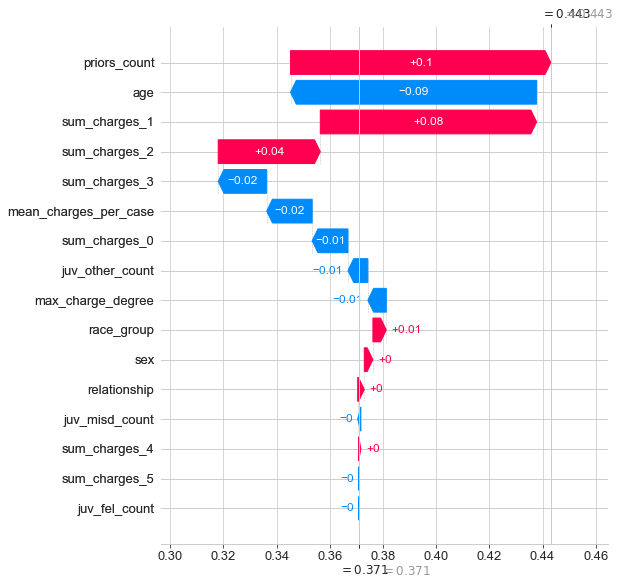

668 0.44313630015224914


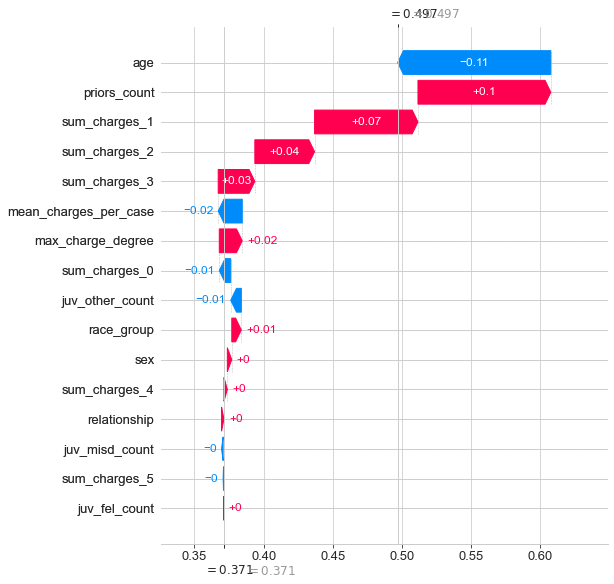

848 0.49688759414085015


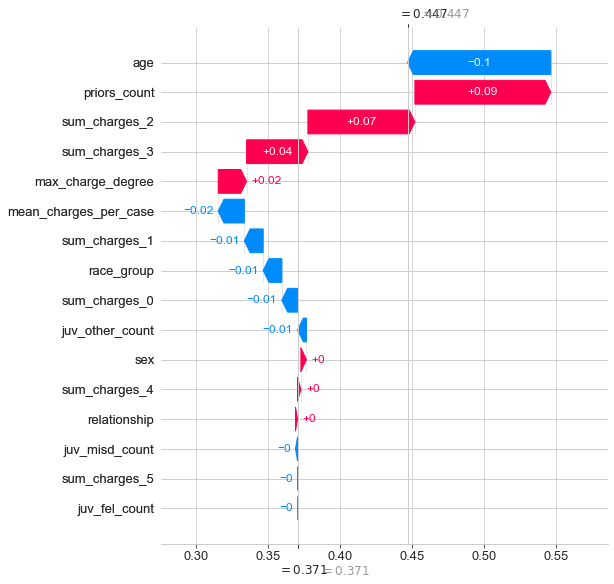

1565 0.4470490328369574


In [397]:
for i in priors_count_outlier.index:
    shap.plots._waterfall.waterfall_legacy(rf_explainer.expected_value[1], rf_shap_values_test[1][i], max_display=18, feature_names=X_test.columns)
    print(i, probs[i])

In [398]:
#again all of these were pretty close calls

##### low priors_count FNs

In [399]:
priors_count_outlier_low

,index,sex,age,priors_count,juv_fel_count,juv_misd_count,juv_other_count,relationship,max_charge_degree,sum_charges_0,sum_charges_1,sum_charges_2,sum_charges_3,sum_charges_4,sum_charges_5,mean_charges_per_case,race_group,red_pred,two_year_red,red_pred_proba
115,1026,0,48,4,0,0,0,1,2.0,13.0,8.0,1.0,0.0,0.0,0.0,2.000000,10,0,1,0.392421
504,5116,0,45,4,0,0,0,0,2.0,17.0,2.0,2.0,0.0,0.0,0.0,1.312500,1,0,1,0.360007
669,4750,0,54,4,0,0,0,1,4.0,4.0,2.0,0.0,1.0,8.0,0.0,2.142857,0,0,1,0.259741
783,644,0,33,4,0,0,0,0,2.0,15.0,5.0,2.0,0.0,0.0,0.0,1.375000,10,0,1,0.495377
882,5214,0,33,4,0,0,0,0,2.0,5.0,5.0,5.0,0.0,0.0,0.0,2.142857,0,0,1,0.483684
913,5117,0,32,4,0,0,0,1,2.0,5.0,5.0,1.0,0.0,0.0,0.0,1.833333,0,0,1,0.399178
991,44,0,38,4,0,0,0,0,2.0,10.0,11.0,1.0,0.0,0.0,0.0,2.000000,1,0,1,0.415521
1059,4207,0,43,4,0,0,0,0,4.0,3.0,1.0,0.0,3.0,2.0,0.0,2.250000,0,0,1,0.289965
1381,2101,0,40,4,0,0,0,0,3.0,1.0,4.0,1.0,1.0,0.0,0.0,1.166667,10,0,1,0.438852
1399,1463,0,59,4,0,0,0,0,2.0,0.0,2.0,3.0,0.0,0.0,0.0,1.000000,0,0,1,0.365590


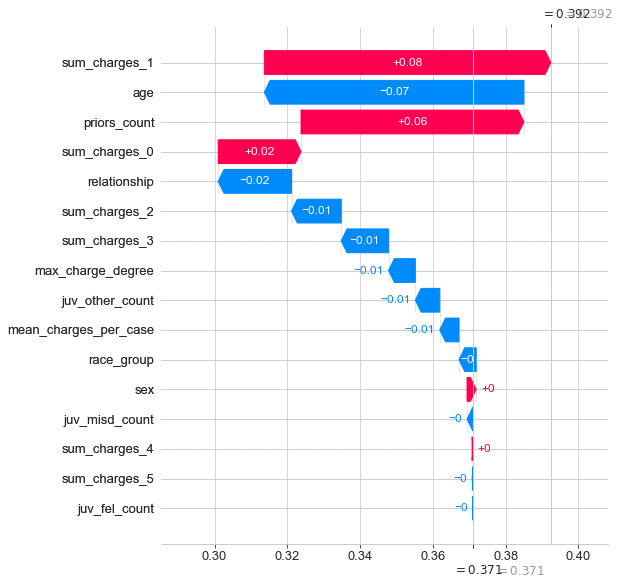

115 0.39242084375749187


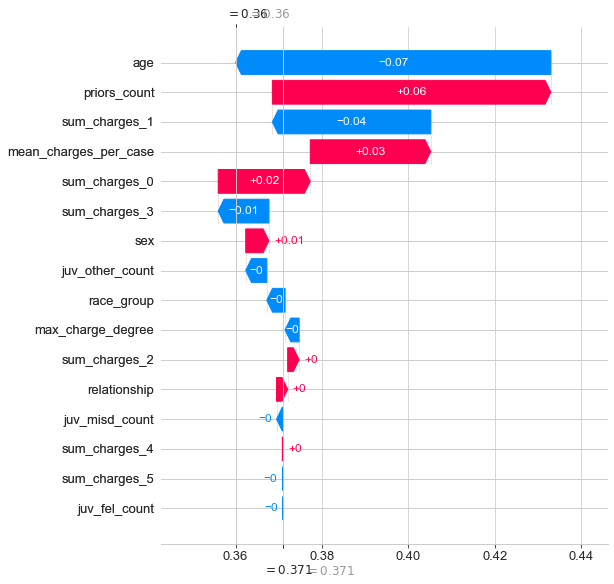

504 0.3600068484268168


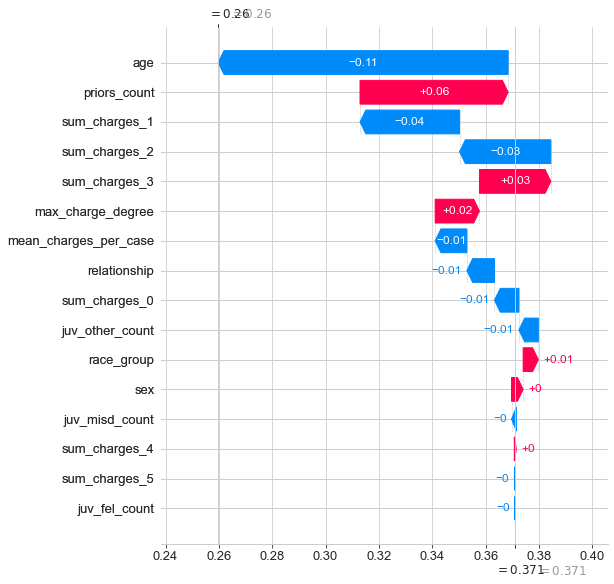

669 0.25974112367250507


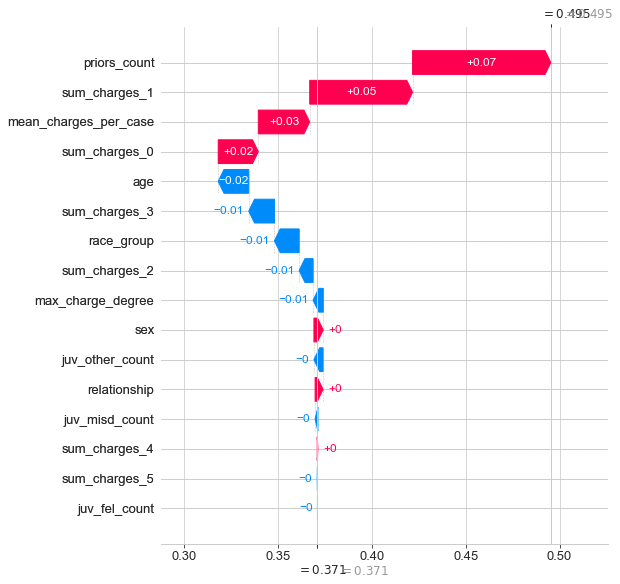

783 0.49537726457260045


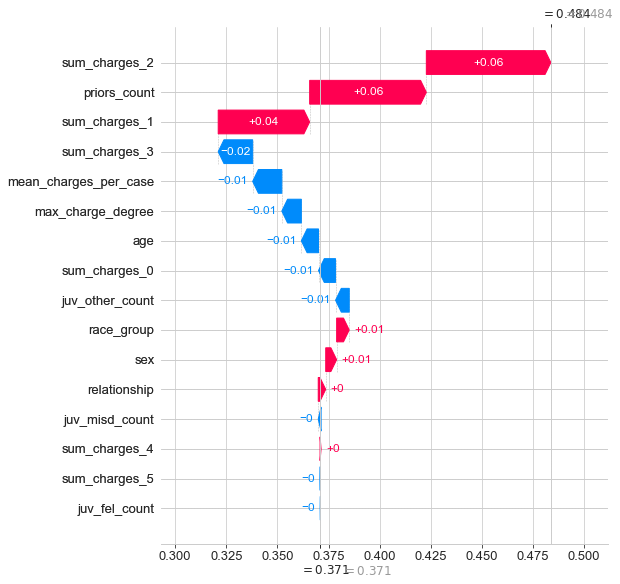

882 0.4836835112252543


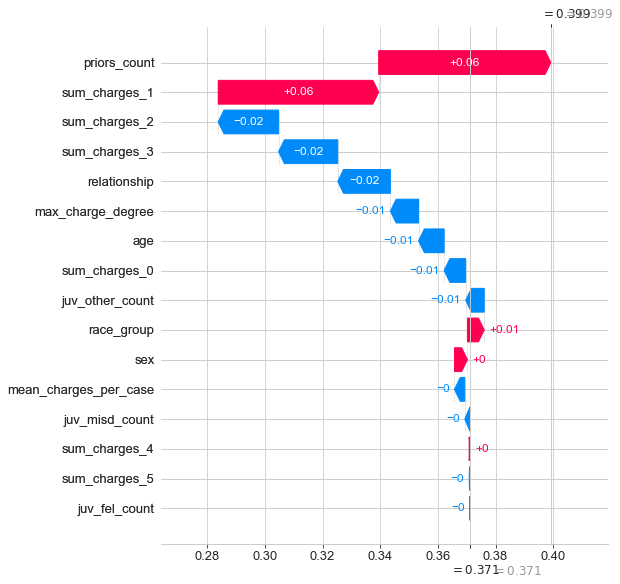

913 0.39917771467397045


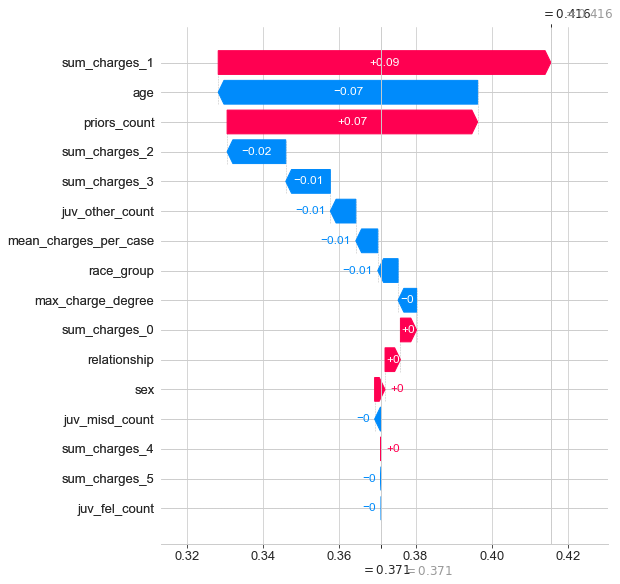

991 0.4155213445840355


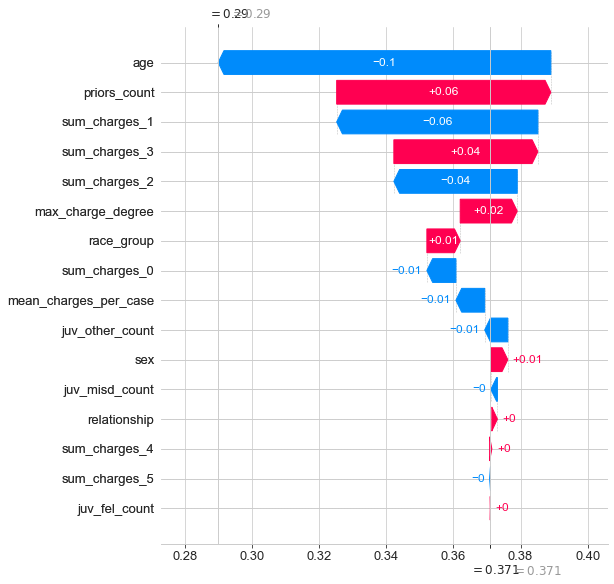

1059 0.2899653329211376


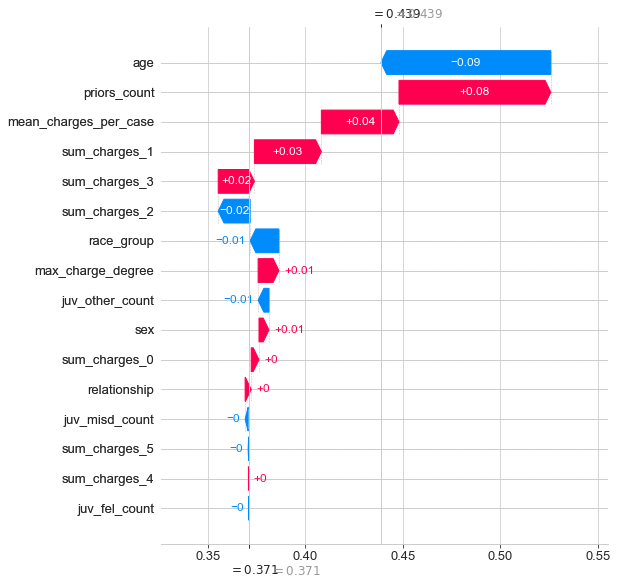

1381 0.43885249157707257


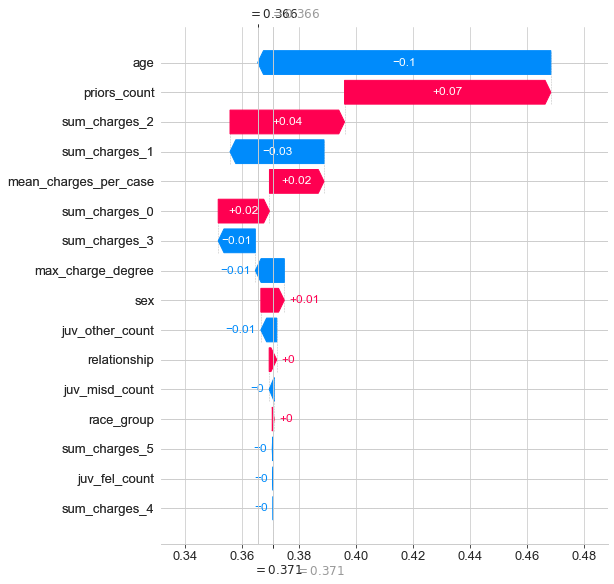

1399 0.3655897920233916


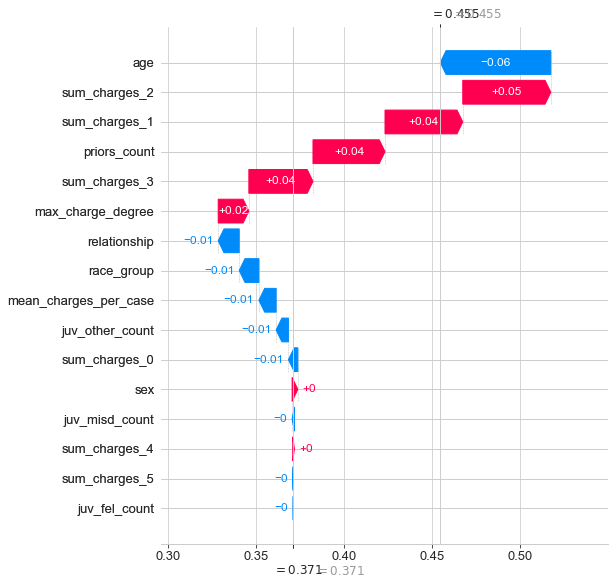

1444 0.45464764460632606


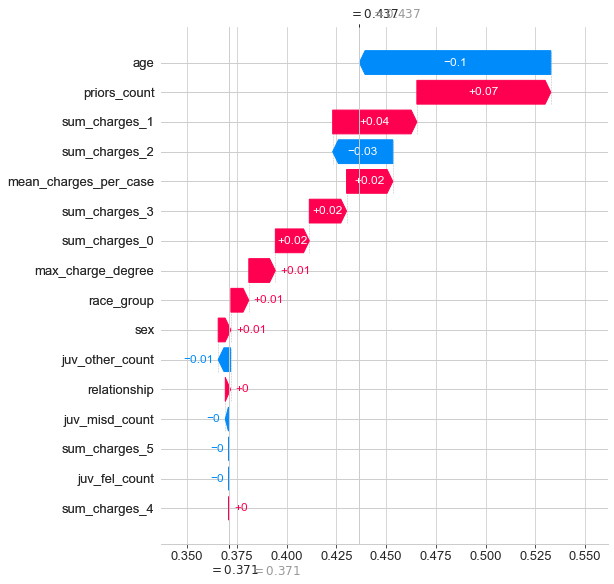

1575 0.4365217300138452


In [400]:
for i in priors_count_outlier_low.index:
    shap.plots._waterfall.waterfall_legacy(rf_explainer.expected_value[1], rf_shap_values_test[1][i], max_display=18, feature_names=X_test.columns)
    print(i, probs[i])

In [401]:
# again it seems like age often makes the overall difference on these people

##### age FNs

In [402]:
age_outliers

,index,sex,age,priors_count,juv_fel_count,juv_misd_count,juv_other_count,relationship,max_charge_degree,sum_charges_0,sum_charges_1,sum_charges_2,sum_charges_3,sum_charges_4,sum_charges_5,mean_charges_per_case,race_group,red_pred,two_year_red,red_pred_proba
29,81,0,33,5,0,0,0,1,2.0,9.0,11.0,3.0,0.0,0.0,0.0,2.090909,0,0,1,0.472150
313,2508,1,36,5,0,0,0,0,2.0,4.0,7.0,4.0,0.0,0.0,0.0,1.875000,0,0,1,0.455873
451,4291,0,31,5,0,0,0,0,4.0,7.0,2.0,15.0,0.0,1.0,0.0,1.923077,10,0,1,0.481784
530,4082,1,36,7,0,0,0,0,3.0,0.0,3.0,12.0,8.0,0.0,0.0,2.875000,1,0,1,0.478673
678,834,0,35,5,0,0,0,0,2.0,6.0,6.0,1.0,0.0,0.0,0.0,1.625000,0,0,1,0.375312
783,644,0,33,4,0,0,0,0,2.0,15.0,5.0,2.0,0.0,0.0,0.0,1.375000,10,0,1,0.495377
882,5214,0,33,4,0,0,0,0,2.0,5.0,5.0,5.0,0.0,0.0,0.0,2.142857,0,0,1,0.483684
913,5117,0,32,4,0,0,0,1,2.0,5.0,5.0,1.0,0.0,0.0,0.0,1.833333,0,0,1,0.399178
1065,4036,0,30,6,0,0,0,0,2.0,11.0,6.0,1.0,0.0,0.0,0.0,1.800000,10,0,1,0.498864
1169,5033,1,29,5,0,0,0,0,4.0,13.0,3.0,0.0,1.0,1.0,0.0,1.800000,0,0,1,0.483284


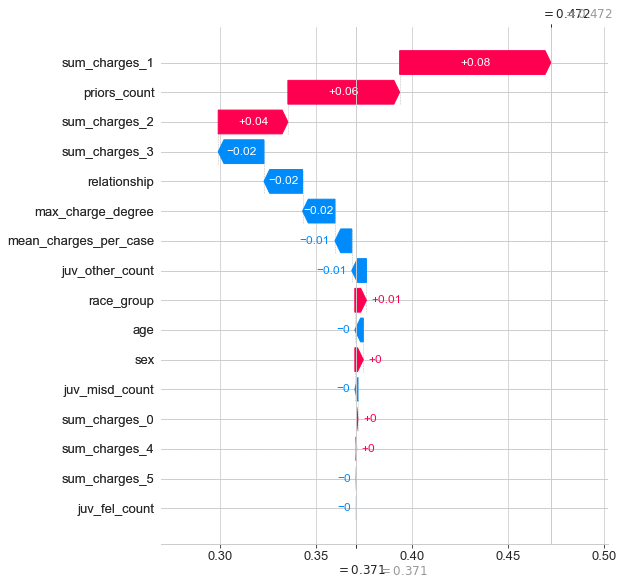

29 0.4721497548563087


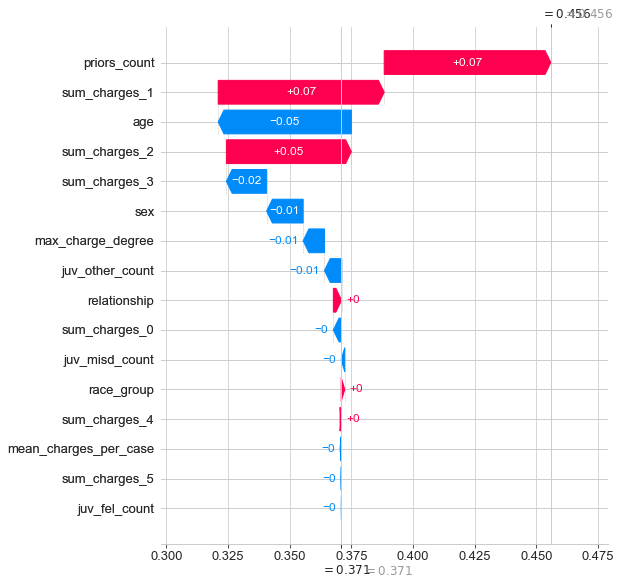

313 0.4558732916019633


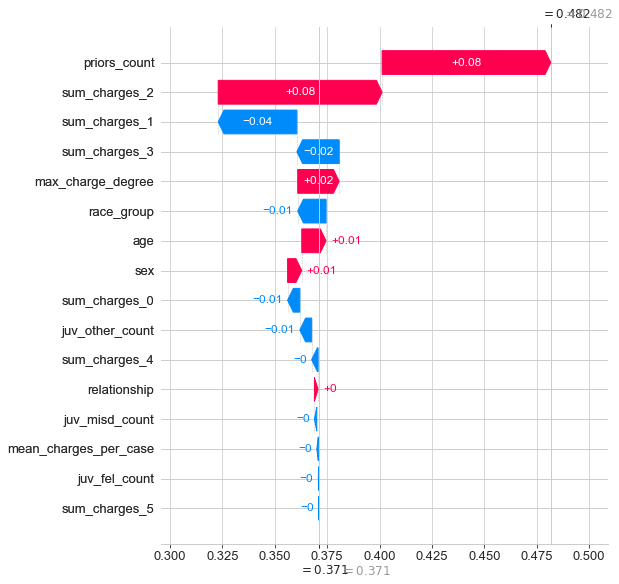

451 0.4817836237752406


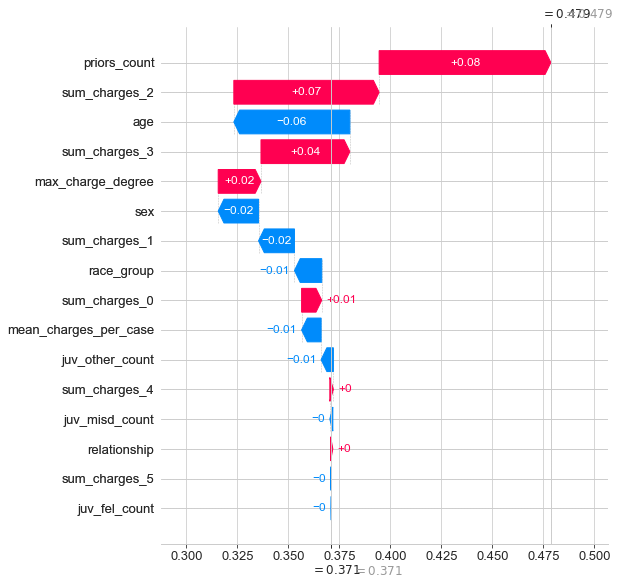

530 0.4786730376644255


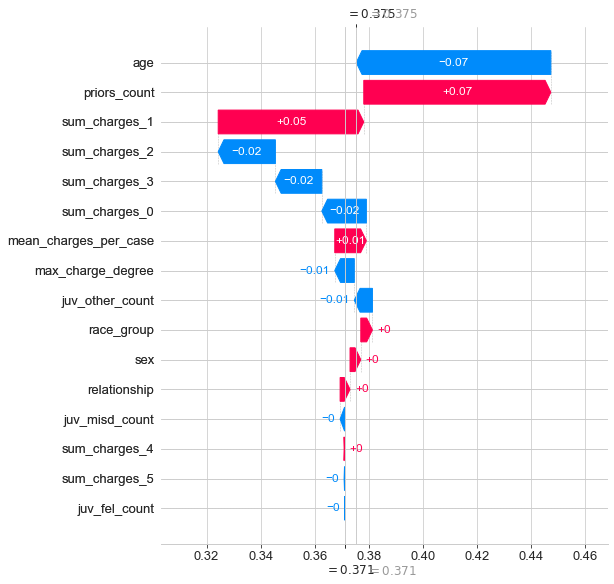

678 0.3753120512897608


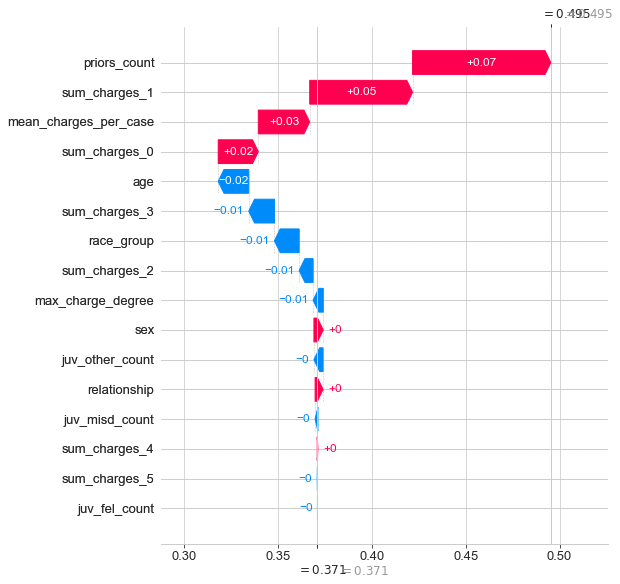

783 0.49537726457260045


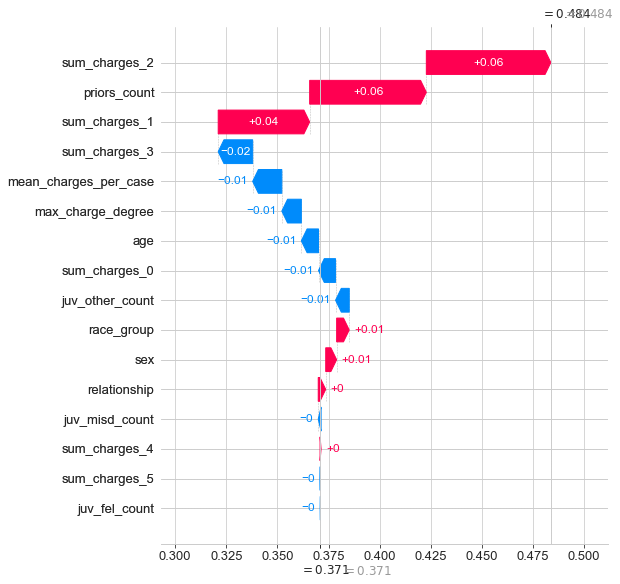

882 0.4836835112252543


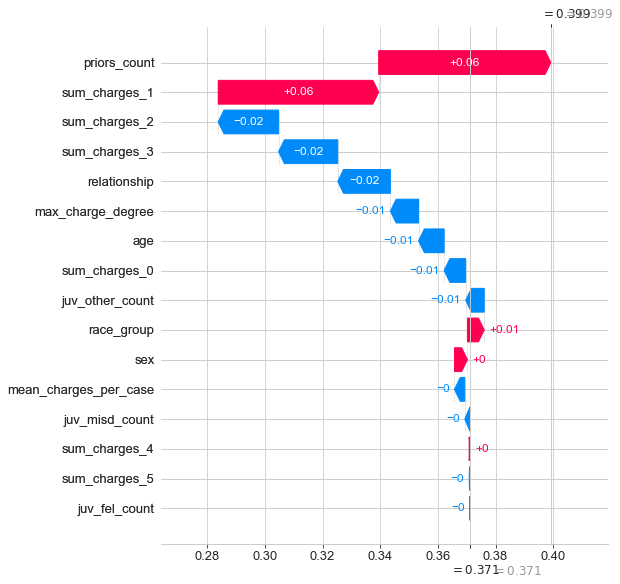

913 0.39917771467397045


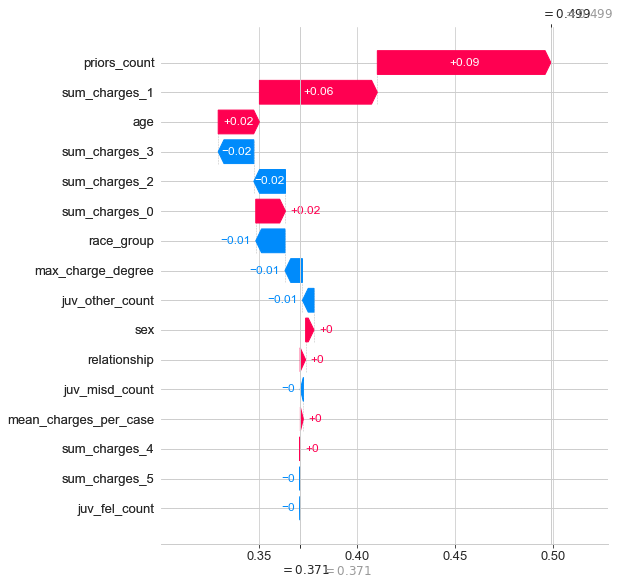

1065 0.49886394711534043


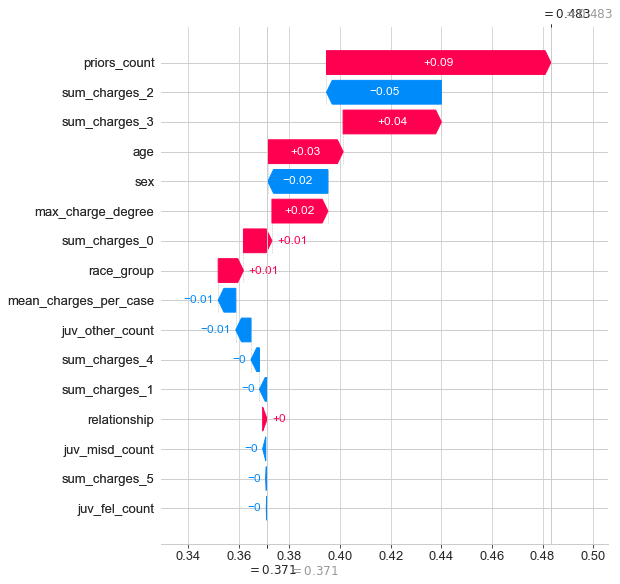

1169 0.4832843158875497


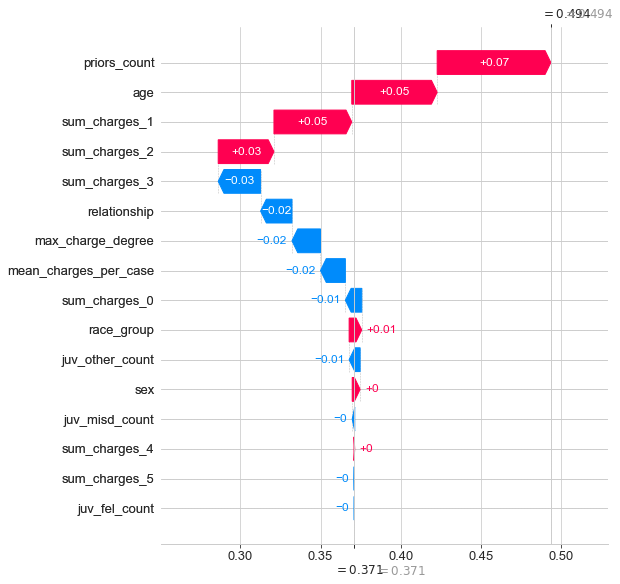

1275 0.4936286573229874


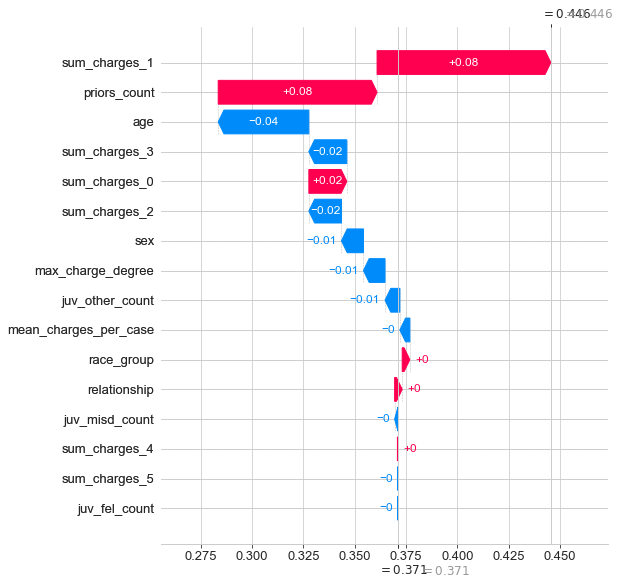

1327 0.445605118891436


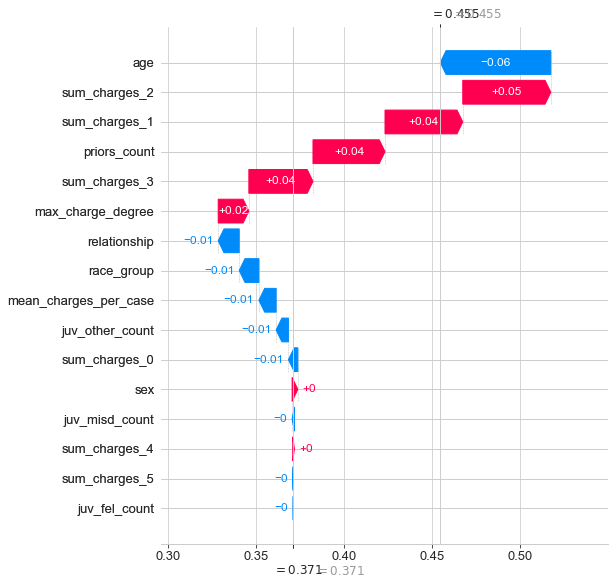

1444 0.45464764460632606


In [403]:
for i in age_outliers.index:
    shap.plots._waterfall.waterfall_legacy(rf_explainer.expected_value[1], rf_shap_values_test[1][i], max_display=18, feature_names=X_test.columns)
    print(i, probs[i])

## Random Forest for Redictivism with Protected Attributes

### Preparation

In [404]:
#Get new Split
labels = df['two_year_recid'].values
cols = df.drop(["Unnamed: 0", "name", "decile_score", "is_violent_recid","two_year_recid","person_id","race","relationship","sex","age"],axis=1)
# Saving feature names for later use
col_names = list(cols.columns)

# Split the data into training and testing sets
X_train_raw, X_test_raw, y_train, y_test = train_test_split(cols, labels, test_size = 0.3, random_state = 1)

X_test = X_test_raw.drop(['race_group'],axis=1)
X_train = X_train_raw.drop(['race_group'],axis=1)

feature_list = list(X_train.columns)
X_test.head(5)

,priors_count,juv_fel_count,juv_misd_count,juv_other_count,max_charge_degree,sum_charges_0,sum_charges_1,sum_charges_2,sum_charges_3,sum_charges_4,sum_charges_5,mean_charges_per_case
359,0,0,0,0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,1.000000
3618,1,0,0,0,3.0,0.0,2.0,0.0,1.0,0.0,0.0,1.500000
2209,0,0,0,0,2.0,1.0,1.0,1.0,0.0,0.0,0.0,1.000000
1499,1,0,0,0,1.0,1.0,3.0,0.0,0.0,0.0,0.0,1.333333
383,0,0,0,0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,1.000000


### Run Grid Search & Train Data

In [405]:
#def runGridSearch(X_train, y_train):
#    from sklearn.model_selection import GridSearchCV
#    # Number of trees in random forest
#    # Using num=2 will significantly reduce run time (~3 min vs ~65 min)
#    n_estimators = [int(x) for x in np.linspace(start = 200, stop = 2000, num = 2)]
#    # Using num=10 will significantly increase run time
#    #n_estimators = [int(x) for x in np.linspace(start = 200, stop = 2000, num = 10)]
#    # Number of features at every split
#    max_features = ['auto', 'sqrt']
#    # Maximum number of levels in tree
#    # Using num=2 will significantly reduce run time (~3 min vs ~65 min)
#    max_depth = [int(x) for x in np.linspace(10, 110, num = 2)]
#    # Using num=10 will significantly increase run time
#    #max_depth = [int(x) for x in np.linspace(10, 110, num = 10)]
#    max_depth.append(None)
#    # Minimum number of samples required to split a node
#    min_samples_split = [2, 5, 10]
#    # Minimum number of samples required at each leaf node
#    min_samples_leaf = [1, 2, 4]
#    # Method of selecting samples for training each tree
#    bootstrap = [True, False]
#    # Create the random grid
#    grid = {'n_estimators': n_estimators,
#                   'max_features': max_features,
#                   'max_depth': max_depth,
#                   'min_samples_split': min_samples_split,
#                   'min_samples_leaf': min_samples_leaf,
#                   'bootstrap': bootstrap}
#
#    # Create a regressor using values from grid
#    rf_reg = RandomForestClassifier()
#    # Instantiate the grid search model
#    grid_search = GridSearchCV(estimator = rf_reg, param_grid = grid, cv = 3, n_jobs = -1, verbose = 1)
#    best_grid = grid_search.fit(X_train, y_train)
#    grid_preds = best_grid.predict(X_test)
#   # Train the classifier
#    return best_grid, grid_preds
#
#    print("The best hyperparameters found during the grid search are:")
#    print(best_grid.best_params_)
#    
#runGridSearch(X_train, y_train)

In [406]:
from sklearn.metrics import precision_score, recall_score, roc_auc_score, roc_curve, f1_score
# Train the Classifier with best hyperparameters from grid search
rf_clf_prot = RandomForestClassifier(max_depth = 65, 
min_samples_split = 10, 
min_samples_leaf = 15, 
max_features = "sqrt", 
n_estimators = 188, random_state=42)
rf_clf_prot.fit(X_train, y_train)

# Perform predictions
train_probs_prot = rf_clf_prot.predict_proba(X_train)[:,1] 
probs_prot = rf_clf_prot.predict_proba(X_test)[:, 1]
train_predictions_prot = rf_clf_prot.predict(X_train)
pred_prot = rf_clf_prot.predict(X_test)
print(accuracy_score(y_test, pred_prot))

print(f'Train ROC AUC Score: {roc_auc_score(y_train, train_probs_prot)}')
print(f'Test ROC AUC  Score: {roc_auc_score(y_test, probs_prot)}')

0.6981132075471698
Train ROC AUC Score: 0.7661782421956842
Test ROC AUC  Score: 0.7154567454687502


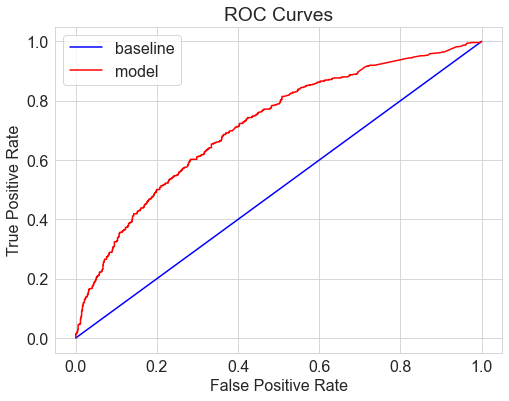

In [407]:
# Calculate false positive rates and true positive rates
base_fpr, base_tpr, _ = roc_curve(y_test, [1 for _ in range(len(y_test))])
model_fpr, model_tpr, thredsholds = roc_curve(y_test, probs_prot)
plt.figure(figsize = (8, 6))
plt.rcParams['font.size'] = 16
# Plot both curves
plt.plot(base_fpr, base_tpr, 'b', label = 'baseline')
plt.plot(model_fpr, model_tpr, 'r', label = 'model')
plt.legend();
plt.xlabel('False Positive Rate');
plt.ylabel('True Positive Rate'); plt.title('ROC Curves');
plt.show();

### Feature Importance

#### Gini Feature Importance

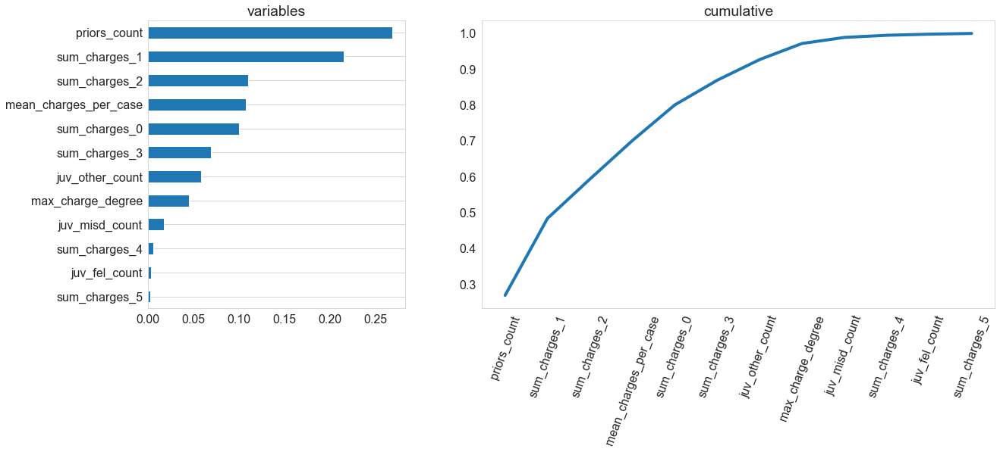

In [408]:
# gini importance plot
gini_importance = rf_clf_prot.feature_importances_

plot_feature_importance(gini_importance,0,0)

#### Permutation Feature Importance

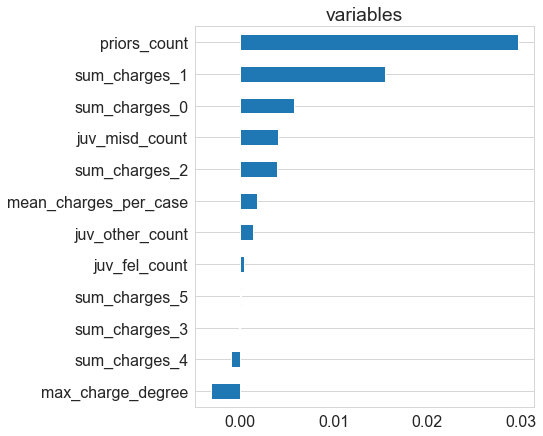

In [409]:
from sklearn.inspection import permutation_importance
#plot permutation feature importance
perm_importance = permutation_importance(rf_clf_prot, X_test, y_test).importances_mean
plot_feature_importance(perm_importance,0,1)

#### PDP Plot

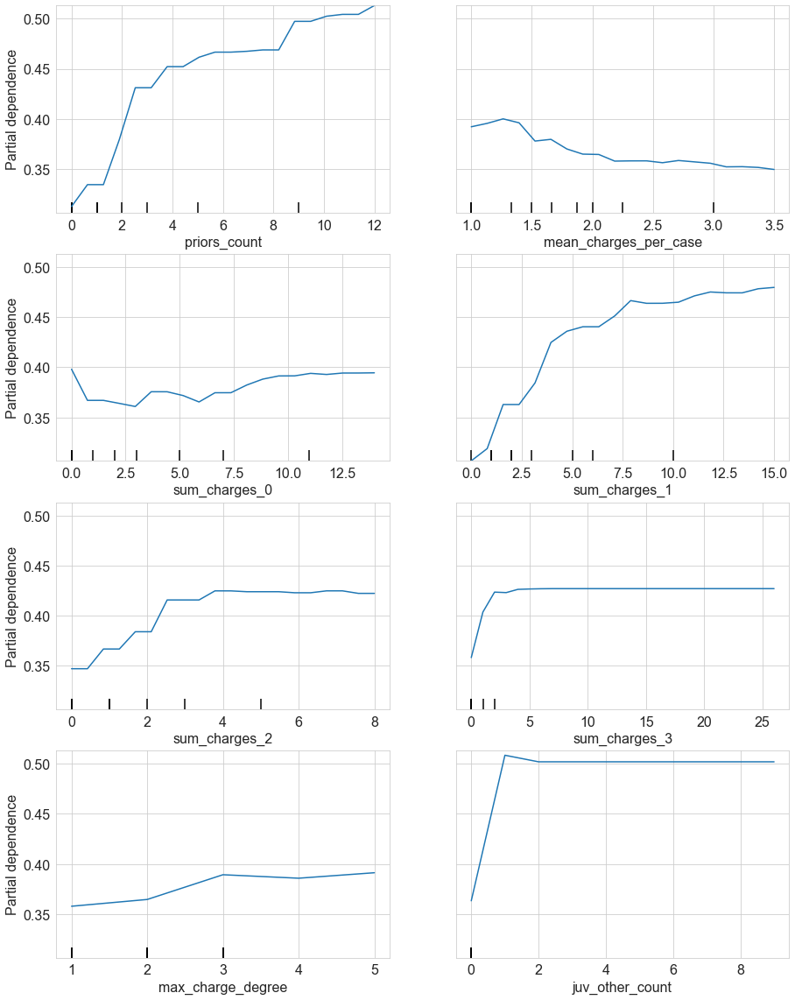

In [410]:
from sklearn.inspection import  plot_partial_dependence
from sklearn.inspection import PartialDependenceDisplay

rf_top_features = ["priors_count","mean_charges_per_case", "sum_charges_0","sum_charges_1", "sum_charges_2","sum_charges_3","max_charge_degree","juv_other_count"]
fig, ax = plt.subplots(figsize=(15,20))

PartialDependenceDisplay.from_estimator(rf_clf_prot, X_train, rf_top_features, n_cols=2, grid_resolution=20, kind="average", ax=ax);


#### SHAP Values

In [411]:
import shap
shap.initjs()

# Generate the Tree SHAP estimator of Shapley values that corresponds to the Random Forest we built
rf_explainer_prot = shap.TreeExplainer(rf_clf_prot)
# Compute the estimated Shapley values for the test sample's observations
rf_shap_values_prot = rf_explainer_prot.shap_values(X_train)

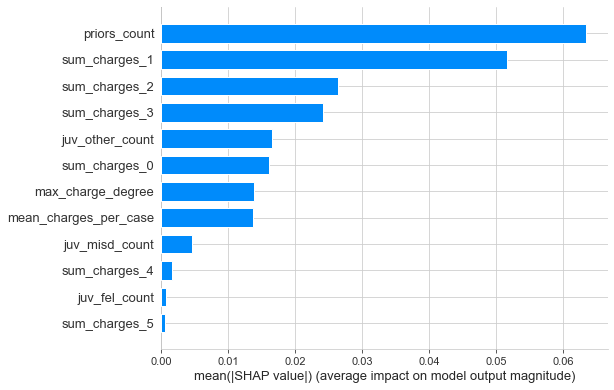

In [412]:
shap.summary_plot(rf_shap_values_prot[0], X_train, plot_type = "bar")

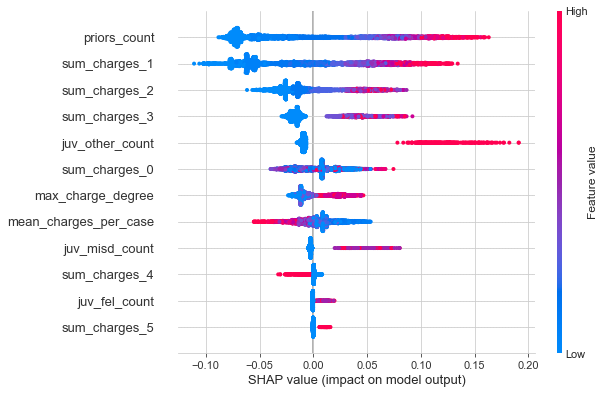

In [413]:
shap.summary_plot(rf_shap_values_prot[1], X_train)

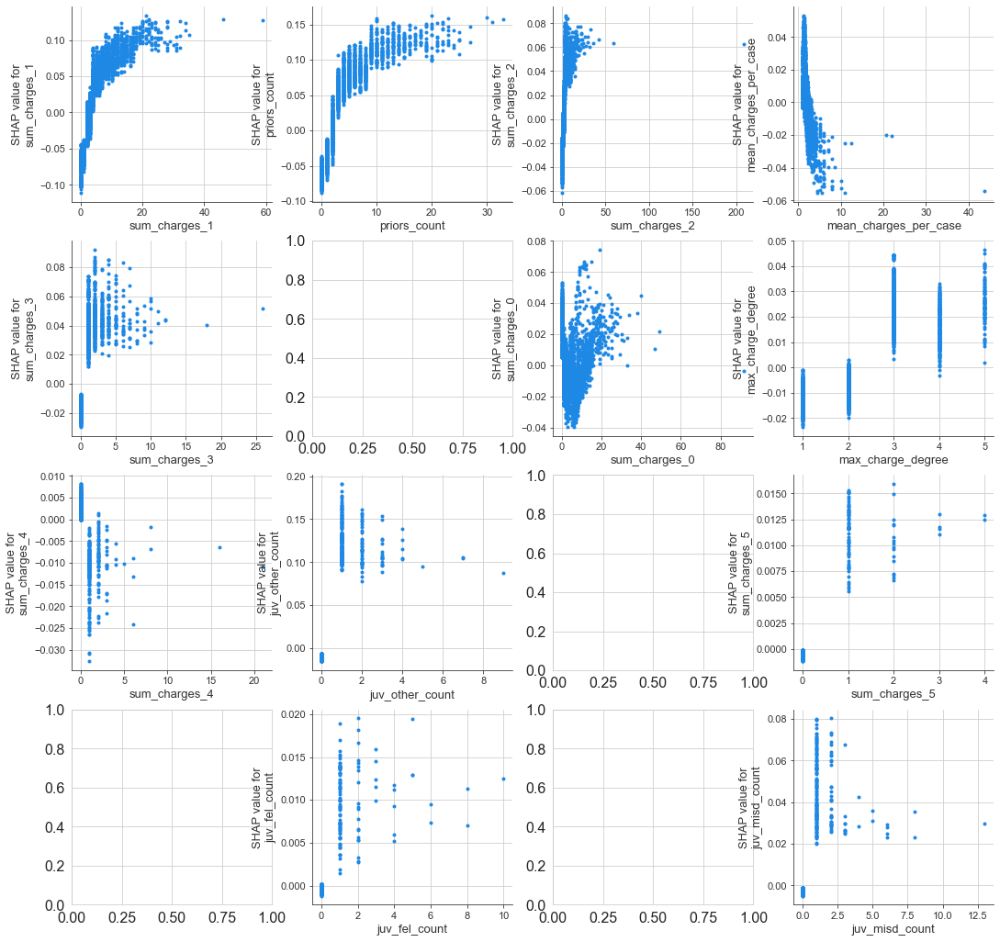

In [414]:
fig, axes = plt.subplots(nrows=4, ncols=4, figsize=(18,18))
shap.dependence_plot("sum_charges_1", rf_shap_values_prot[1], X_train, interaction_index = None, ax = axes[0,0], show = False)
shap.dependence_plot("priors_count", rf_shap_values_prot[1], X_train, interaction_index = None, ax = axes[0,1], show = False)
shap.dependence_plot("sum_charges_2", rf_shap_values_prot[1], X_train, interaction_index = None, ax = axes[0,2], show = False)
shap.dependence_plot("mean_charges_per_case", rf_shap_values_prot[1], X_train, interaction_index = None, ax = axes[0,3], show = False)
shap.dependence_plot("sum_charges_3", rf_shap_values_prot[1], X_train, interaction_index = None, ax = axes[1,0], show = False)
shap.dependence_plot("sum_charges_0", rf_shap_values_prot[1], X_train, interaction_index = None, ax = axes[1,2], show = False)
shap.dependence_plot("max_charge_degree", rf_shap_values_prot[1], X_train, interaction_index = None, ax = axes[1,3], show = False)
shap.dependence_plot("sum_charges_4", rf_shap_values_prot[1], X_train, interaction_index = None, ax = axes[2,0], show = False)
shap.dependence_plot("juv_other_count", rf_shap_values_prot[1], X_train, interaction_index = None, ax = axes[2,1], show = False)
shap.dependence_plot("sum_charges_5", rf_shap_values_prot[1], X_train, interaction_index = None, ax = axes[2,3], show = False)
shap.dependence_plot("juv_fel_count", rf_shap_values_prot[1], X_train, interaction_index = None, ax = axes[3,1], show = False)
shap.dependence_plot("juv_misd_count", rf_shap_values_prot[1], X_train, interaction_index = None, ax = axes[3,3], show = False)

<AxesSubplot:>

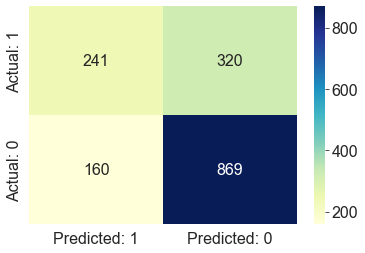

In [415]:
# Print the Confusion Matrix
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay


cm = confusion_matrix(y_test, pred_prot,labels=[1,0])
# visualize confusion matrix with seaborn heatmap

cm_matrix = pd.DataFrame(data=cm, columns=['Predicted: 1', 'Predicted: 0'], 
                                 index=['Actual: 1', 'Actual: 0'])

sns.heatmap(cm_matrix, annot=True, fmt='d', cmap='YlGnBu')

### Confusion Matrix & TPR, FPR, FNR by races

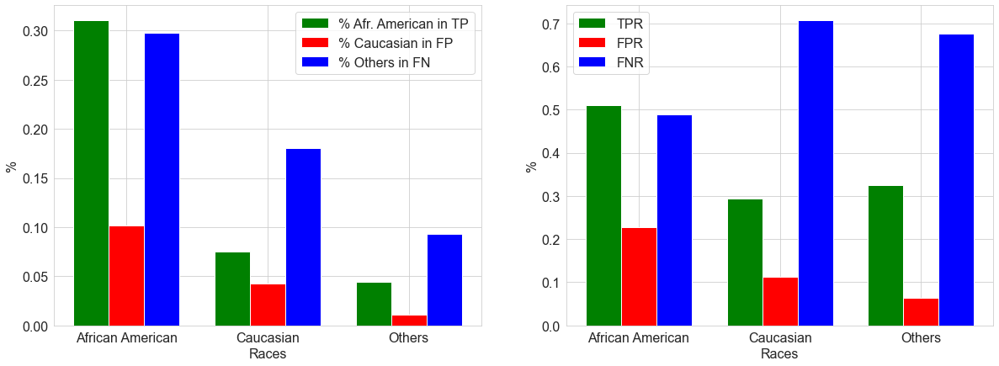

In [416]:
calculateRates(X_test_raw, y_test, pred_prot)

As already explained the meaning of these 2 charts above, we will only discuss how these charts are different from the ones generated by our Random Forest model including Protected Attributes. 

Some important notes are:
- False Negative Rate gap between racial groups are a bit narrower, however, more Caucasians are still around 20% more likely to get away compared to African Americans. 

- The False Postive Rate gap between groups remains more or less the same

In conclusion, even though we have excluded the Protected Attributes before training the model, there is not so much of fairness to be gained after all. We suspect that the bias problem is not caused by the model or our selected features but mostly because of other non-machine-learning factors that are correlated with Protected Attributes (especially race). 


# Boosting

## Set Up

In [417]:
from sklearn.ensemble import AdaBoostClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import RepeatedStratifiedKFold
from sklearn.model_selection import GridSearchCV
import xgboost as xgb
from sklearn.model_selection import train_test_split
from sklearn.metrics import confusion_matrix
from sklearn.metrics import classification_report
from urllib.request import urlretrieve
from xgboost import plot_tree
from sklearn.metrics import mean_squared_error
from sklearn.metrics import r2_score
from sklearn.inspection import  permutation_importance,plot_partial_dependence
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.model_selection import GridSearchCV
from sklearn.inspection import PartialDependenceDisplay
from xgboost import XGBClassifier
from sklearn import metrics
from sklearn.metrics import roc_curve
from sklearn.metrics import roc_auc_score
import sklearn
import seaborn as sns
import matplotlib.pyplot as plt
import shap
import pandas as pd
import numpy as np
#from yellowbrick.classifier import ClassBalance, ROCAUC, ClassificationReport, ClassPredictionError
from sklearn.metrics import f1_score, recall_score, precision_score

def model_metrics(objective, prediction):
    score = accuracy_score(objective, prediction)
    class_report = classification_report(objective, prediction)
    model_metrics = [score, class_report]
    return(model_metrics)

In [418]:
#Again, get the df for the upcoming predictions (making sure the data is used)
df = pd.read_csv("../data/processed_race_groups_corrected.csv")
df.sex.replace(['Male', 'Female'], [0,1], inplace=True)
df.race.replace(['African-American', 'Caucasian', 'Hispanic', 'Other', 'Asian', 'Native American'], [0,1,2,3,4,5], inplace=True)

In [419]:
#Training and Test Sets
X = df.drop(["name","two_year_recid", "person_id", "decile_score", "is_violent_recid", "Unnamed: 0", "race"], axis=1)
y = df["two_year_recid"]

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.3, random_state=1)

## AdaBoost

AdaBoost is the first boosting model we will try. It accomplishes its task, but both Gradient Boosting and XGBoosting offer better results, so AdaBoost will be dismissed for future predicitons.

### AdaBoost Model

In [420]:
#Creating a tree for AdaBoost
tree = DecisionTreeClassifier()

#Param Grid for CV
param_grid_ADA = {
    "n_estimators": [5,25,50,75,100,125,150,175,200,225,250],
    "learning_rate": [0.06, 0.08, 0.1, 0.12, 0.14, 0.16, 0.18, 0.2, 0.5, 1],  
                 }
#AdaBoost Classifier with CV
#ada = AdaBoostClassifier(base_estimator=tree, random_state=1)
#ada_cv = GridSearchCV(ada, param_grid_ADA, cv=5)
#ada_cv.fit(X_train, y_train)
#ada_cv.best_params_

In [421]:
# Optimal Model
# {'learning_rate': 0.2, 'n_estimators': 200}
ADA_optimal = AdaBoostClassifier(learning_rate = 0.2, n_estimators = 200)
ADA_optimal.fit(X_train.values,y_train)

AdaBoostClassifier(learning_rate=0.2, n_estimators=200)

In [422]:
#Prediction AdaBoost
ADA_pred = ADA_optimal.predict(X_test)

#### Metrics

The accuracy of ADA is 70,69%

In [423]:
metricsADA = model_metrics(y_test, ADA_pred)
[print(i) for i in metricsADA]

0.7069182389937106
              precision    recall  f1-score   support

           0       0.75      0.83      0.79      1029
           1       0.61      0.48      0.54       561

    accuracy                           0.71      1590
   macro avg       0.68      0.66      0.66      1590
weighted avg       0.70      0.71      0.70      1590



[None, None]

In [424]:
#Other model metrics for model comparison
tn, fp, fn, tp = confusion_matrix(y_test, ADA_pred, labels=[0, 1]).ravel()
fnr_ADA = fn / (fn + tp)
fpr_ADA = fp / (fp + tn)
fnr_ADA, fpr_ADA, f1_score(y_test, ADA_pred), recall_score(y_test, ADA_pred), precision_score(y_test, ADA_pred)

(0.5187165775401069,
 0.17006802721088435,
 0.536779324055666,
 0.48128342245989303,
 0.6067415730337079)

#### Confusion Matrix

<AxesSubplot:>

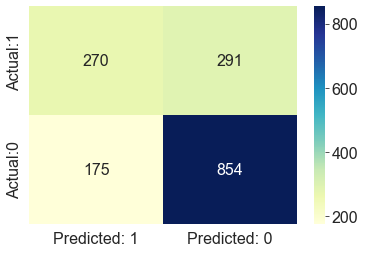

In [425]:
cm = confusion_matrix(y_test, ADA_pred, labels=[1,0])

cm_matrix = pd.DataFrame(data=cm, columns=['Predicted: 1','Predicted: 0'], 
                                 index=['Actual:1','Actual:0'])

sns.heatmap(cm_matrix, annot=True, fmt='d', cmap='YlGnBu')

#### ROC and AUC

The AUC of the ADA model is 73,37%

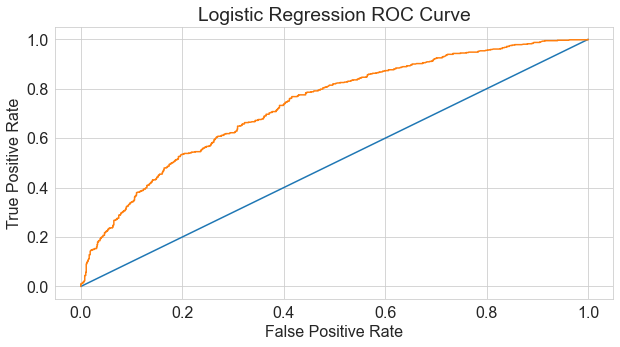

In [426]:
#ROC
ADA_pred_prob = ADA_optimal.predict_proba(X_test)[:,1]
fpr, tpr, thresholds = roc_curve(y_test, ADA_pred_prob)
plt.figure(figsize = (10,5))
plt.plot([0,1], [0,1])
plt.plot(fpr,tpr,label="ADA")
plt.xlabel("False Positive Rate")
plt.ylabel("True Positive Rate")
plt.title("Logistic Regression ROC Curve")
plt.show();

In [427]:
#AUC
roc_auc_score(y_test, ADA_pred_prob)

0.7337714306501821

#### Race analysis

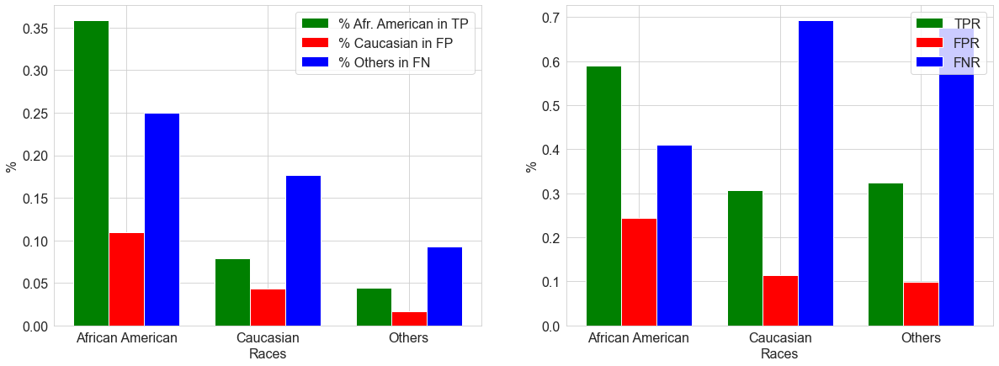

In [428]:
 calculateRates(X_test, y_test, ADA_pred)

AdaBoost model also has issues with misclassifying non-recidive African Americans almost 2 times more than 2 other race groups. False Negative Rates of Caucasians and Others are a little bit more improved compared to Random Forest, meaning less actual recidive Caucasians and Other Races get away, but are still much higher than African American group.

### AdaBoost Feature Analysis

#### MDI

Priors_count and Age are the most contributing features in the predictions of the ADA model

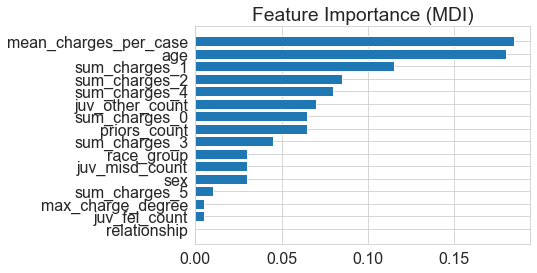

In [429]:
feature_importance_ADA = ADA_optimal.feature_importances_
sorted_idx = np.argsort(feature_importance_ADA)
pos = np.arange(sorted_idx.shape[0]) + 0.5
plt.barh(pos, feature_importance_ADA[sorted_idx], align="center")
plt.yticks(pos, np.array(X.columns)[sorted_idx])
plt.title("Feature Importance (MDI)")
plt.rcParams["figure.figsize"] = (10,5)

#### PDP

While priors_count has a positive correlation with the probability of recividism, age is negatively correlated with it.
Here are the Partial Dependence Plots of the top 5 features depending on their model importance.

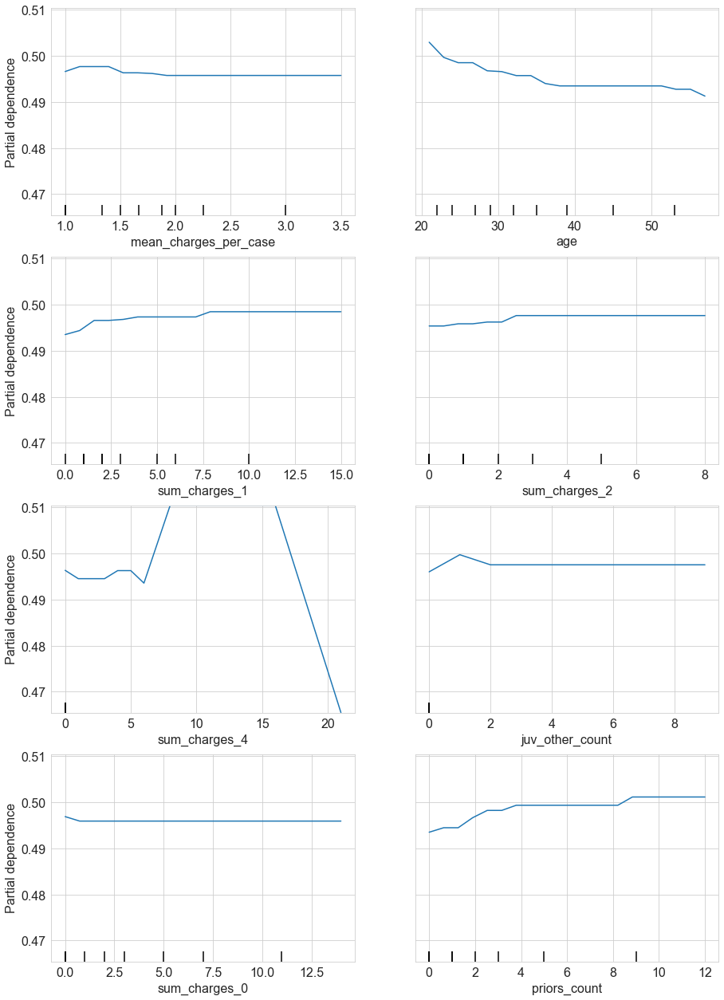

In [430]:
ADA_top_features = ["mean_charges_per_case", "age", "sum_charges_1", "sum_charges_2", "sum_charges_4", "juv_other_count", "sum_charges_0", "priors_count"]
fig, ax = plt.subplots(figsize=(15,22))
PartialDependenceDisplay.from_estimator(ADA_optimal, X_train, ADA_top_features, n_cols=2, grid_resolution=20, kind="average", ax=ax);

#### Permutation

Text(0.5, 1.0, 'Barplot of mean permutation importance per variable')

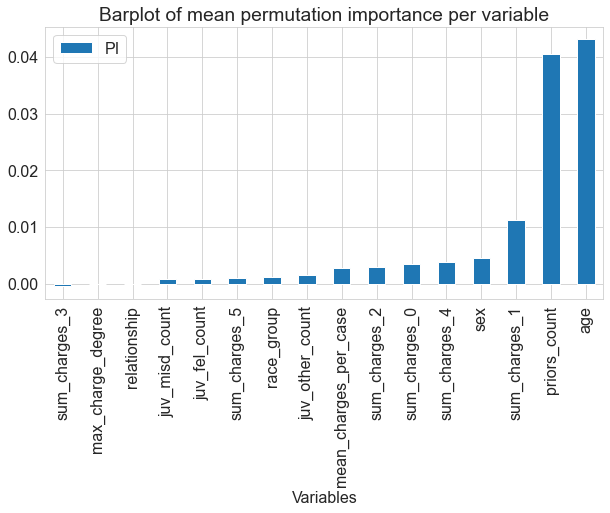

In [431]:
perm_importance = permutation_importance(ADA_optimal, X_train.values, y_train, n_repeats = 20, random_state = 0)
PI = pd.DataFrame(zip(X_train.columns,perm_importance.importances_mean), columns = ["Variables","PI"])
PI.set_index("Variables", inplace = True)
PI.sort_values("PI", inplace=True)
PI.plot(kind = "bar")
plt.title("Barplot of mean permutation importance per variable")

## Gradient Boosting

In [432]:
df = pd.read_csv("../data/processed_race_groups_corrected.csv")
df.sex.replace(['Male', 'Female'], [0,1], inplace=True)
df.race.replace(['African-American', 'Caucasian', 'Hispanic', 'Other', 'Asian', 'Native American'], [0,1,2,3,4,5], inplace=True) 

In [433]:
#Training and Test Sets
X = df.drop(["two_year_recid", "person_id", "decile_score", "is_violent_recid", "Unnamed: 0","name", "race"], axis=1)
y = df["two_year_recid"]

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.3, random_state=1)

### GB Model

In [434]:
#Param Grid
param_grid_GB = {
    "n_estimators": [5,25,50,75,100,125,150,175,200,225,250],
    "learning_rate": [0.06, 0.08, 0.1, 0.12, 0.14, 0.16, 0.18, 0.2, 0.5, 1],
    "max_depth":[1,2,3,4,5],    
                 }

In [435]:
#GB Grid Search
#GB = GradientBoostingClassifier(random_state=0, n_iter_no_change=25);

#GB_cv = GridSearchCV(estimator = GB, param_grid = param_grid_GB, cv=3)
                           
#GB_cv.fit(X_train.values,y_train)
#GB_cv.best_params_

In [436]:
# Optimal Model
# {'learning_rate': 0.08, 'max_depth': 2, 'n_estimators': 150}
GB_optimal = GradientBoostingClassifier(learning_rate = 0.08,  max_depth = 2, n_estimators = 150)
GB_optimal.fit(X_train.values,y_train)

GradientBoostingClassifier(learning_rate=0.08, max_depth=2, n_estimators=150)

In [437]:
#Predict with Optimal Model
GB_predict = GB_optimal.predict(X_test)

#### Metrics

The accuracay of Gradient Boosting is 71,13%

In [438]:
metricsGB = model_metrics(y_test,GB_predict)
[print(i) for i in metricsGB]

0.7113207547169811
              precision    recall  f1-score   support

           0       0.75      0.83      0.79      1029
           1       0.61      0.49      0.54       561

    accuracy                           0.71      1590
   macro avg       0.68      0.66      0.67      1590
weighted avg       0.70      0.71      0.70      1590



[None, None]

In [439]:
#other metrics for model comparison
tn, fp, fn, tp = confusion_matrix(y_test, GB_predict, labels=[0, 1]).ravel()
fnr_GB = fn / (fn + tp)
fpr_GB = fp / (fp + tn)
fnr_GB, fpr_GB, f1_score(y_test, GB_predict), recall_score(y_test, GB_predict), precision_score(y_test, GB_predict)

(0.5133689839572193,
 0.1661807580174927,
 0.5432835820895523,
 0.48663101604278075,
 0.6148648648648649)

#### Confusion Matrix

<AxesSubplot:>

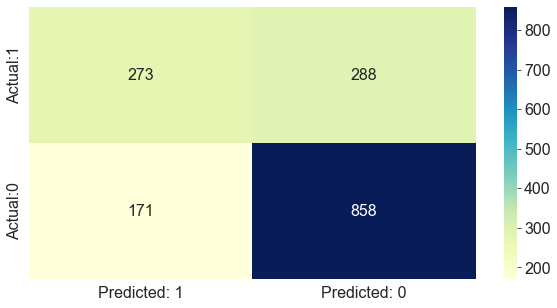

In [440]:
cm = confusion_matrix(y_test, GB_predict, labels=[1,0])

cm_matrix = pd.DataFrame(data=cm, columns=['Predicted: 1','Predicted: 0'], 
                                 index=['Actual:1','Actual:0'])

sns.heatmap(cm_matrix, annot=True, fmt='d', cmap='YlGnBu')

#### Train Test Error

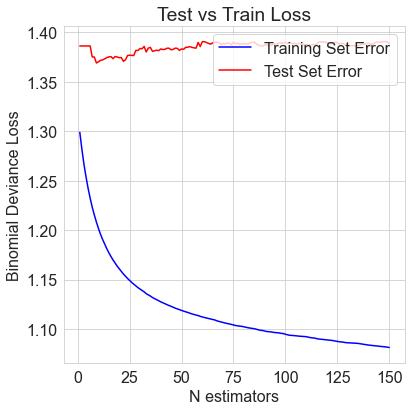

In [441]:
test_score = np.zeros((GB_optimal.n_estimators_,), dtype=np.float64)
for i, GB_predict in enumerate(GB_optimal.staged_predict(X_test)):
    test_score[i] = GB_optimal.loss_(y_test, GB_predict)

fig = plt.figure(figsize=(6, 6))
plt.subplot(1, 1, 1)
plt.title("Test vs Train Loss")
plt.plot(
    np.arange(GB_optimal.n_estimators_) + 1,
    GB_optimal.train_score_,
    "b-",
    label="Training Set Error",
)
plt.plot(
    np.arange(GB_optimal.n_estimators_) + 1, test_score, "r-", label="Test Set Error"
)
plt.legend(loc="upper right")
plt.xlabel("N estimators")
plt.ylabel("Binomial Deviance Loss")
fig.tight_layout()
plt.show()

#### ROC and AUC

The AUC for Gradient Boosting is 73,76%

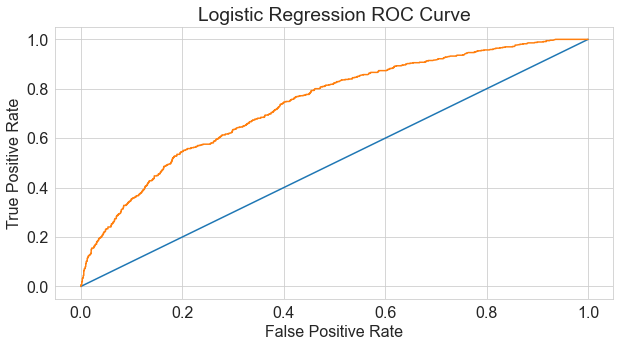

In [442]:
#ROC
GB_pred_prob = GB_optimal.predict_proba(X_test)[:,1]
fpr, tpr, thresholds = roc_curve(y_test, GB_pred_prob)
plt.plot([0,1], [0,1])
plt.plot(fpr,tpr,label="GB")
plt.xlabel("False Positive Rate")
plt.ylabel("True Positive Rate")
plt.title("Logistic Regression ROC Curve")
plt.show();

In [443]:
#AUC
roc_auc_score(y_test, GB_pred_prob)

0.7376266523925586

#### Race analysis

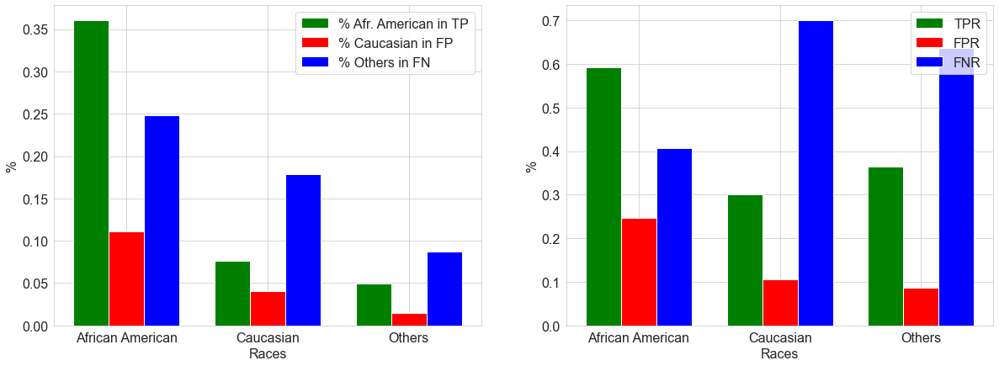

In [444]:
calculateRates(X_test, y_test, GB_predict)

Gradient Boosting model has quite similar FPR, FNR, TPR for all race groups compared to XBoosting. Non-recidive African Americans almost 2 times more than 2 other race groups. False Negative Rates of Caucasians and Others are still much higher than African American group.

### GB Feature Analysis

#### MDI

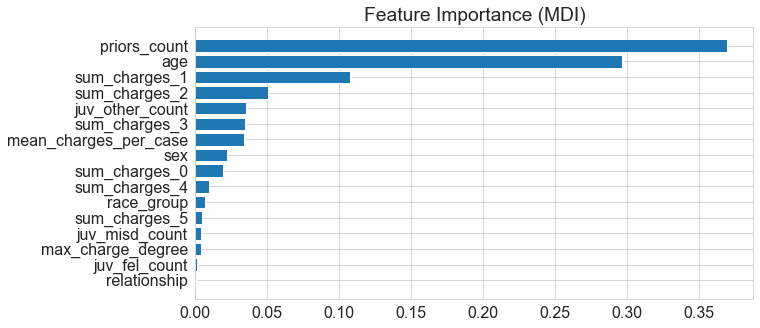

In [445]:
feature_importance_GB = GB_optimal.feature_importances_
sorted_idx = np.argsort(feature_importance_GB)
pos = np.arange(sorted_idx.shape[0]) + 0.5
plt.barh(pos, feature_importance_GB[sorted_idx], align="center")
plt.yticks(pos, np.array(X.columns)[sorted_idx])
plt.title("Feature Importance (MDI)")
plt.rcParams["figure.figsize"] = (15,3)

#### PDP

While priors_count has a positive correlation with the probability of recividism, age is negatively correlated with it.
Here are the Partial Dependence Plots of the top 5 features depending on their model importance.

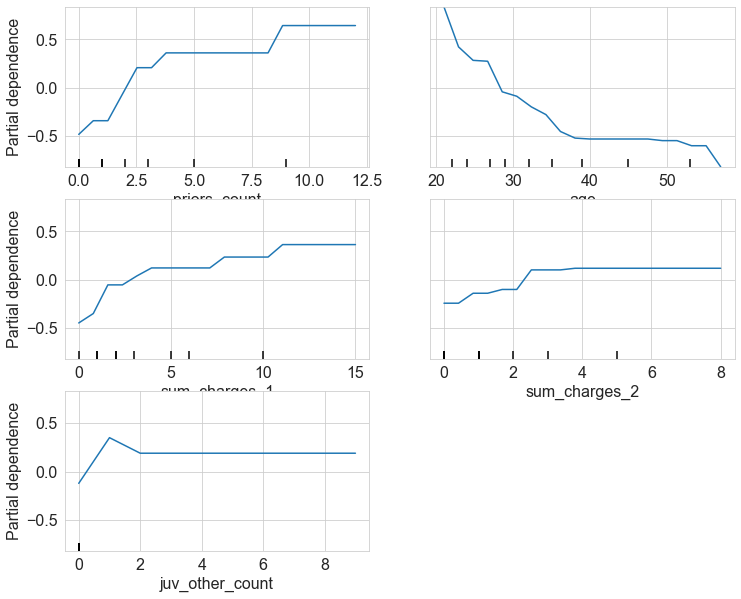

In [446]:
GB_top_features = ["priors_count", "age", "sum_charges_1", "sum_charges_2", "juv_other_count"]
fig, ax = plt.subplots(figsize=(12,10))
PartialDependenceDisplay.from_estimator(GB_optimal, X_train, GB_top_features, n_cols=2, grid_resolution=20, kind="average", ax=ax);

#### Permutation

Text(0.5, 1.0, 'Barplot of mean permutation importance per variable')

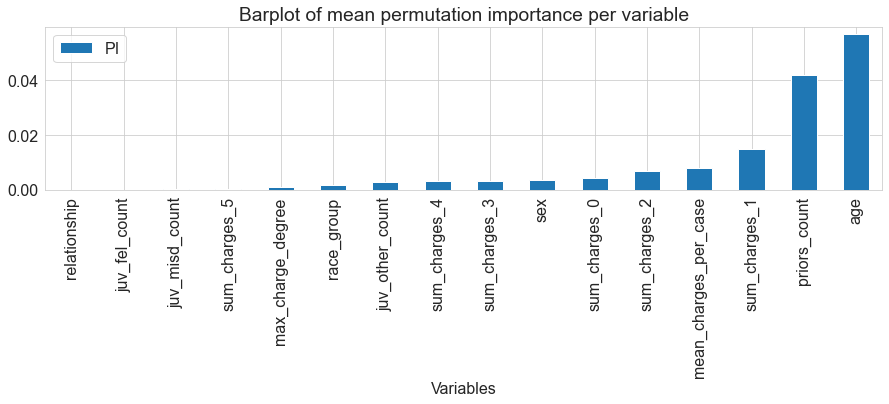

In [447]:
perm_importance = permutation_importance(GB_optimal, X_train.values, y_train, n_repeats = 20, random_state = 0)
PI = pd.DataFrame(zip(X_train.columns,perm_importance.importances_mean), columns = ["Variables","PI"])
PI.set_index("Variables", inplace = True)
PI.sort_values("PI", inplace=True)
PI.plot(kind = "bar")
plt.title("Barplot of mean permutation importance per variable")

### Shap Values GB

In [448]:
shap.initjs()

In [449]:
explainer = shap.TreeExplainer(GB_optimal, X_train)
shap_gb = explainer.shap_values(X_train)

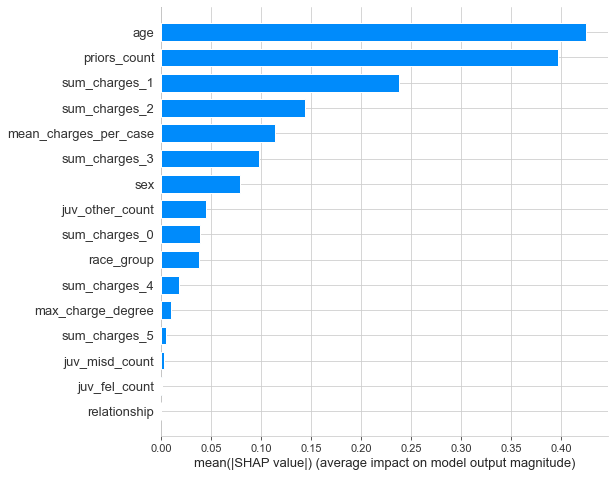

In [450]:
shap.summary_plot(shap_gb, X_train, plot_type = "bar")

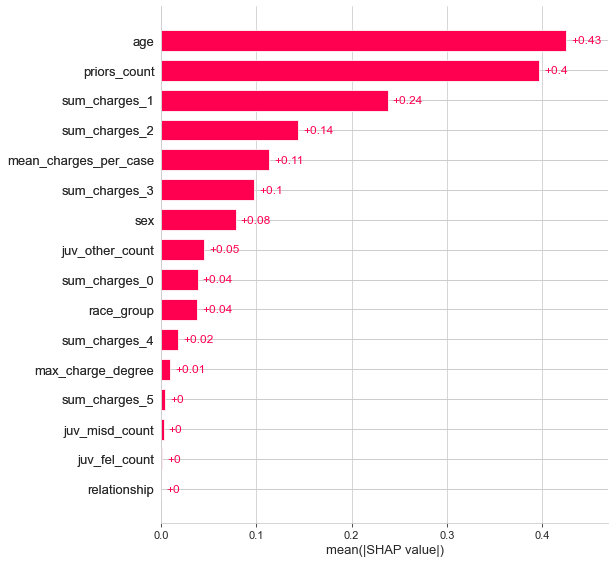

In [451]:
shap.plots.bar(explainer(X_train), max_display = 16) #explainer(X_train) is equal to shap_gb, however shap_gb wouldnt work - its an reported bug

In [452]:
shap.force_plot(explainer.expected_value, explainer(X_train).values, X_train)

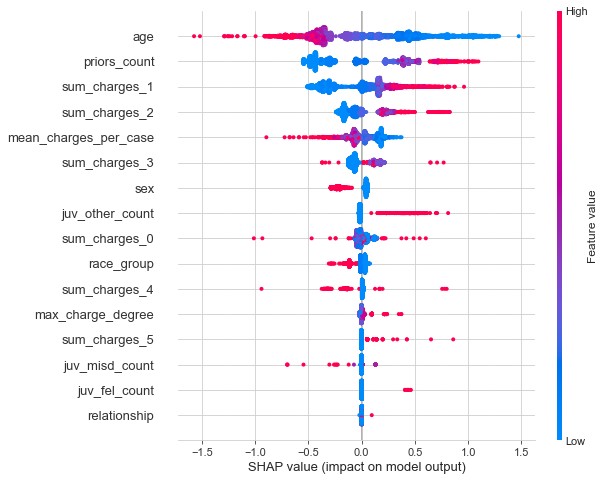

In [454]:
shap.plots.beeswarm(explainer(X_train), max_display = 16)

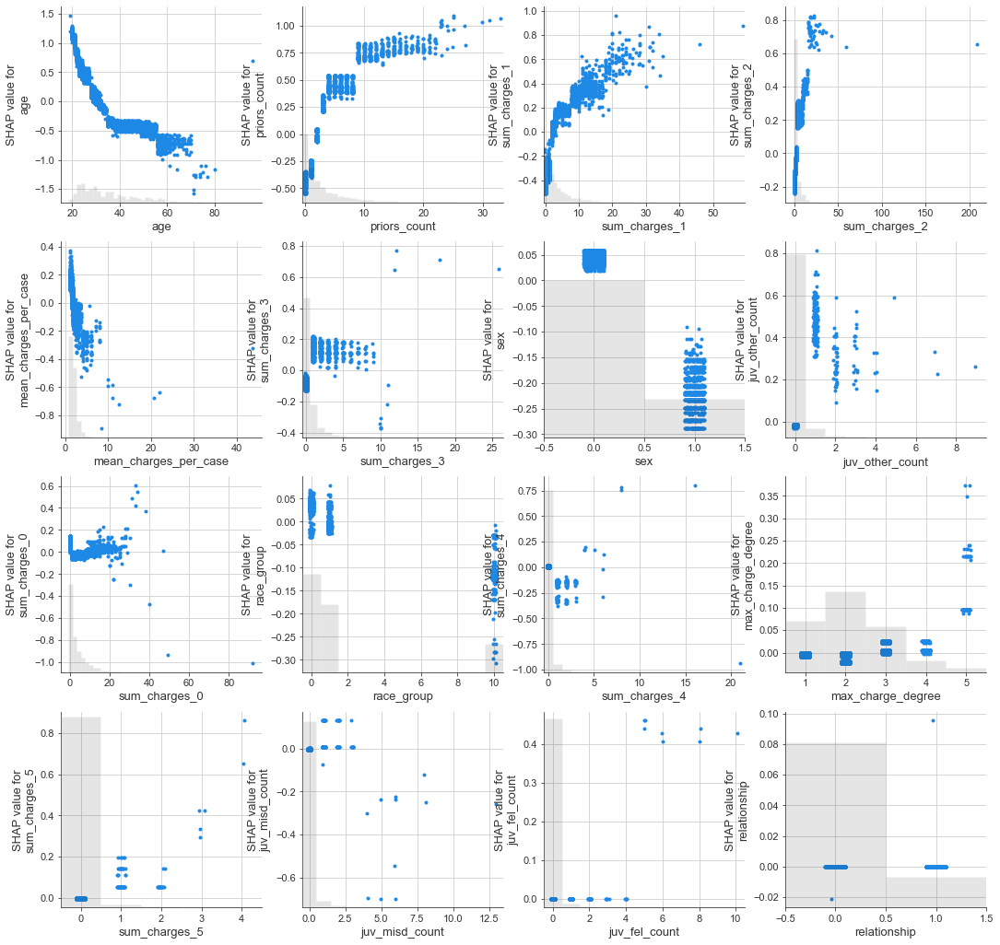

In [455]:
fig, axes = plt.subplots(nrows=4, ncols=4, figsize=(18,18))
shap.plots.scatter(explainer(X_train)[:,"age"], ax=axes[0,0], show=False)
shap.plots.scatter(explainer(X_train)[:,"priors_count"], ax=axes[0,1], show=False)
shap.plots.scatter(explainer(X_train)[:,"sum_charges_1"], ax=axes[0,2], show=False)
shap.plots.scatter(explainer(X_train)[:,"sum_charges_2"], ax=axes[0,3], show=False)
shap.plots.scatter(explainer(X_train)[:,"mean_charges_per_case"], ax=axes[1,0], show=False)
shap.plots.scatter(explainer(X_train)[:,"sum_charges_3"], ax=axes[1,1], show=False)
shap.plots.scatter(explainer(X_train)[:,"sex"], ax=axes[1,2], show=False)
shap.plots.scatter(explainer(X_train)[:,"juv_other_count"], ax=axes[1,3], show=False)
shap.plots.scatter(explainer(X_train)[:,"sum_charges_0"], ax=axes[2,0], show=False)
shap.plots.scatter(explainer(X_train)[:,"race_group"], ax=axes[2,1], show=False)
shap.plots.scatter(explainer(X_train)[:,"sum_charges_4"], ax=axes[2,2], show=False)
shap.plots.scatter(explainer(X_train)[:,"max_charge_degree"], ax=axes[2,3], show=False)
shap.plots.scatter(explainer(X_train)[:,"sum_charges_5"], ax=axes[3,0], show=False)
shap.plots.scatter(explainer(X_train)[:,"juv_misd_count"], ax=axes[3,1], show=False)
shap.plots.scatter(explainer(X_train)[:,"juv_fel_count"], ax=axes[3,2], show=False)
shap.plots.scatter(explainer(X_train)[:,"relationship"], ax=axes[3,3], show=False)

## XGBoosting

In [456]:
df = pd.read_csv("../data/processed_race_groups_corrected.csv")
df.sex.replace(['Male', 'Female'], [0,1], inplace=True)
df.race.replace(['African-American', 'Caucasian', 'Hispanic', 'Other', 'Asian', 'Native American'], [0,1,2,3,4,5], inplace=True) 
df = df.drop(columns=["name"])

In [457]:
#Training and Test Sets
X = df.drop(["two_year_recid", "person_id", "decile_score", "is_violent_recid", "Unnamed: 0", "race"], axis=1)
y = df["two_year_recid"]

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.3, random_state=1)

### XGBoosting Model

In [458]:
#Param Grid for CV
param_grid_XGB = {
    "n_estimators": [5,25,50,75,100,125,150,175,200,225,250],
    "learning_rate": [0.06, 0.08, 0.1, 0.12, 0.14, 0.16, 0.18, 0.2, 0.5, 1],
    "max_depth":[1,2,3,4,5],    
                 }

#Classifier
#XGB_class = xgb.XGBClassifier(booster="gbtree", objective="binary:logistic", use_label_encoder=False)

In [459]:
#Grid Search CV
#XGB_cv = GridSearchCV(XGB_class, param_grid_XGB, cv=5)
#XGB_cv.fit(X_train, y_train);
#XGB_cv.best_params_

In [460]:
#optimal param = {'learning_rate': 0.1, 'max_depth': 2, 'n_estimators': 200}

#xgb.cv(params=param_grid_XGB, dtrain=X_train_DM, num_boost_round=10, booster="gbtree")

In [461]:
#Optimal Model

eval_set = [(X_train, y_train), (X_test, y_test)]
XGB_optimal = xgb.XGBClassifier(booster="gbtree", objective="binary:logistic", use_label_encoder=False, learning_rate=0.1, max_depth=2, n_estimators=200)
XGB_optimal.fit(X_train,y_train, eval_set=eval_set, eval_metric=["error", "logloss"], verbose=False)

XGBClassifier(base_score=0.5, booster='gbtree', colsample_bylevel=1,
              colsample_bynode=1, colsample_bytree=1, enable_categorical=False,
              gamma=0, gpu_id=-1, importance_type=None,
              interaction_constraints='', learning_rate=0.1, max_delta_step=0,
              max_depth=2, min_child_weight=1, missing=nan,
              monotone_constraints='()', n_estimators=200, n_jobs=8,
              num_parallel_tree=1, predictor='auto', random_state=0,
              reg_alpha=0, reg_lambda=1, scale_pos_weight=1, subsample=1,
              tree_method='exact', use_label_encoder=False,
              validate_parameters=1, verbosity=None)

In [462]:
#Predict with Optimal Model
XGB_predict = XGB_optimal.predict(X_test)

#### Metrics

Accuracy for XGBoosting is 70,56%

In [463]:
metricsXGB = model_metrics(y_test,XGB_predict)
[print(i) for i in metricsXGB]

0.7056603773584905
              precision    recall  f1-score   support

           0       0.74      0.83      0.78      1029
           1       0.60      0.48      0.53       561

    accuracy                           0.71      1590
   macro avg       0.67      0.65      0.66      1590
weighted avg       0.70      0.71      0.70      1590



[None, None]

In [464]:
tn, fp, fn, tp = confusion_matrix(y_test, XGB_predict, labels=[0, 1]).ravel()
fnr_XGB = fn / (fn + tp)
fpr_XGB = fp / (fp + tn)
fnr_XGB, fpr_XGB, f1_score(y_test, XGB_predict), recall_score(y_test, XGB_predict), precision_score(y_test, XGB_predict)

(0.5204991087344029,
 0.17103984450923226,
 0.5347912524850895,
 0.47950089126559714,
 0.604494382022472)

#### Confusion Matrix

<AxesSubplot:>

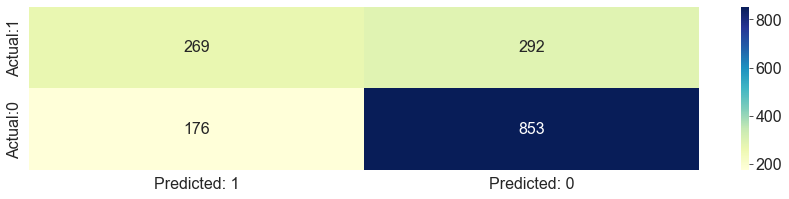

In [468]:
cm = confusion_matrix(y_test, XGB_predict, labels=[1,0])

cm_matrix = pd.DataFrame(data=cm, columns=['Predicted: 1','Predicted: 0'], 
                                 index=['Actual:1','Actual:0'])

sns.heatmap(cm_matrix, annot=True, fmt='d', cmap='YlGnBu')

#### Train Test Error

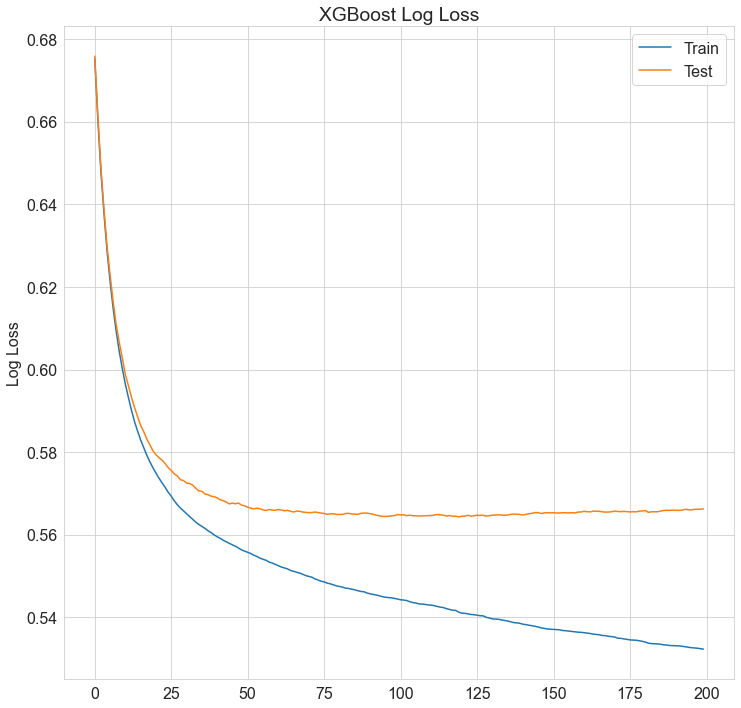

In [469]:
#retrieve performance metrics
results = XGB_optimal.evals_result()
epochs = len(results['validation_0']['error'])
x_axis = range(0, epochs)
    
# plot log loss
fig, ax = plt.subplots(figsize=(12,12))
ax.plot(x_axis, results['validation_0']['logloss'], label='Train')
ax.plot(x_axis, results['validation_1']['logloss'], label='Test')
ax.legend()
    
plt.ylabel('Log Loss')
plt.title('XGBoost Log Loss')
plt.show()

#### ROC and AUC

The AUC for XGBoosting is 73,82%

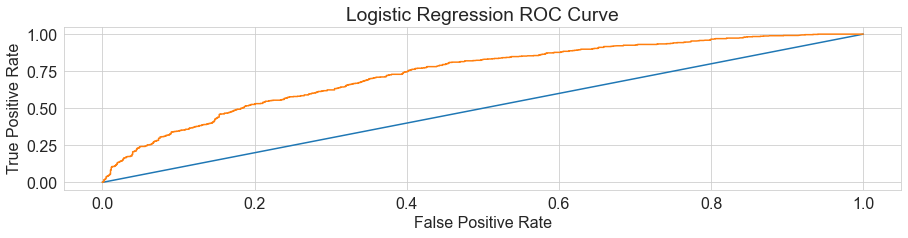

In [470]:
#ROC
XGB_pred_prob = XGB_optimal.predict_proba(X_test)[:,1]
fpr, tpr, thresholds = roc_curve(y_test, XGB_pred_prob)
plt.plot([0,1], [0,1])
plt.plot(fpr,tpr,label="ADA")
plt.xlabel("False Positive Rate")
plt.ylabel("True Positive Rate")
plt.title("Logistic Regression ROC Curve")
plt.show();

In [471]:
#AUC
roc_auc_score(y_test, XGB_pred_prob)

0.7382554753503132

In [481]:
#Overview of tree number 0
#xgb.plot_tree(XGB_optimal, num_trees=0, rankdir='LR')
#plt.rcParams['figure.figsize'] = [100, 25]
#plt.show()
#Doesnt work sometimes cause its graphviz based, feel free to try to run it

#### Race analysis

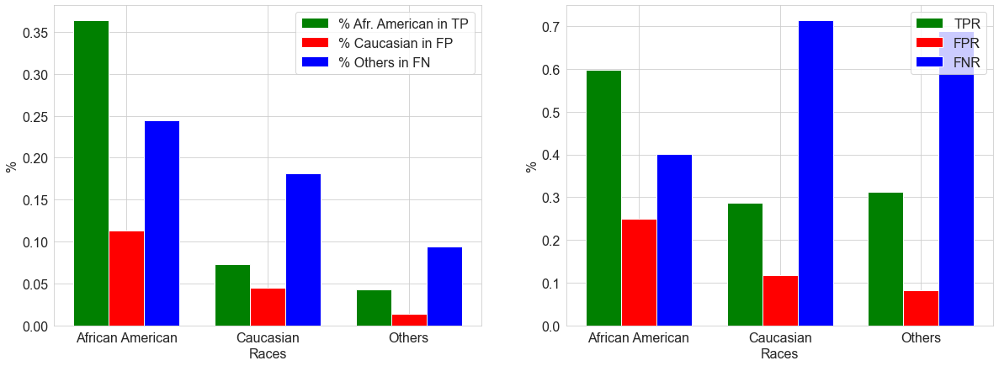

In [482]:
calculateRates(X_test, y_test, XGB_predict)

XGBoosting model has quite similar FPR, FNR, TPR for all race groups compared to other boosting models. Non-recidive African Americans almost 2 times more than 2 other race groups. False Negative Rates of Caucasians and Others are still much higher than African American group.

### XGB Feature Analysis

#### MDI

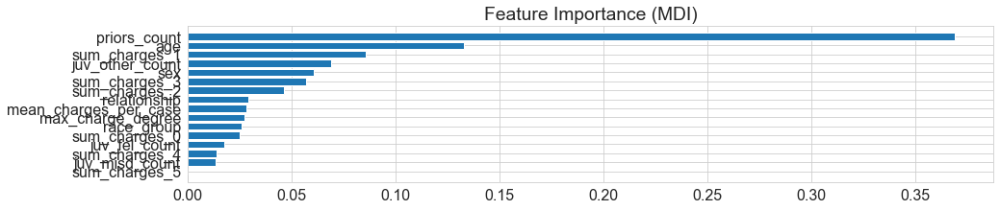

In [483]:
#MDI
feature_importance_XGB = XGB_optimal.feature_importances_
sorted_idx = np.argsort(feature_importance_XGB)
pos = np.arange(sorted_idx.shape[0])
plt.barh(pos, feature_importance_XGB[sorted_idx], align="center")
plt.yticks(pos, np.array(X.columns)[sorted_idx])
plt.title("Feature Importance (MDI)")
plt.rcParams["figure.figsize"] = (15,5)

Another way of plotting Feature Importance offered by XGB package:

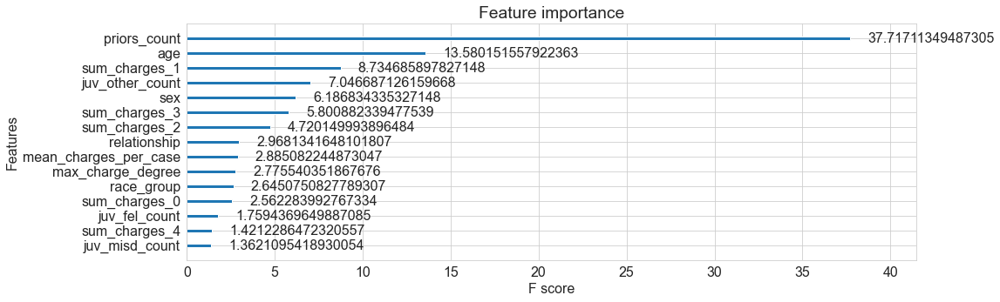

In [484]:
# Feature importance depending on Gain
xgb.plot_importance(XGB_optimal, importance_type = "gain")
plt.rcParams['figure.figsize'] = [5, 5]
plt.show()

#### PDP

While priors_count has a positive correlation with the probability of recividism, age is negatively correlated with it.
Here are the Partial Dependence Plots of the top 5 features depending on their model importance.

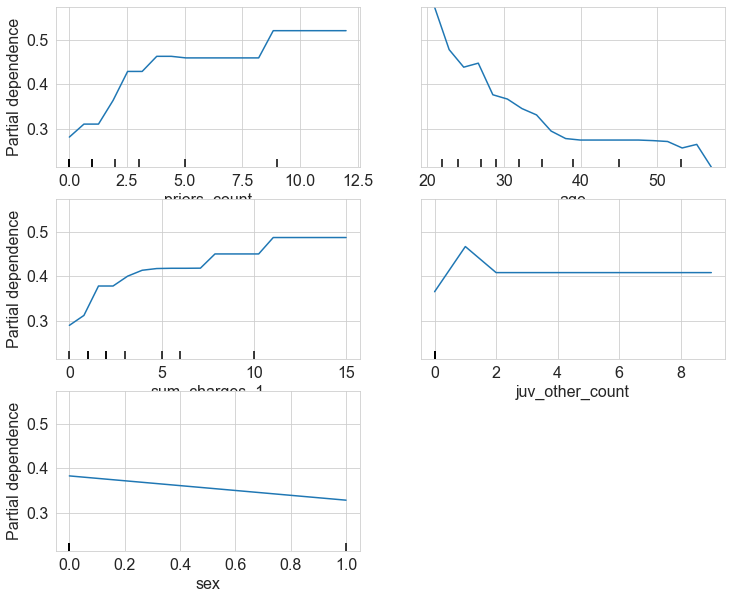

In [485]:
#PDP
XGB_top_features = ["priors_count", "age", "sum_charges_1", "juv_other_count", "sex"]
fig, ax = plt.subplots(figsize=(12,10))
PartialDependenceDisplay.from_estimator(XGB_optimal, X_train, XGB_top_features, n_cols=2, grid_resolution=20, kind="average", ax=ax);

#### Permutation

Text(0.5, 1.0, 'Barplot of mean permutation importance per variable')

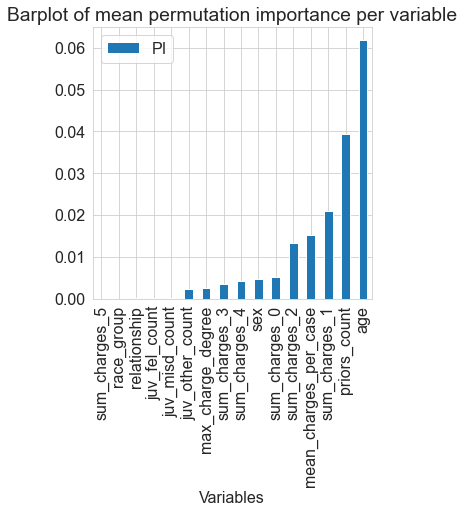

In [486]:
perm_importance = permutation_importance(XGB_optimal, X_train.values, y_train, n_repeats = 20, random_state = 0)
PI = pd.DataFrame(zip(X_train.columns,perm_importance.importances_mean), columns = ["Variables","PI"])
PI.set_index("Variables", inplace = True)
PI.sort_values("PI", inplace=True)
PI.plot(kind = "bar")
plt.title("Barplot of mean permutation importance per variable")

### Shap Values XGB

In [487]:
explainer_xgb = shap.Explainer(XGB_optimal, X_train)
shap_xgb = explainer_xgb(X_train)

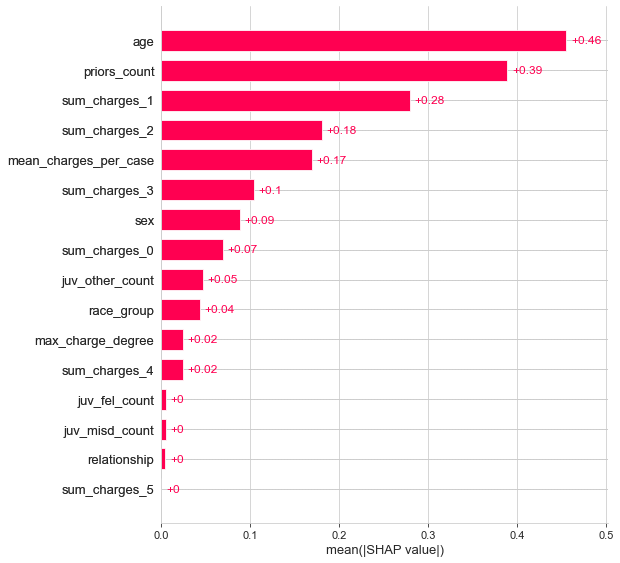

In [488]:
shap.plots.bar(shap_xgb, max_display = 16)

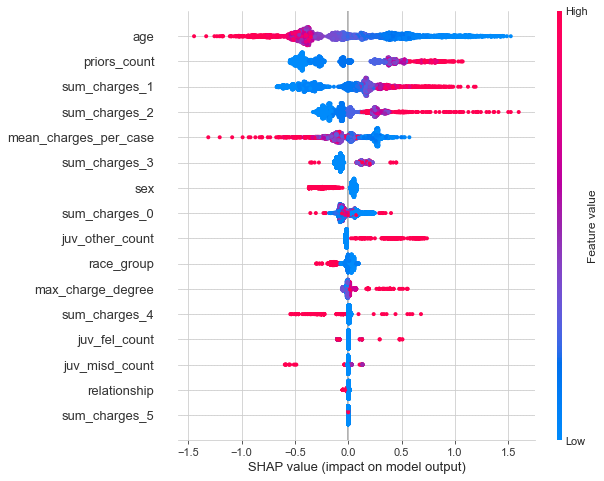

In [489]:
shap.plots.beeswarm(shap_xgb, max_display = 16)

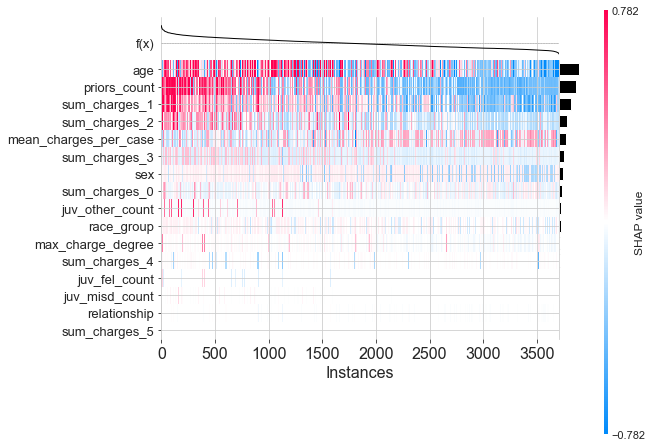

In [490]:
shap.plots.heatmap(shap_xgb, instance_order=shap_xgb.sum(1), max_display = 16)

In [491]:
shap.force_plot(explainer.expected_value, shap_xgb.values, X_train, link = "logit")

In [492]:
shap.force_plot(explainer.expected_value, shap_xgb.values, X_train)

In [493]:
#lookup to one specific case
#shap.plots.waterfall(shap_xgb[8], max_display=16)

In [494]:
#shap.plots.bar(shap_xgb[8], max_display = 16)

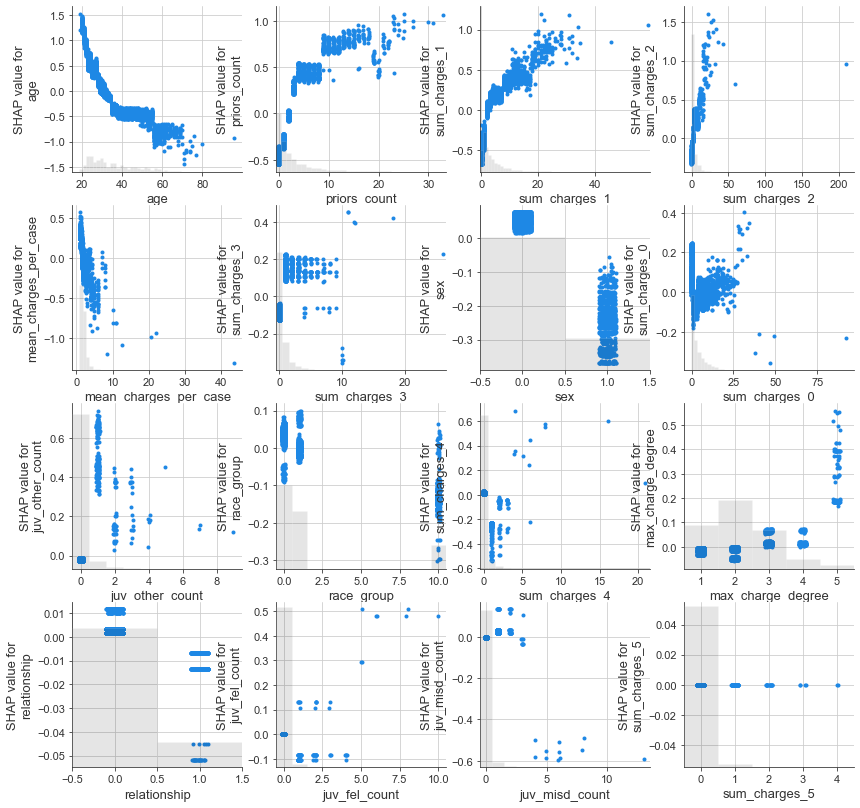

In [495]:
fig, axes = plt.subplots(nrows=4, ncols=4, figsize=(14,14))
shap.plots.scatter(shap_xgb[:,"age"], ax=axes[0, 0], show=False)
shap.plots.scatter(shap_xgb[:,"priors_count"], ax=axes[0, 1], show=False)
shap.plots.scatter(shap_xgb[:,"sum_charges_1"], ax=axes[0, 2], show=False)
shap.plots.scatter(shap_xgb[:,"sum_charges_2"], ax=axes[0, 3], show=False)
shap.plots.scatter(shap_xgb[:,"mean_charges_per_case"], ax=axes[1, 0], show=False)
shap.plots.scatter(shap_xgb[:,"sum_charges_3"], ax=axes[1, 1], show=False)
shap.plots.scatter(shap_xgb[:,"sex"], ax=axes[1, 2], show=False)
shap.plots.scatter(shap_xgb[:,"sum_charges_0"], ax=axes[1, 3], show=False)
shap.plots.scatter(shap_xgb[:,"juv_other_count"], ax=axes[2, 0], show=False)
shap.plots.scatter(shap_xgb[:,"race_group"], ax=axes[2, 1], show=False)
shap.plots.scatter(shap_xgb[:,"sum_charges_4"], ax=axes[2, 2], show=False)
shap.plots.scatter(shap_xgb[:,"max_charge_degree"], ax=axes[2, 3], show=False)
shap.plots.scatter(shap_xgb[:,"relationship"], ax=axes[3, 0], show=False)
shap.plots.scatter(shap_xgb[:,"juv_fel_count"], ax=axes[3, 1], show=False)
shap.plots.scatter(shap_xgb[:,"juv_misd_count"], ax=axes[3, 2], show=False)
shap.plots.scatter(shap_xgb[:,"sum_charges_5"], ax=axes[3, 3], show=False)
plt.show()

## Recividism conclusion for Boosting

In the conclusion we will consider only Gradient Boosting and XGBoosting as ADA had a worse performance in all the fields.

To have a general overview of the model characteristics, we are picking only some of the most important features that represent the model performance:

* Gradient Boosting
    * Accuracy - 71,13%
    * AUC - 73,76%

* XGBoosting:
    * Accuracy - 70,56%
    * AUC - 73,82%

This results may be contradictory because GB has a higher Accuracy but XGBoosting has a higher AUC. Even though, we have to point out that, after comparing Confusion Matrixes, Gradient Boosting is able to classificate correctly 12 persons more than XGBoosting. We would choose Gradient Boosting as our Boosting classifier.

It's also important to note that Priors_count and Age are the most important features for all the models predicting recividism.

## Prediction without Race - GradientBoosting

We tried to predict Recividism without the Race feature. Knowing that Race didn't have an important contribution in any of the three previous models, our suspicions were confirmed when we observed that the model prediction without race was the same as before.

In [496]:
#Set up

X = df.drop(["two_year_recid", "person_id", "decile_score","race","race_group", "is_violent_recid", "Unnamed: 0"], axis=1)
y = df["two_year_recid"]

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.3, random_state=1)
X.head()

,sex,age,priors_count,juv_fel_count,juv_misd_count,juv_other_count,relationship,max_charge_degree,sum_charges_0,sum_charges_1,sum_charges_2,sum_charges_3,sum_charges_4,sum_charges_5,mean_charges_per_case
0,0,69,0,0,0,0,0,2.0,4.0,1.0,1.0,0.0,0.0,0.0,1.500000
1,0,34,0,0,0,0,0,2.0,0.0,0.0,1.0,0.0,0.0,0.0,1.000000
2,0,24,4,0,0,1,0,2.0,6.0,9.0,4.0,0.0,0.0,0.0,2.111111
3,0,44,0,0,0,0,0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,1.000000
4,0,41,14,0,0,0,0,3.0,4.0,7.0,13.0,3.0,0.0,0.0,1.588235


In [497]:
#Param Grid
param_grid_GB_nr = {
    "n_estimators": [5,25,50,75,100,125,150,175,200,225,250],
    "learning_rate": [0.06, 0.08, 0.1, 0.12, 0.14, 0.16, 0.18, 0.2, 0.5, 1],
    "max_depth":[1,2,3,4,5],    
                 }

In [498]:
#GB Grid Search
#GB = GradientBoostingClassifier(random_state=0, n_iter_no_change=25);

#GB_cv_nr = GridSearchCV(estimator = GB, param_grid = param_grid_GB_nr, cv=3)
                           
#GB_cv_nr.fit(X_train.values,y_train)
#GB_cv_nr.best_params_

In [499]:
# Optimal Model
# {'learning_rate': 0.2, 'max_depth': 1, 'n_estimators': 175}
GB_nr_optimal = GradientBoostingClassifier(learning_rate = 0.2,  max_depth = 1, n_estimators = 175)
GB_nr_optimal.fit(X_train.values,y_train)

GradientBoostingClassifier(learning_rate=0.2, max_depth=1, n_estimators=175)

In [500]:
#Predict with Optimal Model
GB_nr_predict = GB_nr_optimal.predict(X_test)

#### Metrics

In [501]:
metricsGB_nr = model_metrics(y_test,GB_nr_predict)
[print(i) for i in metricsGB_nr]

0.7081761006289308
              precision    recall  f1-score   support

           0       0.74      0.84      0.79      1029
           1       0.61      0.47      0.53       561

    accuracy                           0.71      1590
   macro avg       0.68      0.65      0.66      1590
weighted avg       0.70      0.71      0.70      1590



[None, None]

#### Confusion Matrix

<AxesSubplot:>

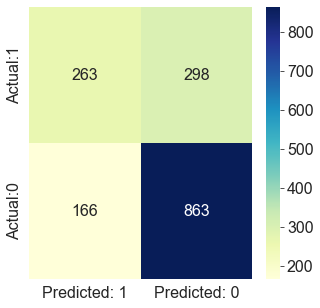

In [502]:
cm = confusion_matrix(y_test, GB_nr_predict, labels=[1,0])

cm_matrix = pd.DataFrame(data=cm, columns=['Predicted: 1','Predicted: 0'], 
                                 index=['Actual:1','Actual:0'])

sns.heatmap(cm_matrix, annot=True, fmt='d', cmap='YlGnBu')

## Prediction with RobustScaler - GradientBoosting

We experimented with RobustScaler to see if it could make an improvement to the actual predictions, but it had no effect

In [503]:
#Set up
from sklearn.preprocessing import RobustScaler

X = df.drop(["two_year_recid", "person_id", "decile_score", "is_violent_recid", "Unnamed: 0"], axis=1)
y = df["two_year_recid"]

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.3, random_state=1)

scaler = RobustScaler()

X_train = scaler.fit_transform(X_train)

X_test = scaler.transform(X_test)

In [504]:
#Param Grid
param_grid_GB_rs = {
    "n_estimators": [5,25,50,75,100,125,150,175,200,225,250],
    "learning_rate": [0.06, 0.08, 0.1, 0.12, 0.14, 0.16, 0.18, 0.2, 0.5, 1],
    "max_depth":[1,2,3,4,5],    
                 }

In [505]:
#GB Grid Search
#GB = GradientBoostingClassifier(random_state=0, n_iter_no_change=25);

#GB_cv_nr = GridSearchCV(estimator = GB, param_grid = param_grid_GB_rs, cv=3)
                           
#GB_cv_nr.fit(X_train,y_train)
#GB_cv_nr.best_params_

In [506]:
# Optimal Model
# {'learning_rate': 0.08, 'max_depth': 2, 'n_estimators': 150}
GB_rs_optimal = GradientBoostingClassifier(learning_rate = 0.08,  max_depth = 2, n_estimators = 150)
GB_rs_optimal.fit(X_train,y_train)

GradientBoostingClassifier(learning_rate=0.08, max_depth=2, n_estimators=150)

In [507]:
#Predict with Optimal Model
GB_rs_predict = GB_rs_optimal.predict(X_test)

#### Metrics

In [508]:
metricsGB_rs = model_metrics(y_test,GB_rs_predict)
[print(i) for i in metricsGB_rs]

0.7132075471698113
              precision    recall  f1-score   support

           0       0.75      0.84      0.79      1029
           1       0.62      0.48      0.54       561

    accuracy                           0.71      1590
   macro avg       0.68      0.66      0.67      1590
weighted avg       0.70      0.71      0.70      1590



[None, None]

<AxesSubplot:>

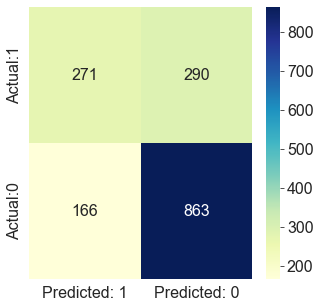

In [509]:
cm = confusion_matrix(y_test, GB_rs_predict, labels=[1,0])

cm_matrix = pd.DataFrame(data=cm, columns=['Predicted: 1','Predicted: 0'], 
                                 index=['Actual:1','Actual:0'])

sns.heatmap(cm_matrix, annot=True, fmt='d', cmap='YlGnBu')

## Boosting for Protected Attributes

In [512]:
df = pd.read_csv("../data/processed_race_groups_corrected.csv")
df.sex.replace(['Male', 'Female'], [0,1], inplace=True)
df.race.replace(['African-American', 'Caucasian', 'Hispanic', 'Other', 'Asian', 'Native American'], [0,1,2,3,4,5], inplace=True) 
df = df.drop(columns=["name"])

In [513]:
#Training and Test Sets
X = df.drop(["sex","age","relationship","two_year_recid", "person_id", "decile_score", "is_violent_recid", "Unnamed: 0", "race"], axis=1)
y = df["two_year_recid"]

X_raw_train, X_raw_test, y_train, y_test = train_test_split(X, y, test_size = 0.3, random_state=1)

X_test = X_raw_test.drop(['race_group'],axis=1)
X_train = X_raw_train.drop(['race_group'],axis=1)

### GB Model

In [514]:
#Param Grid
param_grid_GB = {
    "n_estimators": [5,25,50,75,100,125,150,175,200,225,250],
    "learning_rate": [0.06, 0.08, 0.1, 0.12, 0.14, 0.16, 0.18, 0.2, 0.5, 1],
    "max_depth":[1,2,3,4,5],    
                 }

In [515]:
#GB Grid Search
#GB = GradientBoostingClassifier(random_state=0, n_iter_no_change=25);

#GB_cv = GridSearchCV(estimator = GB, param_grid = param_grid_GB, cv=3)
                           
#GB_cv.fit(X_train.values,y_train)
#GB_cv.best_params_

In [516]:
# Optimal Model
# {'learning_rate': 0.08, 'max_depth': 3, 'n_estimators': 75}
GB_optimal = GradientBoostingClassifier(learning_rate = 0.08,  max_depth = 3, n_estimators = 75)
GB_optimal.fit(X_train.values,y_train)

GradientBoostingClassifier(learning_rate=0.08, n_estimators=75)

In [517]:
#Predict with Optimal Model
GB_predict = GB_optimal.predict(X_test)

#### Metrics

The accuracay of Gradient Boosting is 67,73%

In [518]:
metricsGB = model_metrics(y_test,GB_predict)
[print(i) for i in metricsGB]

0.6773584905660377
              precision    recall  f1-score   support

           0       0.72      0.83      0.77      1029
           1       0.56      0.40      0.47       561

    accuracy                           0.68      1590
   macro avg       0.64      0.61      0.62      1590
weighted avg       0.66      0.68      0.66      1590



[None, None]

#### Confusion Matrix

<AxesSubplot:>

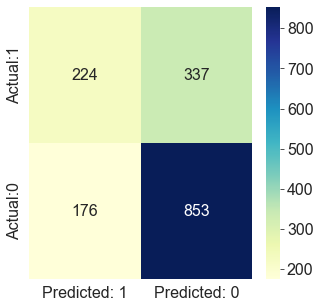

In [519]:
cm = confusion_matrix(y_test, GB_predict, labels=[1,0])

cm_matrix = pd.DataFrame(data=cm, columns=['Predicted: 1','Predicted: 0'], 
                                 index=['Actual:1','Actual:0'])

sns.heatmap(cm_matrix, annot=True, fmt='d', cmap='YlGnBu')

#### Train Test Error

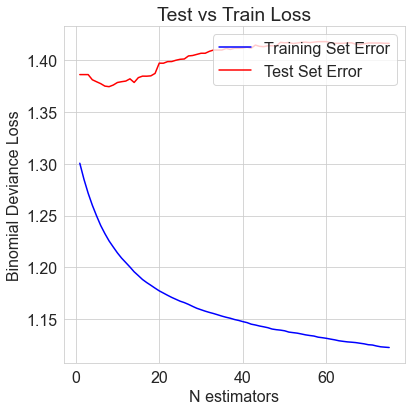

In [520]:
test_score = np.zeros((GB_optimal.n_estimators_,), dtype=np.float64)
for i, GB_predict in enumerate(GB_optimal.staged_predict(X_test)):
    test_score[i] = GB_optimal.loss_(y_test, GB_predict)

fig = plt.figure(figsize=(6, 6))
plt.subplot(1, 1, 1)
plt.title("Test vs Train Loss")
plt.plot(
    np.arange(GB_optimal.n_estimators_) + 1,
    GB_optimal.train_score_,
    "b-",
    label="Training Set Error",
)
plt.plot(
    np.arange(GB_optimal.n_estimators_) + 1, test_score, "r-", label="Test Set Error"
)
plt.legend(loc="upper right")
plt.xlabel("N estimators")
plt.ylabel("Binomial Deviance Loss")
fig.tight_layout()
plt.show()

#### ROC and AUC

The AUC for Gradient Boosting is 69,63%

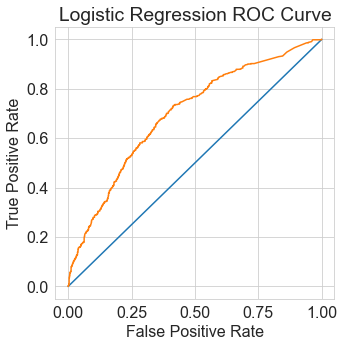

In [521]:
#ROC
GB_pred_prob = GB_optimal.predict_proba(X_test)[:,1]
fpr, tpr, thresholds = roc_curve(y_test, GB_pred_prob)
plt.plot([0,1], [0,1])
plt.plot(fpr,tpr,label="GB")
plt.xlabel("False Positive Rate")
plt.ylabel("True Positive Rate")
plt.title("Logistic Regression ROC Curve")
plt.show();

In [522]:
#AUC
roc_auc_score(y_test, GB_pred_prob)

0.6962906374671081

#### Race Analysis

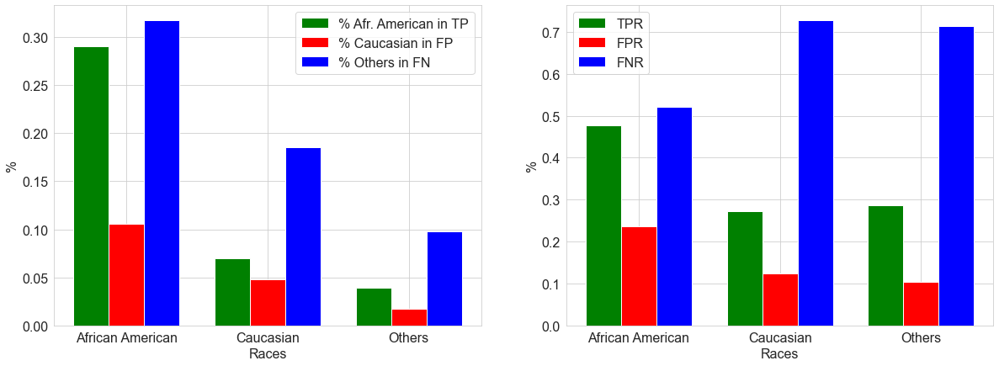

In [523]:
calculateRates(X_raw_test, y_test, GB_predict)

Just like Random Forest model, Boosting that does not include Protected Attributes in its decision returns higher FNR for African American group, which means 2 things:
- TPR of African American group decreases compared to the Boosting model that predicts based on Protected Attributes
- FNR gap between African Americans vs Caucasians and Others is narrower

## Boosting for Violent Recividism

As an addition, we tried to predict Violent Redictivism, but the model had a not-ethic but functional approach based on classifying everyone as Not Violent Recividist. This makes sense from a mathematical point of view because as only, approximately, a 10% of the registers will perform a Violent Recividism, it's easy to get a 90% accuracy by classifying everyone as innocent.

In [549]:
#Training and Test Sets
df = pd.read_csv("../data/processed_race_groups_corrected.csv")
df.sex.replace(['Male', 'Female'], [0,1], inplace=True)
df.race.replace(['African-American', 'Caucasian', 'Hispanic', 'Other', 'Asian', 'Native American'], [0,1,2,3,4,5], inplace=True)
X = df.drop(["name","two_year_recid", "Unnamed: 0", "is_violent_recid", "person_id", "decile_score", "race"], axis=1)
y = df["is_violent_recid"]

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.3, random_state=1)

XGB_class = xgb.XGBClassifier(booster="gbtree", objective="binary:logistic", use_label_encoder=False)

## GradientBoosting

In [550]:
#Param Grid
param_grid_GB = {
    "n_estimators": [5,25,50,75,100,125,150,175,200,225,250],
    "learning_rate": [0.06, 0.08, 0.1, 0.12, 0.14, 0.16, 0.18, 0.2, 0.5, 1],
    "max_depth":[1,2,3,4,5],    
                 }

In [551]:
#GB Grid Search
#GB_v = GradientBoostingClassifier(random_state=0, n_iter_no_change=25);

#GB_cv_v = GridSearchCV(estimator = GB_v, param_grid = param_grid_GB, cv=3)
                           
#GB_cv_v.fit(X_train.values,y_train)
#GB_cv_v.best_params_

In [552]:
# Optimal Model
# {'learning_rate': 0.06, 'max_depth': 1, 'n_estimators': 5}
GB_optimal_v = GradientBoostingClassifier(learning_rate = 0.06,  max_depth = 1, n_estimators = 5)
GB_optimal_v.fit(X_train.values,y_train)

GradientBoostingClassifier(learning_rate=0.06, max_depth=1, n_estimators=5)

In [553]:
#Predict with Optimal Model
GB_predict_v = GB_optimal_v.predict(X_test)

#### Metrics

In [554]:
metricsGB_v = model_metrics(y_test,GB_predict_v)
[print(i) for i in metricsGB_v]

0.9150943396226415
              precision    recall  f1-score   support

           0       0.92      1.00      0.96      1455
           1       0.00      0.00      0.00       135

    accuracy                           0.92      1590
   macro avg       0.46      0.50      0.48      1590
weighted avg       0.84      0.92      0.87      1590



[None, None]

#### Confusion Matrix

<AxesSubplot:>

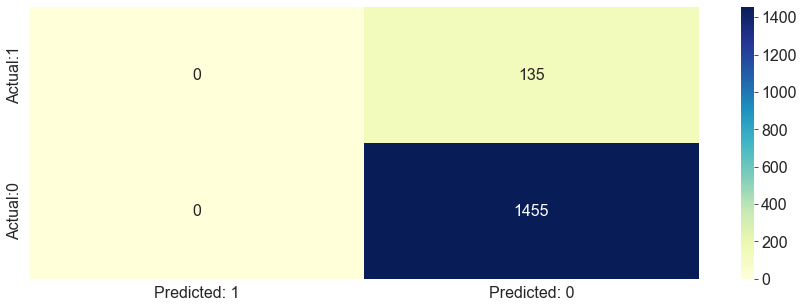

In [555]:
cm = confusion_matrix(y_test, GB_predict_v, labels=[1,0])

cm_matrix = pd.DataFrame(data=cm, columns=['Predicted: 1','Predicted: 0'], 
                                 index=['Actual:1','Actual:0'])

sns.heatmap(cm_matrix, annot=True, fmt='d', cmap='YlGnBu')
#we can see that the number of violent recid is so low, that the model just always predicts people not to be recidive

#### Train Test Error

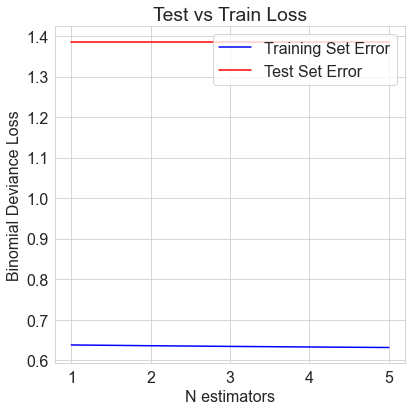

In [556]:
test_score = np.zeros((GB_optimal_v.n_estimators_,), dtype=np.float64)
for i, GB_predict in enumerate(GB_optimal_v.staged_predict(X_test)):
    test_score[i] = GB_optimal_v.loss_(y_test, GB_predict_v)

fig = plt.figure(figsize=(6, 6))
plt.subplot(1, 1, 1)
plt.title("Test vs Train Loss")
plt.plot(
    np.arange(GB_optimal_v.n_estimators_) + 1,
    GB_optimal_v.train_score_,
    "b-",
    label="Training Set Error",
)
plt.plot(
    np.arange(GB_optimal_v.n_estimators_) + 1, test_score, "r-", label="Test Set Error"
)
plt.legend(loc="upper right")
plt.xlabel("N estimators")
plt.ylabel("Binomial Deviance Loss")
fig.tight_layout()
plt.show()

### GB Feature Analysis for Violent

#### MDI

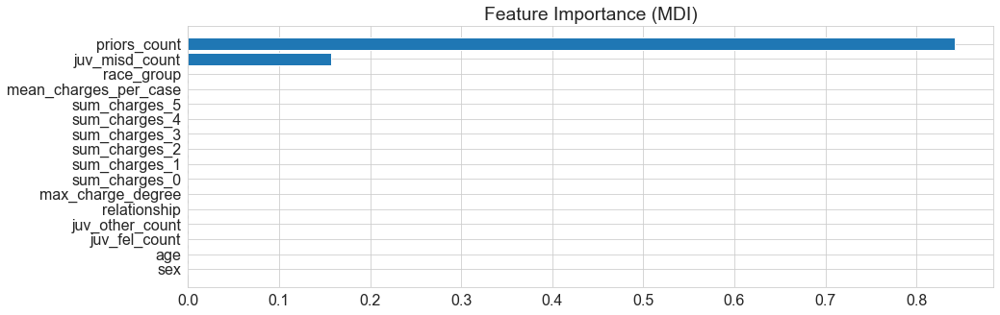

In [557]:
feature_importance_GB = GB_optimal_v.feature_importances_
sorted_idx = np.argsort(feature_importance_GB)
pos = np.arange(sorted_idx.shape[0]) + 0.5
plt.barh(pos, feature_importance_GB[sorted_idx], align="center")
plt.yticks(pos, np.array(X.columns)[sorted_idx])
plt.title("Feature Importance (MDI)")
plt.rcParams["figure.figsize"] = (15,5)

#### PDP

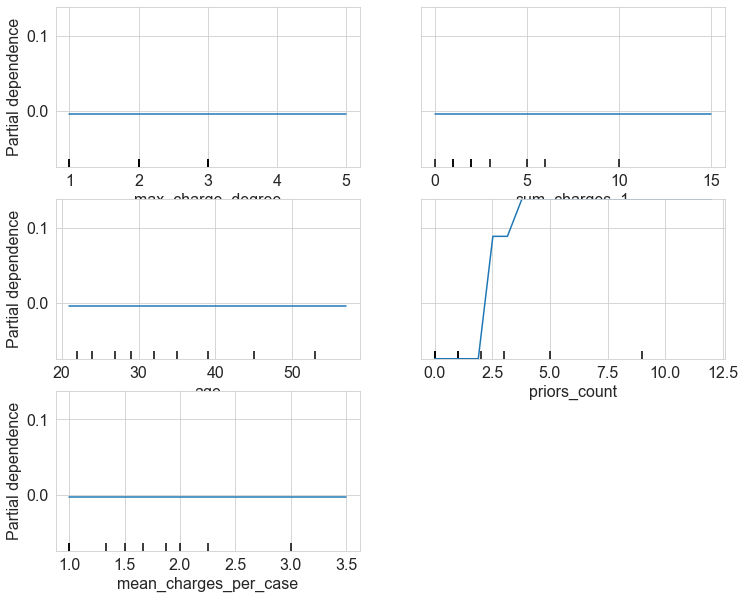

In [558]:
GB_top_features = ["max_charge_degree", "sum_charges_1", "age", "priors_count", "mean_charges_per_case"]
fig, ax = plt.subplots(figsize=(12,10))
PartialDependenceDisplay.from_estimator(GB_optimal_v, X_train, GB_top_features, n_cols=2, grid_resolution=20, kind="average", ax=ax);

#### Permutation

Text(0.5, 1.0, 'Barplot of mean permutation importance per variable')

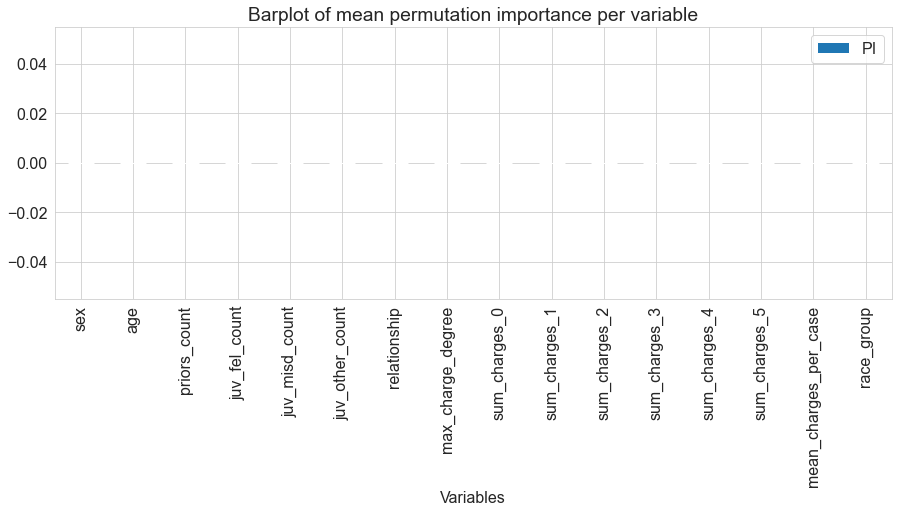

In [559]:
perm_importance = permutation_importance(GB_optimal_v, X_train.values, y_train, n_repeats = 20, random_state = 0)
PI = pd.DataFrame(zip(X_train.columns,perm_importance.importances_mean), columns = ["Variables","PI"])
PI.set_index("Variables", inplace = True)
PI.sort_values("PI", inplace=True)
PI.plot(kind = "bar")
plt.title("Barplot of mean permutation importance per variable")

## Recividism conclusion for Boosting

The model fail to give an accurate prediction for violent recividism for the before mentioned explanation. It brings out a higher accuracy to predict everyone as non-recividist.

# Shared ROC

In [61]:
df = pd.read_csv("../data/processed_race_groups_corrected.csv")
df.sex.replace(['Male', 'Female'], [0,1], inplace=True)
df.race.replace(['African-American', 'Caucasian', 'Hispanic', 'Other', 'Asian', 'Native American'], [0,1,2,3,4,5], inplace=True)
df_lin = pd.get_dummies(df, columns=['race_group'], dtype=int)

#Variable Split
X_lin = df_lin.drop(['is_violent_recid','two_year_recid', 'decile_score', 'Unnamed: 0', 'person_id','name', "race"], axis = 1)
y_lin = df_lin['two_year_recid']
X_train_lin, X_test_lin, y_train_lin, y_test_lin = train_test_split(X_lin, y_lin, test_size=0.3, random_state=1)

X = df.drop(['is_violent_recid','two_year_recid', 'decile_score', 'Unnamed: 0', 'person_id','name', "race"], axis = 1)
y = df['two_year_recid']
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=1)

In [62]:
#all models 

#Transforming (Race) + Scaling (Age) and others --> worked around it lots of times. We tried StandardScaler, RobustScaler, Normalization and others but in the end we went for the quantile --> More information see on sklearn documentation
enc = OneHotEncoder(drop='first')
standard = QuantileTransformer()

crump = ['age', 'priors_count', 'sum_charges_0', 'sum_charges_1', 'sum_charges_2', 'sum_charges_3', 'sum_charges_4', 'sum_charges_5', 'mean_charges_per_case']
cat_cols = []

preprocessor = ColumnTransformer(transformers=[("cat", enc, cat_cols), ("crump", standard, crump)], remainder='passthrough')

#Logistic Regression
log = LogisticRegression()
clf_log = Pipeline(steps=[("preprocessor", preprocessor), ("classifier", log)])
clf_log.fit(X_train_lin, y_train_lin)
roc_pred_log = clf_log.predict_log_proba(X_test_lin)[:,1]

#Lasso
lasso = Lasso(alpha = 0.001) 
clf_lasso = Pipeline(steps=[("preprocessor", preprocessor), ("classifier", lasso)])
clf_lasso.fit(X_train_lin, y_train_lin)
roc_pred_lasso = clf_lasso.predict(X_test_lin)

#Ridge
ridge_opt = Ridge(alpha = 5) 
clf_ridge = Pipeline(steps=[("preprocessor", preprocessor), ("classifier", ridge_opt)])
clf_ridge.fit(X_train_lin, y_train_lin)
roc_pred_ridge = clf_ridge.predict(X_test_lin)

#Enet
enet = ElasticNet(tol = 1e-4, alpha = 0.01, l1_ratio =0.001)
clf_enet = Pipeline(steps=[("preprocessor", preprocessor), ("classifier", enet)])
clf_enet.fit(X_train_lin, y_train_lin)
roc_pred_enet = clf_enet.predict(X_test_lin)

#Random Forest
rf_clf = RandomForestClassifier(bootstrap = True, 
                      max_depth = 76, max_features = "auto", min_samples_leaf = 20, 
                     min_samples_split = 8, n_estimators = 200, random_state = 0)
rf_clf.fit(X_train, y_train)
roc_pred_rf = rf_clf.predict_proba(X_test)[:, 1]

#GB
GB_optimal = GradientBoostingClassifier(learning_rate = 0.08,  max_depth = 2, n_estimators = 150)
GB_optimal.fit(X_train.values,y_train)
roc_pred_gb = GB_optimal.predict_proba(X_test)[:, 1]

#XGB
eval_set = [(X_train, y_train), (X_train, y_train)]
XGB_optimal = xgb.XGBClassifier(booster="gbtree", objective="binary:logistic", use_label_encoder=False, learning_rate=0.1, max_depth=2, n_estimators=200)
XGB_optimal.fit(X_train,y_train, eval_set=eval_set, eval_metric=["error", "logloss"], verbose=False)
roc_pred_xgb = XGB_optimal.predict_proba(X_test)[:, 1]


In [63]:
#all ROCS
#define models for comparison
clf_lin = [
    (roc_pred_log, "Logistic"),
    (roc_pred_lasso, "Lasso"),
    (roc_pred_ridge, "Ridge"),
    (roc_pred_enet, "Elastic Net"),
]
clf_rf = [
    (roc_pred_rf, "Random forest"),
    (roc_pred_gb, "GradientBoosting"),
    (roc_pred_xgb, "XGBoosting")
]

#empty result table
result_table = pd.DataFrame(columns=['classifiers', 'fpr','tpr','auc'])

# Train the linear models and record the results
for clfs in clf_lin:
    fpr, tpr, _ = roc_curve(y_test_lin, clfs[0])
    auc = roc_auc_score(y_test_lin, clfs[0])
    
    result_table = result_table.append({'classifiers':clfs[1],
                                        'fpr':fpr, 
                                        'tpr':tpr, 
                                        'auc':auc}, ignore_index=True)
for clfs in clf_rf:
    fpr, tpr, _ = roc_curve(y_test,  clfs[0])
    auc = roc_auc_score(y_test, clfs[0])
    
    result_table = result_table.append({'classifiers':clfs[1],
                                        'fpr':fpr, 
                                        'tpr':tpr, 
                                        'auc':auc}, ignore_index=True)
    
# Set name of the classifiers as index labels
result_table.set_index('classifiers', inplace=True)

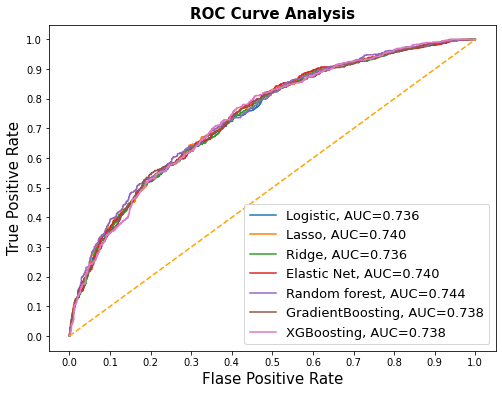

In [64]:
fig = plt.figure(figsize=(8,6))

for i in result_table.index:
    plt.plot(result_table.loc[i]['fpr'], 
             result_table.loc[i]['tpr'], 
             label="{}, AUC={:.3f}".format(i, result_table.loc[i]['auc']))
    
plt.plot([0,1], [0,1], color='orange', linestyle='--')

plt.xticks(np.arange(0.0, 1.1, step=0.1))
plt.xlabel("Flase Positive Rate", fontsize=15)

plt.yticks(np.arange(0.0, 1.1, step=0.1))
plt.ylabel("True Positive Rate", fontsize=15)

plt.title('ROC Curve Analysis', fontweight='bold', fontsize=15)
plt.legend(prop={'size':13}, loc='lower right')

plt.show()

# Calibration

## Calibrating our models

In [65]:
import numpy as np
import pandas as pd
from sklearn.ensemble import AdaBoostClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import train_test_split
import xgboost as xgb
from xgboost import plot_tree
from sklearn.ensemble import GradientBoostingClassifier
from xgboost import XGBClassifier
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.calibration import calibration_curve, CalibrationDisplay
from sklearn.linear_model import LogisticRegression, Lasso, RidgeClassifier, Ridge, ElasticNet
from sklearn.ensemble import RandomForestClassifier, RandomForestRegressor
from sklearn.preprocessing import StandardScaler, MinMaxScaler, OneHotEncoder, RobustScaler, QuantileTransformer
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from matplotlib.gridspec import GridSpec
from sklearn.svm import LinearSVC
from sklearn.ensemble import RandomForestClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.naive_bayes import GaussianNB

In [66]:
df = pd.read_csv("../data/processed_race_groups_corrected.csv")
df.sex.replace(['Male', 'Female'], [0,1], inplace=True)
df.race.replace(['African-American', 'Caucasian', 'Hispanic', 'Other', 'Asian', 'Native American'], [0,1,2,3,4,5], inplace=True)
df_lin = pd.get_dummies(df, columns=['race_group'], dtype=int)

#Variable Split
X = df_lin.drop(['is_violent_recid','two_year_recid', 'decile_score', 'Unnamed: 0', 'person_id','name', "race"], axis = 1)
y = df_lin['two_year_recid']

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=1)

In [67]:
#all models 

#Transforming (Race) + Scaling (Age) and others --> worked around it lots of times. We tried StandardScaler, RobustScaler, Normalization and others but in the end we went for the quantile --> More information see on sklearn documentation
enc = OneHotEncoder(drop='first')
standard = QuantileTransformer()

crump = ['age', 'priors_count', 'sum_charges_0', 'sum_charges_1', 'sum_charges_2', 'sum_charges_3', 'sum_charges_4', 'sum_charges_5', 'mean_charges_per_case']
cat_cols = []

preprocessor = ColumnTransformer(transformers=[("cat", enc, cat_cols), ("crump", standard, crump)], remainder='passthrough')

#Logistic Regression
log = LogisticRegression()
clf_log = Pipeline(steps=[("preprocessor", preprocessor), ("classifier", log)])
clf_log.fit(X_train, y_train)

#Lasso
lasso = Lasso(alpha = 0.001) 
clf_lasso = Pipeline(steps=[("preprocessor", preprocessor), ("classifier", lasso)])
clf_lasso.fit(X_train, y_train)

#Ridge
ridge_opt = Ridge(alpha = 5) 
clf_ridge = Pipeline(steps=[("preprocessor", preprocessor), ("classifier", ridge_opt)])
clf_ridge.fit(X_train, y_train)

#Enet
enet = ElasticNet(tol = 1e-4, alpha = 0.01, l1_ratio =0.001)
clf_enet = Pipeline(steps=[("preprocessor", preprocessor), ("classifier", enet)])
clf_enet.fit(X_train, y_train)

#Random Forest
rf_clf = RandomForestClassifier(bootstrap = True, 
                      max_depth = None, max_features = "auto", min_samples_leaf = 4, 
                     min_samples_split = 5, n_estimators = 200)
rf_clf.fit(X_train, y_train)

#GB
GB_optimal = GradientBoostingClassifier(learning_rate = 0.08,  max_depth = 2, n_estimators = 150)
GB_optimal.fit(X_train.values,y_train)

#XGB
eval_set = [(X_train, y_train), (X_test, y_test)]
XGB_optimal = xgb.XGBClassifier(booster="gbtree", objective="binary:logistic", use_label_encoder=False, learning_rate=0.1, max_depth=2, n_estimators=200)
XGB_optimal.fit(X_train,y_train, eval_set=eval_set, eval_metric=["error", "logloss"], verbose=False)

XGBClassifier(base_score=0.5, booster='gbtree', colsample_bylevel=1,
              colsample_bynode=1, colsample_bytree=1, enable_categorical=False,
              gamma=0, gpu_id=-1, importance_type=None,
              interaction_constraints='', learning_rate=0.1, max_delta_step=0,
              max_depth=2, min_child_weight=1, missing=nan,
              monotone_constraints='()', n_estimators=200, n_jobs=8,
              num_parallel_tree=1, predictor='auto', random_state=0,
              reg_alpha=0, reg_lambda=1, scale_pos_weight=1, subsample=1,
              tree_method='exact', use_label_encoder=False,
              validate_parameters=1, verbosity=None)

In [68]:
class NaivelyCalibratedLinearSVC(LinearSVC):
    """LinearSVC with `predict_proba` method that naively scales
    `decision_function` output."""

    def fit(self, X, y):
        super().fit(X, y)
        df = self.decision_function(X)
        self.df_min_ = df.min()
        self.df_max_ = df.max()

    def predict_proba(self, X):
        """Min-max scale output of `decision_function` to [0,1]."""
        df = self.decision_function(X)
        calibrated_df = (df - self.df_min_) / (self.df_max_ - self.df_min_)
        proba_pos_class = np.clip(calibrated_df, 0, 1)
        proba_neg_class = 1 - proba_pos_class
        proba = np.c_[proba_neg_class, proba_pos_class]
        return proba

In [69]:
clf_list = [
    (clf_log, "Logistic"),
    (rf_clf, "Random forest"),
    (GB_optimal, "GradientBoosting"),
    (XGB_optimal, "XGBoosting")
]

In [70]:
fig = plt.figure(figsize=(10, 10))
gs = GridSpec(4, 2)
colors = plt.cm.get_cmap("Dark2")

<Figure size 720x720 with 0 Axes>

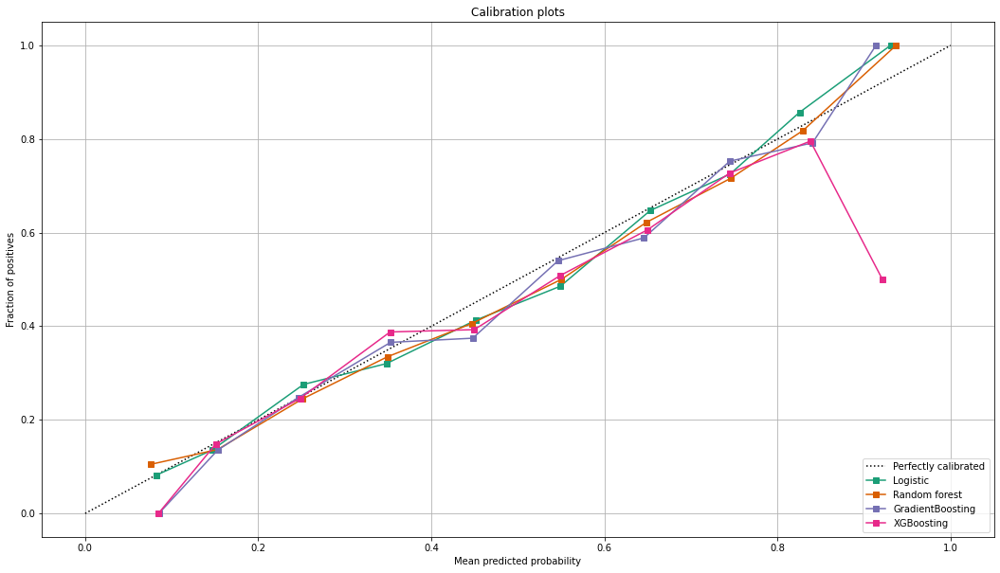

In [71]:
fig = plt.figure(figsize=(18, 10))
gs = GridSpec(4, 2)
colors = plt.cm.get_cmap("Dark2")

ax_calibration_curve = fig.add_subplot(gs[:25, :25])
calibration_displays = {}
for i, (clf, name) in enumerate(clf_list):
    display = CalibrationDisplay.from_estimator(
        clf,
        X_test,
        y_test,
        n_bins=10,
        name=name,
        ax=ax_calibration_curve,
        color=colors(i),
    )
    calibration_displays[name] = display

ax_calibration_curve.grid()
ax_calibration_curve.set_title("Calibration plots");

## Use calibration bins to generate a new decile score

In [72]:
#We can use the calibration curve to get our own Decile-Scores! (Possibly better!)
#We will use our GB model, as it seems overall decent on the graph
GB_optimal = GradientBoostingClassifier(learning_rate = 0.08,  max_depth = 2, n_estimators = 150)
GB_optimal.fit(X_train.values,y_train)
#Predict for train to get values for train! As such, we dont fit the bins on test data (as in the graph above)
roc_pred_gb_train = GB_optimal.predict_proba(X_train)[:, 1]
#Predict for the whole dataset to later visualize on all data
roc_red_gb_x = GB_optimal.predict_proba(X)[:,1]

#Get bins from the calibration curve -> 9 bins = 10 scores (1-10)
prob_true_rf_train, prob_pred_rf_train = calibration_curve(y_train, roc_pred_gb_train, n_bins=9)

In [73]:
#Get new data that also includes the original decile score for comparison
X = df.drop(['is_violent_recid','two_year_recid', 'decile_score', 'Unnamed: 0', 'person_id','name', "race"], axis = 1)
y = df[["decile_score","two_year_recid"]]
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=1)

In [74]:
#Calculate new compas scores on test
X_test["pred_score"] = 0
X_test["xgb_pred_proba"] = roc_pred_gb
X_test["compas_score"] = y_test.decile_score
X_test["is_recid"] = y_test.two_year_recid
X_test.reset_index(inplace = True)
#Update the predicted score according to our bins
for i in X_test.index: 
    if X_test["xgb_pred_proba"].iloc[i] > prob_pred_rf_train[8]: X_test["pred_score"].iloc[i] = 10
    elif X_test["xgb_pred_proba"].iloc[i] < prob_pred_rf_train[8] and X_test["xgb_pred_proba"].iloc[i] > prob_pred_rf_train[7] : X_test["pred_score"].iloc[i] = 9
    elif X_test["xgb_pred_proba"].iloc[i] < prob_pred_rf_train[7] and X_test["xgb_pred_proba"].iloc[i] > prob_pred_rf_train[6] : X_test["pred_score"].iloc[i] = 8
    elif X_test["xgb_pred_proba"].iloc[i] < prob_pred_rf_train[6] and X_test["xgb_pred_proba"].iloc[i] > prob_pred_rf_train[5]: X_test["pred_score"].iloc[i] = 7
    elif X_test["xgb_pred_proba"].iloc[i] < prob_pred_rf_train[5] and X_test["xgb_pred_proba"].iloc[i] > prob_pred_rf_train[4]: X_test["pred_score"].iloc[i] = 6
    elif X_test["xgb_pred_proba"].iloc[i] < prob_pred_rf_train[4] and X_test["xgb_pred_proba"].iloc[i] > prob_pred_rf_train[3]: X_test["pred_score"].iloc[i] = 5
    elif X_test["xgb_pred_proba"].iloc[i] < prob_pred_rf_train[3] and X_test["xgb_pred_proba"].iloc[i] > prob_pred_rf_train[2]: X_test["pred_score"].iloc[i] = 4
    elif X_test["xgb_pred_proba"].iloc[i] < prob_pred_rf_train[2] and X_test["xgb_pred_proba"].iloc[i] > prob_pred_rf_train[1]: X_test["pred_score"].iloc[i] = 3
    elif X_test["xgb_pred_proba"].iloc[i] < prob_pred_rf_train[1] and X_test["xgb_pred_proba"].iloc[i] > prob_pred_rf_train[0]: X_test["pred_score"].iloc[i] = 2
    elif X_test["xgb_pred_proba"].iloc[i] < prob_pred_rf_train[0]: X_test["pred_score"].iloc[i] = 1

Text(0.5, 1.0, 'Compas Decile Score vs. Risk of Recidivism')

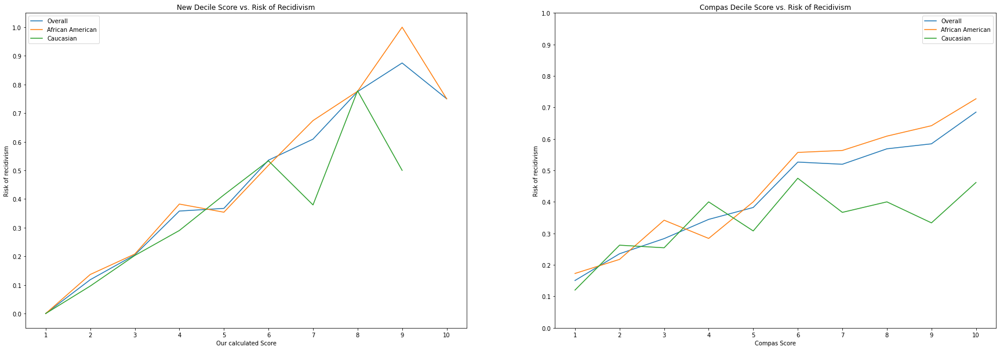

In [81]:
#Plot score vs recidivism rate for original compas score and our new decile score
fig, ax = plt.subplots(1,2, figsize = (30,10))
ax[0].plot(X_test.groupby("pred_score").is_recid.mean())
ax[0].plot(X_test[X_test.race_group == 0].groupby(["pred_score"]).is_recid.mean())
ax[0].plot(X_test[X_test.race_group == 1].groupby(["pred_score"]).is_recid.mean())
ax[0].legend(["Overall","African American", "Caucasian"]);
plt.setp(ax[0],
 xticks = [1,2,3,4,5,6,7,8,9,10], 
 yticks = [0.0, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1.0],
 ylabel = "Risk of recidivism",
 xlabel = "Our calculated Score")
ax[0].set_title("New Decile Score vs. Risk of Recidivism");

ax[1].plot(X_test.groupby("compas_score").is_recid.mean())
ax[1].plot(X_test[X_test.race_group == 0].groupby(["compas_score"]).is_recid.mean())
ax[1].plot(X_test[X_test.race_group == 1].groupby(["compas_score"]).is_recid.mean())
ax[1].legend(["Overall","African American", "Caucasian"]);
plt.yticks([0.0, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1.0]);
plt.setp(ax[1],
 xticks = [1,2,3,4,5,6,7,8,9,10], 
 yticks = [0.0, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1.0],
 ylabel = "Risk of recidivism",
 xlabel = "Compas Score")
ax[1].set_title("Compas Decile Score vs. Risk of Recidivism")

<AxesSubplot:>

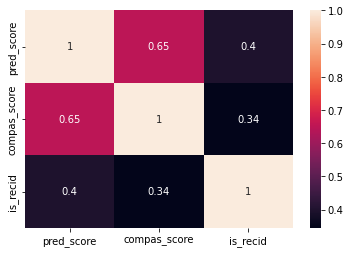

In [82]:
#Correlation between the scores and recidivism
sns.heatmap(X_test[["pred_score","compas_score","is_recid"]].corr(), annot = True)

In [77]:
#Do the same graphs for the complete df! (like from washington post)
#Calculate new compas scores on test
X["pred_score"] = 0
X["xgb_pred_proba"] = roc_red_gb_x
X["compas_score"] = y.decile_score
X["is_recid"] = y.two_year_recid
X.reset_index(inplace = True)
for i in X.index: 
    if X["xgb_pred_proba"].iloc[i] > prob_pred_rf_train[8]: X["pred_score"].iloc[i] = 10
    elif X["xgb_pred_proba"].iloc[i] < prob_pred_rf_train[8] and X["xgb_pred_proba"].iloc[i] > prob_pred_rf_train[7] : X["pred_score"].iloc[i] = 9
    elif X["xgb_pred_proba"].iloc[i] < prob_pred_rf_train[7]  and X["xgb_pred_proba"].iloc[i] > prob_pred_rf_train[6] : X["pred_score"].iloc[i] = 8
    elif X["xgb_pred_proba"].iloc[i] < prob_pred_rf_train[6]  and X["xgb_pred_proba"].iloc[i] > prob_pred_rf_train[5]: X["pred_score"].iloc[i] = 7
    elif X["xgb_pred_proba"].iloc[i] < prob_pred_rf_train[5] and X["xgb_pred_proba"].iloc[i] > prob_pred_rf_train[4]: X["pred_score"].iloc[i] = 6
    elif X["xgb_pred_proba"].iloc[i] < prob_pred_rf_train[4] and X["xgb_pred_proba"].iloc[i] > prob_pred_rf_train[3]: X["pred_score"].iloc[i] = 5
    elif X["xgb_pred_proba"].iloc[i] < prob_pred_rf_train[3] and X["xgb_pred_proba"].iloc[i] > prob_pred_rf_train[2]: X["pred_score"].iloc[i] = 4
    elif X["xgb_pred_proba"].iloc[i] < prob_pred_rf_train[2] and X["xgb_pred_proba"].iloc[i] > prob_pred_rf_train[1]: X["pred_score"].iloc[i] = 3
    elif X["xgb_pred_proba"].iloc[i] < prob_pred_rf_train[1] and X["xgb_pred_proba"].iloc[i] > prob_pred_rf_train[0]: X["pred_score"].iloc[i] = 2
    elif X["xgb_pred_proba"].iloc[i] < prob_pred_rf_train[0]: X["pred_score"].iloc[i] = 1

Text(0.5, 1.0, 'Compas Decile Score vs. Risk of Recidivism')

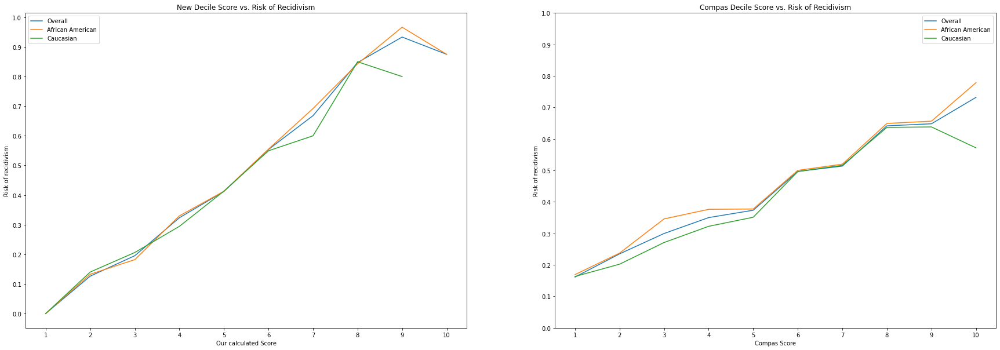

In [114]:
#Same graphs for whole df
fig, ax = plt.subplots(1,2, figsize = (30,10))
ax[0].plot(X.groupby("pred_score").is_recid.mean())
ax[0].plot(X[X.race_group == 0].groupby(["pred_score"]).is_recid.mean())
ax[0].plot(X[X.race_group == 1].groupby(["pred_score"]).is_recid.mean())
ax[0].legend(["Overall","African American", "Caucasian"]);
plt.setp(ax[0],
 xticks = [1,2,3,4,5,6,7,8,9,10], 
 yticks = [0.0, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1.0],
 ylabel = "Risk of recidivism",
 xlabel = "Our calculated Score")
ax[0].set_title("New Decile Score vs. Risk of Recidivism");

ax[1].plot(X.groupby("compas_score").is_recid.mean())
ax[1].plot(X[X.race_group == 0].groupby(["compas_score"]).is_recid.mean())
ax[1].plot(X[X.race_group == 1].groupby(["compas_score"]).is_recid.mean())
ax[1].legend(["Overall","African American", "Caucasian"]);
plt.yticks([0.0, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1.0]);
plt.setp(ax[1],
 xticks = [1,2,3,4,5,6,7,8,9,10], 
 yticks = [0.0, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1.0],
 ylabel = "Risk of recidivism",
 xlabel = "Compas Score")
ax[1].set_title("Compas Decile Score vs. Risk of Recidivism")

<AxesSubplot:>

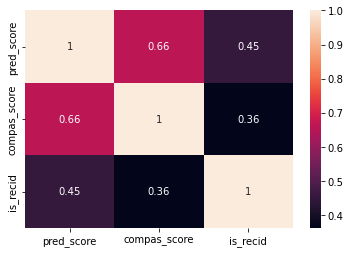

In [84]:
#Correlation with whole df
sns.heatmap(X[["pred_score","compas_score","is_recid"]].corr(), annot = True)

<AxesSubplot:xlabel='compas_score', ylabel='index'>

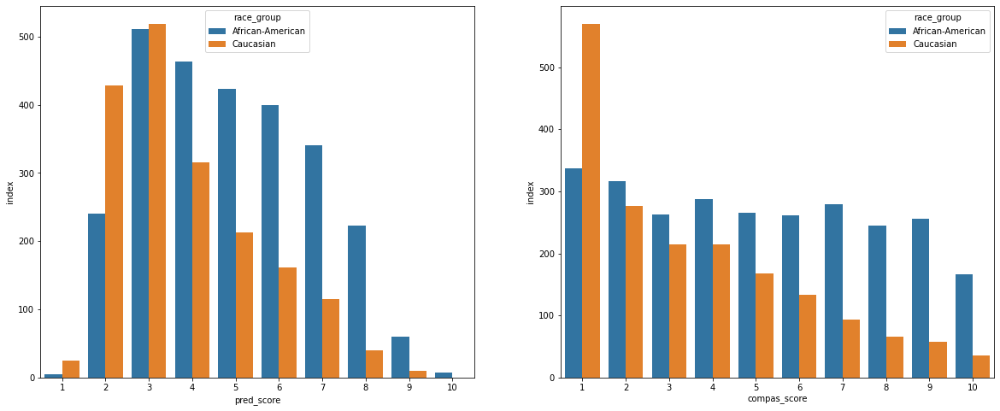

In [145]:
#How are the new scores by race?
fig, ax = plt.subplots(1,2, figsize = (20,8))
data = X[X.race_group < 2].groupby(["pred_score", "race_group"]).index.count().reset_index()
data.race_group.replace([0,1], ['African-American', 'Caucasian'], inplace=True)
sns.barplot(data = data, x = "pred_score", y = "index", hue = "race_group", ax = ax[0])

#How are the compas scores by race?
data2 = X[X.race_group < 2].groupby(["compas_score", "race_group"]).index.count().reset_index()
data2.race_group.replace([0,1], ['African-American', 'Caucasian'], inplace=True)
sns.barplot(data = data2, x = "compas_score", y = "index", hue = "race_group", ax = ax[1])

<AxesSubplot:xlabel='compas_score', ylabel='is_recid'>

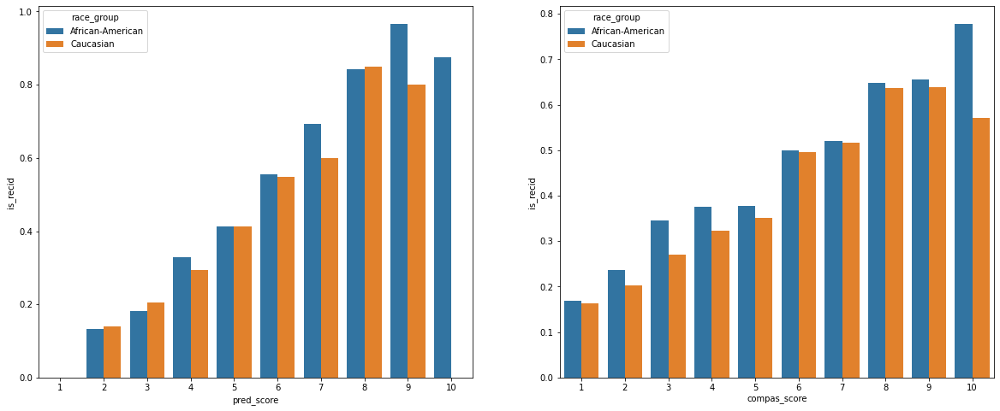

In [144]:
fig, ax = plt.subplots(1,2, figsize = (20,8))
#Again, showing as bar chart how the recidivism rate is per group per race for our score
data2 = X[X.race_group < 2].groupby(["pred_score", "race_group"]).is_recid.mean().reset_index()
data2.race_group.replace([0,1], ['African-American', 'Caucasian'], inplace=True)
sns.barplot(data = data2, x = "pred_score", y = "is_recid", hue = "race_group", ax = ax[0])
#This is overall pretty close, except for score = 7 and score = 9, also for score = 10 we dont have any caucasian data.

#Again, showing as bar chart how the recidivism rate is per group per race for the compas score
data3 = X[X.race_group < 2].groupby(["compas_score", "race_group"]).is_recid.mean().reset_index()
data3.race_group.replace([0,1], ['African-American', 'Caucasian'], inplace=True)
sns.barplot(data = data3, x = "compas_score", y = "is_recid", hue = "race_group", ax = ax[1])

#Talking about race equality, our model performs better on low scores, while the compas score is more consistent at scores
#higher than 6 - again, the data basis for score = 10 is also scarce for the compas score

In [120]:
#We can still see, that our data gives higher scores to african-american and lower scores to caucasians

#Note: Although our new decile score performs better on this dataset, it is unlikely that it will outperform an assessment test on large scale
#If it was to outperform an in-depth assessment, that would be serious trouble for the assessment test (since our data is lacking a lot of context, that the assessment
#test can easily bring (and should always include in the evaluation))

# Model Performance and Accuracy Summary

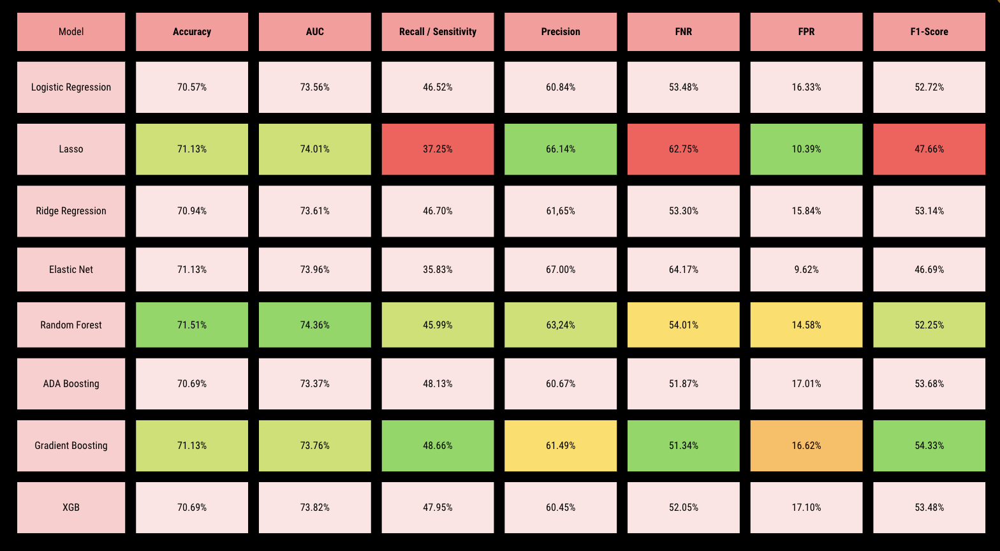

In [635]:
from IPython.display import Image
Image(filename='../image/model_inc_protected_attr.png') 
#the table focuses on Lasso as best linear model, random forest and Gradient boosting as best boosting model.
#Logistic Regression performed similar to Logistic Regression and Elastic Net after doing the feature selection.
#Overall, we identified Random Forest as best model, based on Accuracy and AUC 
#While either Boosting or Lasso perform best on sensitivity, precision, fnr, fpr and f1, the Random forest performs more balanced in those areas. 

# Model Fairness and Data Bias

Although in machine learning, performance and accuracy are very important to evaluate if a model is good or not good, we think that especially in social justice, Fairness or Ethical Machine Learning should be considered as equally important if not more important than performance and accuracy. 

After analyzing how some of the best-performing and highest accuracy models above, we calculate the TPR, FPR, FNR per racial groups with and without considering Protected Attributes in the model decision. All of these analysis though vary per model, still suggest fairness issues that they all share. Recidive Caucasians and Others group are much more likely to get away and wrongly labeled as non-offended. More dangerously, the chance of misclassifying a non-recidive African American almost doubles Caucassians and Others. Even leaving the Protected Attributes out of the model decision, there is not so much of improvement. 

Therefore we think there might be data bias issues that might be out of the scope of our models. Specifically, we suspect that there are:

Bias in Y

- Relying on the data of “re-arrest” might miss the true target of “re-
offend”. Can “re-arrest” substitute for “re-offend” when policing 
practices are still a controversial topic in the US, especially there are
evidences of unfair treatment towards communities of color?  
- Though violent crime arrests are claimed to be “unbiased”, violent 
arrest rates still vary in attributes of the offense, including race. 
- Relying on “re-arrest” causes many concerns as people of color are 
more likely to be stopped or searched by the police. Young male 
people are more likely to be pulled over. If these young men happen
to be African American, the chance of being stopped is even higher. 
- Including “self-reported re-offense” might help increase accuracy of 
measured violence and crime.

Bias in X

- Most of variables give a summary of criminal history which as 
explained above might be correlated to racial bias of local law 
enforcement. Black men are got caught all the time for trivial things 
in their “black” neighborhoods that draws more attention from the 
local law enforcement than other areas.
- COMPAS’s questionnaire (eg. “How many of your 
friends/acquaintances are taking drugs illegally?”) for defendants 
does not ask about race but still racializes crime and recidivism. 
- There might be many ethical decisions that were hidden at the data 
processing stage before any machine learning experts touch the 
dataset. For example, if there were any past convictions that are 
now decriminalized counted in the crime history. 

We think that there might be systematic racial bias that has been existed for a long time within the American political system. COMPAS model simply could not transcend such a high-level, deep-rooted discrimination but on the other hand could exacerbate the inequality and injustice issue when it is promoted as machine-learning-based, non-bias technology. We learn a moral lession that machine learning if not implemented ethically and 
transparently may exacerbate unjust disparities that are already bad in our society. In this case, the FPR, FNR are not just numbers, we learn that data scientists especially in social justice domain need to bear in mind an important fact that these are people's lives.   
